In [2]:
import pandas as pd
import os


# Directory where your folders are stored
directory = os.getcwd() + "/DATASETS/datasets_lic/"
# Create an empty list to store individual DataFrames
dfs = []

# Iterate over each folder in the directory
for year_folder in os.listdir(directory):
    year_folder_path = os.path.join(directory, year_folder)
    # Check if the item is a directory
    if os.path.isdir(year_folder_path):
        print(year_folder)
        # Iterate over each CSV file in the year folder
        for filename in os.listdir(year_folder_path):
            if filename.endswith('.csv'):
                file_path = os.path.join(year_folder_path, filename)
                print("Reading file:", file_path)  # Print the file name

                # Read CSV file into DataFrame
                df = pd.read_csv(file_path, sep=';', encoding='latin1', decimal=',', low_memory=False)
                # Append DataFrame to list
                dfs.append(df)

# Concatenate all DataFrames in the list into a single DataFrame
df = pd.concat(dfs, ignore_index=True)

# Now you have a single DataFrame containing all data from CSV files in the folders

2019
Reading file: c:\Users\kiwi\Desktop\U\CV-tuning\Data-Filtering-Description-and-DataMart-of-Chilean-Bids/DATASETS/datasets_lic/2019\12LicitacionesAbr.csv
Reading file: c:\Users\kiwi\Desktop\U\CV-tuning\Data-Filtering-Description-and-DataMart-of-Chilean-Bids/DATASETS/datasets_lic/2019\12LicitacionesAgo.csv
Reading file: c:\Users\kiwi\Desktop\U\CV-tuning\Data-Filtering-Description-and-DataMart-of-Chilean-Bids/DATASETS/datasets_lic/2019\12LicitacionesDic.csv
Reading file: c:\Users\kiwi\Desktop\U\CV-tuning\Data-Filtering-Description-and-DataMart-of-Chilean-Bids/DATASETS/datasets_lic/2019\12LicitacionesEne.csv
Reading file: c:\Users\kiwi\Desktop\U\CV-tuning\Data-Filtering-Description-and-DataMart-of-Chilean-Bids/DATASETS/datasets_lic/2019\12LicitacionesFeb.csv
Reading file: c:\Users\kiwi\Desktop\U\CV-tuning\Data-Filtering-Description-and-DataMart-of-Chilean-Bids/DATASETS/datasets_lic/2019\12LicitacionesJul.csv
Reading file: c:\Users\kiwi\Desktop\U\CV-tuning\Data-Filtering-Description-an

In [3]:
df.shape

(1906649, 74)

Distinct count of unique variables

In [4]:
value_counts = df['MontoTotalOferta'].value_counts()
print(value_counts)

MontoTotalOferta
0.0            1023988
1.0              25288
120000.0          1776
60000.0           1769
30000.0           1754
                ...   
123890000.0          1
184920000.0          1
85998000.0           1
97488000.0           1
98800000.0           1
Name: count, Length: 251037, dtype: int64


Se iguala el Monto total de la oferta al monto estimado de la licitacion en donde su oferta sea 0, pero adjudicada

In [5]:
#df.loc[(df['MontoTotalOferta'] == 0) & (df['ResultadoOferta'] == 'Ganadora'), 'MontoTotalOferta'] = df['MontoEstimadoLicitacion']
df.loc[(df['MontoTotalOferta'].isin([0, 1])) & (df['ResultadoOferta'] == 'Ganadora'), 'MontoTotalOferta'] = df['MontoEstimadoLicitacion']

Se verifican los tipos de datos antes que puedan influenciar a la hora de generar las diferentes tablas

In [6]:
df_mayor_100 = df[(df['MontoTotalOferta'] >= 100)]

In [7]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1906649 entries, 0 to 1906648
Data columns (total 74 columns):
 #   Column                          Dtype  
---  ------                          -----  
 0   NroLicitacion                   object 
 1   NombreLicitacion                object 
 2   TipoLicitacion                  object 
 3   Descripcion                     object 
 4   MonedaLicitacion                object 
 5   MontoEstimadoLicitacion         int64  
 6   MontoEstimadoVisible            object 
 7   BaseEstimacionMontoLicitacion   object 
 8   FuenteFinanciamiento            object 
 9   JustificacionMontoEstimado      object 
 10  FechaPublicacion                object 
 11  FechaInicioPreguntas            object 
 12  FechaFinalPreguntas             object 
 13  FechaPublicacionRespuestas      object 
 14  FechaActoAperturaTecnica        object 
 15  FechaActoAperturaEconomica      object 
 16  FechaCierre                     object 
 17  FechaAdjudicacion          

Se cambian el tipo de valores para que estos no influyan en las tablas

In [8]:
rowto_string = ['entCode','CodigoProductoONU','UnidadTiempoRenovacion']

df[rowto_string] = df[rowto_string].astype('string')

In [9]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1906649 entries, 0 to 1906648
Data columns (total 74 columns):
 #   Column                          Dtype  
---  ------                          -----  
 0   NroLicitacion                   object 
 1   NombreLicitacion                object 
 2   TipoLicitacion                  object 
 3   Descripcion                     object 
 4   MonedaLicitacion                object 
 5   MontoEstimadoLicitacion         int64  
 6   MontoEstimadoVisible            object 
 7   BaseEstimacionMontoLicitacion   object 
 8   FuenteFinanciamiento            object 
 9   JustificacionMontoEstimado      object 
 10  FechaPublicacion                object 
 11  FechaInicioPreguntas            object 
 12  FechaFinalPreguntas             object 
 13  FechaPublicacionRespuestas      object 
 14  FechaActoAperturaTecnica        object 
 15  FechaActoAperturaEconomica      object 
 16  FechaCierre                     object 
 17  FechaAdjudicacion          

In [10]:
from scipy.stats import kurtosis, skew

column = df.columns.tolist()

def describe_nulls2(df, column):
    # Calculate descriptive statistics
    describe_result = df[column].describe()

    # Calculate mode for the column
    mode = df[column].mode().iloc[0]

    # Calculate kurtosis for the column
    kurtosis_value = kurtosis(df[column].dropna(), nan_policy='omit')

    # Calculate skewness for the column
    skewness_value = skew(df[column].dropna(), nan_policy='omit')

    # Count null values in the column
    nulos = df[column].isnull().sum()

    # Add the 'mode', 'kurtosis' and 'skewness' to the describe() result
    describe_result['mode'] = mode
    describe_result['kurtosis'] = kurtosis_value
    describe_result['skewness'] = skewness_value

    # Add the 'nulos' to the describe() result
    describe_result['nulos'] = nulos

    # Calculate percentage of null values in the column
    num_rows = len(df)
    null_percentage = (nulos / num_rows) * 100

    # Format the percentage with the percentage symbol
    null_percentage_formatted = f"{null_percentage:.2f}%"

    # Add the 'porcentaje de nulos' to the describe() result
    describe_result['porcentaje de nulos'] = null_percentage_formatted

    return describe_result

def describe_nulls_num2(df):
    # Calcular estadísticas descriptivas
    describe_result = df.describe(include=[object])

    # Contar valores nulos por columna
    nulos = df.isnull().sum()

    # Agregar la fila 'nulos' al resultado de describe()
    describe_result.loc['nulos'] = nulos

    # Calcular porcentaje de valores nulos por columna
    num_rows = len(df)
    null_percentages = (nulos / num_rows) * 100

    # Formatear los porcentajes con el símbolo de porcentaje
    null_percentages_formatted = null_percentages.apply(lambda x: f"{x:.2f}%")

    # Agregar la fila 'porcentaje de nulos' al resultado de describe()
    describe_result.loc['porcentaje de nulos'] = null_percentages_formatted

    return describe_result

In [11]:
describe_nulls2(df, column)

C:\Users\kiwi\AppData\Local\Temp\ipykernel_13736\2102882025.py:13: SmallSampleWarning: All axis-slices of one or more sample arguments are too small; all elements of returned arrays will be NaN. See documentation for sample size requirements.
  kurtosis_value = kurtosis(df[column].dropna(), nan_policy='omit')
C:\Users\kiwi\AppData\Local\Temp\ipykernel_13736\2102882025.py:16: SmallSampleWarning: All axis-slices of one or more sample arguments are too small; all elements of returned arrays will be NaN. See documentation for sample size requirements.
  skewness_value = skew(df[column].dropna(), nan_policy='omit')


ValueError: Length of values (74) does not match length of index (8)

Tabla de datos antes de la limpieza, esta tabla es importante para conocer cuales pueden er los valores a limpiar además de conocer valores máximos o mínimos

In [12]:
def describe_nulls(df):
    # Calcular estadísticas descriptivas
    describe_result = df.describe()
    # Contar valores nulos por columna
    nulos = df.isnull().sum()

    # Agregar la fila 'nulos' al resultado de describe()
    describe_result.loc['nulos'] = nulos

    # Calcular porcentaje de valores nulos por columna
    num_rows = len(df)
    null_percentages = (nulos / num_rows) * 100

    # Formatear los porcentajes con el símbolo de porcentaje
    null_percentages_formatted = null_percentages.apply(lambda x: f"{x:.2f}%")

    # Agregar la fila 'porcentaje de nulos' al resultado de describe()
    describe_result.loc['porcentaje de nulos'] = null_percentages_formatted

    return describe_result

def describe_nulls_num(df):
    # Calcular estadísticas descriptivas
    describe_result = df.describe(include=[object])

    # Contar valores nulos por columna
    nulos = df.isnull().sum()

    # Agregar la fila 'nulos' al resultado de describe()
    describe_result.loc['nulos'] = nulos

    # Calcular porcentaje de valores nulos por columna
    num_rows = len(df)
    null_percentages = (nulos / num_rows) * 100

    # Formatear los porcentajes con el símbolo de porcentaje
    null_percentages_formatted = null_percentages.apply(lambda x: f"{x:.2f}%")

    # Agregar la fila 'porcentaje de nulos' al resultado de describe()
    describe_result.loc['porcentaje de nulos'] = null_percentages_formatted

    return describe_result

In [13]:
def describe_nulls_all(df):
    nulls = df.isnull().sum()
    nulls_percent = 100 * df.isnull().sum() / len(df)
    nulls_df = pd.concat([nulls, nulls_percent], axis=1)
    nulls_df.columns = ['Missing Values', 'Percentage of Total Values']
    return nulls_df

describe_nulls_all(df)

,Missing Values,Percentage of Total Values
NroLicitacion,0,0.000000
NombreLicitacion,0,0.000000
TipoLicitacion,0,0.000000
Descripcion,0,0.000000
MonedaLicitacion,0,0.000000
...,...,...
CantidadOferta,0,0.000000
MonedaOferta,1023982,53.705847
MontoNetoOferta,0,0.000000
MontoTotalOferta,0,0.000000


In [14]:
describe_nulls(df)

,MontoEstimadoLicitacion,LicitacionBaseTipo,TiempoDuracionContrato,ContratoRenovable,ValorTiempoRenovacion,CantidadItem,CantidadOferta,MontoNetoOferta,MontoTotalOferta
count,1906649.0,0.0,1906649.0,0.0,1906649.0,1906647.0,1906649.0,1906649.0,1906649.0
mean,383827922.996278,NaN,119.365489,NaN,0.0,18354.559275,7664.495692,4725135576.154398,10941408986.881239
std,18835947899.824329,NaN,65023.399277,NaN,0.0,621521.800588,448424.147851,6517891622463.025391,8071546254858.4375
min,0.0,NaN,0.0,NaN,0.0,0.0,0.0,-1.0,-1.0
25%,2420800.0,NaN,0.0,NaN,0.0,1.0,0.0,0.0,0.0
50%,8755183.0,NaN,0.0,NaN,0.0,2.0,0.0,0.0,177000.0
75%,37710321.0,NaN,4.0,NaN,0.0,16.0,1.0,22679.0,6302520.0
max,5856793744545.0,NaN,44227650.0,NaN,0.0,140400000.0,140400000.0,9000000000000000.0,9000000000000000.0
nulos,0.0,1906649.0,0.0,1906649.0,0.0,2.0,0.0,0.0,0.0
porcentaje de nulos,0.00%,100.00%,0.00%,100.00%,0.00%,0.00%,0.00%,0.00%,0.00%


In [15]:
describe_nulls(df_mayor_100)

,MontoEstimadoLicitacion,LicitacionBaseTipo,TiempoDuracionContrato,ContratoRenovable,ValorTiempoRenovacion,UnidadTiempoRenovacion,entCode,CodigoProductoONU,CantidadItem,CantidadOferta,MontoNetoOferta,MontoTotalOferta
count,1328301.0,0.0,1328301.0,0.0,1328301.0,0.0,1328301.0,1328299.0,1328299.0,1328301.0,1328301.0,1328301.0
mean,277917773.654196,NaN,169.120812,NaN,0.0,NaN,138279.160336,53330244.30751,13721.111095,11001.343408,6782479991.941666,15705345778.576365
std,17506240196.588303,NaN,77903.423964,NaN,0.0,NaN,375401.220249,19030605.164039,598797.571563,537215.488548,7808979090773.09375,9670384471322.533203
min,0.0,NaN,0.0,NaN,0.0,NaN,6919.0,10101501.0,0.0,0.0,0.0,100.0
25%,2495438.0,NaN,0.0,NaN,0.0,NaN,6928.0,42151623.0,1.0,0.0,0.0,124800.0
50%,8232710.0,NaN,0.0,NaN,0.0,NaN,7034.0,51181701.0,2.0,1.0,4447.0,2047410.0
75%,31720700.0,NaN,0.0,NaN,0.0,NaN,7254.0,70141703.0,16.0,4.0,110000.0,17000000.0
max,5856793744545.0,NaN,44227650.0,NaN,0.0,NaN,1703725.0,104103044.0,140400000.0,140400000.0,9000000000000000.0,9000000000000000.0
nulos,0.0,1328301.0,0.0,1328301.0,0.0,1328301.0,0.0,2.0,2.0,0.0,0.0,0.0
porcentaje de nulos,0.00%,100.00%,0.00%,100.00%,0.00%,100.00%,0.00%,0.00%,0.00%,0.00%,0.00%,0.00%


In [16]:
#pd.set_option('display.max_columns', None)
pd.set_option('display.max_columns', None)
describe_nulls_num(df)
#describe_nulls_num(df.iloc[:, 67:80])

,NroLicitacion,NombreLicitacion,TipoLicitacion,Descripcion,MonedaLicitacion,MontoEstimadoVisible,BaseEstimacionMontoLicitacion,FuenteFinanciamiento,JustificacionMontoEstimado,FechaPublicacion,FechaInicioPreguntas,FechaFinalPreguntas,FechaPublicacionRespuestas,FechaActoAperturaTecnica,FechaActoAperturaEconomica,FechaCierre,FechaAdjudicacion,FechaEntregaEnSoporteFisico,FechaEstimadaEvaluacionOfertas,UnidadTiempoEvaluacion,EstadoLicitacion,ContemplaObrasPublicas,LicitacionInformada,TipoAdjudicacion,TipoAprobacionAdjudicacion,NumeroActaAprobacion,FechaActaAprobacion,TipoConvocatoria,NroEtapasLicitacion,SubContratacion,ProhibicionSubContratacion,TomaRazonContraloria,PublicidadOfertasTecnicas,RazonPublicidadOfertasTecnicas,Contrato,UnidadTiempoDuracionContrato,FechaEstimadaFirmaContrato,TipoEjecucion,PlazoPagoContrato,TipoPago,ObservacionContrato,ExtensionPlazo,UnidadCompra,UnidadCompraRUT,Institucion,Sector,RubroN1,RubroN2,RubroN3,ONUProducto,NombreItem,DescripcionItem,UnidadMedida,Proveedor,ProveedorRUT,ActividadProveedor,TamanoProveedor,NombreOferta,EspecificacionesProveedor,EstadoOferta,MonedaOferta,ResultadoOferta
count,1906649,1906649,1906649,1906649,1906649,1906649,1906525,747427,891410,1906649,1906649,1906649,1906649,1906649,1906649,1906649,1905892,52049,579459,1877192,1906649,1345848,1906649,1906649,1906649,1906203,1906649,1906649,1906649,1906649,427422,1769392,1686136,353789,1769392,1450396,99804,1330257,1450396,1345724,442786,1768113,1906649,1906649,1906649,1906649,1906647,1906647,1906647,1906647,1906647,1900347,1906649,1906649,1906648,1831608,1906649,1906649,882640,1906649,882667,1906649
unique,71618,68321,12,68309,5,2,3,6791,12524,69799,58552,32065,29676,34408,34584,24472,71509,1086,74,4,5,2,1,1,6,21854,1500,2,2,2,6498,2,2,888,3,4,2453,2,3,4,6787,2,1665,528,257,1,56,345,1730,8730,8805,237622,97,39909,39947,19074,5,209257,593698,2,5,2
top,45-22-LR23,Adquisición de libros para Programa Bibliometro,Licitación Pública Entre 100 y 1000 UTM (LE),La presente licitación tiene por objeto regula...,CLP,Si,Presupuesto disponible,SNBP,0,06-01-2022 12:26:05,06-01-2022 13:00:00,17-01-2022 20:00:00,20-01-2022 18:00:00,07-02-2022 15:01:00,07-02-2022 15:01:00,07-02-2022 15:01:00,06-10-2023 10:35:17,09-12-2021 0:00:00,01-01-1900 0:00:00,Horas,Adjudicada,NO,NO,Multiple con Orden de Compra,Resolucion,6548,06-11-2018 0:00:00,Abierta,Una etapa,Si,Remitirse a las bases,No,Si,Todas las ofertas técnicas serán visibles al p...,No,Horas,26-12-2019 0:00:00,Contrato de Ejecucion Inmediata,A 30 dias,Cheque,La oferta económica debe incluir todo tipo de ...,NO,Servicio Nacional de Capacitación y Empleo,60.905.000-4,DIRECCION GENERAL DE GENDARMERIA DE CHIL,"GOB. CENTRAL, UNIVERSIDADES",Productos impresos y publicaciones,Medios impresos,Publicaciones impresas,Libros de referencias para bibliotecas,Libros de referencias para bibliotecas,Convenio marco para la adquisición de servicio...,Unidad,CENTRO DE EVALUACION Y CERTIFICACION DE COMPET...,76.177.214-7,OTRAS ACTIVIDADES EMPRESARIALES N.C.P.,Micro,COTIZACION DE LIBROS,Adjunto anexo económico.,Aceptada,CLP,Perdedora
freq,25182,52233,888603,25504,1878049,966681,1184934,48935,268243,25504,25504,25513,25537,25809,25806,25523,25182,2291,455946,1291961,1898090,1340495,1906649,1906649,1686814,27218,31466,1904085,1849018,966681,42303,1715059,1670955,338446,926591,904297,5927,838739,1433949,776124,64093,1498016,74612,175384,301935,1906649,283918,255043,255043,105522,105522,715,1515665,39129,39129,58146,653237,9272,3470,1758574,860074,981756
nulos,0,0,0,0,0,0,124,1159222,1015239,0,0,0,0,0,0,0,757,1854600,1327190,29457,0,560801,0,0,0,446,0,0,0,0,1479227,137257,220513,1552860,137257,456253,1806845,576392,456253,560925,1463863,138536,0,0,0,0,2,2,2,2,2,6302,0,0,1,75041,0,0,1024009,0,1023982,0
porcentaje de nulos,0.00%,0.00%,0.00%,0.00%,0.00%,0.00%,0.01%,60.80%,53.25%,0.00%,0.00%,0.00%,0.00%,0.00%,0.00%,0.00%,0.04%,97.27%,69.61%,1.54%,0.00%,29.41%,0.00%,0.00%,0.00%,0.02%,0.00%,0.00%,0.00%,0.00%,77.58%,7.20%,11.57%,81.

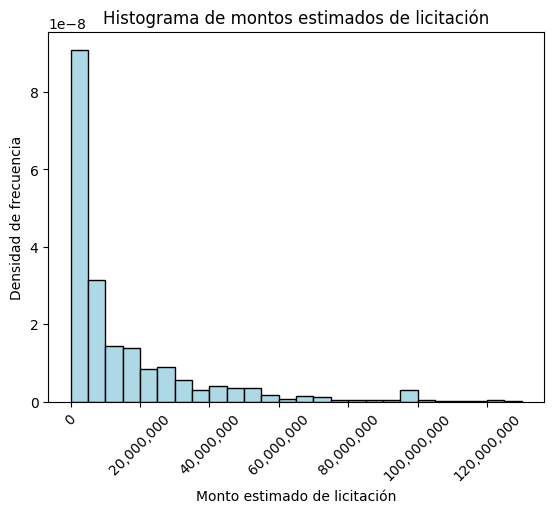

In [17]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.ticker as ticker

variable = "MontoEstimadoLicitacion"
df_m = df[variable].copy(deep=True)
df_m = df_m[df_m <= 130900000]
# Define the bins
#bins = np.arange(df[variable].min(), df[variable].max(), 400000) #this is the original hist 
bins = np.arange(df_m.min(), df_m.max(), 5000000) # 5M bins

# Histogram
counts, bin_edges = np.histogram(df_m, bins=bins)

# Plotting
plt.hist(df_m, bins=bins, color='lightblue', edgecolor='black', density=True)
#plt.title('Histograma de ' + variable)
plt.title('Histograma de montos estimados de licitación')
#plt.xlabel(variable)
plt.xlabel('Monto estimado de licitación')
plt.ylabel('Densidad de frecuencia')

# Format x-axis labels
#ax = plt.gca()
#ax.xaxis.set_major_formatter(ticker.FuncFormatter(lambda x, pos: '{:,.0f}'.format(x)))
# Format x-axis labels
ax = plt.gca()
ax.xaxis.set_major_formatter(ticker.FuncFormatter(lambda x, pos: '{:,.0f}'.format(x)))

# Rotate x-axis labels
plt.xticks(rotation=45)
# Format y-axis labels
#ax.yaxis.set_major_formatter(ticker.FuncFormatter(lambda y, _: '{:.10f}'.format(y)))

plt.show()

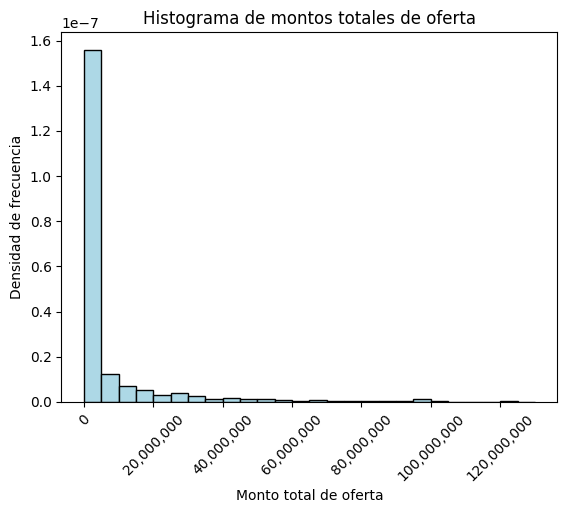

In [18]:
variable = "MontoTotalOferta"
df_m = df[variable].copy(deep=True)
df_m = df_m[df_m <= 130900000]
# Define the bins
#bins = np.arange(df[variable].min(), df[variable].max(), 400000) #this is the original hist 
bins = np.arange(df_m.min(), df_m.max(), 5000000) # 5M bins

# Histogram
counts, bin_edges = np.histogram(df_m, bins=bins)

# Plotting
plt.hist(df_m, bins=bins, color='lightblue', edgecolor='black', density=True)
#plt.title('Histograma de ' + variable)
plt.title('Histograma de montos totales de oferta')
#plt.xlabel(variable)
plt.xlabel('Monto total de oferta')
plt.ylabel('Densidad de frecuencia')

# Format x-axis labels
#ax = plt.gca()
#ax.xaxis.set_major_formatter(ticker.FuncFormatter(lambda x, pos: '{:,.0f}'.format(x)))
# Format x-axis labels
ax = plt.gca()
ax.xaxis.set_major_formatter(ticker.FuncFormatter(lambda x, pos: '{:,.0f}'.format(x)))

# Rotate x-axis labels
plt.xticks(rotation=45)
# Format y-axis labels
#ax.yaxis.set_major_formatter(ticker.FuncFormatter(lambda y, _: '{:.10f}'.format(y)))

plt.show()

En esta etapa se eliminan las columnas que tienen un alto valor de NA

In [19]:
del_col = ['LicitacionBaseTipo', 'ContratoRenovable', 'UnidadTiempoRenovacion','FuenteFinanciamiento', 'JustificacionMontoEstimado', 'FechaEntregaEnSoporteFisico','FechaEstimadaEvaluacionOfertas', 'ProhibicionSubContratacion', 'RazonPublicidadOfertasTecnicas', 'FechaEstimadaFirmaContrato','ObservacionContrato', 'EspecificacionesProveedor', 'ValorTiempoRenovacion', 'MonedaOferta', 'LicitacionInformada',  'Sector', 'TipoAdjudicacion']
df_limpiado = df.drop(columns=del_col)

a pesar de que estas columnas:
'TipoEjecucion',
'TipoPago',
'ContemplaObrasPublicas',
'PlazoPagoContrato',
'UnidadTiempoDuracionContrato'
tienen un alto grado de nulls se han decidido dejar debido a la importancia que contienen para analizar

In [20]:
describe_nulls(df_limpiado)

,MontoEstimadoLicitacion,TiempoDuracionContrato,CantidadItem,CantidadOferta,MontoNetoOferta,MontoTotalOferta
count,1906649.0,1906649.0,1906647.0,1906649.0,1906649.0,1906649.0
mean,383827922.996278,119.365489,18354.559275,7664.495692,4725135576.154398,10941408986.881239
std,18835947899.824329,65023.399277,621521.800588,448424.147851,6517891622463.025391,8071546254858.4375
min,0.0,0.0,0.0,0.0,-1.0,-1.0
25%,2420800.0,0.0,1.0,0.0,0.0,0.0
50%,8755183.0,0.0,2.0,0.0,0.0,177000.0
75%,37710321.0,4.0,16.0,1.0,22679.0,6302520.0
max,5856793744545.0,44227650.0,140400000.0,140400000.0,9000000000000000.0,9000000000000000.0
nulos,0.0,0.0,2.0,0.0,0.0,0.0
porcentaje de nulos,0.00%,0.00%,0.00%,0.00%,0.00%,0.00%


In [21]:
df_limpiado.value_counts("TipoLicitacion")

TipoLicitacion
Licitación Pública Entre 100 y 1000 UTM (LE)                   888603
Licitación Pública Menor a 100 UTM (L1)                        456431
Licitación Pública Mayor a 5000 (LR)                           289387
Licitación Pública Mayor 1000 UTM (LP)                         161918
Licitación Pública entre a 2000 y 5000 UTM (LQ)                107612
Licitación Pública Servicios personales especializados (LS)      1155
Licitación Privada Menor a 100 UTM.                               624
Licitación Privada entre 100 y 1000 UTM.                          484
Licitación Privada entre a 2000 y 5000 UTM (H2)                   212
Licitación Pública MOP (O1)                                       124
Licitación Privada Mayor a 1000 UTM                                75
Licitación Privada Mayor a 5000 (I2)                               24
Name: count, dtype: int64

In [22]:
describe_nulls_num(df_limpiado)

,NroLicitacion,NombreLicitacion,TipoLicitacion,Descripcion,MonedaLicitacion,MontoEstimadoVisible,BaseEstimacionMontoLicitacion,FechaPublicacion,FechaInicioPreguntas,FechaFinalPreguntas,FechaPublicacionRespuestas,FechaActoAperturaTecnica,FechaActoAperturaEconomica,FechaCierre,FechaAdjudicacion,UnidadTiempoEvaluacion,EstadoLicitacion,ContemplaObrasPublicas,TipoAprobacionAdjudicacion,NumeroActaAprobacion,FechaActaAprobacion,TipoConvocatoria,NroEtapasLicitacion,SubContratacion,TomaRazonContraloria,PublicidadOfertasTecnicas,Contrato,UnidadTiempoDuracionContrato,TipoEjecucion,PlazoPagoContrato,TipoPago,ExtensionPlazo,UnidadCompra,UnidadCompraRUT,Institucion,RubroN1,RubroN2,RubroN3,ONUProducto,NombreItem,DescripcionItem,UnidadMedida,Proveedor,ProveedorRUT,ActividadProveedor,TamanoProveedor,NombreOferta,EstadoOferta,ResultadoOferta
count,1906649,1906649,1906649,1906649,1906649,1906649,1906525,1906649,1906649,1906649,1906649,1906649,1906649,1906649,1905892,1877192,1906649,1345848,1906649,1906203,1906649,1906649,1906649,1906649,1769392,1686136,1769392,1450396,1330257,1450396,1345724,1768113,1906649,1906649,1906649,1906647,1906647,1906647,1906647,1906647,1900347,1906649,1906649,1906648,1831608,1906649,1906649,1906649,1906649
unique,71618,68321,12,68309,5,2,3,69799,58552,32065,29676,34408,34584,24472,71509,4,5,2,6,21854,1500,2,2,2,2,2,3,4,2,3,4,2,1665,528,257,56,345,1730,8730,8805,237622,97,39909,39947,19074,5,209257,2,2
top,45-22-LR23,Adquisición de libros para Programa Bibliometro,Licitación Pública Entre 100 y 1000 UTM (LE),La presente licitación tiene por objeto regula...,CLP,Si,Presupuesto disponible,06-01-2022 12:26:05,06-01-2022 13:00:00,17-01-2022 20:00:00,20-01-2022 18:00:00,07-02-2022 15:01:00,07-02-2022 15:01:00,07-02-2022 15:01:00,06-10-2023 10:35:17,Horas,Adjudicada,NO,Resolucion,6548,06-11-2018 0:00:00,Abierta,Una etapa,Si,No,Si,No,Horas,Contrato de Ejecucion Inmediata,A 30 dias,Cheque,NO,Servicio Nacional de Capacitación y Empleo,60.905.000-4,DIRECCION GENERAL DE GENDARMERIA DE CHIL,Productos impresos y publicaciones,Medios impresos,Publicaciones impresas,Libros de referencias para bibliotecas,Libros de referencias para bibliotecas,Convenio marco para la adquisición de servicio...,Unidad,CENTRO DE EVALUACION Y CERTIFICACION DE COMPET...,76.177.214-7,OTRAS ACTIVIDADES EMPRESARIALES N.C.P.,Micro,COTIZACION DE LIBROS,Aceptada,Perdedora
freq,25182,52233,888603,25504,1878049,966681,1184934,25504,25504,25513,25537,25809,25806,25523,25182,1291961,1898090,1340495,1686814,27218,31466,1904085,1849018,966681,1715059,1670955,926591,904297,838739,1433949,776124,1498016,74612,175384,301935,283918,255043,255043,105522,105522,715,1515665,39129,39129,58146,653237,9272,1758574,981756
nulos,0,0,0,0,0,0,124,0,0,0,0,0,0,0,757,29457,0,560801,0,446,0,0,0,0,137257,220513,137257,456253,576392,456253,560925,138536,0,0,0,2,2,2,2,2,6302,0,0,1,75041,0,0,0,0
porcentaje de nulos,0.00%,0.00%,0.00%,0.00%,0.00%,0.00%,0.01%,0.00%,0.00%,0.00%,0.00%,0.00%,0.00%,0.00%,0.04%,1.54%,0.00%,29.41%,0.00%,0.02%,0.00%,0.00%,0.00%,0.00%,7.20%,11.57%,7.20%,23.93%,30.23%,23.93%,29.42%,7.27%,0.00%,0.00%,0.00%,0.00%,0.00%,0.00%,0.00%,0.00%,0.33%,0.00%,0.00%,0.00%,3.94%,0.00%,0.00%,0.00%,0.00%


In [23]:
describe_nulls(df_limpiado)

,MontoEstimadoLicitacion,TiempoDuracionContrato,CantidadItem,CantidadOferta,MontoNetoOferta,MontoTotalOferta
count,1906649.0,1906649.0,1906647.0,1906649.0,1906649.0,1906649.0
mean,383827922.996278,119.365489,18354.559275,7664.495692,4725135576.154398,10941408986.881239
std,18835947899.824329,65023.399277,621521.800588,448424.147851,6517891622463.025391,8071546254858.4375
min,0.0,0.0,0.0,0.0,-1.0,-1.0
25%,2420800.0,0.0,1.0,0.0,0.0,0.0
50%,8755183.0,0.0,2.0,0.0,0.0,177000.0
75%,37710321.0,4.0,16.0,1.0,22679.0,6302520.0
max,5856793744545.0,44227650.0,140400000.0,140400000.0,9000000000000000.0,9000000000000000.0
nulos,0.0,0.0,2.0,0.0,0.0,0.0
porcentaje de nulos,0.00%,0.00%,0.00%,0.00%,0.00%,0.00%


In [24]:
df_sin_na = df_limpiado.dropna()

In [25]:
filtered_df = df_sin_na[(df_sin_na['MontoTotalOferta'] == 1) & (df_sin_na['ResultadoOferta'] == 'Ganadora')]
filtered_df

,NroLicitacion,NombreLicitacion,TipoLicitacion,Descripcion,MonedaLicitacion,MontoEstimadoLicitacion,MontoEstimadoVisible,BaseEstimacionMontoLicitacion,FechaPublicacion,FechaInicioPreguntas,FechaFinalPreguntas,FechaPublicacionRespuestas,FechaActoAperturaTecnica,FechaActoAperturaEconomica,FechaCierre,FechaAdjudicacion,UnidadTiempoEvaluacion,EstadoLicitacion,ContemplaObrasPublicas,TipoAprobacionAdjudicacion,NumeroActaAprobacion,FechaActaAprobacion,TipoConvocatoria,NroEtapasLicitacion,SubContratacion,TomaRazonContraloria,PublicidadOfertasTecnicas,Contrato,TiempoDuracionContrato,UnidadTiempoDuracionContrato,TipoEjecucion,PlazoPagoContrato,TipoPago,ExtensionPlazo,UnidadCompra,UnidadCompraRUT,entCode,Institucion,RubroN1,RubroN2,RubroN3,CodigoProductoONU,ONUProducto,NombreItem,DescripcionItem,UnidadMedida,CantidadItem,Proveedor,ProveedorRUT,ActividadProveedor,TamanoProveedor,NombreOferta,EstadoOferta,CantidadOferta,MontoNetoOferta,MontoTotalOferta,ResultadoOferta
5731,708-8-LE19,Traducción de documentos Inglés -Español,Licitación Pública Entre 100 y 1000 UTM (LE),DIRECON invita a participar en el proceso de c...,CLP,1,Si,Presupuesto disponible,03-04-2019 18:54:33,03-04-2019 19:00:00,08-04-2019 19:00:00,09-04-2019 19:00:00,15-04-2019 15:30:00,15-04-2019 15:30:00,15-04-2019 15:01:00,06-05-2019 18:02:53,Horas,Adjudicada,NO,Resolucion,J-528,06-05-2019 0:00:00,Abierta,Una etapa,Si,No,No,Si,24,Meses,Contrato de Ejecucion en el Tiempo,A 30 dias,Cheque,NO,Subdepartamento de Compras y Contrataciones,70.020.190-2,7010,Dirección de Relaciones Económicas,"Servicios editoriales, de diseño, publicidad, ...",Escritura y traducciones,Servicios editoriales y de apoyo,82111804.0,Servicios de traducción escrita,Servicios de traducción escrita,Servicio de Traducción de documentos en idioma...,Unidad,1.0,Grato Spa,76.591.161-3,Empresas de traducción y de intepretación,Micro,Servicios de traducción escrita,Aceptada,1.0,1.0,1.0,Ganadora
19528,1338-5-LE19,MANTENCIÓN VEHÍCULO FISCAL MARCA CHEVROLET,Licitación Pública Entre 100 y 1000 UTM (LE),"SERVICIOS DE MANTENCIÓN, REPARACIÓN, REPUESTOS...",CLP,1,NO,Precio Referencial,01-04-2019 17:43:00,01-04-2019 21:15:00,04-04-2019 21:15:00,05-04-2019 14:00:00,15-04-2019 15:02:00,15-04-2019 15:02:00,15-04-2019 15:00:00,22-04-2019 13:40:30,Horas,Adjudicada,NO,Resolucion,515,22-04-2019 0:00:00,Abierta,Una etapa,No,No,Si,Si,24,Meses,Contrato de Ejecucion en el Tiempo,A 30 dias,"Transferencia Electronica, Cheque",Si,SEREMI IX,60.901.011-8,6958,SUBSECRETARIA DEL MINISTERIO DE EDUCACION PUBLICA,"Servicios de transporte, almacenaje y correo",Servicios de mantención o reparaciones de tran...,Mantención o reparación de vehículos,78180101.0,Reparación y pintura carrocerías,Reparación y pintura carrocerías,"SERVICIOS DE MANTENCIÓN, REPARACIÓN, REPUESTOS...",Unidad,1.0,stuardo limitada,78.967.830-8,ventapartes piezas y accesorios de vehiculos a...,Pequeña,Servicio de mantencion reparacion y otros,Aceptada,1.0,1.0,1.0,Ganadora
27114,1338-6-LE19,CONCESIÓN DEL CASINO DE ALIMENTACIÓN SECREDUC IX,Licitación Pública Entre 100 y 1000 UTM (LE),La Secretaría Regional Ministerial de Educació...,CLP,1,NO,Presupuesto disponible,05-04-2019 15:20:00,05-04-2019 17:27:00,11-04-2019 23:58:00,12-04-2019 14:00:00,17-04-2019 16:02:00,17-04-2019 16:02:00,17-04-2019 16:00:00,30-04-2019 12:33:40,Horas,Adjudicada,NO,Resolucion,576,30-04-2019 0:00:00,Abierta,Una etapa,No,No,Si,Si,24,Meses,Contrato de Ejecucion en el Tiempo,A 30 dias,"Transferencia Electronica, Cheque",NO,SEREMI IX,60.901.011-8,6958,SUBSECRETARIA DEL MINISTERIO DE EDUCACION PUBLICA,"Servicios de Viajes, alimentación, alojamiento...",Restaurantes y catering,Servicios de comedor y banquetes,90101604.0,Concesionarios de casino de comida,Concesionarios de casino de comida,CONCESIÓN DEL CASINO DE ALIMENTACIÓN SECREDUC IX,Unidad,1.0,ALIGOOD SPA,76.613.573-0,"SERVICIO BODAS BANQUETES , CONSECION CASINO",Micro,CONSECION DE CASINO DE ALIMENTACION SECRETARIA...,Aceptada,1.0,1.0,1.0,Ganadora
28004,116

In [26]:
describe_nulls_num(df_sin_na)

,NroLicitacion,NombreLicitacion,TipoLicitacion,Descripcion,MonedaLicitacion,MontoEstimadoVisible,BaseEstimacionMontoLicitacion,FechaPublicacion,FechaInicioPreguntas,FechaFinalPreguntas,FechaPublicacionRespuestas,FechaActoAperturaTecnica,FechaActoAperturaEconomica,FechaCierre,FechaAdjudicacion,UnidadTiempoEvaluacion,EstadoLicitacion,ContemplaObrasPublicas,TipoAprobacionAdjudicacion,NumeroActaAprobacion,FechaActaAprobacion,TipoConvocatoria,NroEtapasLicitacion,SubContratacion,TomaRazonContraloria,PublicidadOfertasTecnicas,Contrato,UnidadTiempoDuracionContrato,TipoEjecucion,PlazoPagoContrato,TipoPago,ExtensionPlazo,UnidadCompra,UnidadCompraRUT,Institucion,RubroN1,RubroN2,RubroN3,ONUProducto,NombreItem,DescripcionItem,UnidadMedida,Proveedor,ProveedorRUT,ActividadProveedor,TamanoProveedor,NombreOferta,EstadoOferta,ResultadoOferta
count,1159607,1159607,1159607,1159607,1159607,1159607,1159607,1159607,1159607,1159607,1159607,1159607,1159607,1159607,1159607,1159607,1159607,1159607,1159607,1159607,1159607,1159607,1159607,1159607,1159607,1159607,1159607,1159607,1159607,1159607,1159607,1159607,1159607,1159607,1159607,1159607,1159607,1159607,1159607,1159607,1159607,1159607,1159607,1159607,1159607,1159607,1159607,1159607,1159607
unique,42455,40605,10,41345,5,2,3,42275,33337,21070,19297,23483,23611,16612,42426,4,5,2,6,13994,1436,2,2,2,2,2,3,4,2,3,3,2,1532,512,256,55,332,1600,6975,7048,149071,90,26585,26596,14867,5,123767,2,2
top,45-22-LR23,Adquisición de libros para Programa Bibliometro,Licitación Pública Entre 100 y 1000 UTM (LE),La presente licitación tiene por objeto regula...,CLP,NO,Presupuesto disponible,26-04-2023 11:41:00,26-04-2023 18:00:00,15-05-2023 18:00:00,18-05-2023 18:15:00,01-06-2023 15:02:00,01-06-2023 15:02:00,01-06-2023 15:01:00,06-10-2023 10:35:17,Horas,Adjudicada,NO,Resolucion,3603,05-10-2023 0:00:00,Abierta,Una etapa,No,No,Si,No,Horas,Contrato de Ejecucion Inmediata,A 30 dias,Cheque,NO,SUBDIRECCIÓN DE BIBLIOTECAS PÚBLICAS,60.905.000-4,DIRECCION GENERAL DE GENDARMERIA DE CHIL,Productos impresos y publicaciones,Medios impresos,Publicaciones impresas,Libros de referencias para bibliotecas,Libros de referencias para bibliotecas,Adquisición de los Servicios de Desarrollo y M...,Unidad,CENTRO DE EVALUACION Y CERTIFICACION DE COMPET...,76.177.214-7,VENTA AL POR MAYOR DE LIBROS,Micro,OFERTA LIBROS EDITORIAL CONTRAPUNTO LTDA,Aceptada,Ganadora
freq,25034,51498,725429,25034,1137460,599524,760896,25037,25070,25056,25034,25042,25042,25047,25034,1041580,1155558,1155455,1057351,25034,25875,1158562,1115875,599524,1124290,1148328,434178,699520,741248,1146299,646217,972934,64020,151406,182490,202558,175530,175530,73299,73299,489,916312,22602,22602,37376,384794,7139,1078625,618269
nulos,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
porcentaje de nulos,0.00%,0.00%,0.00%,0.00%,0.00%,0.00%,0.00%,0.00%,0.00%,0.00%,0.00%,0.00%,0.00%,0.00%,0.00%,0.00%,0.00%,0.00%,0.00%,0.00%,0.00%,0.00%,0.00%,0.00%,0.00%,0.00%,0.00%,0.00%,0.00%,0.00%,0.00%,0.00%,0.00%,0.00%,0.00%,0.00%,0.00%,0.00%,0.00%,0.00%,0.00%,0.00%,0.00%,0.00%,0.00%,0.00%,0.00%,0.00%,0.00%


In [27]:
df_mayor_100 = df_sin_na[(df_sin_na['MontoEstimadoLicitacion'] >= 100)]

In [28]:
describe_nulls(df_sin_na)

,MontoEstimadoLicitacion,TiempoDuracionContrato,CantidadItem,CantidadOferta,MontoNetoOferta,MontoTotalOferta
count,1159607.0,1159607.0,1159607.0,1159607.0,1159607.0,1159607.0
mean,440922360.652268,86.61078,15774.025834,7056.147821,6494587.391296,9839310168.998938
std,17952467886.992657,58130.931236,687452.230698,508953.78507,455223433.291622,6099193572805.246094
min,0.0,0.0,0.1,0.0,-1.0,-1.0
25%,6248240.0,0.0,1.0,0.0,0.0,0.0
50%,17960763.0,0.0,2.0,0.0,0.0,360000.0
75%,53832936.0,10.0,20.0,1.0,13230.0,15140527.0
max,1500548138262.0,44227650.0,140400000.0,140400000.0,333333333333.0,5985330976200000.0
nulos,0.0,0.0,0.0,0.0,0.0,0.0
porcentaje de nulos,0.00%,0.00%,0.00%,0.00%,0.00%,0.00%


In [29]:
describe_nulls(df_mayor_100)

,MontoEstimadoLicitacion,TiempoDuracionContrato,CantidadItem,CantidadOferta,MontoNetoOferta,MontoTotalOferta
count,1113890.0,1113890.0,1113890.0,1113890.0,1113890.0,1113890.0
mean,459018983.684735,87.682637,16407.160548,7339.012032,6670172.637567,10243040934.436064
std,18316945436.009689,59263.544617,701408.977624,519289.268865,464394128.295434,6223098328000.654297
min,100.0,0.0,0.1,0.0,-1.0,-1.0
25%,7200424.0,0.0,1.0,0.0,0.0,0.0
50%,19119711.0,0.0,2.0,0.0,0.0,510000.0
75%,56694887.0,10.0,20.0,1.0,14706.0,17099921.75
max,1500548138262.0,44227650.0,140400000.0,140400000.0,333333333333.0,5985330976200000.0
nulos,0.0,0.0,0.0,0.0,0.0,0.0
porcentaje de nulos,0.00%,0.00%,0.00%,0.00%,0.00%,0.00%


In [30]:
df_mayor_100.loc[(df_mayor_100['MontoTotalOferta'] == 0) & (df_mayor_100['ResultadoOferta'] == 'Ganadora'), 'MontoTotalOferta'] = df_mayor_100['MontoEstimadoLicitacion']

In [31]:
describe_nulls(df_mayor_100)

,MontoEstimadoLicitacion,TiempoDuracionContrato,CantidadItem,CantidadOferta,MontoNetoOferta,MontoTotalOferta
count,1113890.0,1113890.0,1113890.0,1113890.0,1113890.0,1113890.0
mean,459018983.684735,87.682637,16407.160548,7339.012032,6670172.637567,10243040934.436064
std,18316945436.009689,59263.544617,701408.977624,519289.268865,464394128.295434,6223098328000.654297
min,100.0,0.0,0.1,0.0,-1.0,-1.0
25%,7200424.0,0.0,1.0,0.0,0.0,0.0
50%,19119711.0,0.0,2.0,0.0,0.0,510000.0
75%,56694887.0,10.0,20.0,1.0,14706.0,17099921.75
max,1500548138262.0,44227650.0,140400000.0,140400000.0,333333333333.0,5985330976200000.0
nulos,0.0,0.0,0.0,0.0,0.0,0.0
porcentaje de nulos,0.00%,0.00%,0.00%,0.00%,0.00%,0.00%


In [32]:
# Se cambian los valores para que coincidan con la cantida de item de la licitacion
df_sin_na.loc[(df_sin_na['CantidadOferta'] == 0) & (df_sin_na['ResultadoOferta'] == 'Ganadora'), 'CantidadOferta'] = df_sin_na['CantidadItem']
# this line of code is replacing the 'MontoNetoOferta' values with the 'MontoTotalOferta' values for all rows where 'CantidadOferta' is 1.
df_sin_na.loc[df_sin_na['CantidadOferta'] == 1, 'MontoNetoOferta'] = df_sin_na['MontoTotalOferta']

In [33]:
# Se cambian los valores para que coincidan con la cantida de item de la licitacion
df_mayor_100.loc[(df_mayor_100['CantidadOferta'] == 0) & (df_mayor_100['ResultadoOferta'] == 'Ganadora'), 'CantidadOferta'] = df_mayor_100['CantidadItem']
# this line of code is replacing the 'MontoNetoOferta' values with the 'MontoTotalOferta' values for all rows where 'CantidadOferta' is 1.
df_mayor_100.loc[df_mayor_100['CantidadOferta'] == 1, 'MontoNetoOferta'] = df_mayor_100['MontoTotalOferta']

In [34]:
describe_nulls(df_mayor_100)

,MontoEstimadoLicitacion,TiempoDuracionContrato,CantidadItem,CantidadOferta,MontoNetoOferta,MontoTotalOferta
count,1113890.0,1113890.0,1113890.0,1113890.0,1113890.0,1113890.0
mean,459018983.684735,87.682637,16407.160548,9064.616511,176620963.936299,10243040934.436064
std,18316945436.009689,59263.544617,701408.977624,579861.95691,12481554060.972691,6223098328000.654297
min,100.0,0.0,0.1,0.0,-1.0,-1.0
25%,7200424.0,0.0,1.0,0.0,0.0,0.0
50%,19119711.0,0.0,2.0,1.0,370.0,510000.0
75%,56694887.0,10.0,20.0,8.0,537814.0,17099921.75
max,1500548138262.0,44227650.0,140400000.0,140400000.0,1500548138262.0,5985330976200000.0
nulos,0.0,0.0,0.0,0.0,0.0,0.0
porcentaje de nulos,0.00%,0.00%,0.00%,0.00%,0.00%,0.00%


In [36]:
import numpy as np

df_mayor_100['MontoNetoOferta'] = np.where(df_mayor_100['CantidadOferta'] != 0, df_mayor_100['MontoTotalOferta'] / df_mayor_100['CantidadOferta'], 0)
df_mayor_100['newMontoTotal'] = df_mayor_100['MontoNetoOferta'] * df_mayor_100['CantidadOferta']

C:\Users\kiwi\AppData\Local\Temp\ipykernel_13736\570135266.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_mayor_100['MontoNetoOferta'] = np.where(df_mayor_100['CantidadOferta'] != 0, df_mayor_100['MontoTotalOferta'] / df_mayor_100['CantidadOferta'], 0)
C:\Users\kiwi\AppData\Local\Temp\ipykernel_13736\570135266.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_mayor_100['newMontoTotal'] = df_mayor_100['MontoNetoOferta'] * df_mayor_100['CantidadOferta']


In [37]:
describe_nulls(df_mayor_100)

,MontoEstimadoLicitacion,TiempoDuracionContrato,CantidadItem,CantidadOferta,MontoNetoOferta,MontoTotalOferta,newMontoTotal
count,1113890.0,1113890.0,1113890.0,1113890.0,1113890.0,1113890.0,1113890.0
mean,459018983.684735,87.682637,16407.160548,9064.616511,177967336.242204,10243040934.436064,10243040934.436064
std,18316945436.009689,59263.544617,701408.977624,579861.95691,12481551799.686037,6223098328000.654297,6223098328000.654297
min,100.0,0.0,0.1,0.0,-1.0,-1.0,-1.0
25%,7200424.0,0.0,1.0,0.0,0.0,0.0,0.0
50%,19119711.0,0.0,2.0,1.0,38736.6566,510000.0,510000.0
75%,56694887.0,10.0,20.0,8.0,4123529.0,17099921.75,17099921.75
max,1500548138262.0,44227650.0,140400000.0,140400000.0,1500548138262.0,5985330976200000.0,5985330976200000.0
nulos,0.0,0.0,0.0,0.0,0.0,0.0,0.0
porcentaje de nulos,0.00%,0.00%,0.00%,0.00%,0.00%,0.00%,0.00%


In [38]:
df_mayor_100 = df_mayor_100[df_mayor_100['newMontoTotal'] >= 0]

In [39]:
describe_nulls(df_mayor_100)

,MontoEstimadoLicitacion,TiempoDuracionContrato,CantidadItem,CantidadOferta,MontoNetoOferta,MontoTotalOferta,newMontoTotal
count,1113887.0,1113887.0,1113887.0,1113887.0,1113887.0,1113887.0,1113887.0
mean,459020206.481078,87.68287,16407.204735,9064.640922,177967815.556544,10243068521.725258,10243068521.725258
std,18316970087.113201,59263.624423,701409.921649,579862.737582,12481568604.375912,6223106708226.203125,6223106708226.203125
min,100.0,0.0,0.1,0.0,0.0,0.0,0.0
25%,7200424.0,0.0,1.0,0.0,0.0,0.0,0.0
50%,19119711.0,0.0,2.0,1.0,38736.6566,510000.0,510000.0
75%,56694887.0,10.0,20.0,8.0,4123529.0,17100000.0,17100000.0
max,1500548138262.0,44227650.0,140400000.0,140400000.0,1500548138262.0,5985330976200000.0,5985330976200000.0
nulos,0.0,0.0,0.0,0.0,0.0,0.0,0.0
porcentaje de nulos,0.00%,0.00%,0.00%,0.00%,0.00%,0.00%,0.00%


In [40]:
df_mayor_100.drop(columns=['MontoTotalOferta'], inplace=True)
df_mayor_100.rename(columns={'newMontoTotal': 'MontoTotalOferta'}, inplace=True)

In [41]:
describe_nulls(df_mayor_100)

,MontoEstimadoLicitacion,TiempoDuracionContrato,CantidadItem,CantidadOferta,MontoNetoOferta,MontoTotalOferta
count,1113887.0,1113887.0,1113887.0,1113887.0,1113887.0,1113887.0
mean,459020206.481078,87.68287,16407.204735,9064.640922,177967815.556544,10243068521.725258
std,18316970087.113201,59263.624423,701409.921649,579862.737582,12481568604.375912,6223106708226.203125
min,100.0,0.0,0.1,0.0,0.0,0.0
25%,7200424.0,0.0,1.0,0.0,0.0,0.0
50%,19119711.0,0.0,2.0,1.0,38736.6566,510000.0
75%,56694887.0,10.0,20.0,8.0,4123529.0,17100000.0
max,1500548138262.0,44227650.0,140400000.0,140400000.0,1500548138262.0,5985330976200000.0
nulos,0.0,0.0,0.0,0.0,0.0,0.0
porcentaje de nulos,0.00%,0.00%,0.00%,0.00%,0.00%,0.00%


In [42]:
df_mayor_final = df_mayor_100[df_mayor_100['MontoTotalOferta'] <= 100000000]

In [43]:
describe_nulls(df_mayor_final)

,MontoEstimadoLicitacion,TiempoDuracionContrato,CantidadItem,CantidadOferta,MontoNetoOferta,MontoTotalOferta
count,1008654.0,1008654.0,1008654.0,1008654.0,1008654.0,1008654.0
mean,281813881.665799,94.71523,9139.702049,1031.087621,4161900.639677,8508384.195052
std,14055957949.970379,62278.409419,418384.173105,54205.948742,11038328.648728,17153495.432813
min,100.0,0.0,0.1,0.0,0.0,0.0
25%,6460354.0,0.0,1.0,0.0,0.0,0.0
50%,16800000.0,0.0,2.0,1.0,17000.0,199794.0
75%,40000000.0,9.0,16.0,6.0,2178319.0,9334000.0
max,1500548138262.0,44227650.0,140400000.0,6450000.0,100000000.0,100000000.0
nulos,0.0,0.0,0.0,0.0,0.0,0.0
porcentaje de nulos,0.00%,0.00%,0.00%,0.00%,0.00%,0.00%


In [44]:
# Filtrar el DataFrame para obtener solo las filas donde el valor en la columna 'MontoEstimadoLicitacion' es mayor que 100

#df_mayor_100_2 = df_mayor_100[(df_mayor_100['MontoNetoOferta'] >= 100)]

# Contar cuántas filas cumplen con la condición
cantidad_filas_mayor_100 = len(df_mayor_100)

# Calcular la cantidad de filas donde 'MontoEstimadoLicitacion' es menor que 100
cantidad_filas_menor_100 = len(df_sin_na[df_sin_na['MontoEstimadoLicitacion'] < 100])

# Mostrar el resultado
print("Cantidad de filas donde 'MontoEstimadoLicitacion' es MAYOR que 100:", cantidad_filas_mayor_100)
print("Cantidad de filas donde 'MontoEstimadoLicitacion' es MENOR que 100:", cantidad_filas_menor_100)

Cantidad de filas donde 'MontoEstimadoLicitacion' es MAYOR que 100: 1113887
Cantidad de filas donde 'MontoEstimadoLicitacion' es MENOR que 100: 45717


In [45]:
df_sin_na.loc[(df_sin_na['MontoTotalOferta'] == 0) & (df_sin_na['ResultadoOferta'] == 'Ganadora'), 'MontoTotalOferta'] = df_sin_na['MontoEstimadoLicitacion']

In [46]:
describe_nulls(df_sin_na)

,MontoEstimadoLicitacion,TiempoDuracionContrato,CantidadItem,CantidadOferta,MontoNetoOferta,MontoTotalOferta
count,1159607.0,1159607.0,1159607.0,1159607.0,1159607.0,1159607.0
mean,440922360.652268,86.61078,15774.025834,8717.844666,169745142.935892,9839310168.998938
std,17952467886.992657,58130.931236,687452.230698,568321.000672,12233089780.153534,6099193572805.246094
min,0.0,0.0,0.1,0.0,-1.0,-1.0
25%,6248240.0,0.0,1.0,0.0,0.0,0.0
50%,17960763.0,0.0,2.0,1.0,97.0,360000.0
75%,53832936.0,10.0,20.0,10.0,402451.0,15140527.0
max,1500548138262.0,44227650.0,140400000.0,140400000.0,1500548138262.0,5985330976200000.0
nulos,0.0,0.0,0.0,0.0,0.0,0.0
porcentaje de nulos,0.00%,0.00%,0.00%,0.00%,0.00%,0.00%


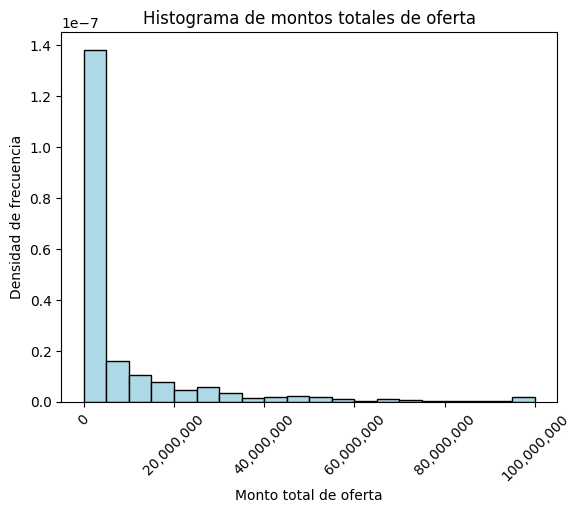

In [47]:
###Test the graph

import numpy as np
import matplotlib.pyplot as plt
import matplotlib.ticker as ticker

variable = "MontoTotalOferta"
df_m = df_sin_na[variable].copy(deep=True)
df_m = df_m[df_m <= 100000000]
# Define the bins
#bins = np.arange(df[variable].min(), df[variable].max(), 400000) #this is the original hist 
bins = np.arange(df_m.min(), df_m.max(), 5000000) # 5M bins

# Histogram
counts, bin_edges = np.histogram(df_m, bins=bins)

# Plotting
plt.hist(df_m, bins=bins, color='lightblue', edgecolor='black', density=True)
#plt.title('Histograma de ' + variable)
plt.title('Histograma de montos totales de oferta')
#plt.xlabel(variable)
plt.xlabel('Monto total de oferta')
plt.ylabel('Densidad de frecuencia')

# Format x-axis labels
#ax = plt.gca()
#ax.xaxis.set_major_formatter(ticker.FuncFormatter(lambda x, pos: '{:,.0f}'.format(x)))
# Format x-axis labels
ax = plt.gca()
ax.xaxis.set_major_formatter(ticker.FuncFormatter(lambda x, pos: '{:,.0f}'.format(x)))

# Rotate x-axis labels
plt.xticks(rotation=45)
# Format y-axis labels
#ax.yaxis.set_major_formatter(ticker.FuncFormatter(lambda y, _: '{:.10f}'.format(y)))

plt.show()


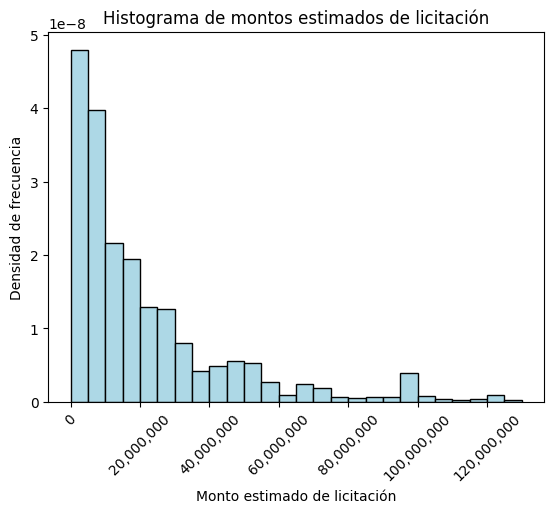

In [48]:
###Test the graph
variable = "MontoEstimadoLicitacion"
df_m = df_sin_na[variable].copy(deep=True)
df_m = df_m[df_m <= 130900000]
# Define the bins
#bins = np.arange(df[variable].min(), df[variable].max(), 400000) #this is the original hist 
bins = np.arange(df_m.min(), df_m.max(), 5000000) # 5M bins

# Histogram
counts, bin_edges = np.histogram(df_m, bins=bins)

# Plotting
plt.hist(df_m, bins=bins, color='lightblue', edgecolor='black', density=True)
#plt.title('Histograma de ' + variable)
plt.title('Histograma de montos estimados de licitación')
#plt.xlabel(variable)
plt.xlabel('Monto estimado de licitación')
plt.ylabel('Densidad de frecuencia')

# Format x-axis labels
#ax = plt.gca()
#ax.xaxis.set_major_formatter(ticker.FuncFormatter(lambda x, pos: '{:,.0f}'.format(x)))
# Format x-axis labels
ax = plt.gca()
ax.xaxis.set_major_formatter(ticker.FuncFormatter(lambda x, pos: '{:,.0f}'.format(x)))

# Rotate x-axis labels
plt.xticks(rotation=45)
# Format y-axis labels
#ax.yaxis.set_major_formatter(ticker.FuncFormatter(lambda y, _: '{:.10f}'.format(y)))

plt.show()

In [49]:
describe_nulls(df_mayor_100)

,MontoEstimadoLicitacion,TiempoDuracionContrato,CantidadItem,CantidadOferta,MontoNetoOferta,MontoTotalOferta
count,1113887.0,1113887.0,1113887.0,1113887.0,1113887.0,1113887.0
mean,459020206.481078,87.68287,16407.204735,9064.640922,177967815.556544,10243068521.725258
std,18316970087.113201,59263.624423,701409.921649,579862.737582,12481568604.375912,6223106708226.203125
min,100.0,0.0,0.1,0.0,0.0,0.0
25%,7200424.0,0.0,1.0,0.0,0.0,0.0
50%,19119711.0,0.0,2.0,1.0,38736.6566,510000.0
75%,56694887.0,10.0,20.0,8.0,4123529.0,17100000.0
max,1500548138262.0,44227650.0,140400000.0,140400000.0,1500548138262.0,5985330976200000.0
nulos,0.0,0.0,0.0,0.0,0.0,0.0
porcentaje de nulos,0.00%,0.00%,0.00%,0.00%,0.00%,0.00%


In [50]:
describe_nulls_num(df_mayor_100)

,NroLicitacion,NombreLicitacion,TipoLicitacion,Descripcion,MonedaLicitacion,MontoEstimadoVisible,BaseEstimacionMontoLicitacion,FechaPublicacion,FechaInicioPreguntas,FechaFinalPreguntas,FechaPublicacionRespuestas,FechaActoAperturaTecnica,FechaActoAperturaEconomica,FechaCierre,FechaAdjudicacion,UnidadTiempoEvaluacion,EstadoLicitacion,ContemplaObrasPublicas,TipoAprobacionAdjudicacion,NumeroActaAprobacion,FechaActaAprobacion,TipoConvocatoria,NroEtapasLicitacion,SubContratacion,TomaRazonContraloria,PublicidadOfertasTecnicas,Contrato,UnidadTiempoDuracionContrato,TipoEjecucion,PlazoPagoContrato,TipoPago,ExtensionPlazo,UnidadCompra,UnidadCompraRUT,Institucion,RubroN1,RubroN2,RubroN3,ONUProducto,NombreItem,DescripcionItem,UnidadMedida,Proveedor,ProveedorRUT,ActividadProveedor,TamanoProveedor,NombreOferta,EstadoOferta,ResultadoOferta
count,1113887,1113887,1113887,1113887,1113887,1113887,1113887,1113887,1113887,1113887,1113887,1113887,1113887,1113887,1113887,1113887,1113887,1113887,1113887,1113887,1113887,1113887,1113887,1113887,1113887,1113887,1113887,1113887,1113887,1113887,1113887,1113887,1113887,1113887,1113887,1113887,1113887,1113887,1113887,1113887,1113887,1113887,1113887,1113887,1113887,1113887,1113887,1113887,1113887
unique,40825,39099,10,39786,5,2,3,40661,32223,20539,18798,22885,23003,16209,40796,4,5,2,6,13556,1430,2,2,2,2,2,3,4,2,3,3,2,1519,511,256,55,332,1591,6914,6987,143774,90,25938,25948,14540,5,119667,2,2
top,45-22-LR23,Adquisición de libros para Programa Bibliometro,Licitación Pública Entre 100 y 1000 UTM (LE),La presente licitación tiene por objeto regula...,CLP,NO,Presupuesto disponible,26-04-2023 11:41:00,26-04-2023 18:00:00,15-05-2023 18:00:00,18-05-2023 18:15:00,01-06-2023 15:02:00,01-06-2023 15:02:00,01-06-2023 15:01:00,06-10-2023 10:35:17,Horas,Adjudicada,NO,Resolucion,3603,05-10-2023 0:00:00,Abierta,Una etapa,No,No,Si,No,Horas,Contrato de Ejecucion Inmediata,A 30 dias,Cheque,NO,SUBDIRECCIÓN DE BIBLIOTECAS PÚBLICAS,60.905.000-4,DIRECCION GENERAL DE GENDARMERIA DE CHIL,Productos impresos y publicaciones,Medios impresos,Publicaciones impresas,Libros de referencias para bibliotecas,Libros de referencias para bibliotecas,Adquisición de los Servicios de Desarrollo y M...,Unidad,CENTRO DE EVALUACION Y CERTIFICACION DE COMPET...,76.177.214-7,OTRAS ACTIVIDADES EMPRESARIALES N.C.P.,Micro,Oferta 1,Aceptada,Ganadora
freq,25034,29586,708184,25034,1092523,564408,725706,25037,25070,25056,25034,25042,25042,25047,25034,999139,1110879,1109849,1017112,25034,25874,1112945,1070788,564408,1078839,1102890,405703,667757,709428,1101081,629772,929166,64019,129423,177155,178639,151629,151629,73299,73299,489,874337,22362,22362,34974,365932,6368,1035578,586305
nulos,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
porcentaje de nulos,0.00%,0.00%,0.00%,0.00%,0.00%,0.00%,0.00%,0.00%,0.00%,0.00%,0.00%,0.00%,0.00%,0.00%,0.00%,0.00%,0.00%,0.00%,0.00%,0.00%,0.00%,0.00%,0.00%,0.00%,0.00%,0.00%,0.00%,0.00%,0.00%,0.00%,0.00%,0.00%,0.00%,0.00%,0.00%,0.00%,0.00%,0.00%,0.00%,0.00%,0.00%,0.00%,0.00%,0.00%,0.00%,0.00%,0.00%,0.00%,0.00%


In [54]:
import matplotlib.pyplot as plt
import seaborn as sns
import matplotlib.ticker as mtick

def remover_outliers_y_graficar(df, columna, iteracion):
    # Graficar el boxplot antes de remover outliers
    plt.figure(figsize=(15, 6))
    sns.boxplot(x=columna, data=df)
    plt.ticklabel_format(style='plain', axis='x')
    plt.gca().xaxis.set_major_formatter(mtick.StrMethodFormatter('{x:,.0f}'))

    # Calcule el primer y tercer cuartil y la mediana después de remover outliers
    Q1 = df[columna].quantile(0.25)
    Q3 = df[columna].quantile(0.75)
    median = df[columna].median()

    # Calcule el rango intercuartílico (IQR)
    IQR = Q3 - Q1

    # Defina el límite inferior y superior para outliers
    limite_inferior = Q1 - 1.5 * IQR
    limite_superior = Q3 + 1.5 * IQR

    # Identifique los outliers
    outliers = df[(df[columna] < limite_inferior) | (df[columna] > limite_superior)]
    df_limpiado = df.drop(outliers.index)

    # Obtener las posiciones de los cuartiles y la mediana en el eje x del boxplot
    cuartiles = df[columna].quantile([0.25, 0.75]).values
    median_pos = df[columna].median()

    # Agrega líneas verticales para los cuartiles y la mediana
    plt.axvline(cuartiles[0], color='r', linestyle='--', label='Cuartil 1 (Q1)')
    plt.axvline(cuartiles[1], color='g', linestyle='--', label='Cuartil 3 (Q3)')
    plt.axvline(median_pos, color='b', linestyle='-', label='Mediana')

    # Muestra los valores de los cuartiles y la mediana en el gráfico
    plt.text(cuartiles[0], 0, f'Q1 = {Q1:,.0f}', rotation=0, va='top', ha='right', color='r', bbox=dict(facecolor='white', alpha=0.5))
    plt.text(cuartiles[1], 0, f'Q3 = {Q3:,.0f}', rotation=0, va='top', ha='left', color='g', bbox=dict(facecolor='white', alpha=0.5))
    plt.text(median_pos, 0, f'Mediana = {median:,.0f}', rotation=0, va='bottom', ha='center', color='b', bbox=dict(facecolor='white', alpha=0.5))

    # Muestra los cuartiles en la leyenda
    plt.legend()

    # Muestra información sobre la iteración y los outliers
    plt.title(f"Iteración {iteracion}: Nuevo rango [{df_limpiado[columna].min():,.0f}, {df_limpiado[columna].max():,.0f}], Outliers: {len(outliers)}")
    plt.show()

    return df_limpiado, outliers, df_limpiado

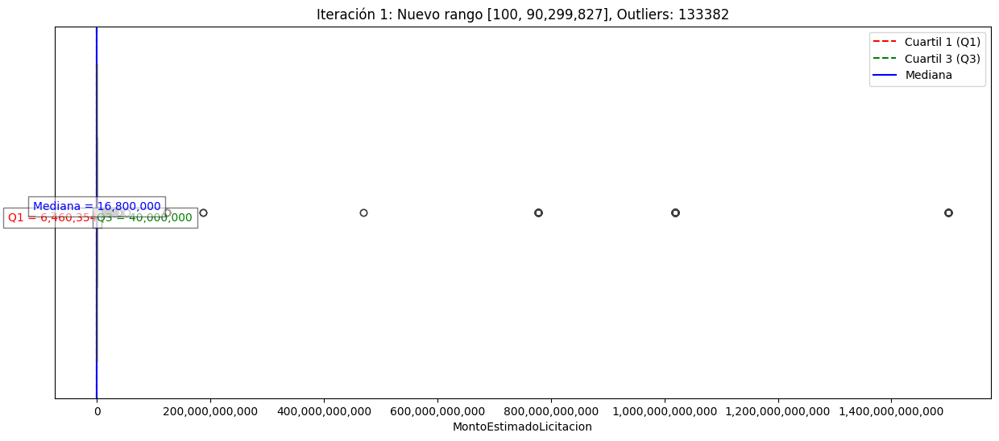

Iteración 1: Nuevo rango [100, 90,299,827]
Max outlier in iteration 1: 1,500,548,138,262


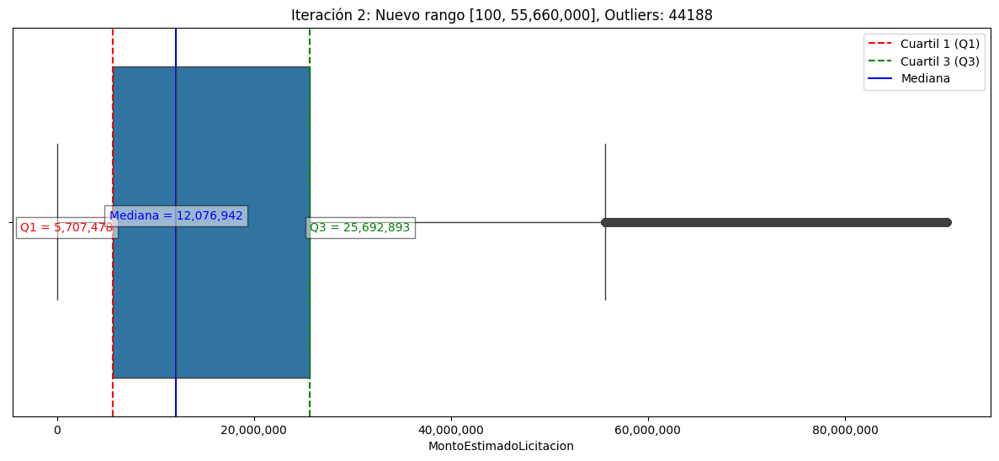

Iteración 2: Nuevo rango [100, 55,660,000]
Max outlier in iteration 2: 90,299,827


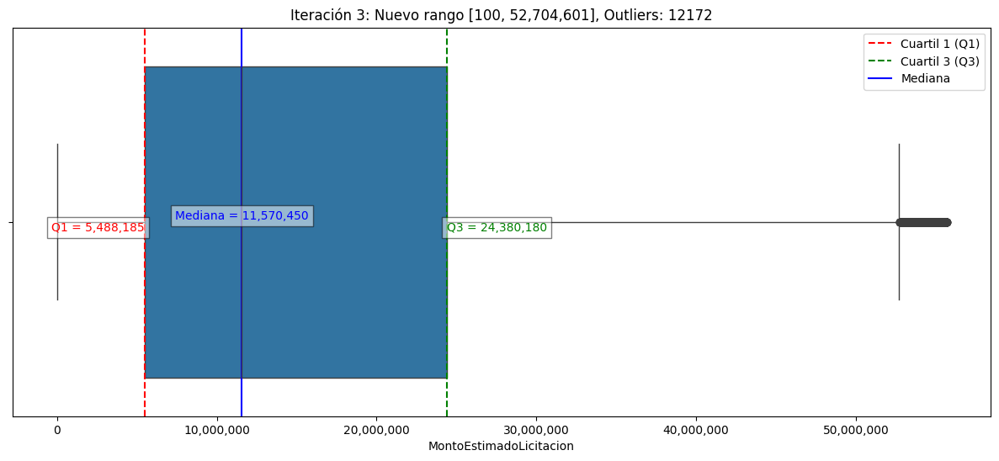

Iteración 3: Nuevo rango [100, 52,704,601]
Max outlier in iteration 3: 55,660,000


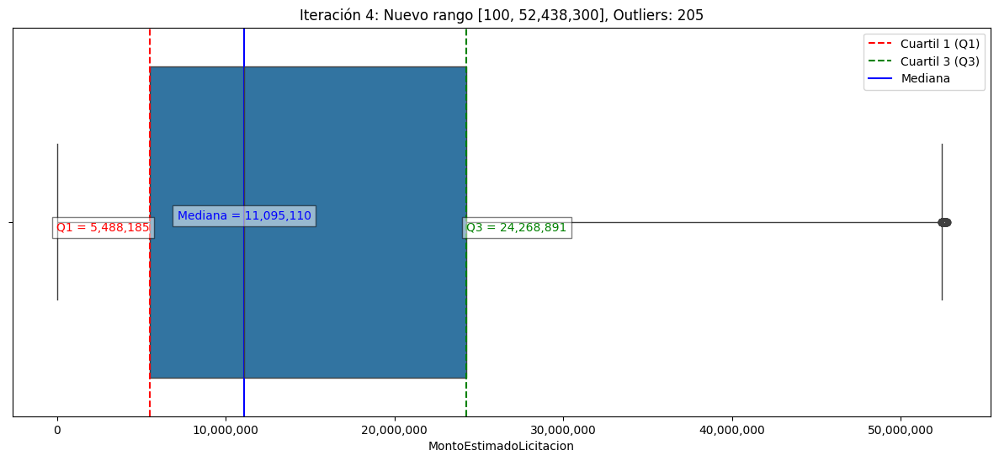

Iteración 4: Nuevo rango [100, 52,438,300]
Max outlier in iteration 4: 52,704,601


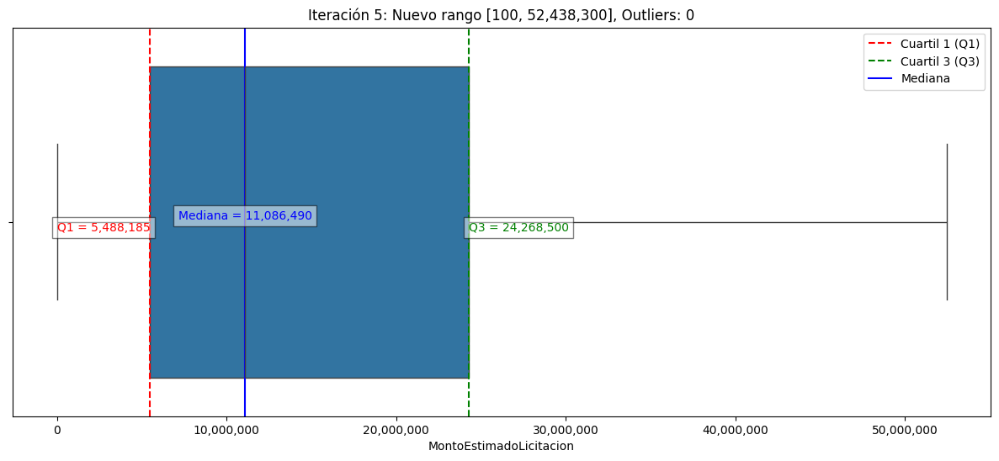

Iteración 5: Nuevo rango [100, 52,438,300]
Max outlier in iteration 5: nan
No se encontraron outliers en esta iteración.


In [55]:
# Cargar el DataFrame
df_cuartiles = df_mayor_final
#df_v = df['MontoTotalOferta'] >= 100
# Iterar hasta que no haya más outliers
#variable = "MontoEstimadoLicitacion"
#df = df_mayor_final[df_mayor_final[variable] > 100]
iteracion = 1
while True:
    df_cuartiles, outliers, df_actualizado = remover_outliers_y_graficar(df_cuartiles, 'MontoEstimadoLicitacion', iteracion)
    #df, outliers, df_actualizado = remover_outliers_y_graficar(df, variable, iteracion)
    nuevo_rango_min = df_actualizado[variable].min()
    nuevo_rango_max = df_actualizado[variable].max()
    print(f"Iteración {iteracion}: Nuevo rango [{nuevo_rango_min:,.0f}, {nuevo_rango_max:,.0f}]")
    max_outlier = outliers[variable].max()
    print(f"Max outlier in iteration {iteracion}: {max_outlier:,.0f}")

    if outliers.empty:
        print("No se encontraron outliers en esta iteración.")
        break
    iteracion += 1

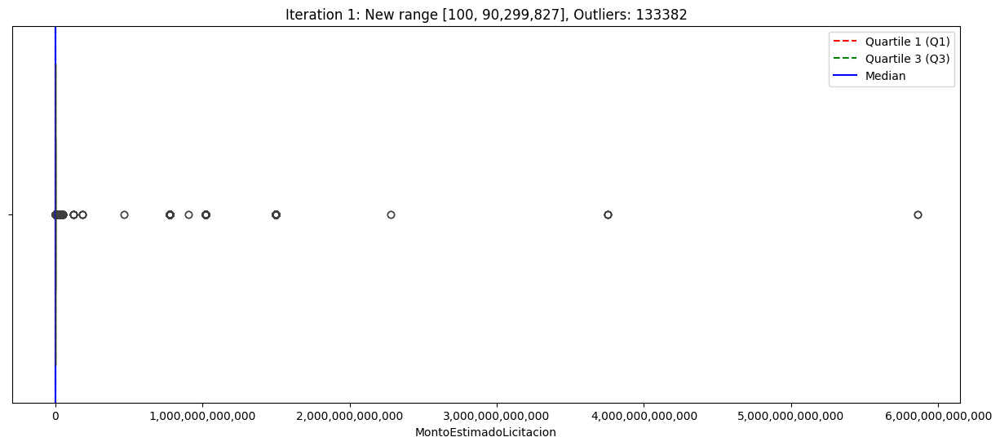

Iteration 1: New range [100, 90,299,827]


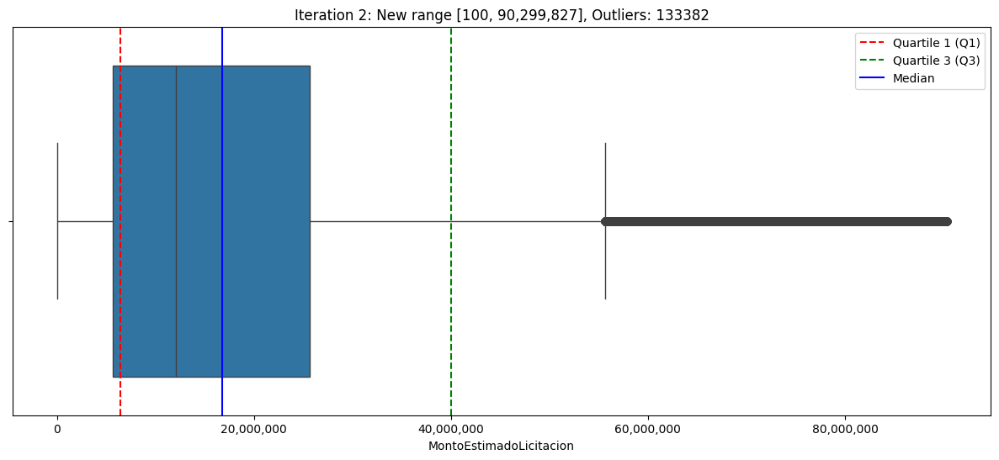

Iteration 2: New range [100, 90,299,827]


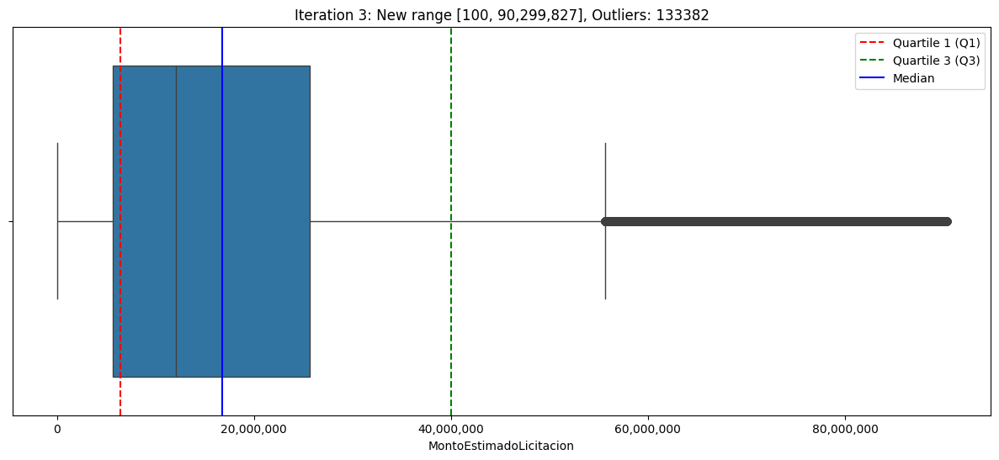

Iteration 3: New range [100, 90,299,827]


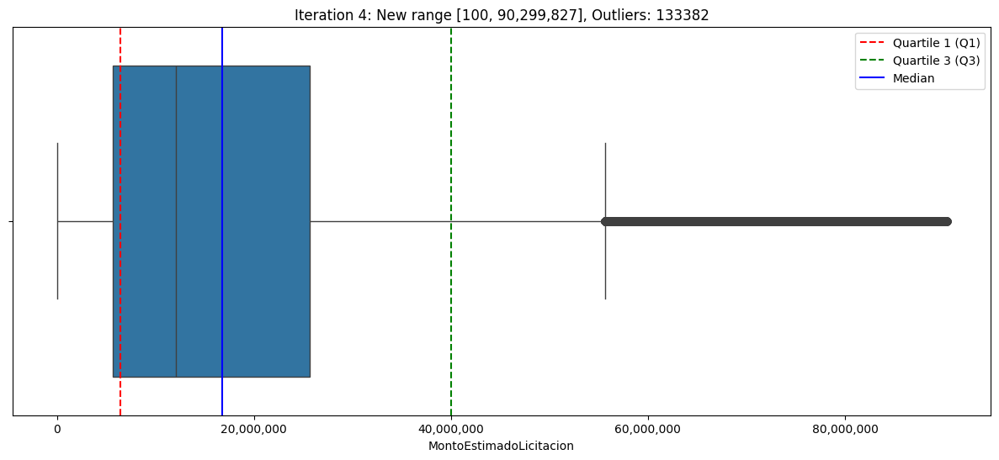

Iteration 4: New range [100, 90,299,827]


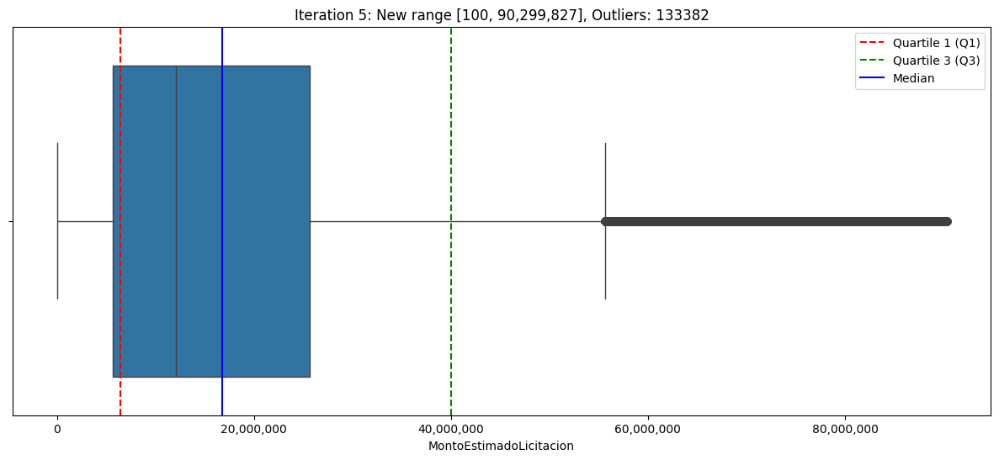

Iteration 5: New range [100, 90,299,827]


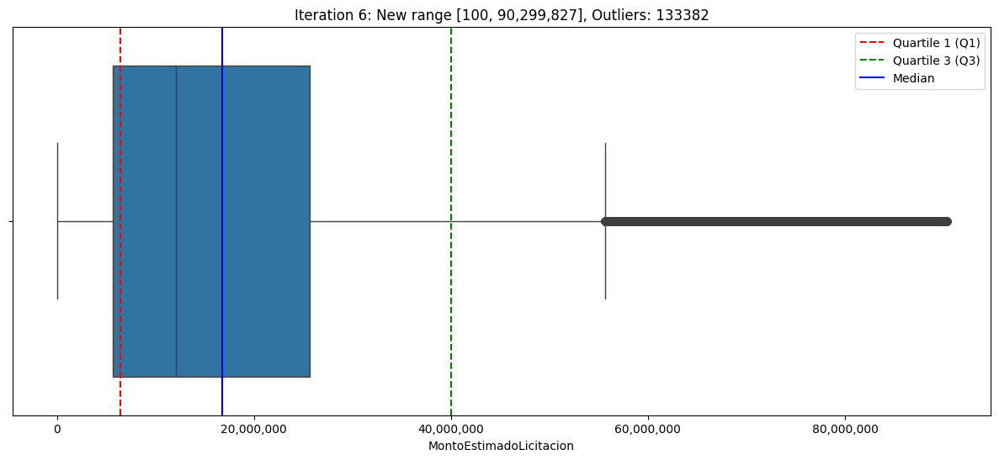

Iteration 6: New range [100, 90,299,827]


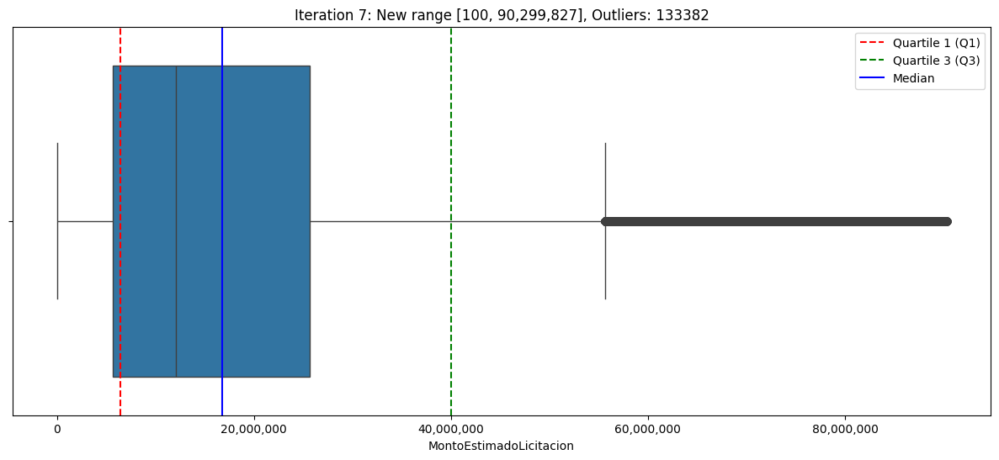

Iteration 7: New range [100, 90,299,827]


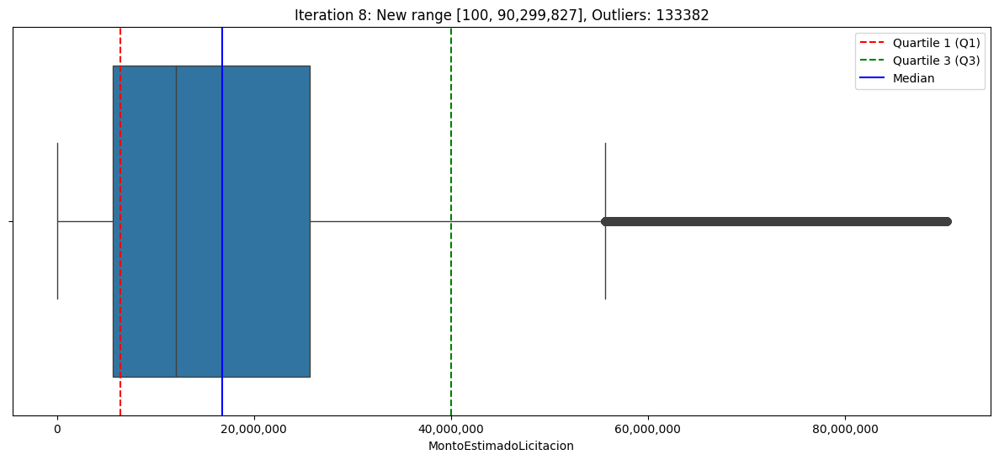

Iteration 8: New range [100, 90,299,827]


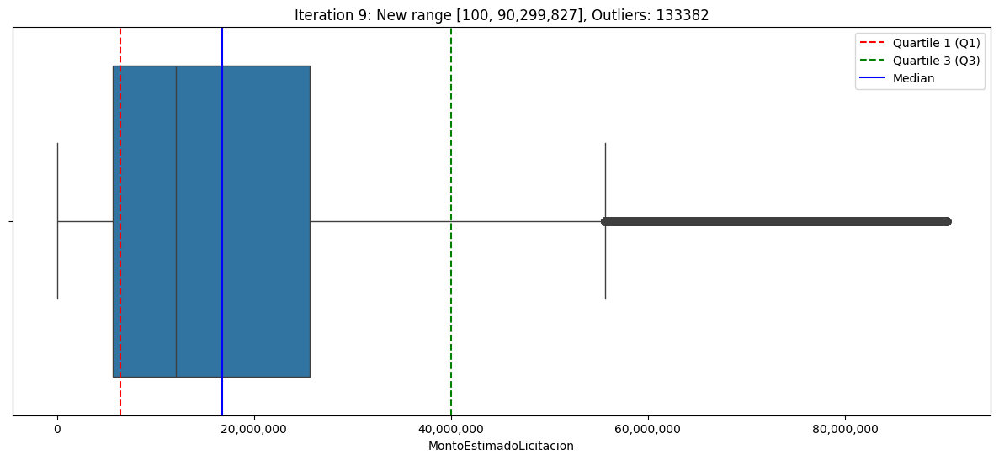

Iteration 9: New range [100, 90,299,827]


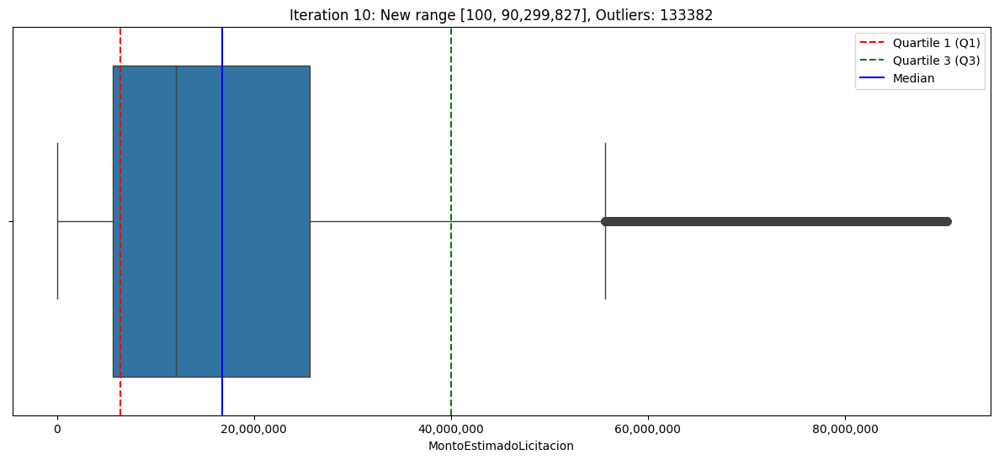

Iteration 10: New range [100, 90,299,827]


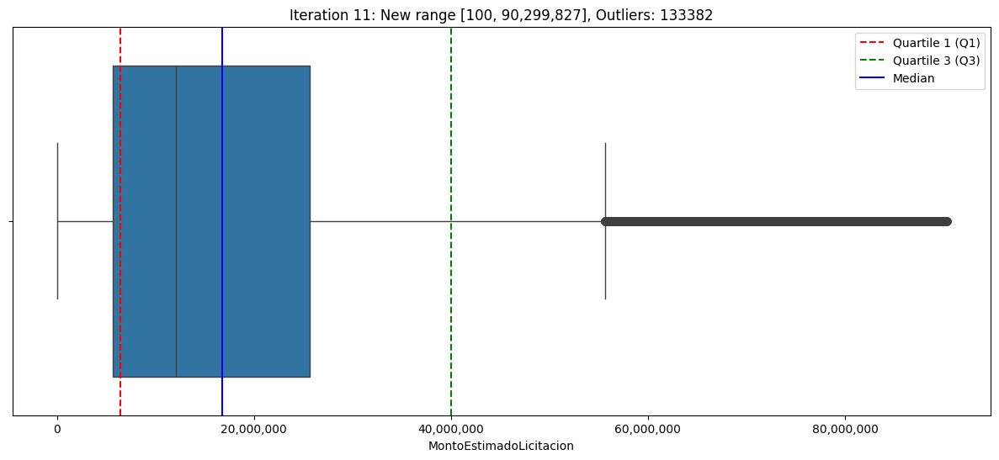

Iteration 11: New range [100, 90,299,827]


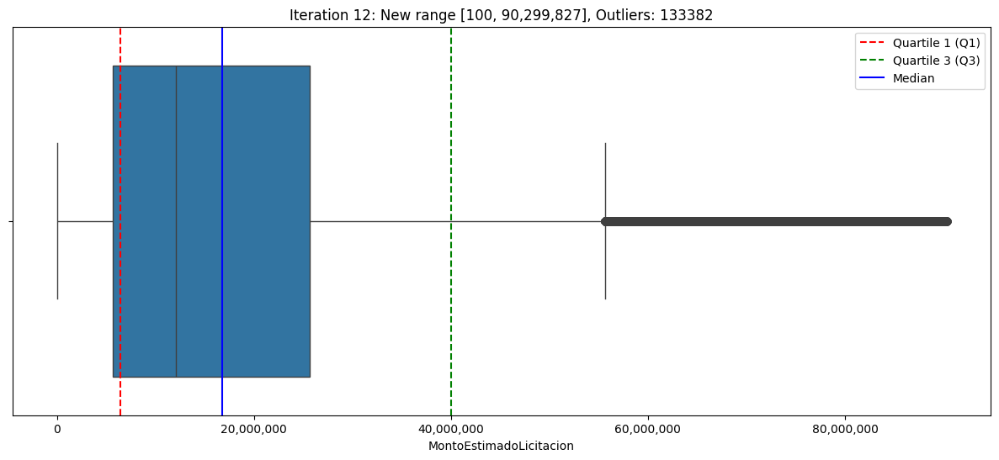

Iteration 12: New range [100, 90,299,827]


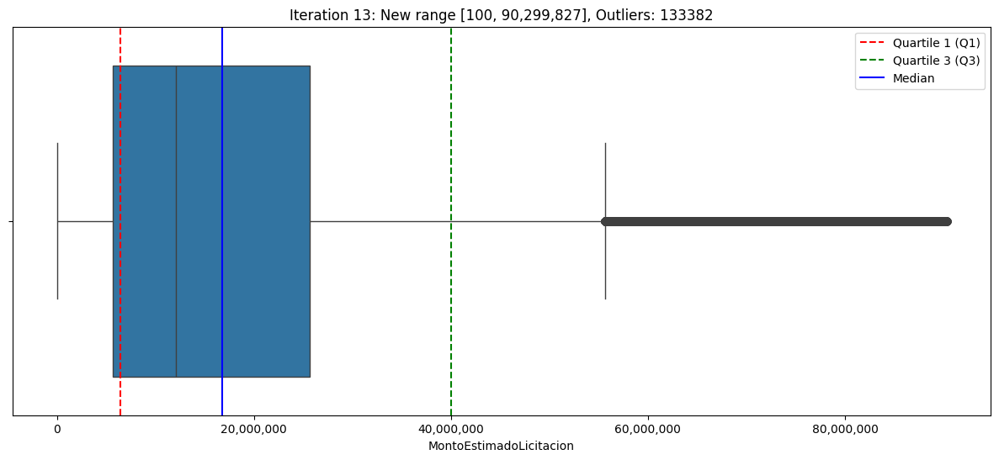

Iteration 13: New range [100, 90,299,827]


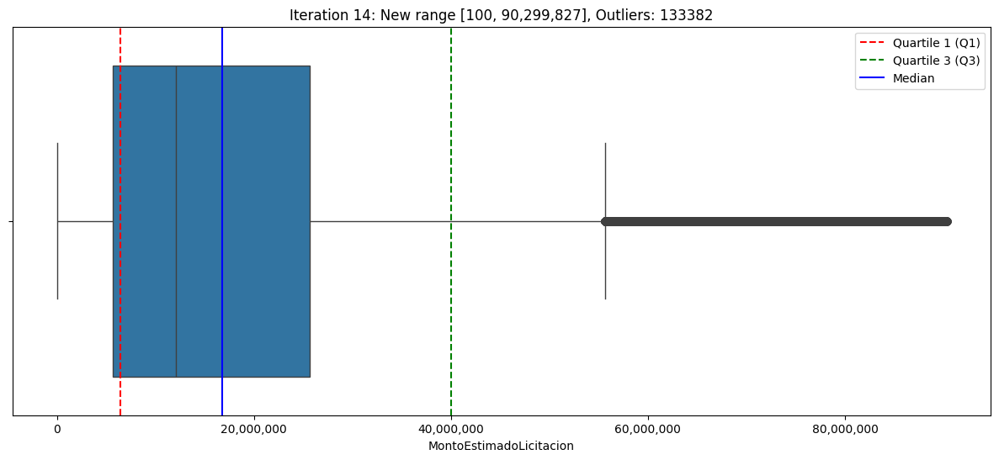

Iteration 14: New range [100, 90,299,827]


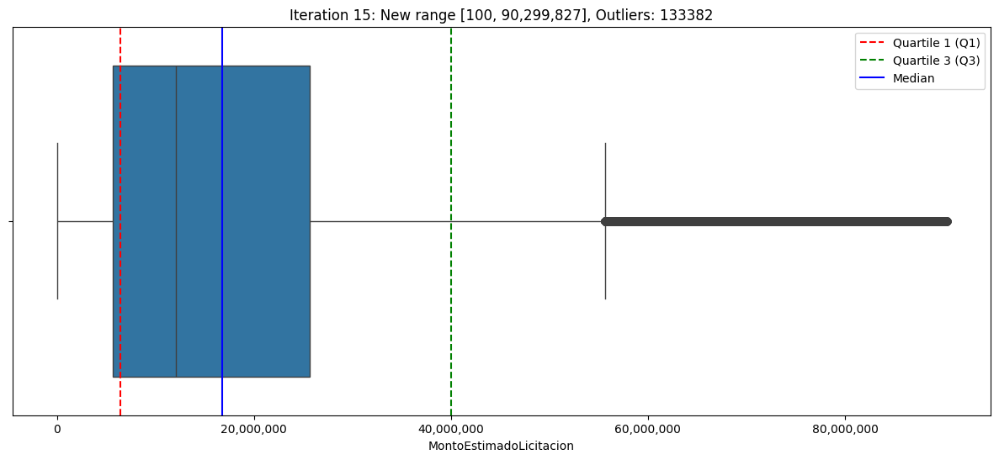

Iteration 15: New range [100, 90,299,827]


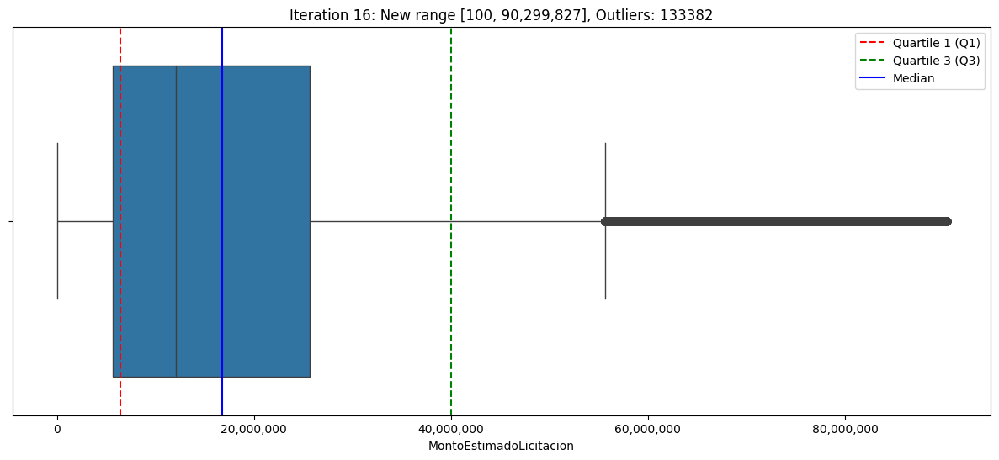

Iteration 16: New range [100, 90,299,827]


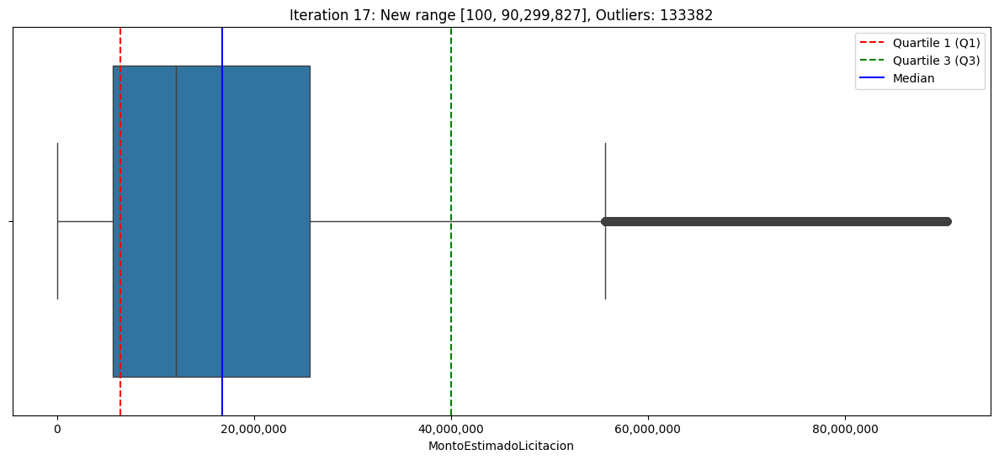

Iteration 17: New range [100, 90,299,827]


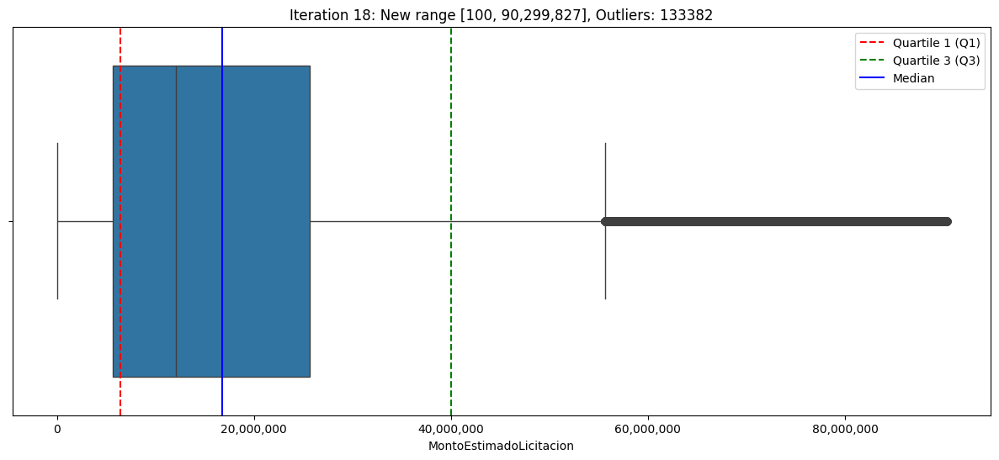

Iteration 18: New range [100, 90,299,827]


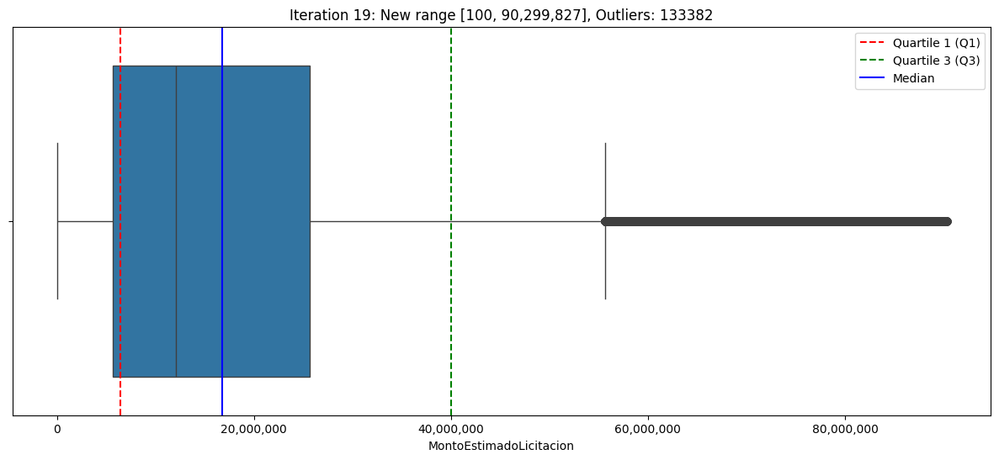

Iteration 19: New range [100, 90,299,827]


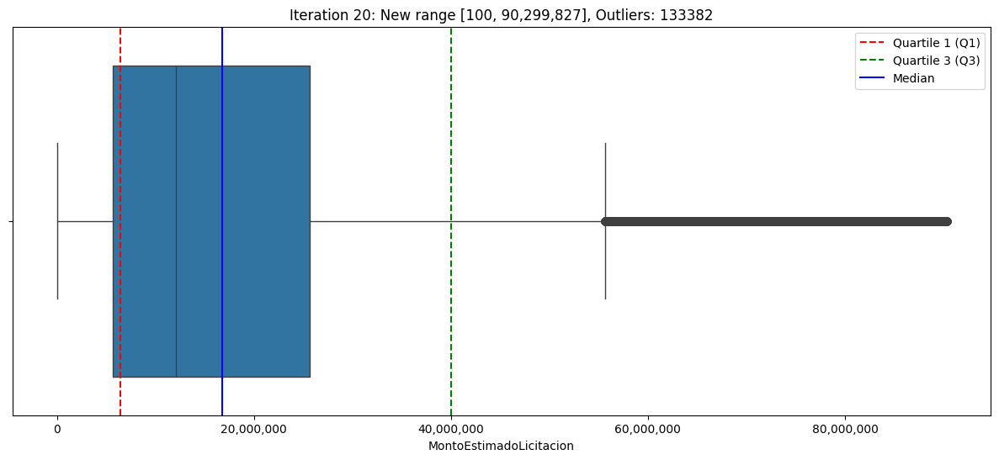

Iteration 20: New range [100, 90,299,827]


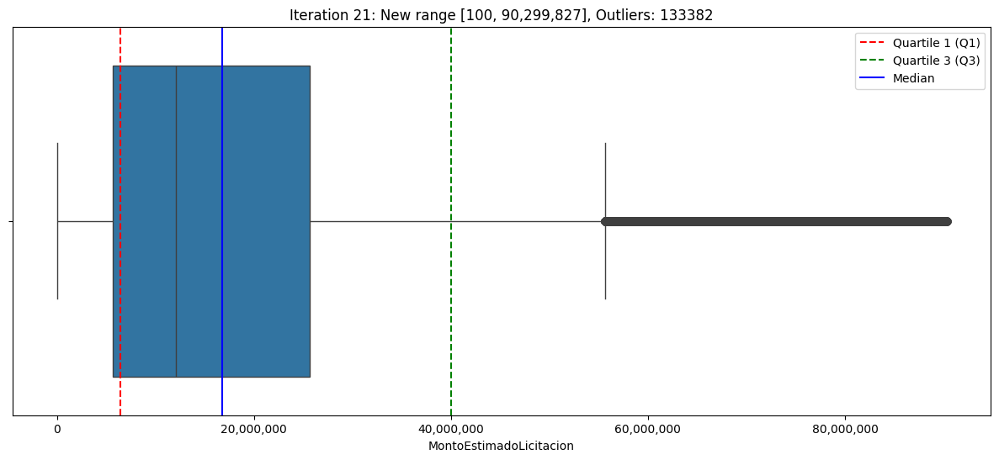

Iteration 21: New range [100, 90,299,827]


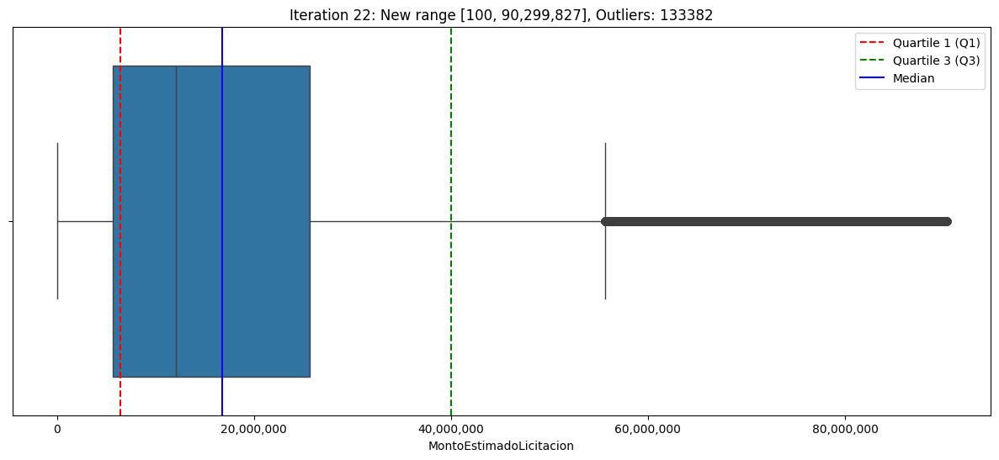

Iteration 22: New range [100, 90,299,827]


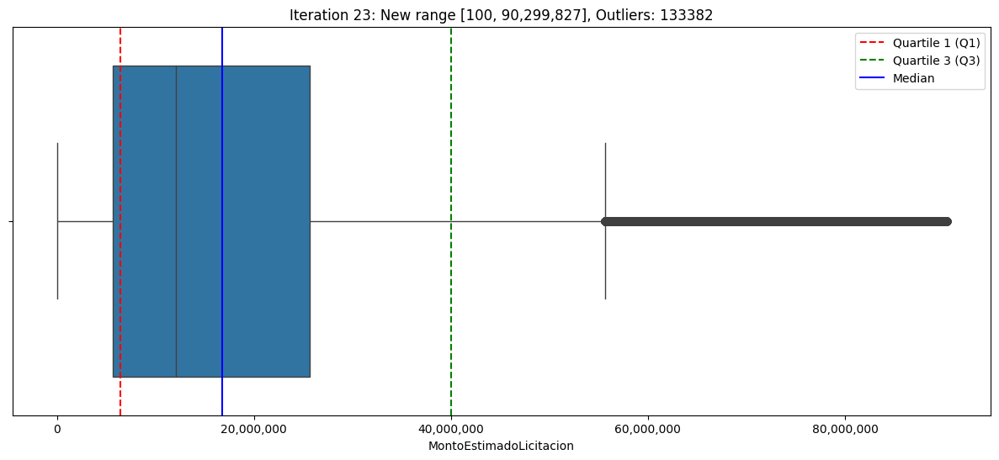

Iteration 23: New range [100, 90,299,827]


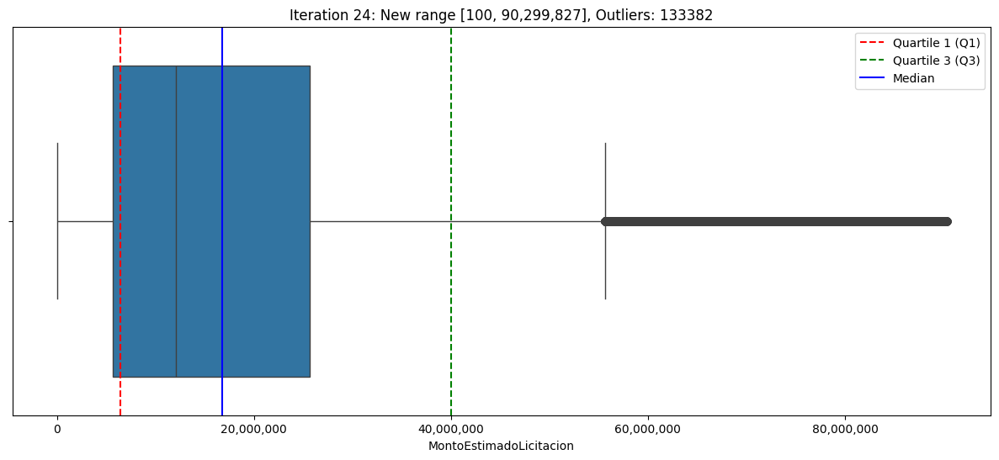

Iteration 24: New range [100, 90,299,827]


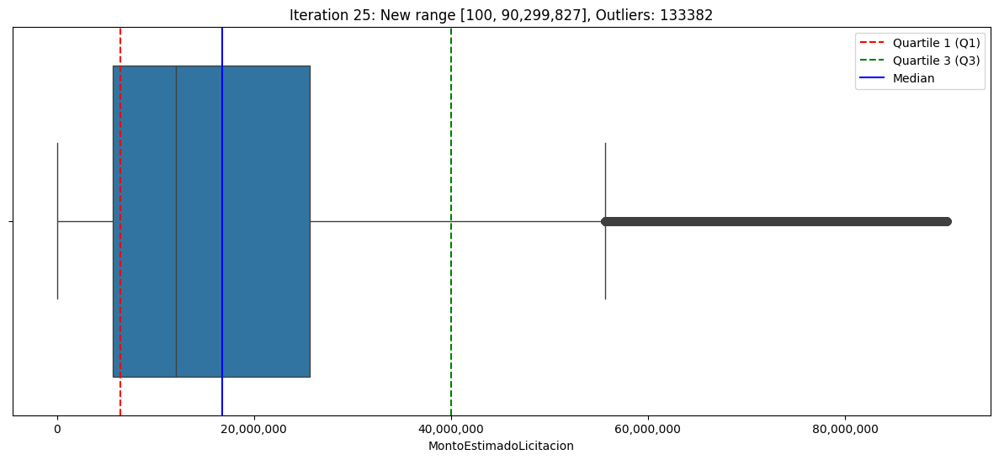

Iteration 25: New range [100, 90,299,827]


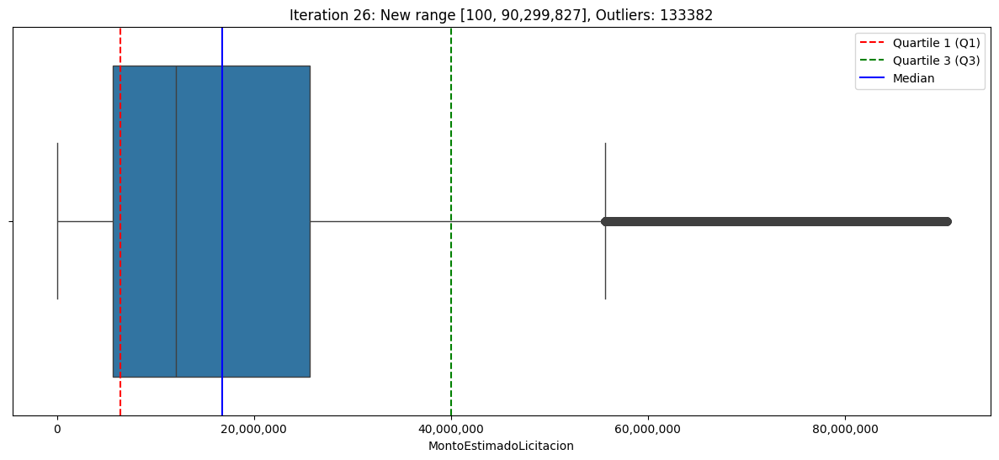

Iteration 26: New range [100, 90,299,827]


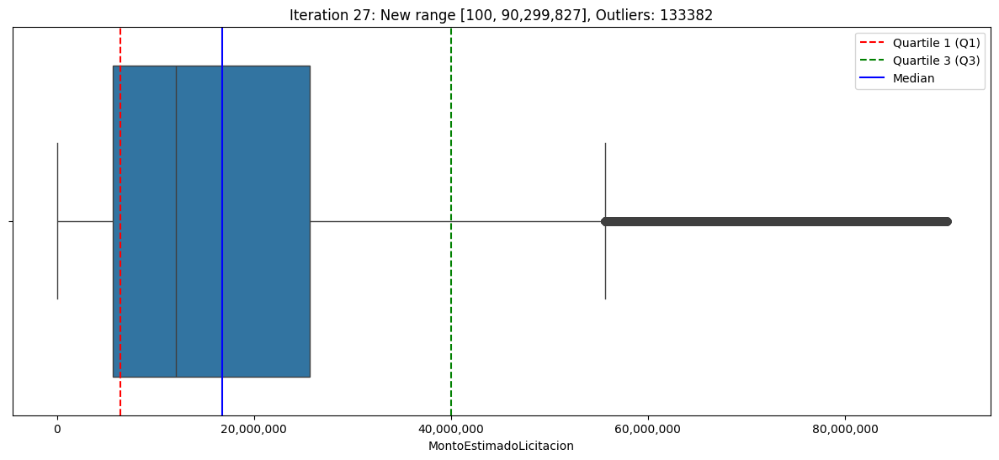

Iteration 27: New range [100, 90,299,827]


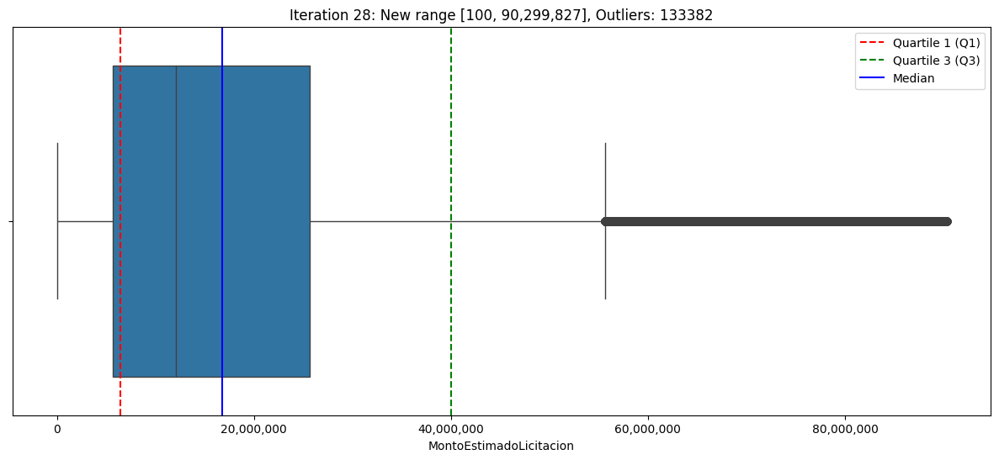

Iteration 28: New range [100, 90,299,827]


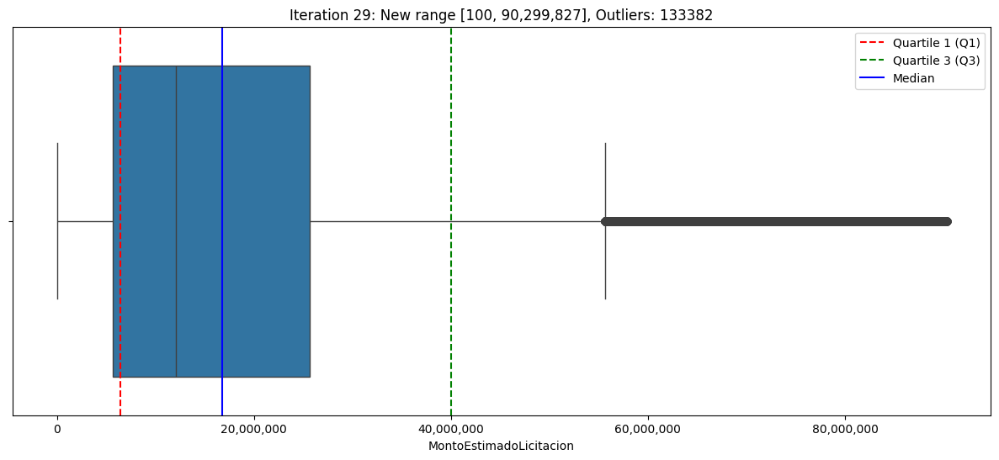

Iteration 29: New range [100, 90,299,827]


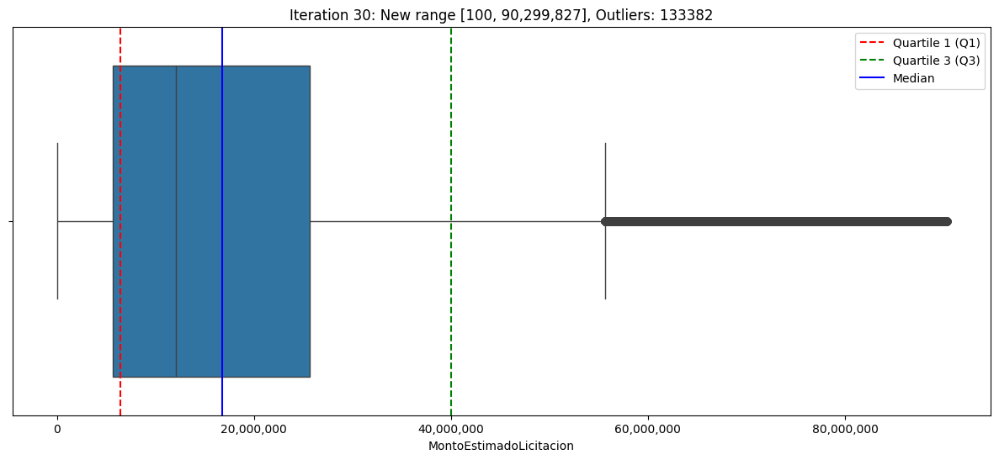

Iteration 30: New range [100, 90,299,827]


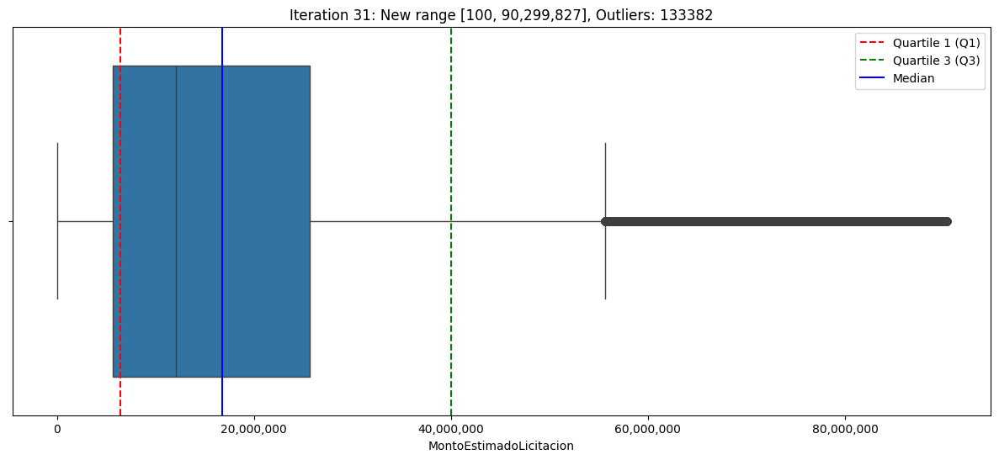

Iteration 31: New range [100, 90,299,827]


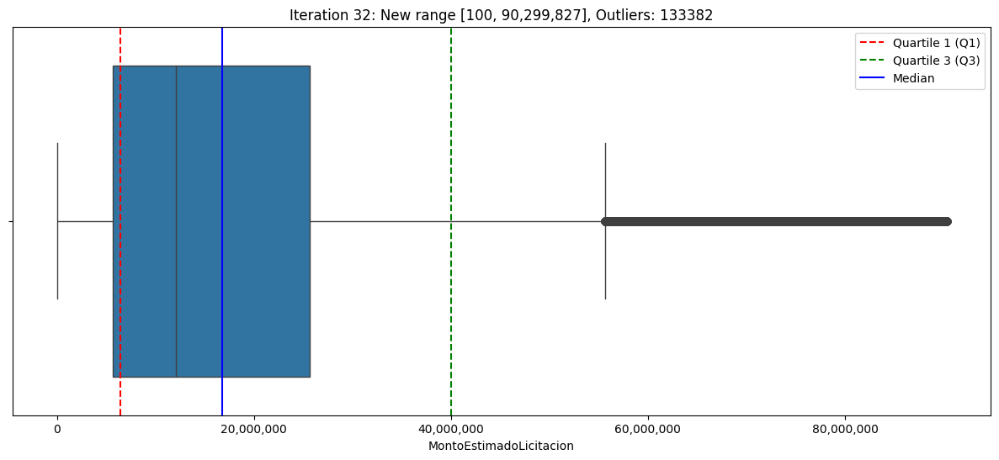

Iteration 32: New range [100, 90,299,827]


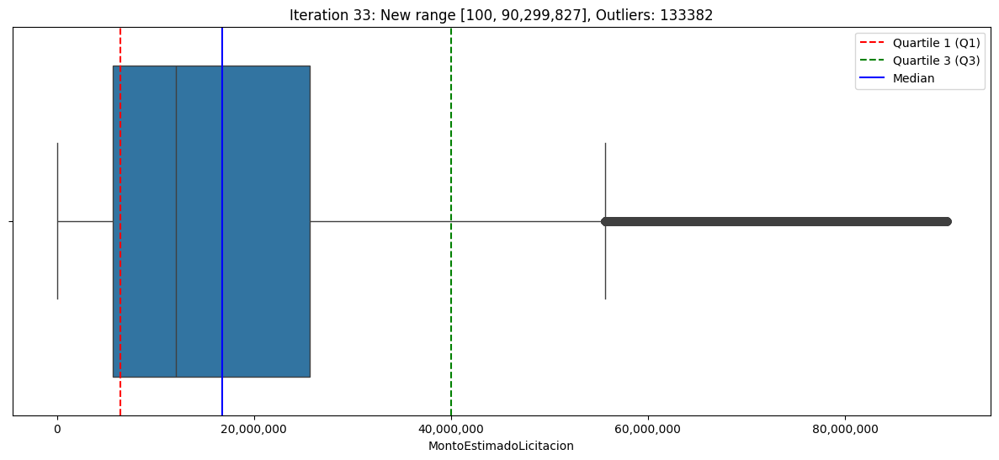

Iteration 33: New range [100, 90,299,827]


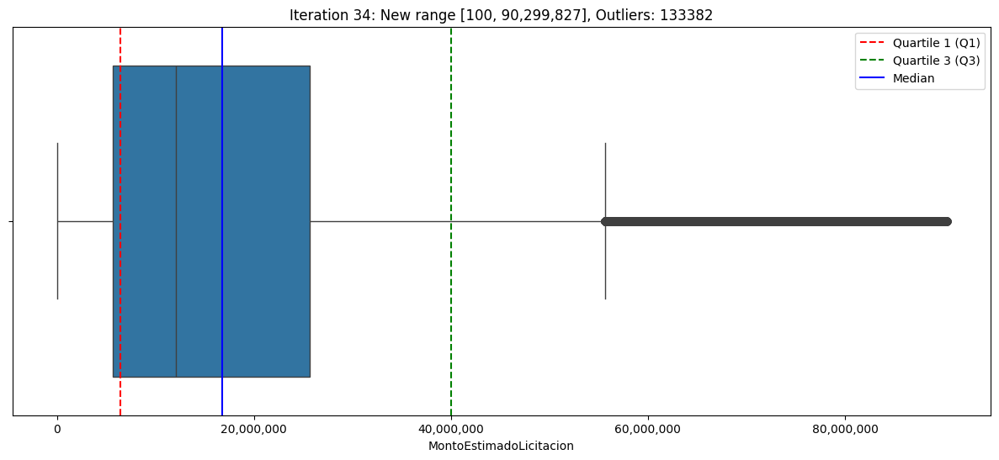

Iteration 34: New range [100, 90,299,827]


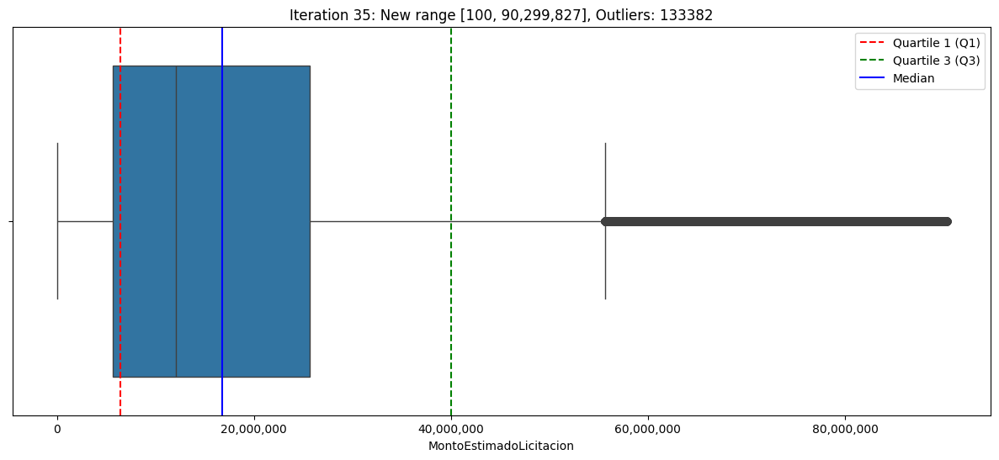

Iteration 35: New range [100, 90,299,827]


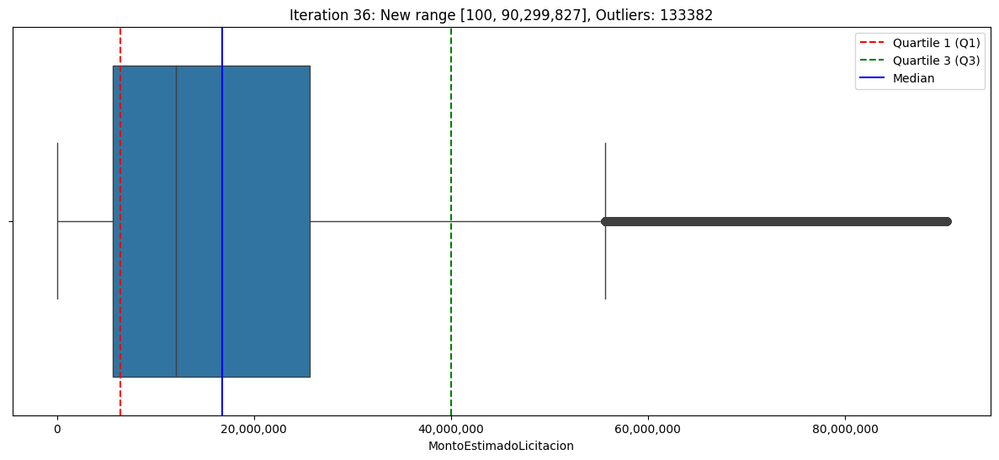

Iteration 36: New range [100, 90,299,827]


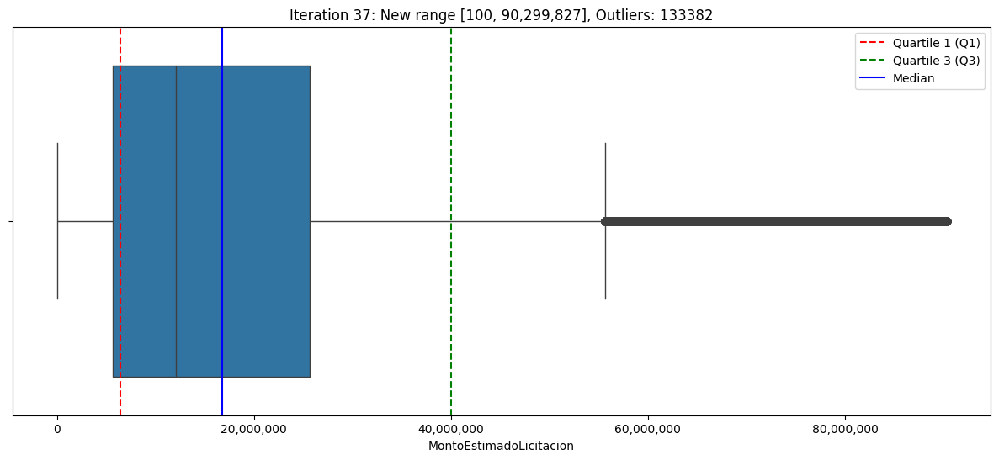

Iteration 37: New range [100, 90,299,827]


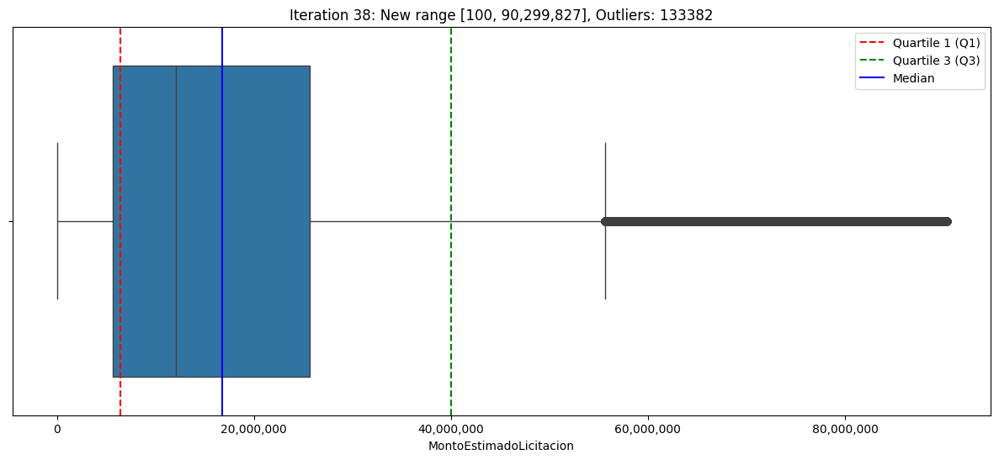

Iteration 38: New range [100, 90,299,827]


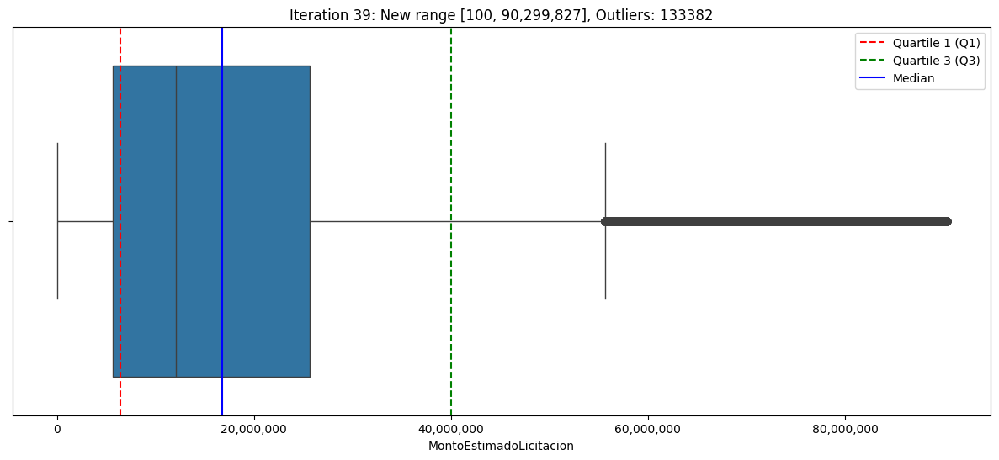

Iteration 39: New range [100, 90,299,827]


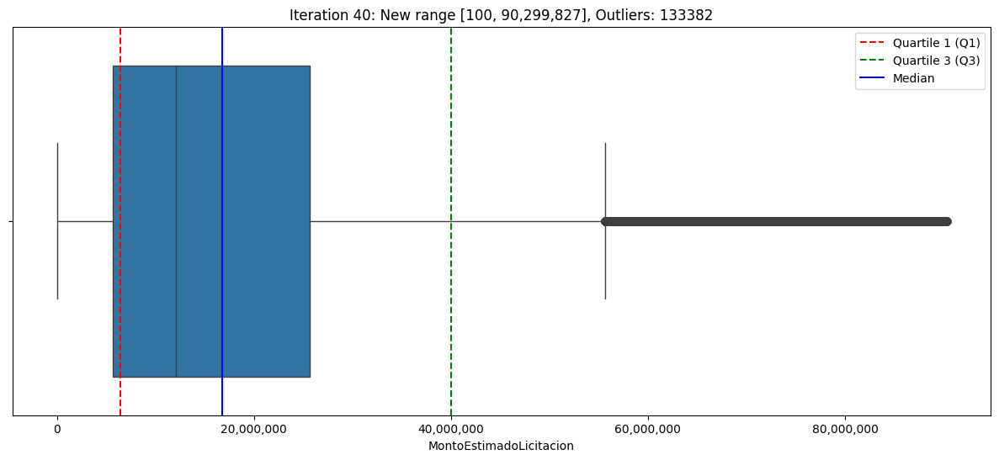

Iteration 40: New range [100, 90,299,827]


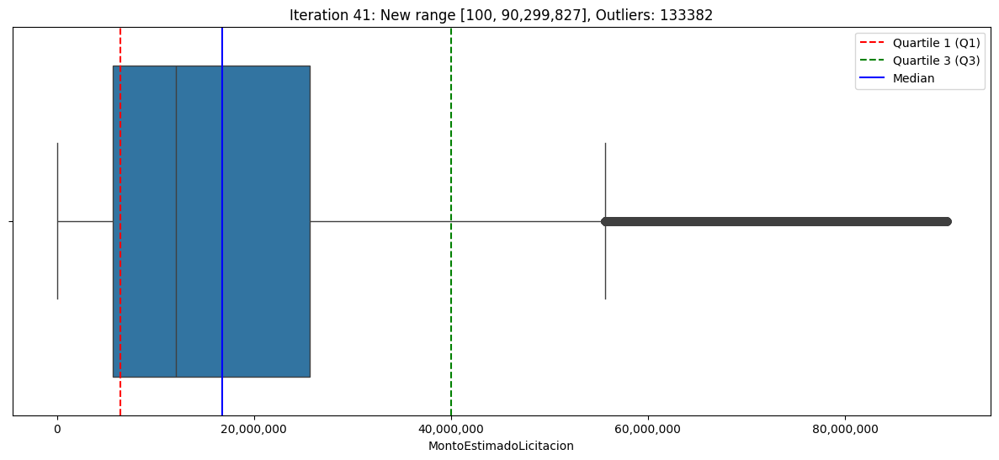

Iteration 41: New range [100, 90,299,827]


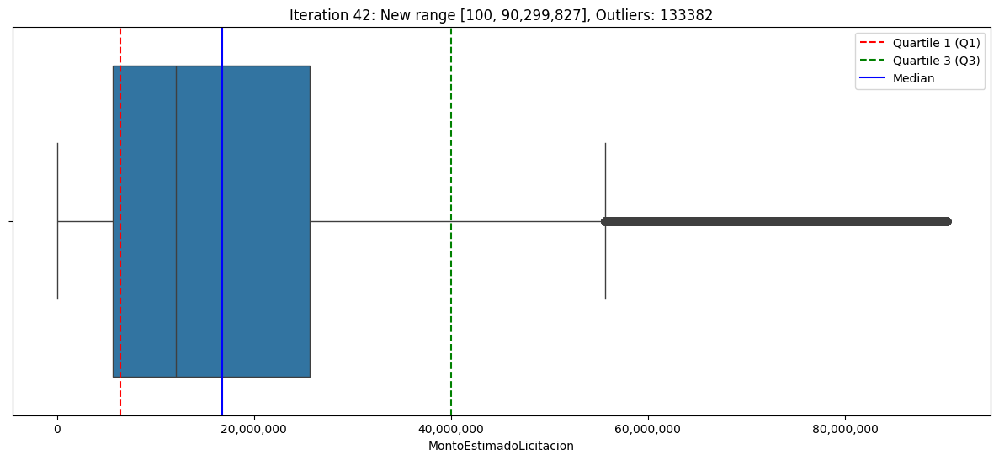

Iteration 42: New range [100, 90,299,827]


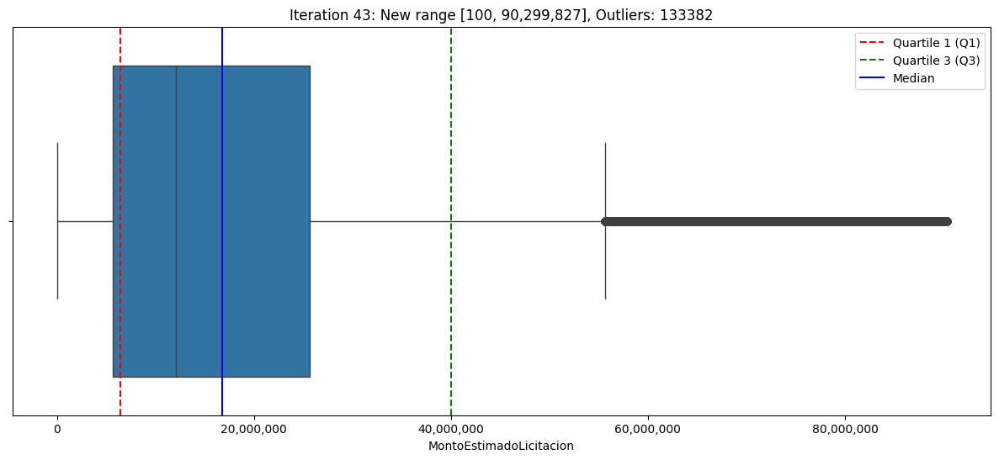

Iteration 43: New range [100, 90,299,827]


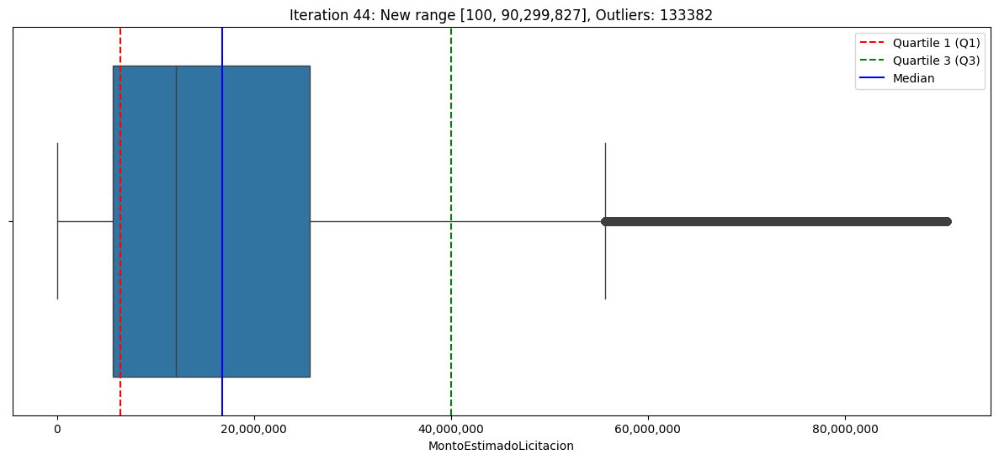

Iteration 44: New range [100, 90,299,827]


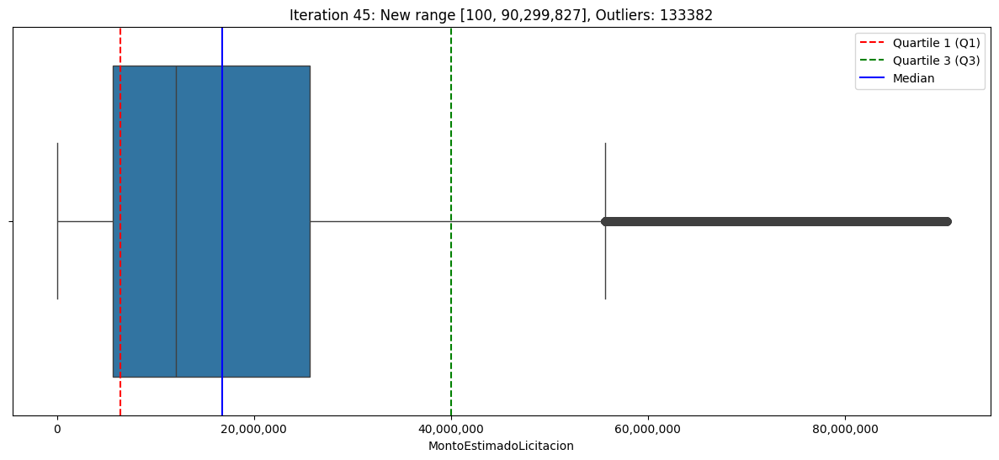

Iteration 45: New range [100, 90,299,827]


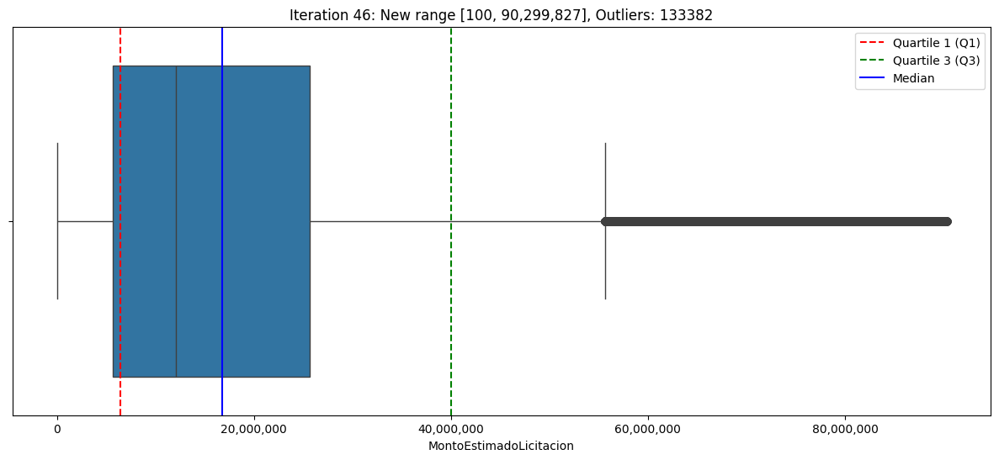

Iteration 46: New range [100, 90,299,827]


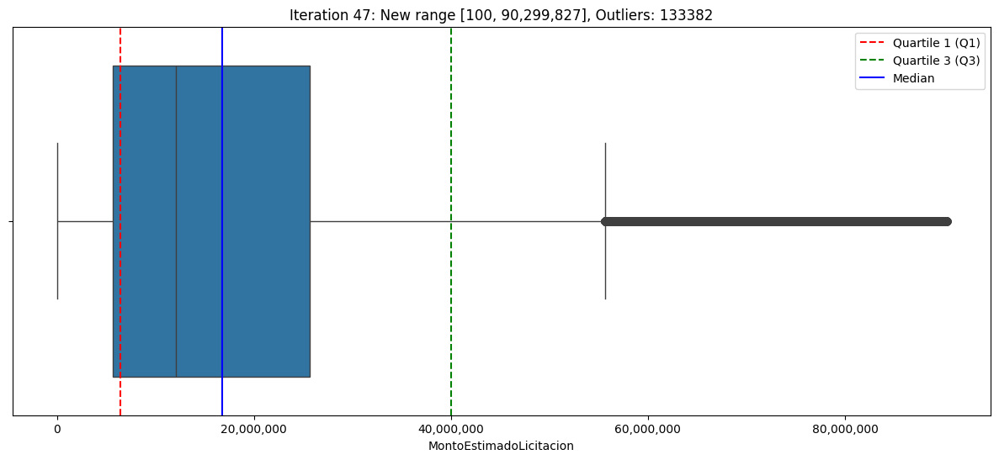

Iteration 47: New range [100, 90,299,827]


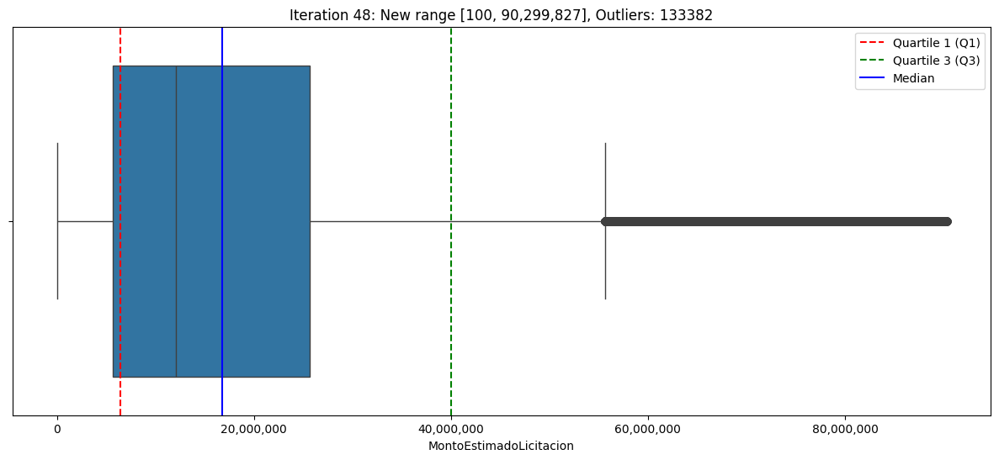

Iteration 48: New range [100, 90,299,827]


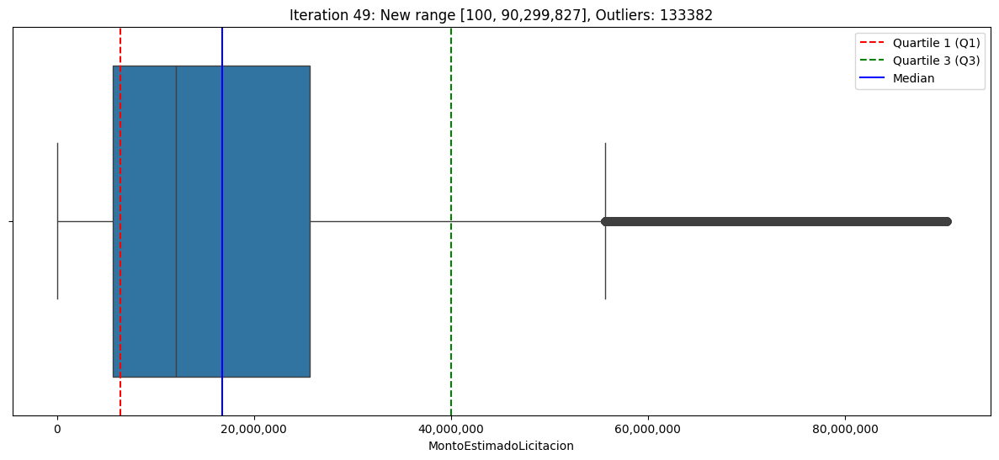

Iteration 49: New range [100, 90,299,827]


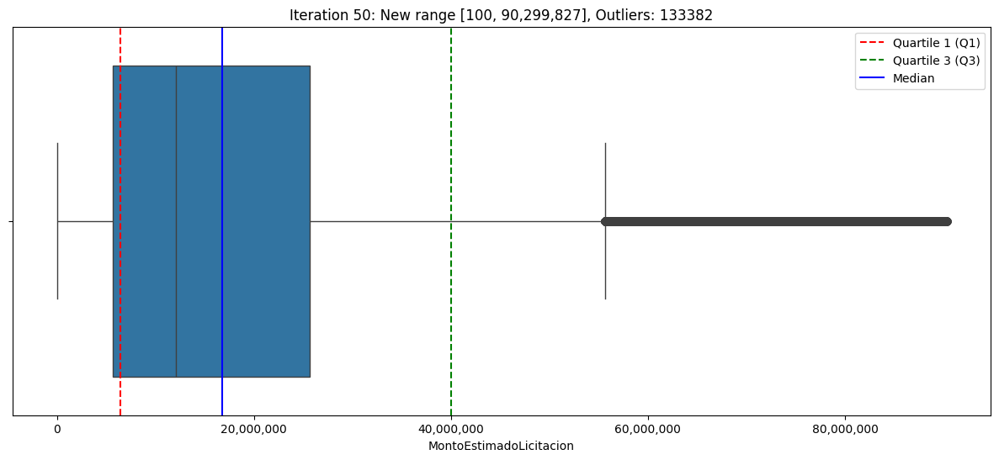

Iteration 50: New range [100, 90,299,827]


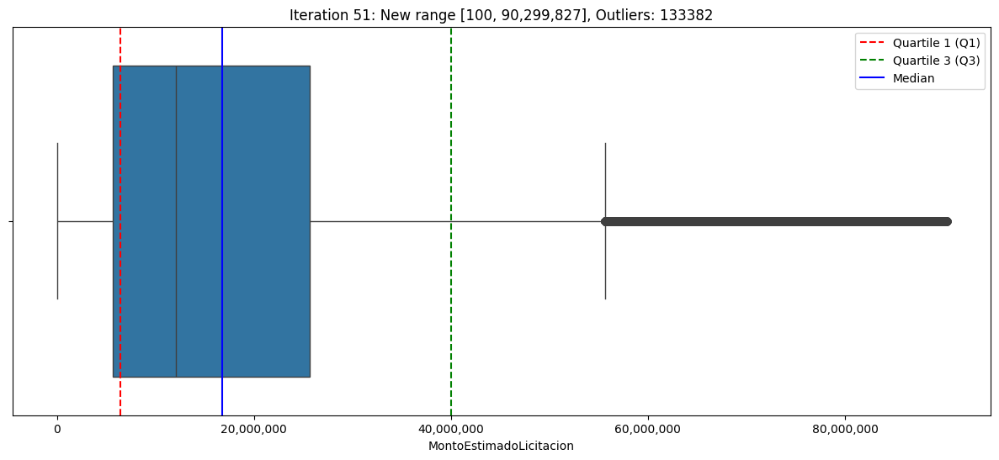

Iteration 51: New range [100, 90,299,827]


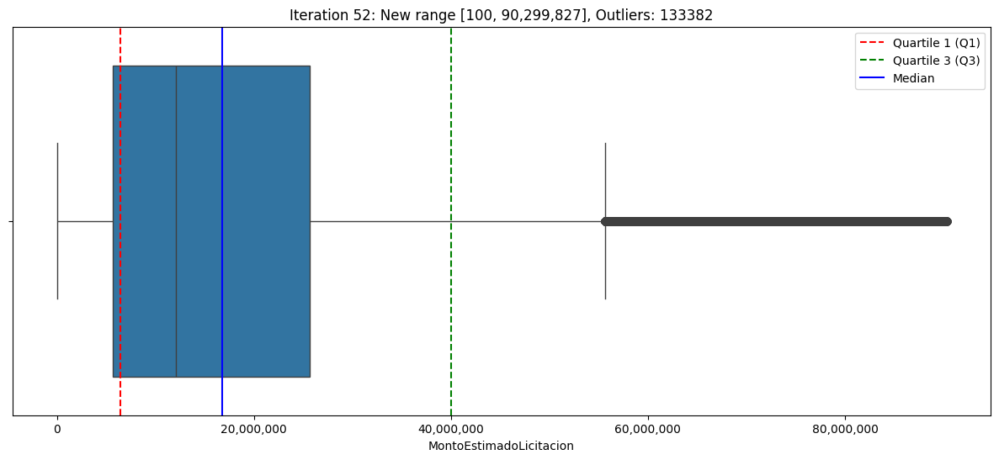

Iteration 52: New range [100, 90,299,827]


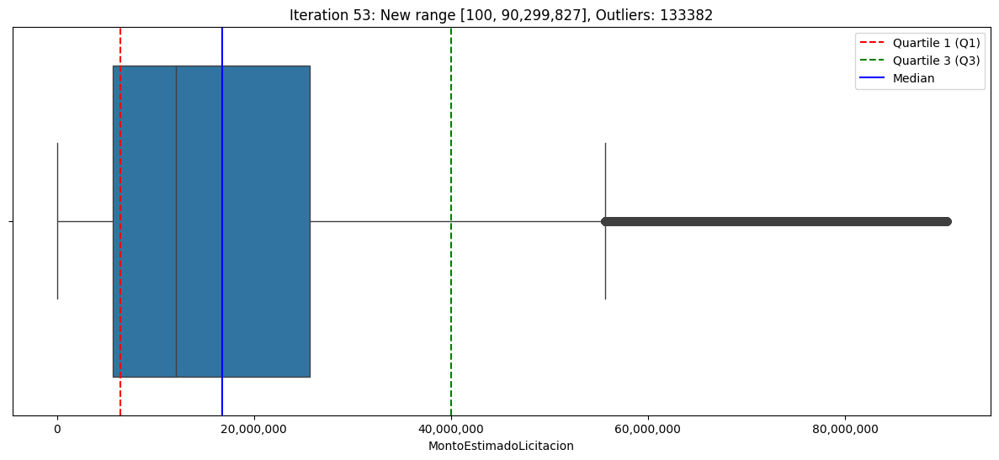

Iteration 53: New range [100, 90,299,827]


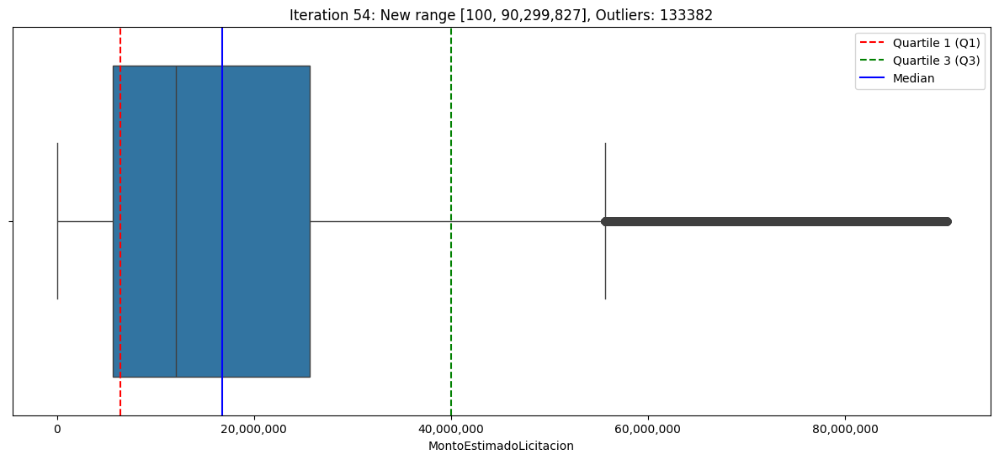

Iteration 54: New range [100, 90,299,827]


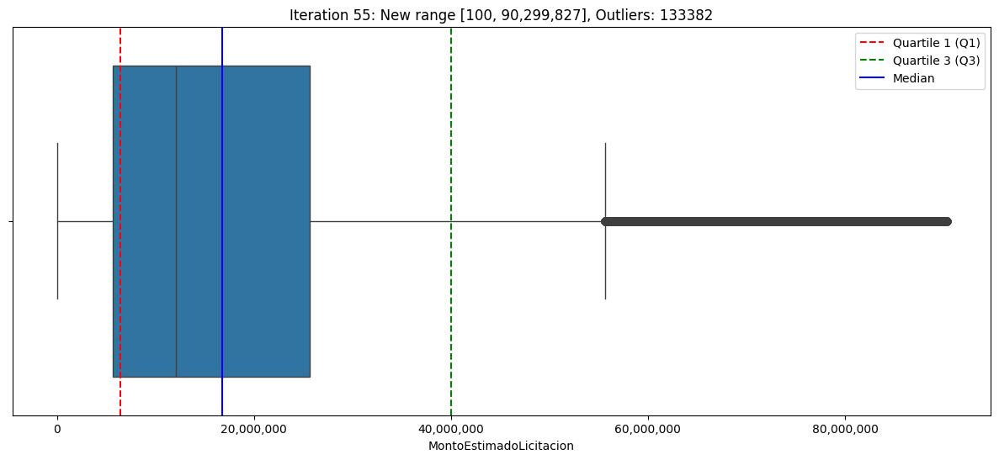

Iteration 55: New range [100, 90,299,827]


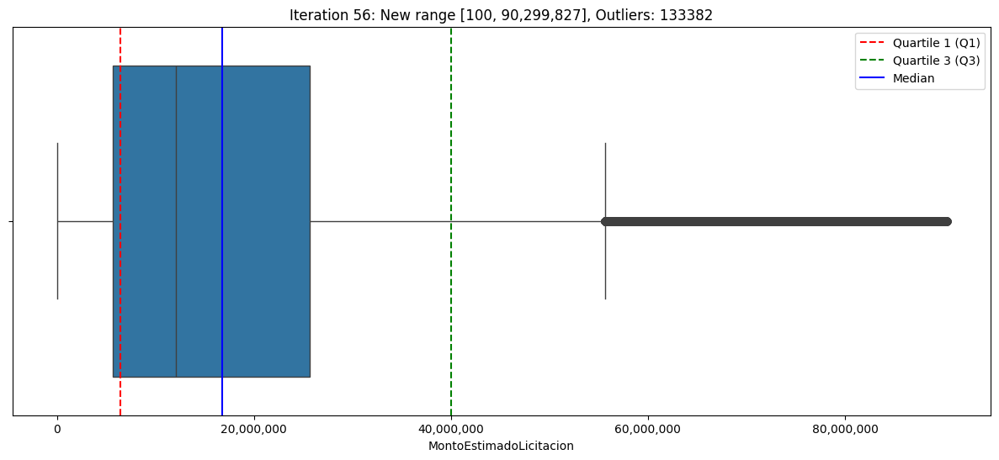

Iteration 56: New range [100, 90,299,827]


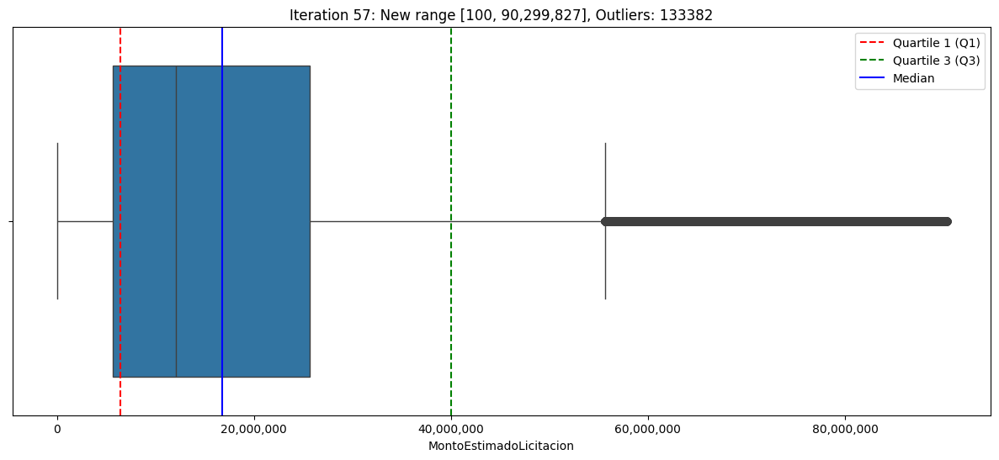

Iteration 57: New range [100, 90,299,827]


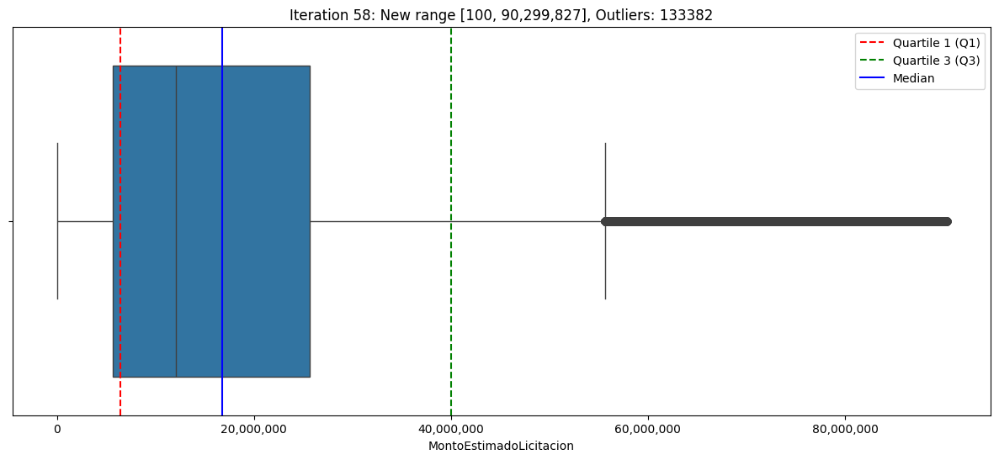

Iteration 58: New range [100, 90,299,827]


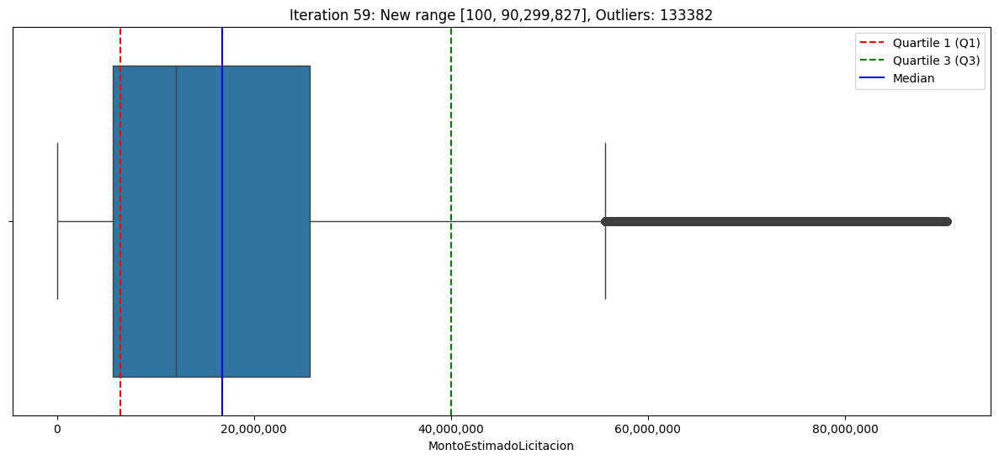

Iteration 59: New range [100, 90,299,827]


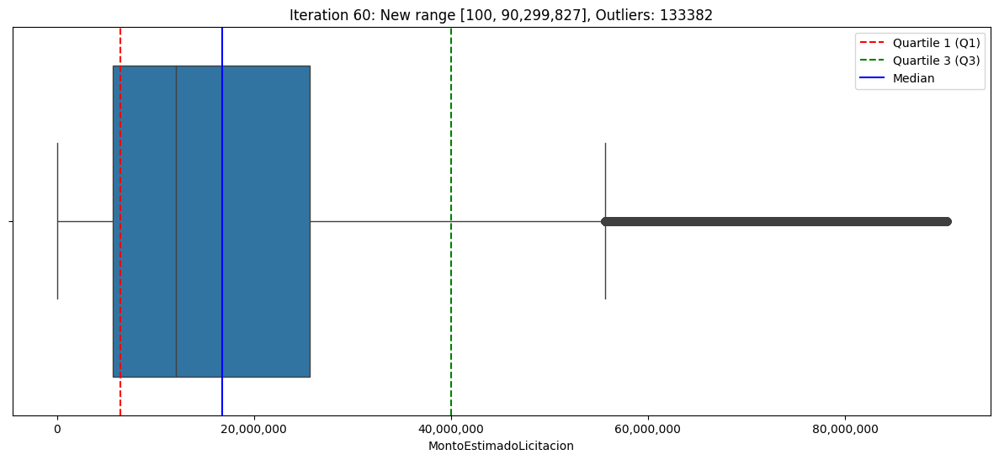

Iteration 60: New range [100, 90,299,827]


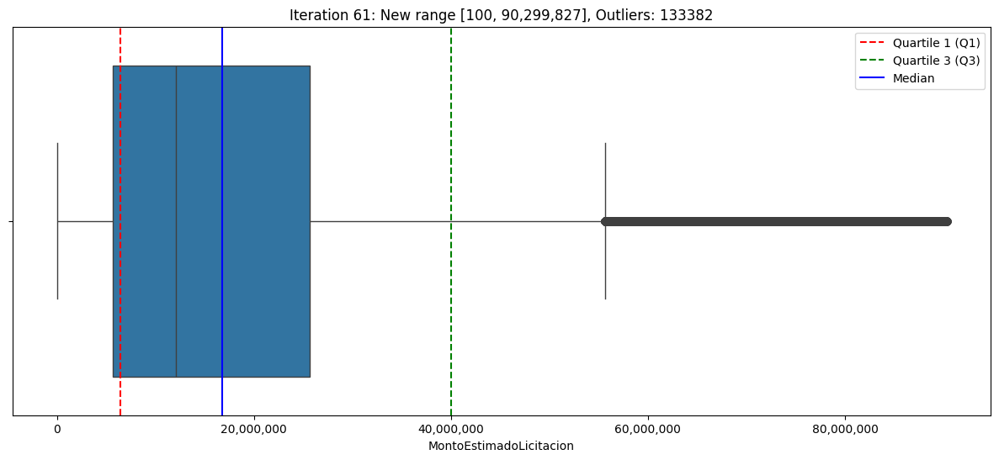

Iteration 61: New range [100, 90,299,827]


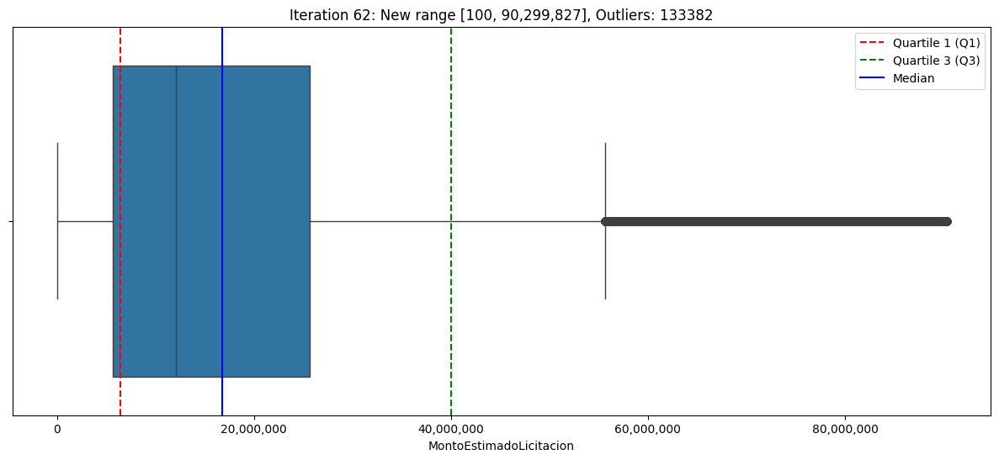

Iteration 62: New range [100, 90,299,827]


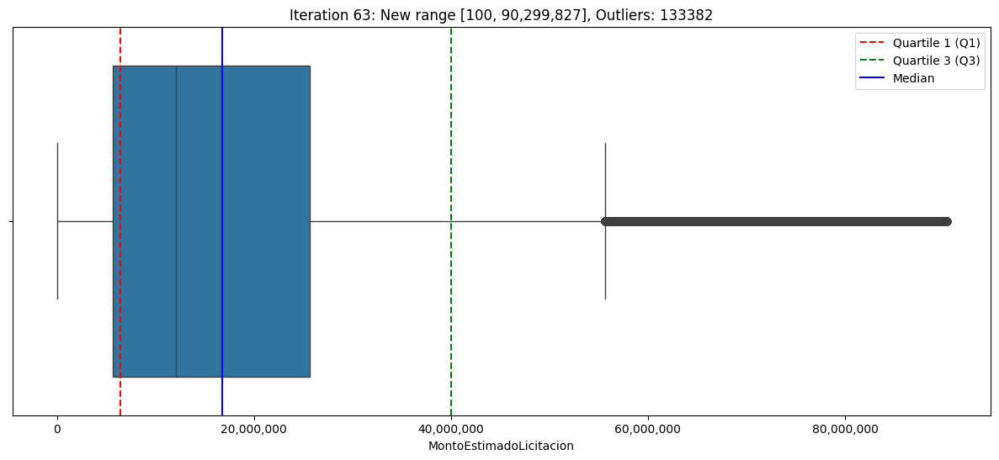

Iteration 63: New range [100, 90,299,827]


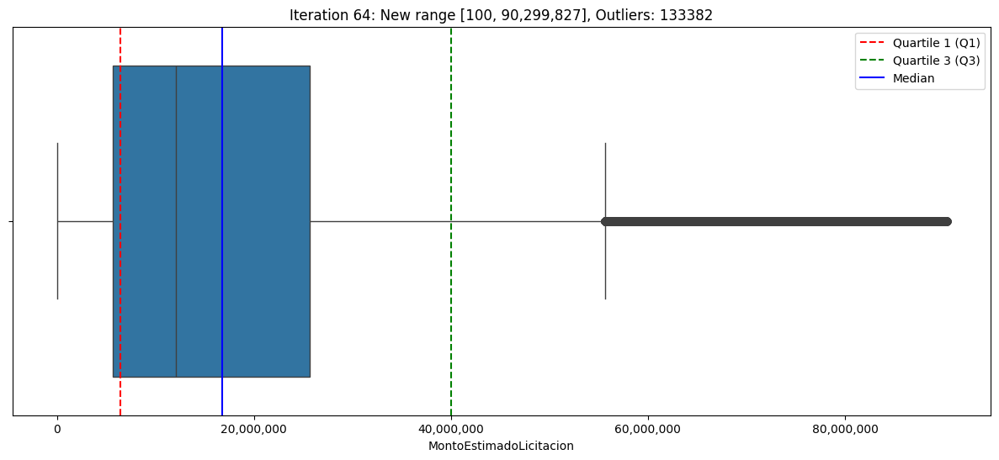

Iteration 64: New range [100, 90,299,827]


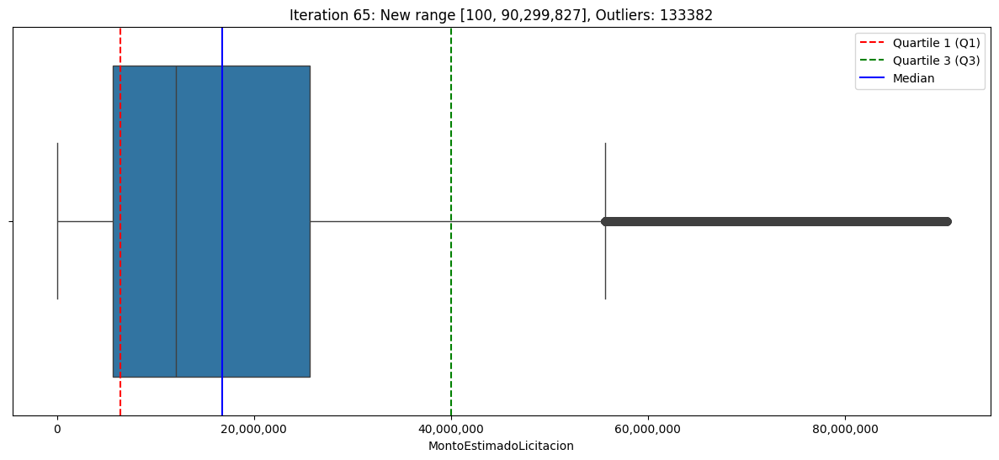

Iteration 65: New range [100, 90,299,827]


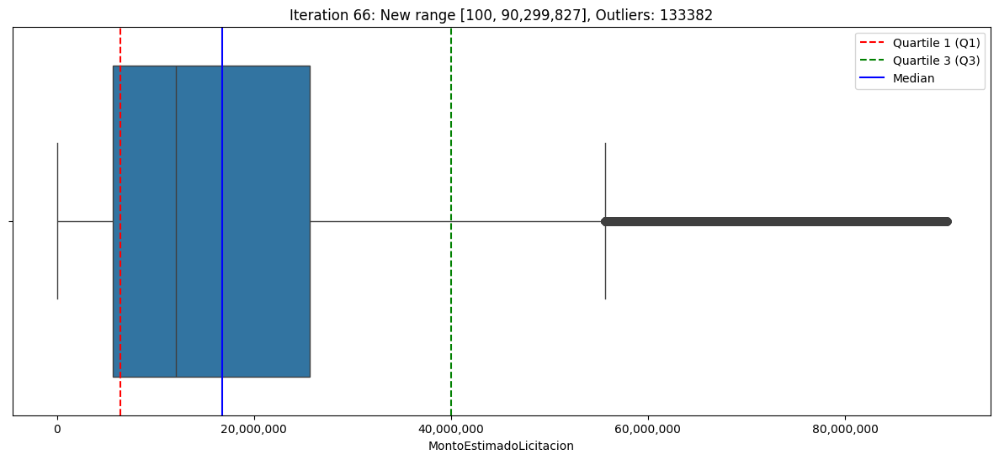

Iteration 66: New range [100, 90,299,827]


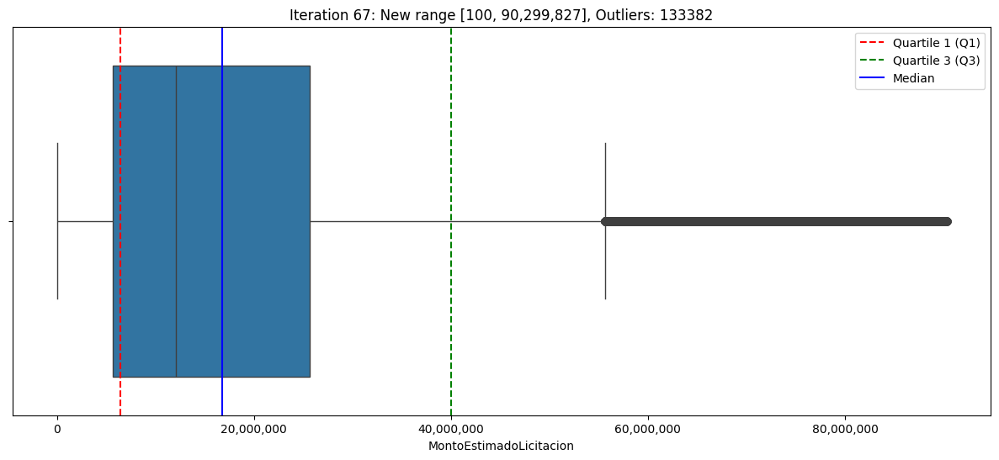

Iteration 67: New range [100, 90,299,827]


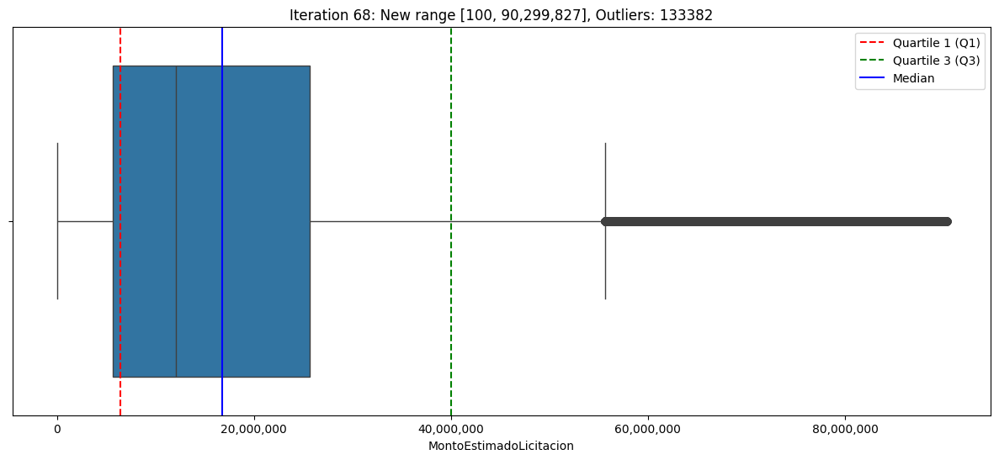

Iteration 68: New range [100, 90,299,827]


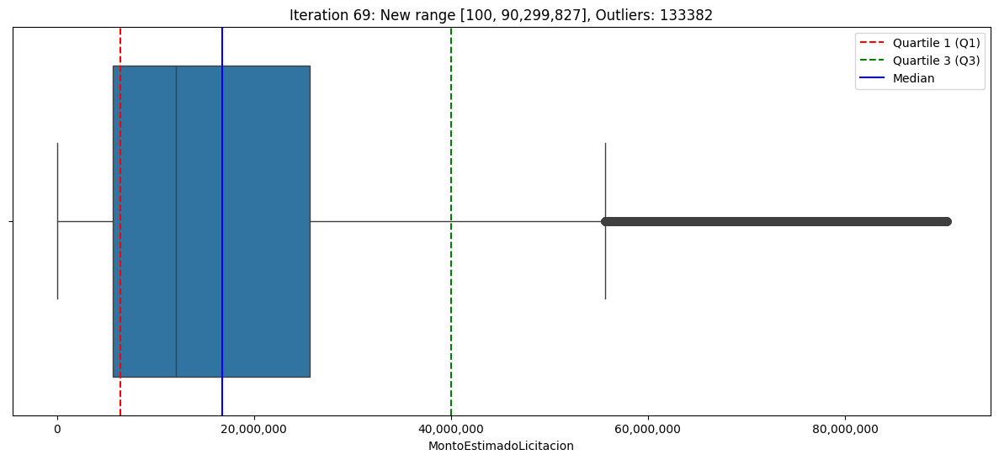

Iteration 69: New range [100, 90,299,827]


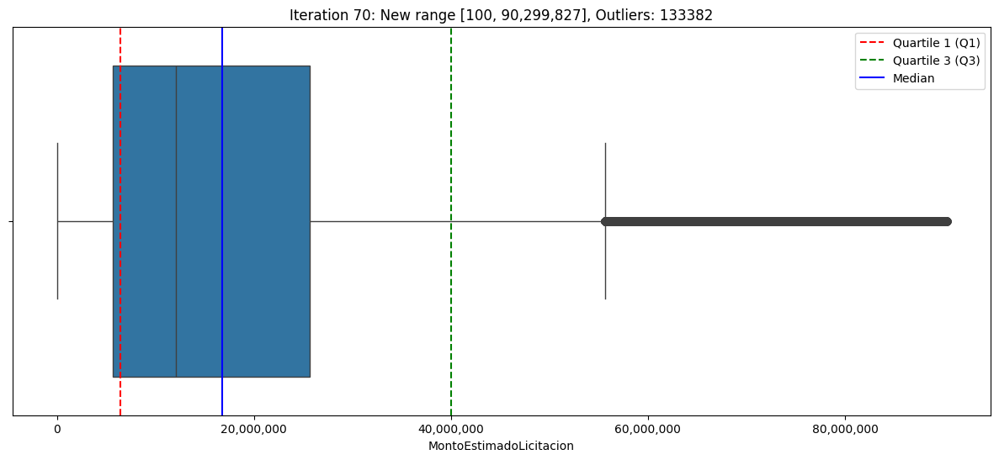

Iteration 70: New range [100, 90,299,827]


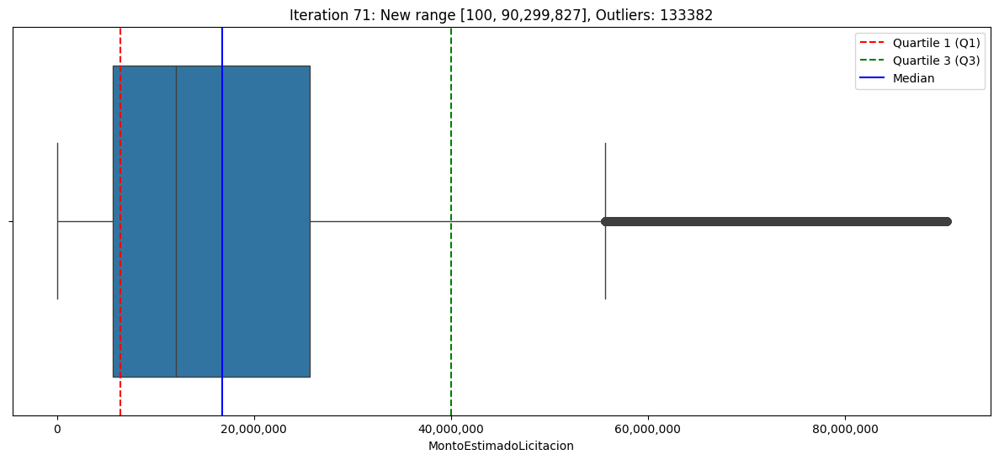

Iteration 71: New range [100, 90,299,827]


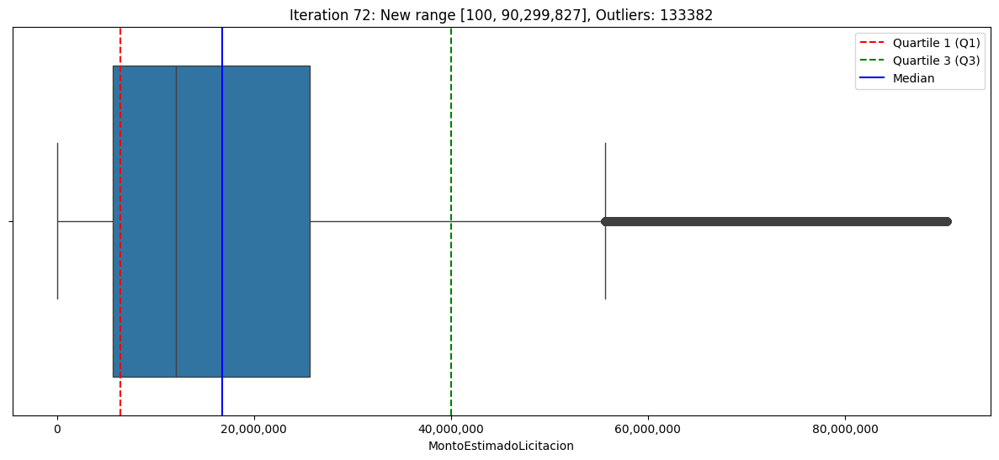

Iteration 72: New range [100, 90,299,827]


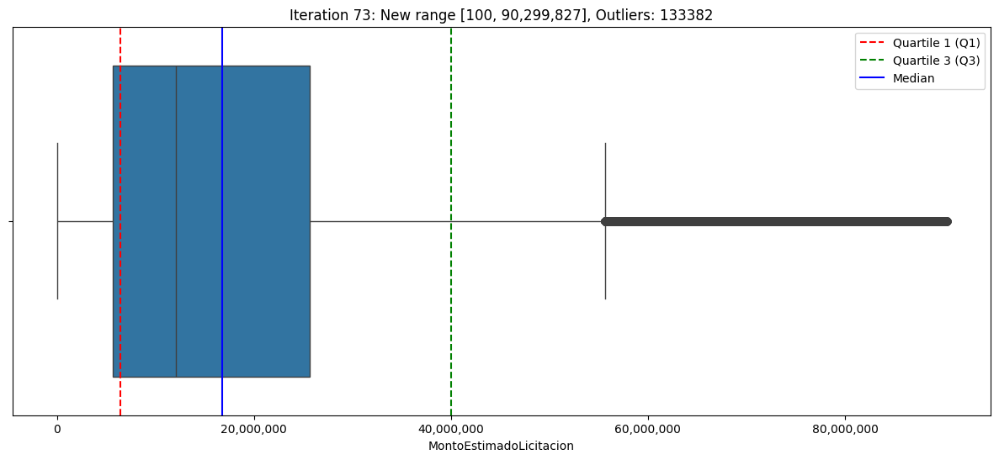

Iteration 73: New range [100, 90,299,827]


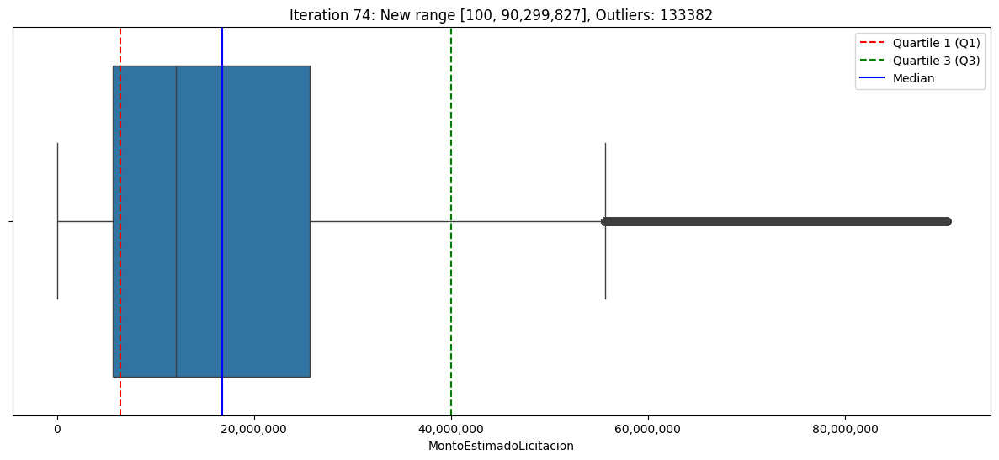

Iteration 74: New range [100, 90,299,827]


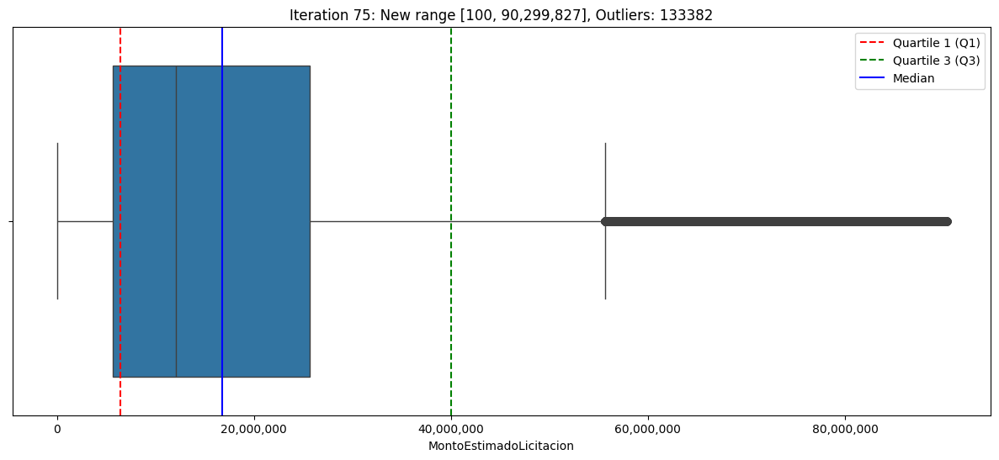

Iteration 75: New range [100, 90,299,827]


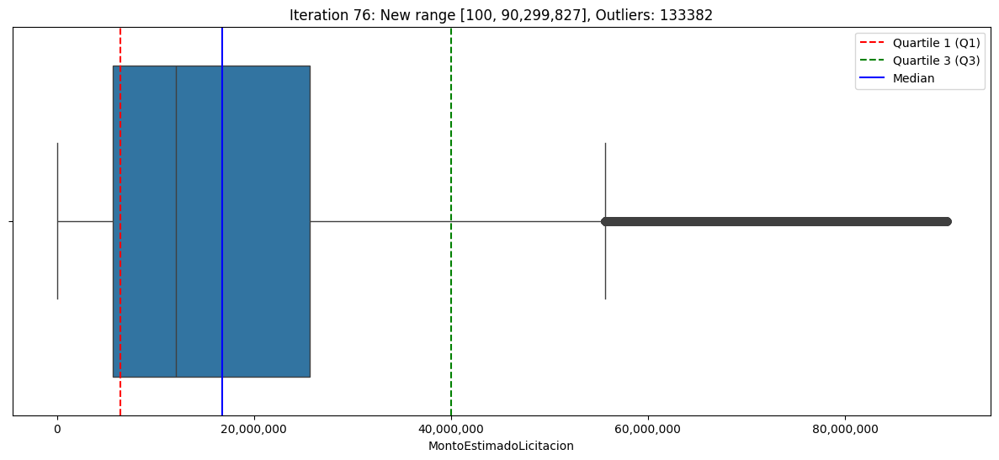

Iteration 76: New range [100, 90,299,827]


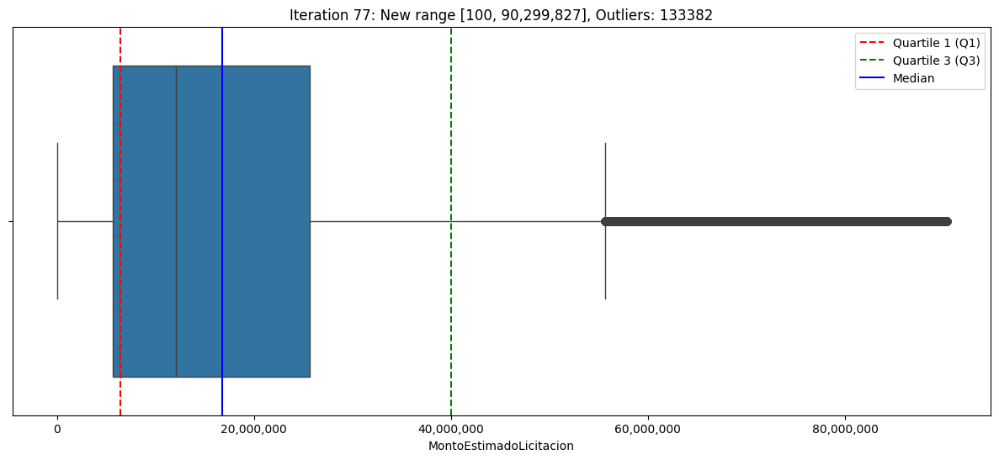

Iteration 77: New range [100, 90,299,827]


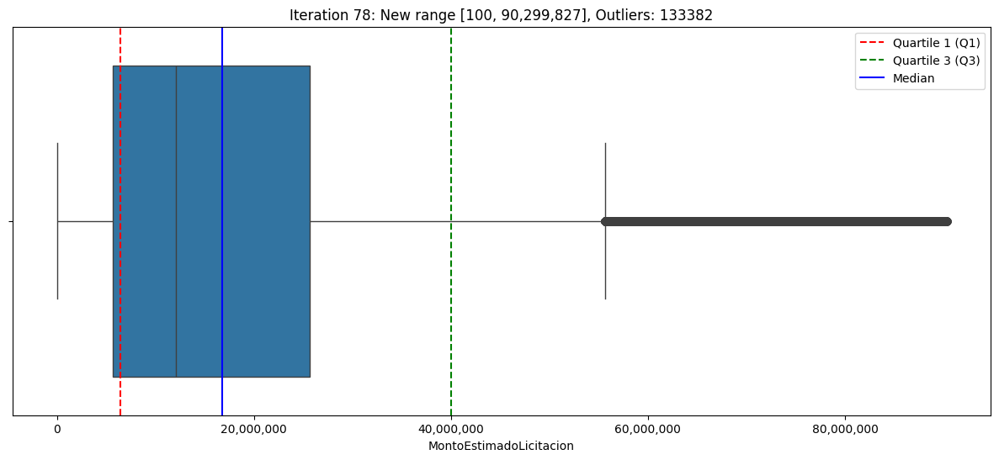

Iteration 78: New range [100, 90,299,827]


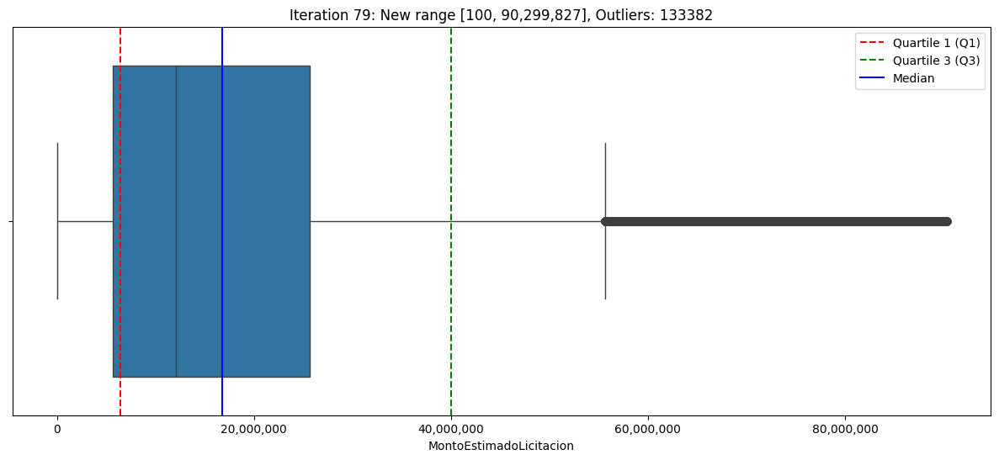

Iteration 79: New range [100, 90,299,827]


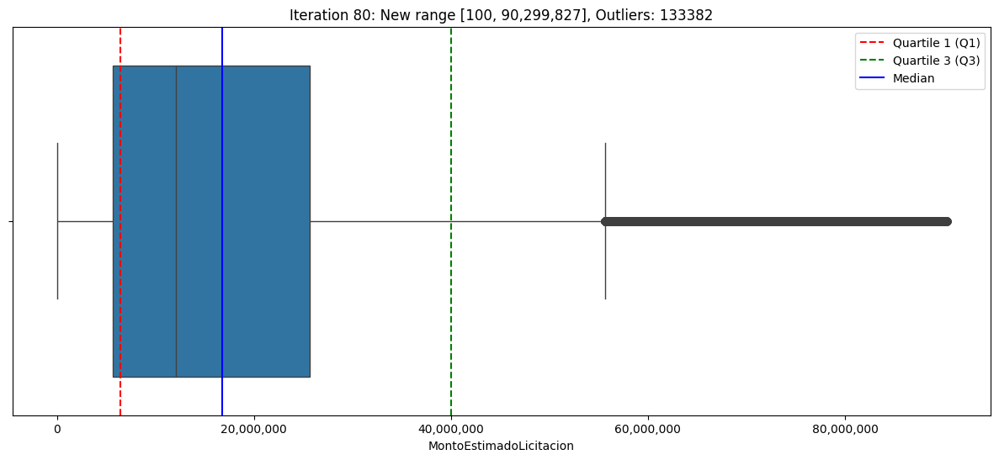

Iteration 80: New range [100, 90,299,827]


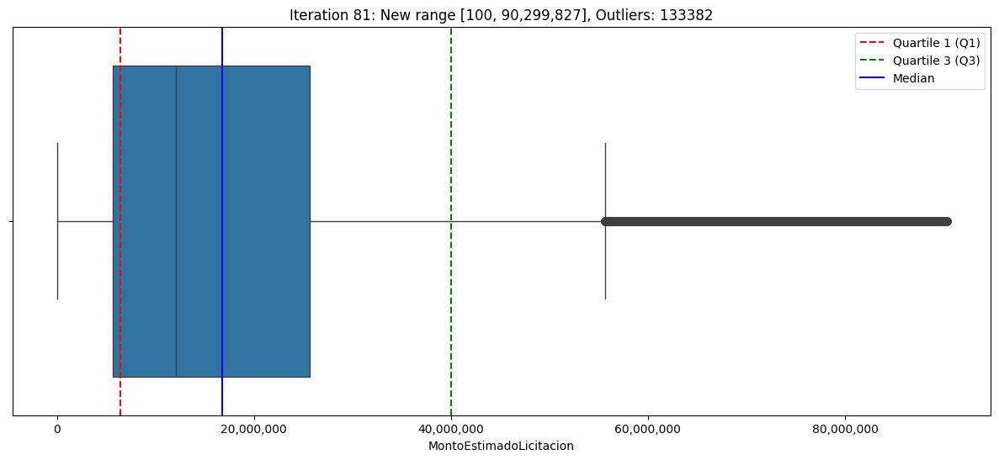

Iteration 81: New range [100, 90,299,827]


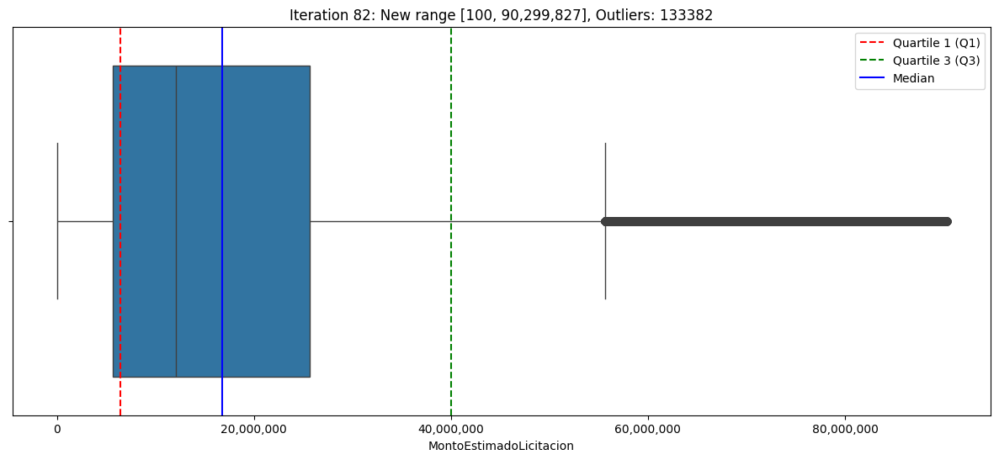

Iteration 82: New range [100, 90,299,827]


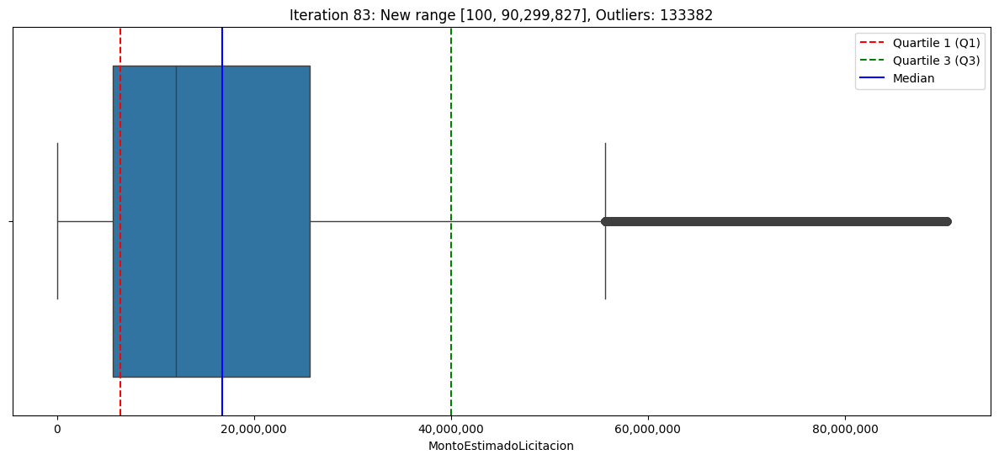

Iteration 83: New range [100, 90,299,827]


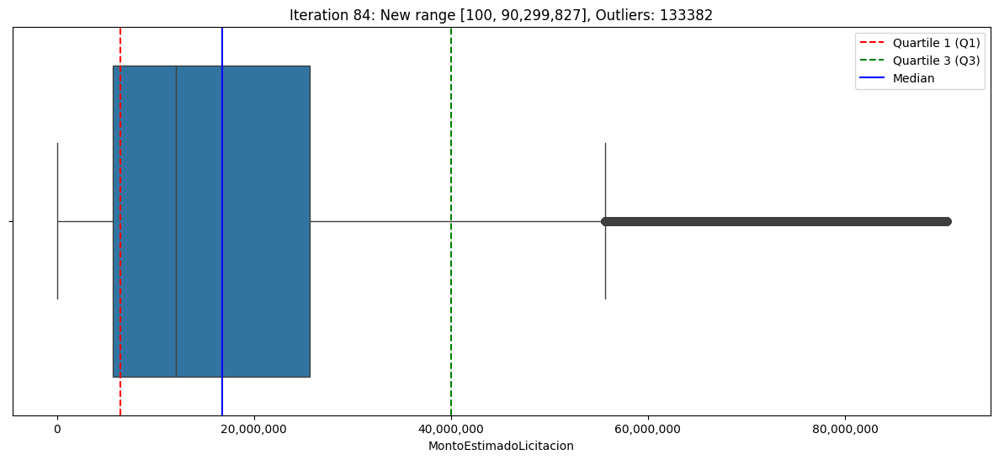

Iteration 84: New range [100, 90,299,827]


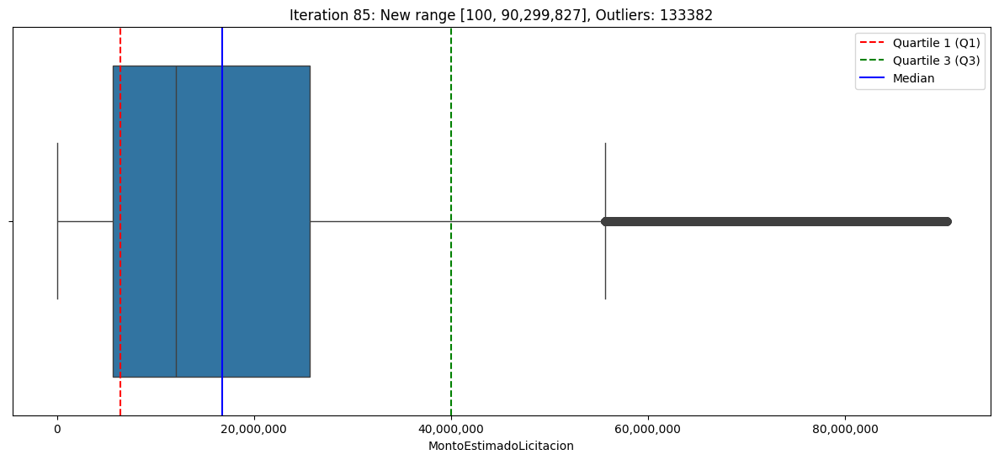

Iteration 85: New range [100, 90,299,827]


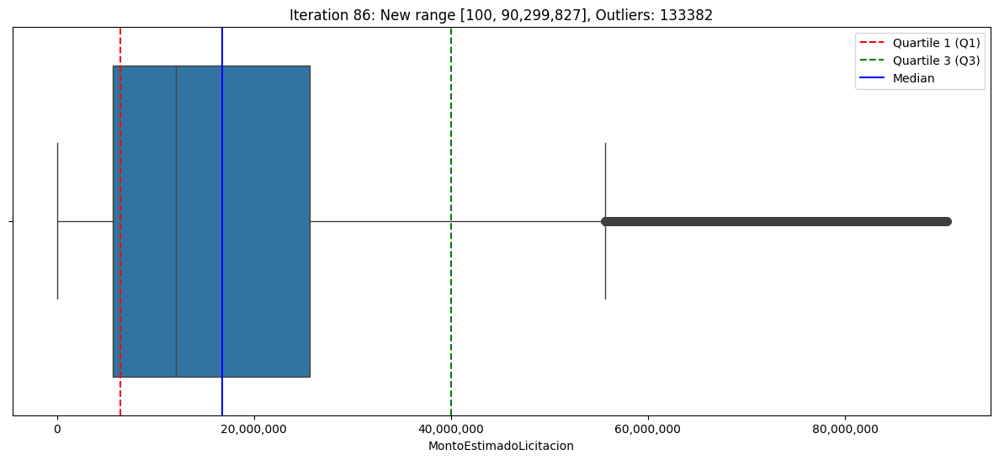

Iteration 86: New range [100, 90,299,827]


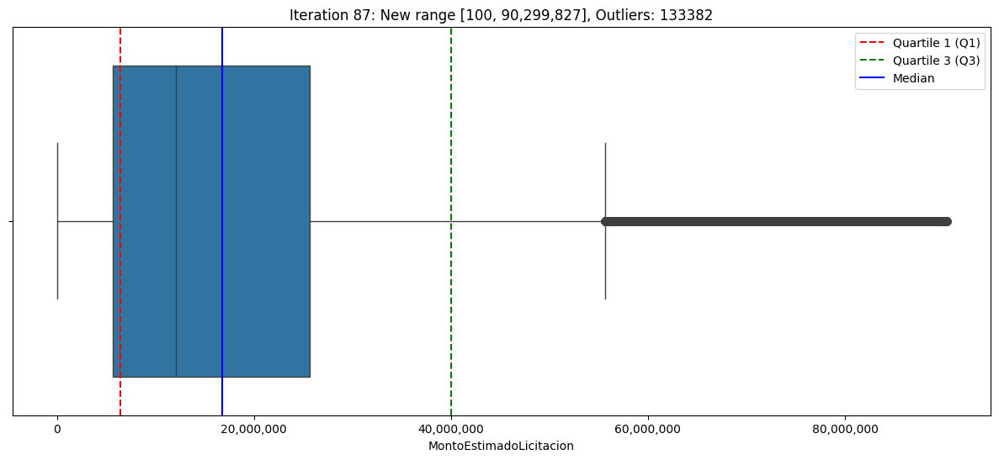

Iteration 87: New range [100, 90,299,827]


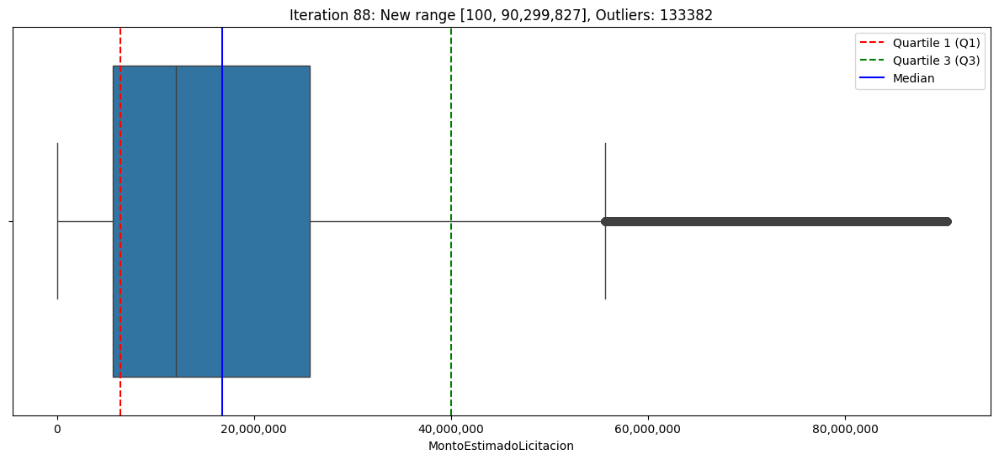

Iteration 88: New range [100, 90,299,827]


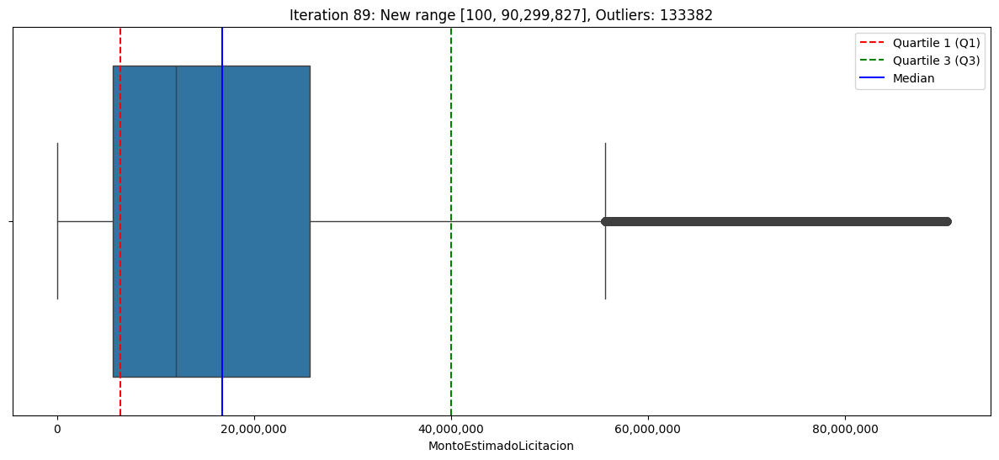

Iteration 89: New range [100, 90,299,827]


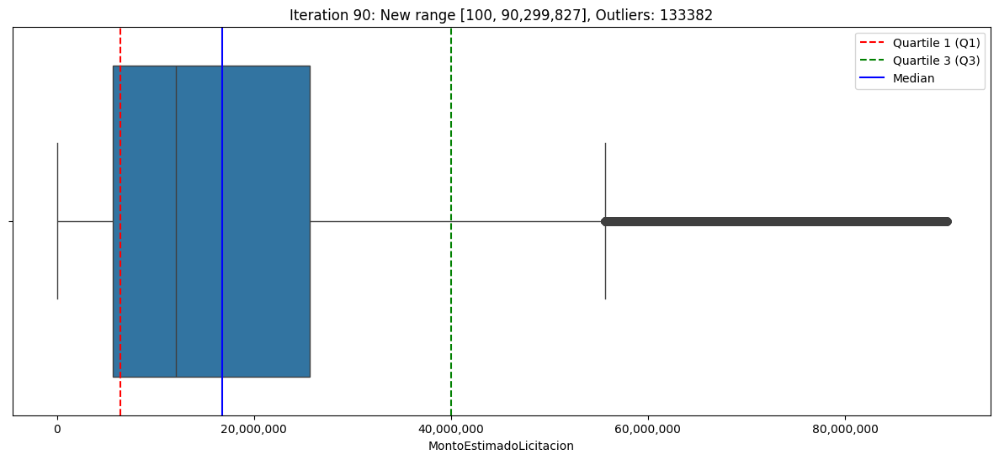

Iteration 90: New range [100, 90,299,827]


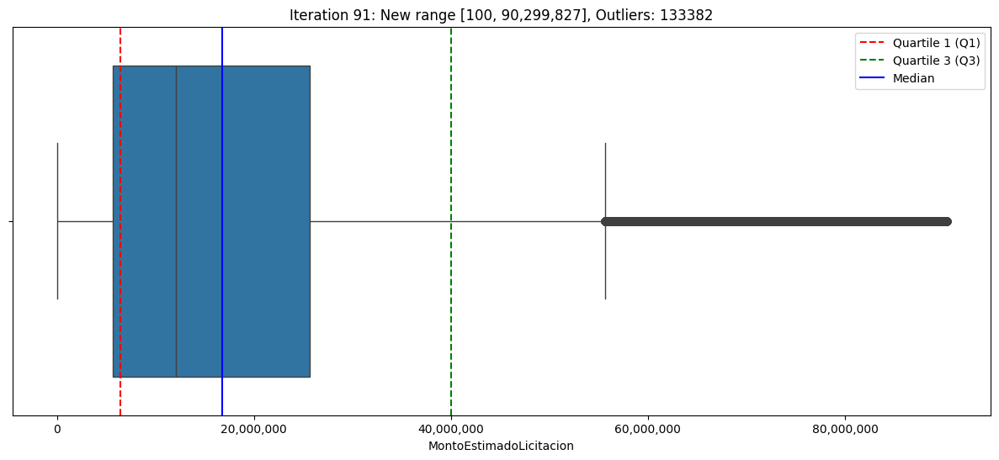

Iteration 91: New range [100, 90,299,827]


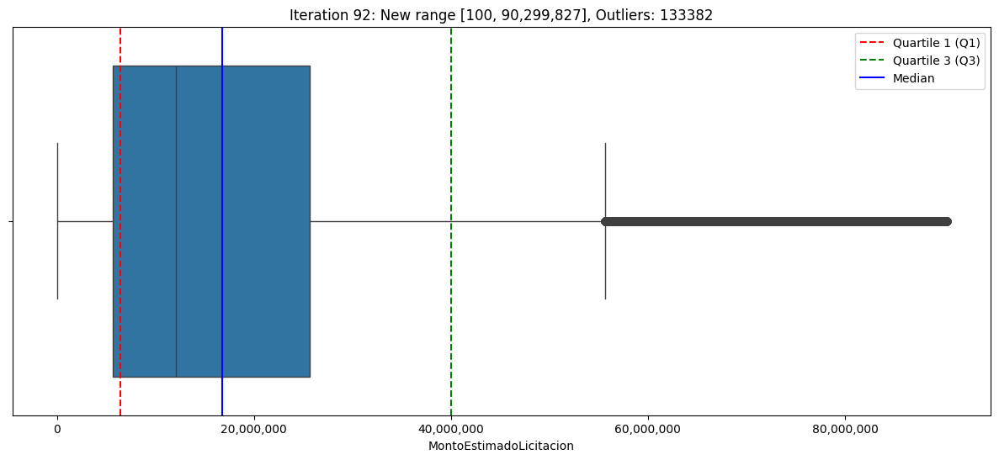

Iteration 92: New range [100, 90,299,827]


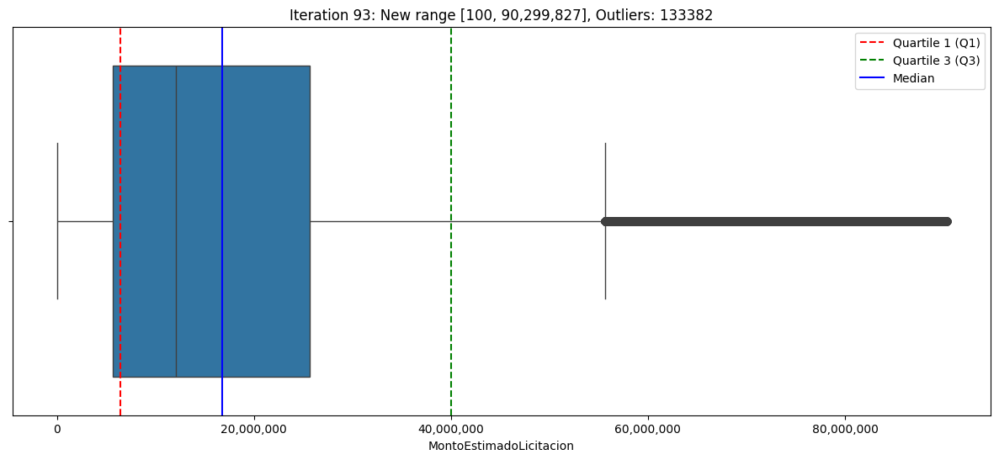

Iteration 93: New range [100, 90,299,827]


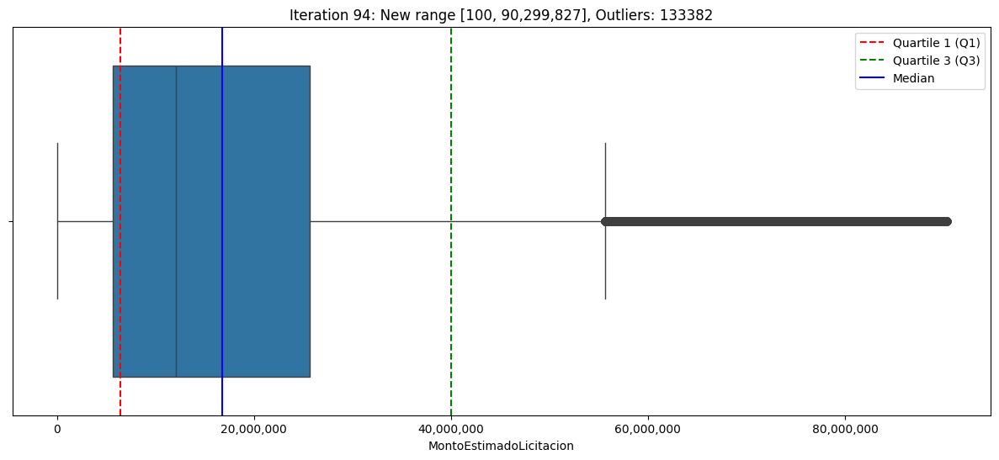

Iteration 94: New range [100, 90,299,827]


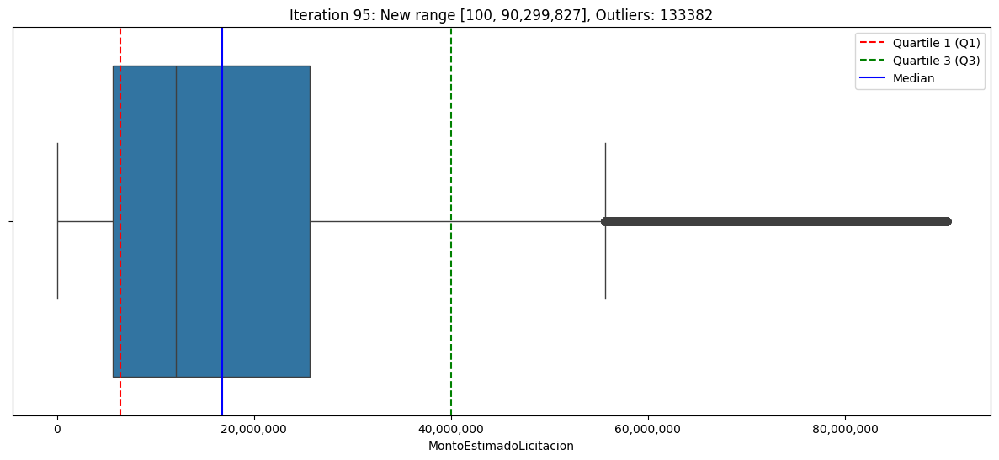

Iteration 95: New range [100, 90,299,827]


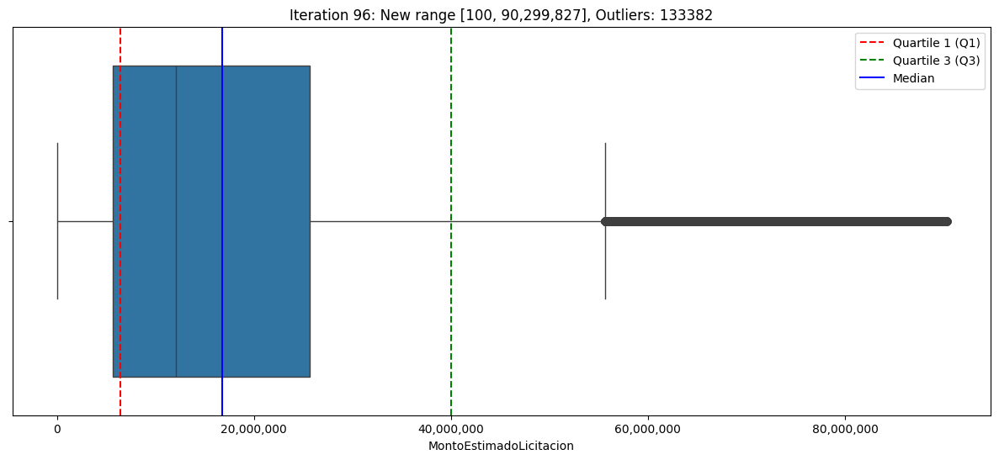

Iteration 96: New range [100, 90,299,827]


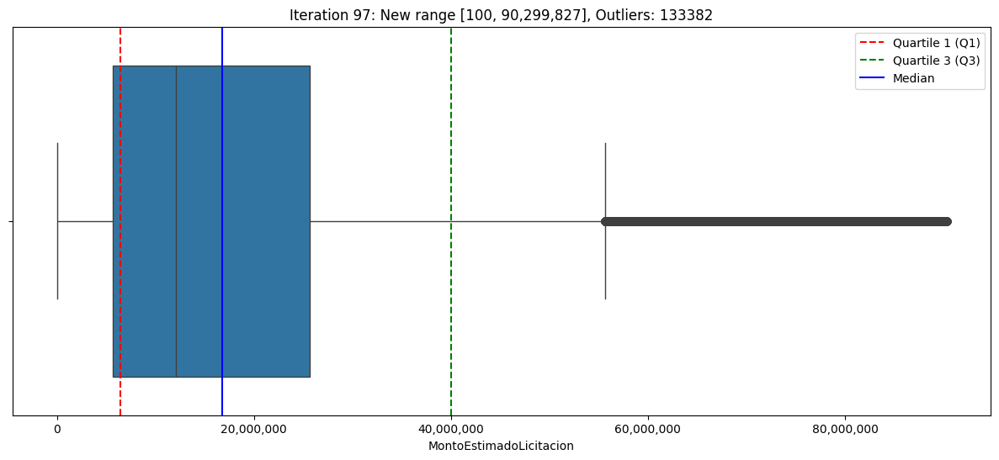

Iteration 97: New range [100, 90,299,827]


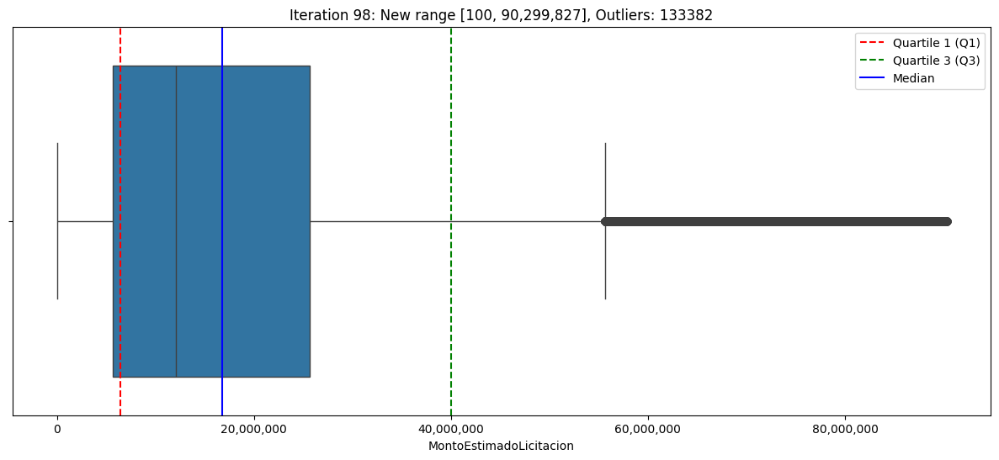

Iteration 98: New range [100, 90,299,827]


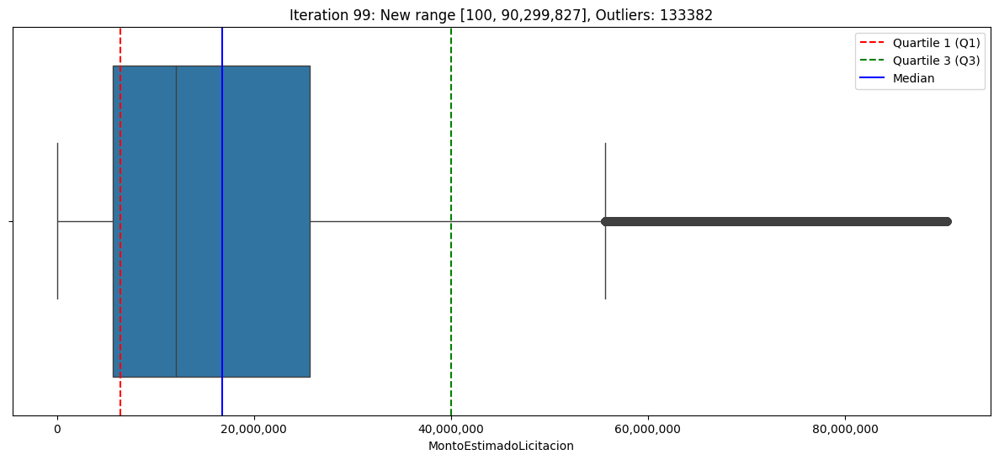

Iteration 99: New range [100, 90,299,827]


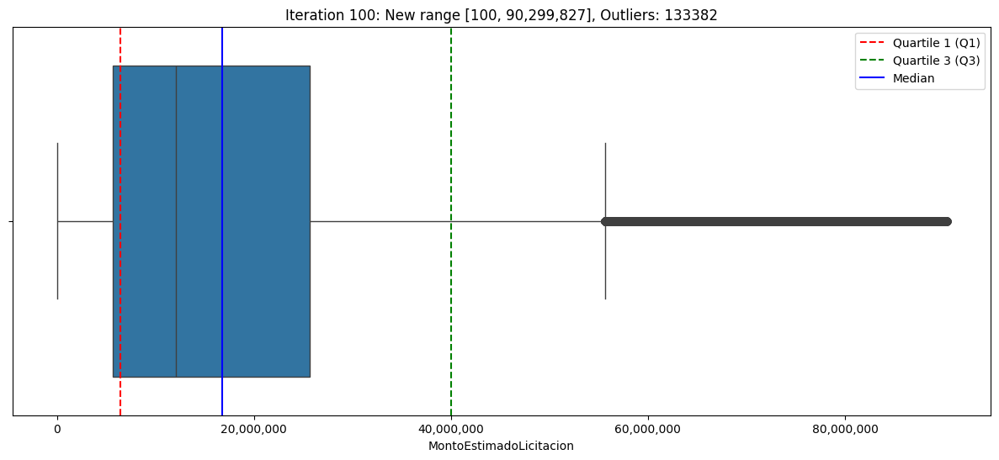

Iteration 100: New range [100, 90,299,827]


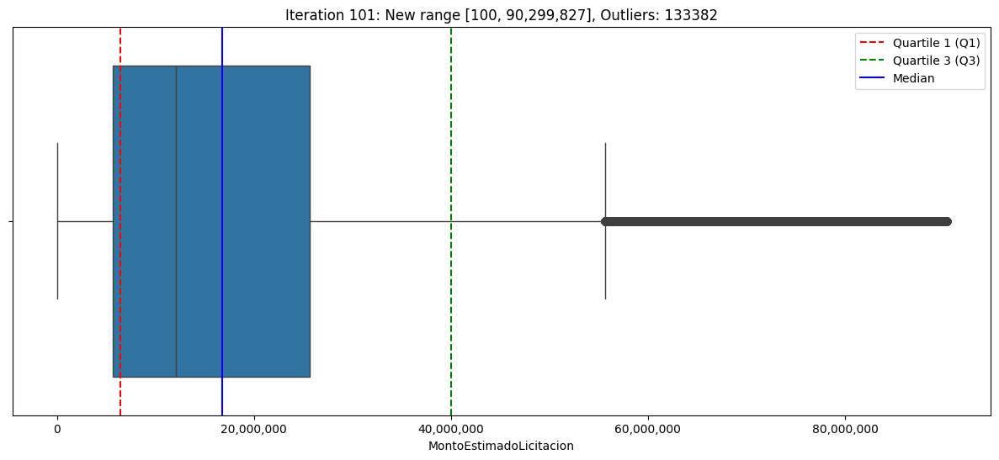

Iteration 101: New range [100, 90,299,827]


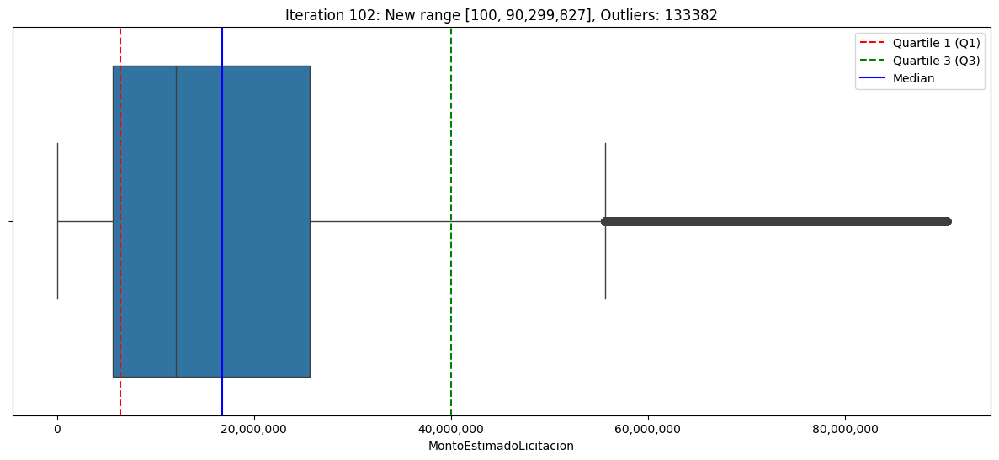

Iteration 102: New range [100, 90,299,827]


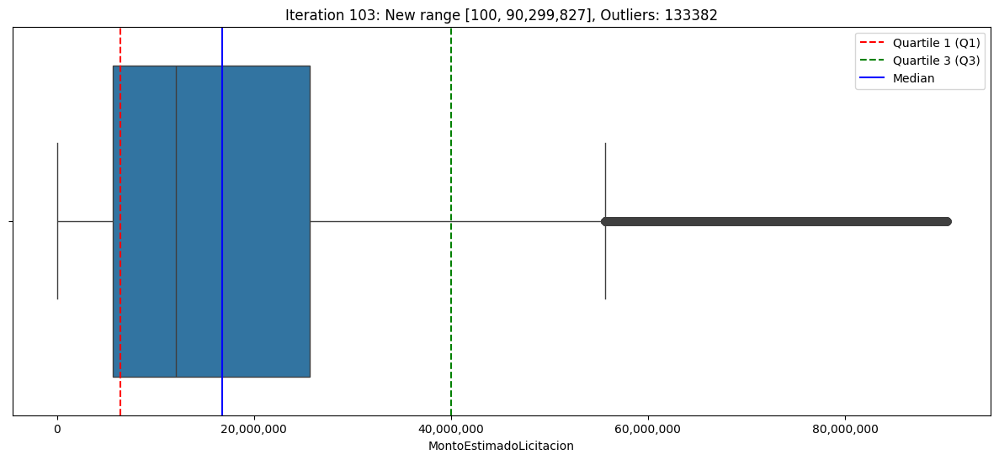

Iteration 103: New range [100, 90,299,827]


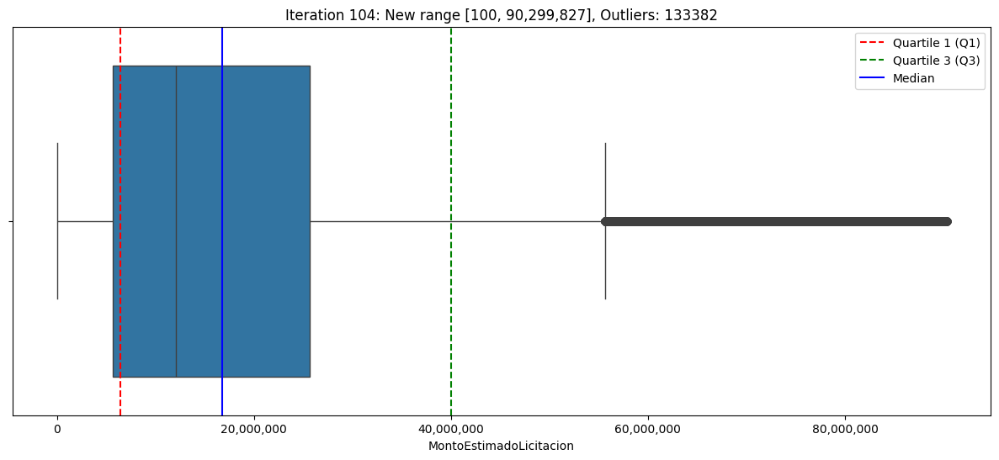

Iteration 104: New range [100, 90,299,827]


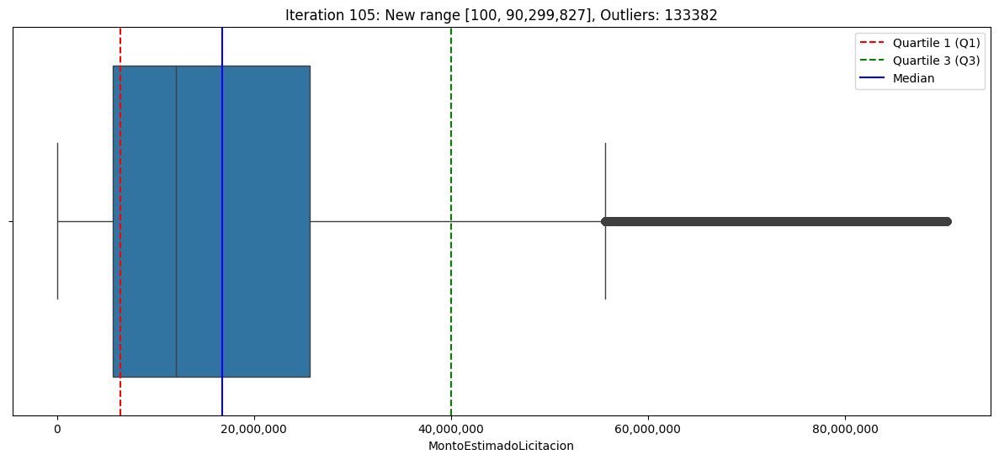

Iteration 105: New range [100, 90,299,827]


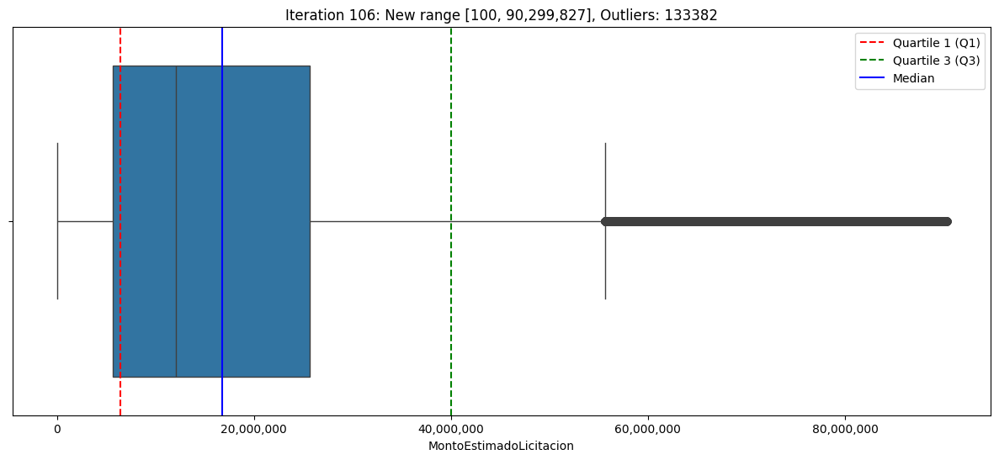

Iteration 106: New range [100, 90,299,827]


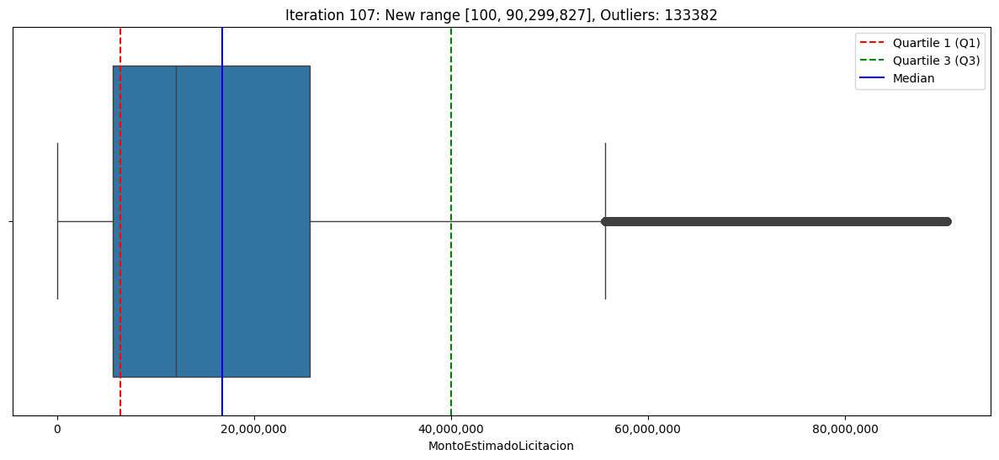

Iteration 107: New range [100, 90,299,827]


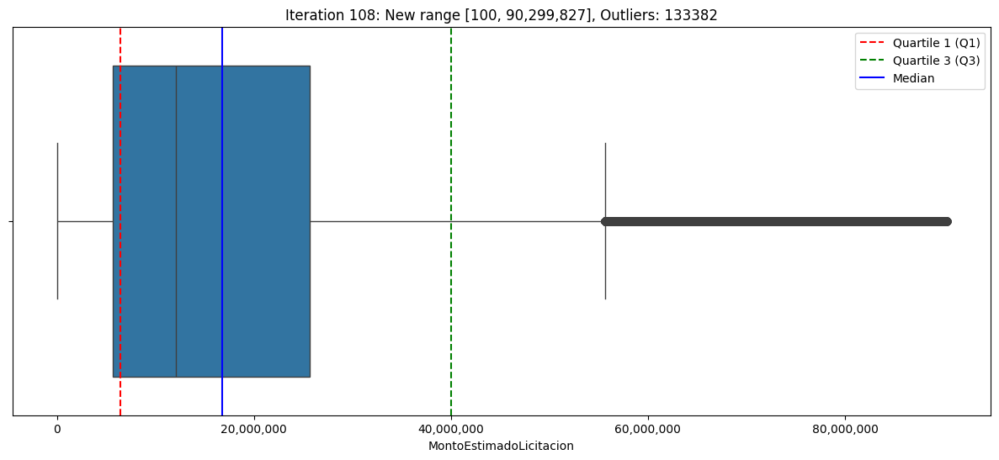

Iteration 108: New range [100, 90,299,827]


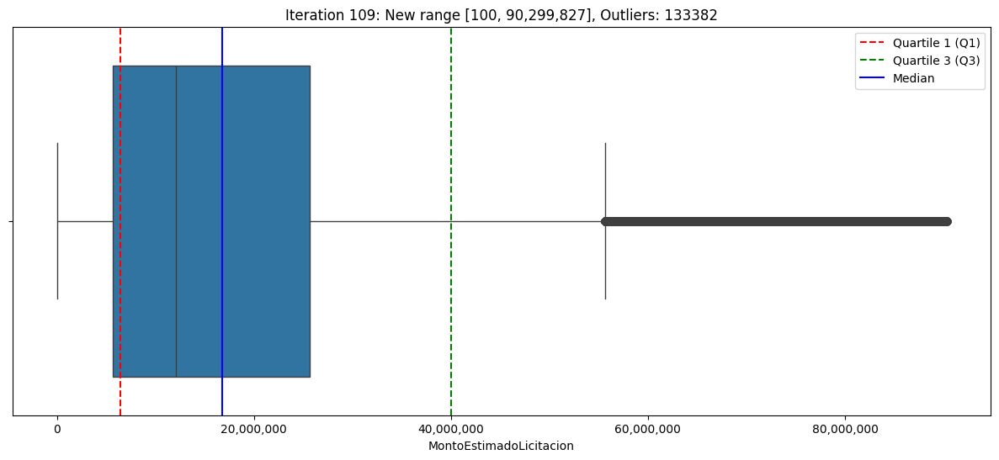

Iteration 109: New range [100, 90,299,827]


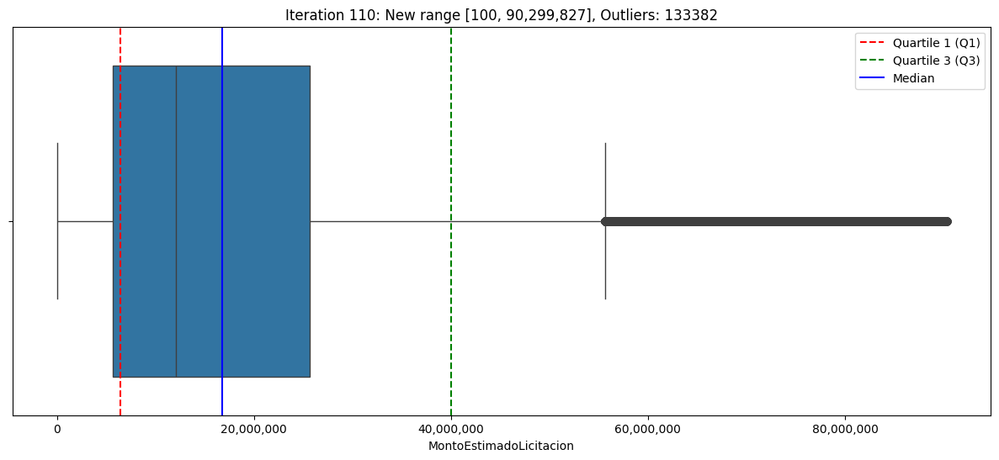

Iteration 110: New range [100, 90,299,827]


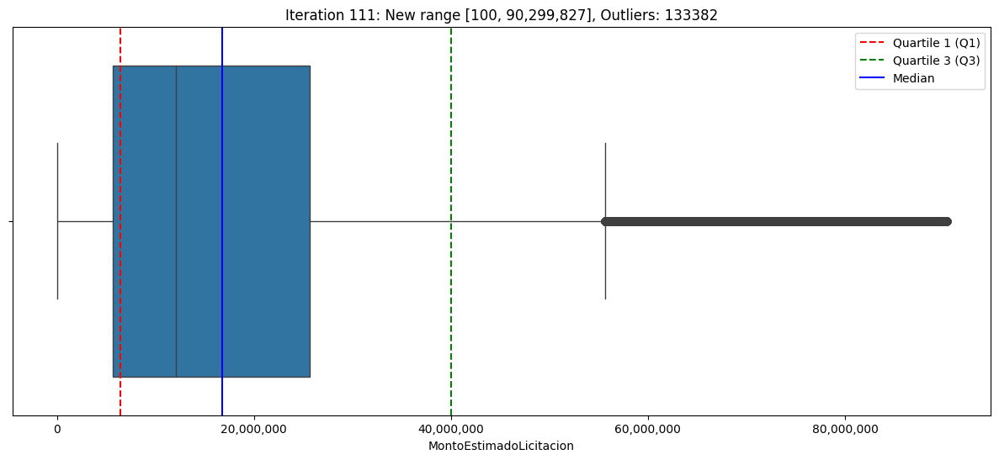

Iteration 111: New range [100, 90,299,827]


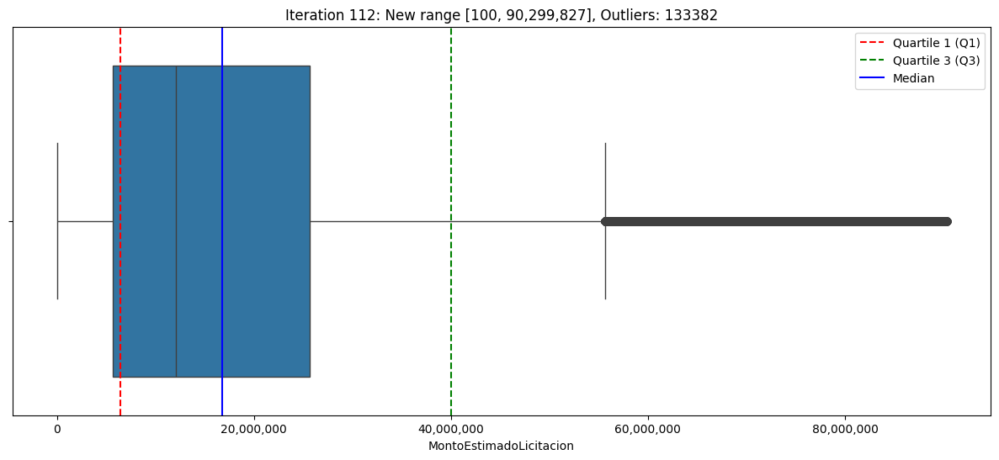

Iteration 112: New range [100, 90,299,827]


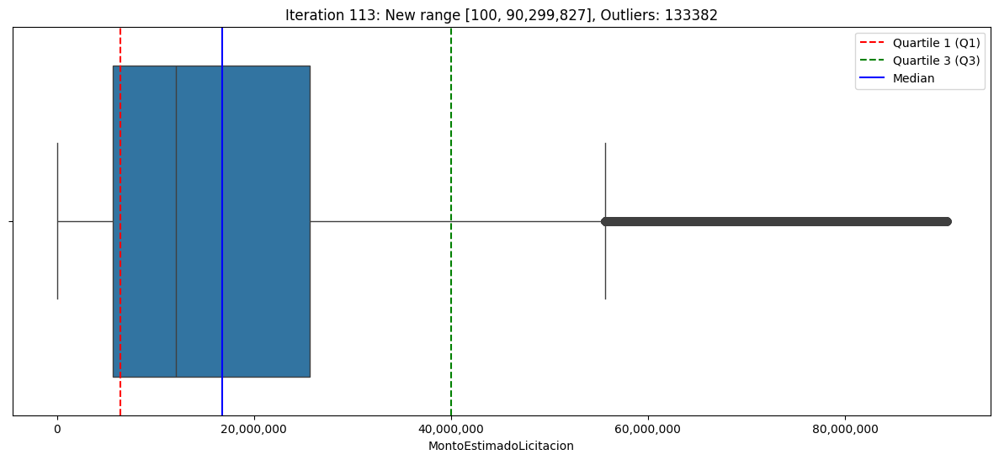

Iteration 113: New range [100, 90,299,827]


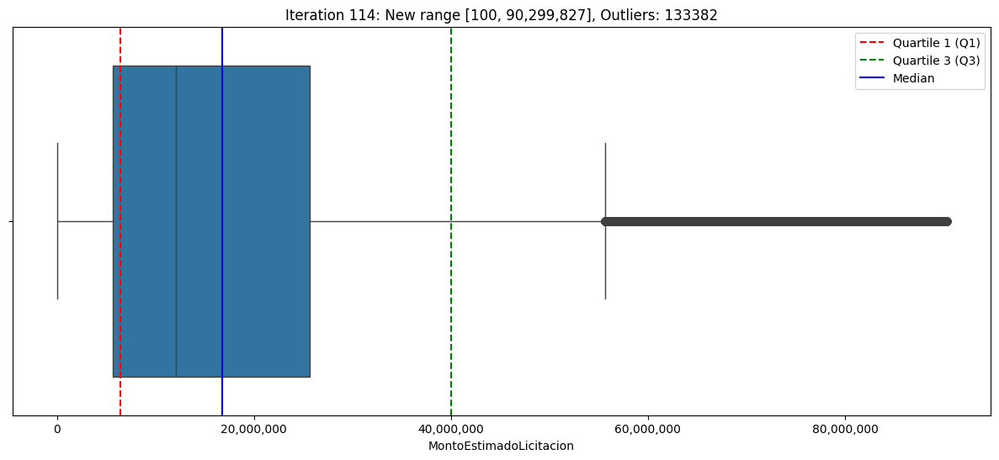

Iteration 114: New range [100, 90,299,827]


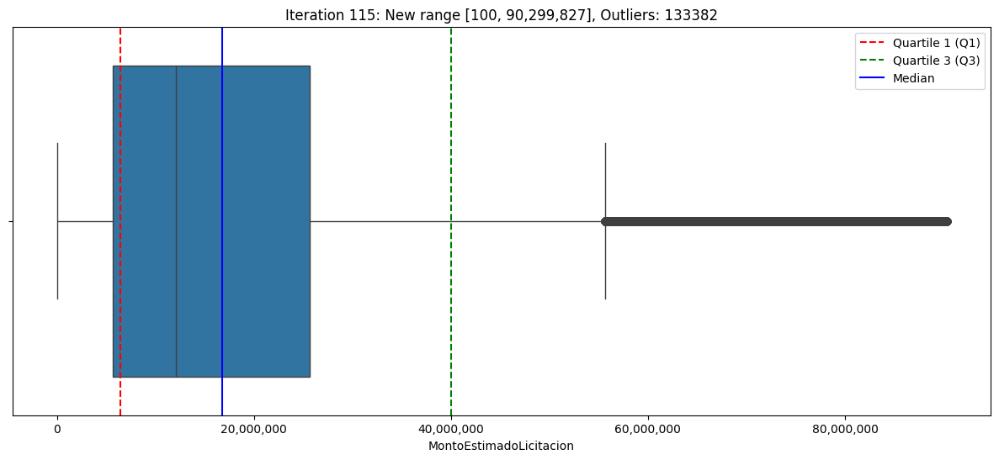

Iteration 115: New range [100, 90,299,827]


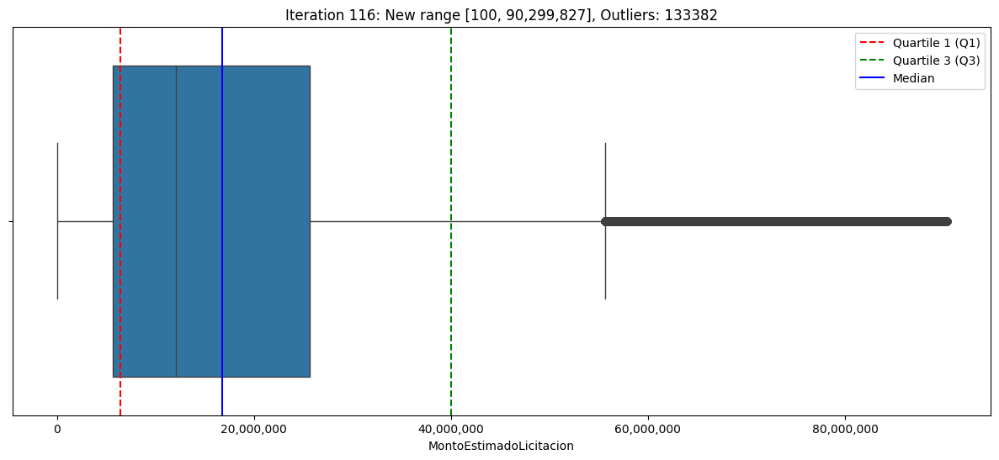

Iteration 116: New range [100, 90,299,827]


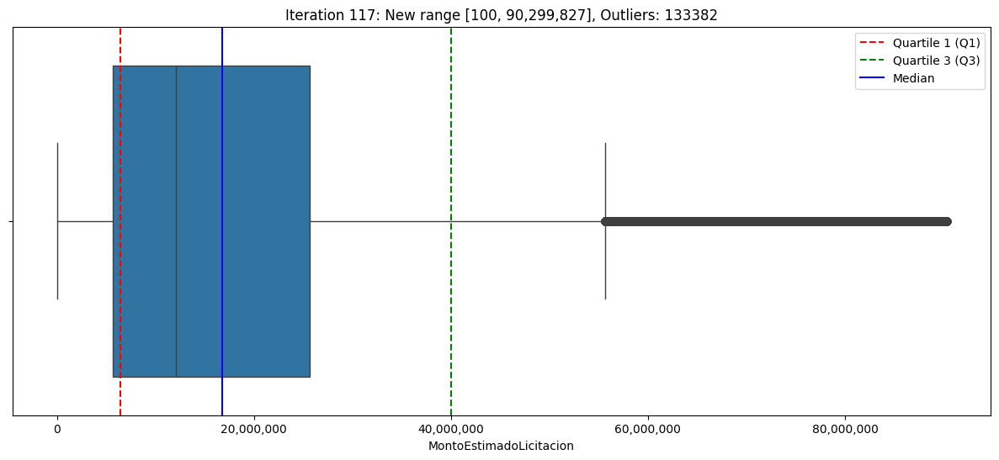

Iteration 117: New range [100, 90,299,827]


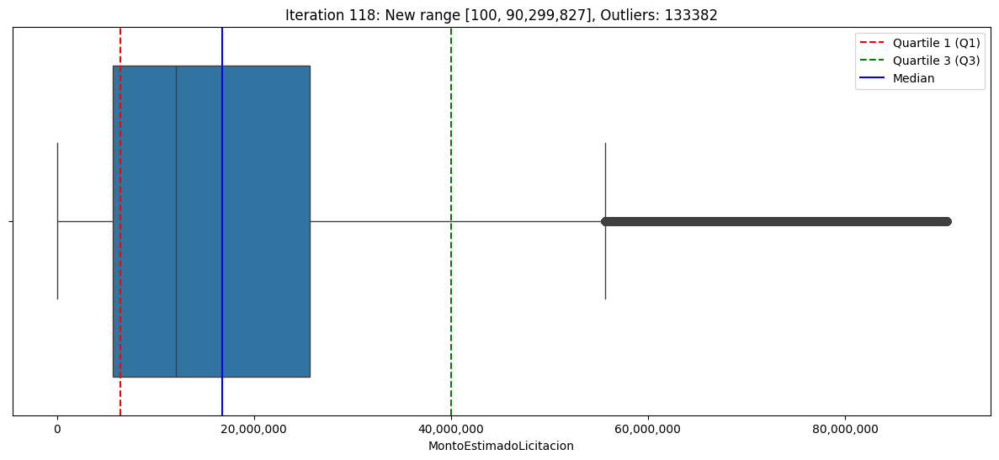

Iteration 118: New range [100, 90,299,827]


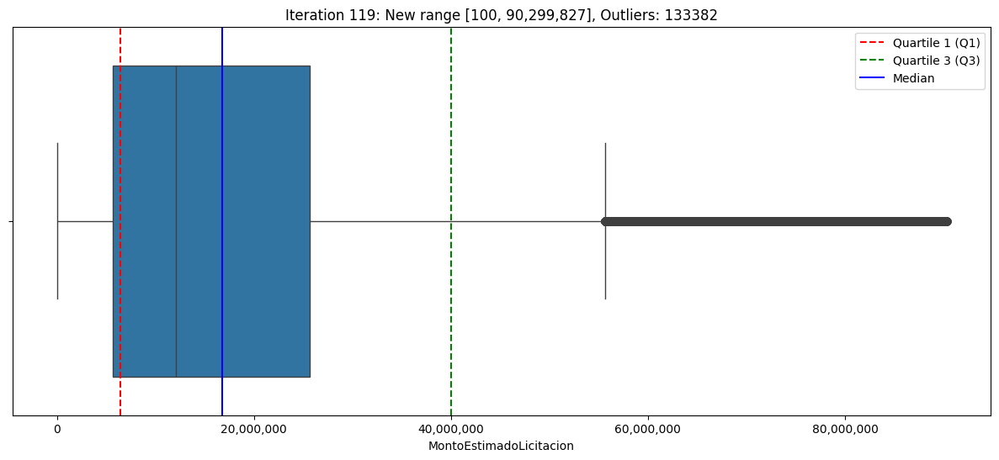

Iteration 119: New range [100, 90,299,827]


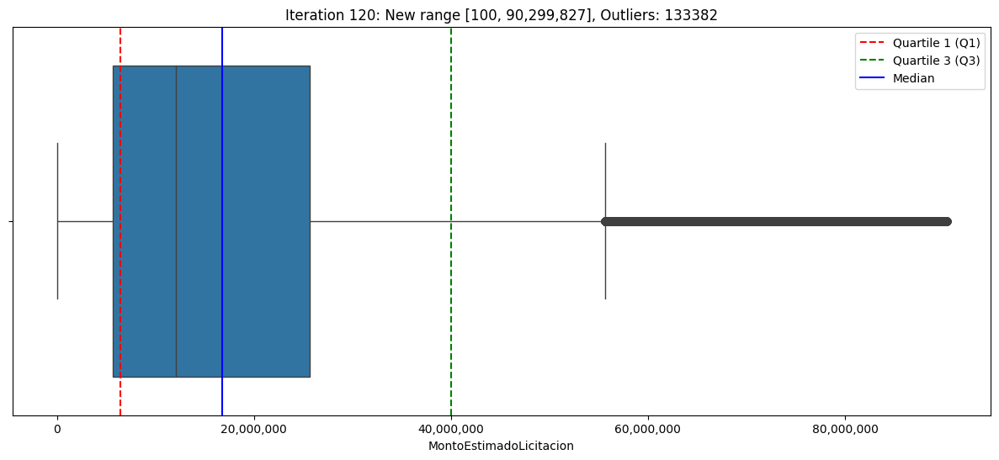

Iteration 120: New range [100, 90,299,827]


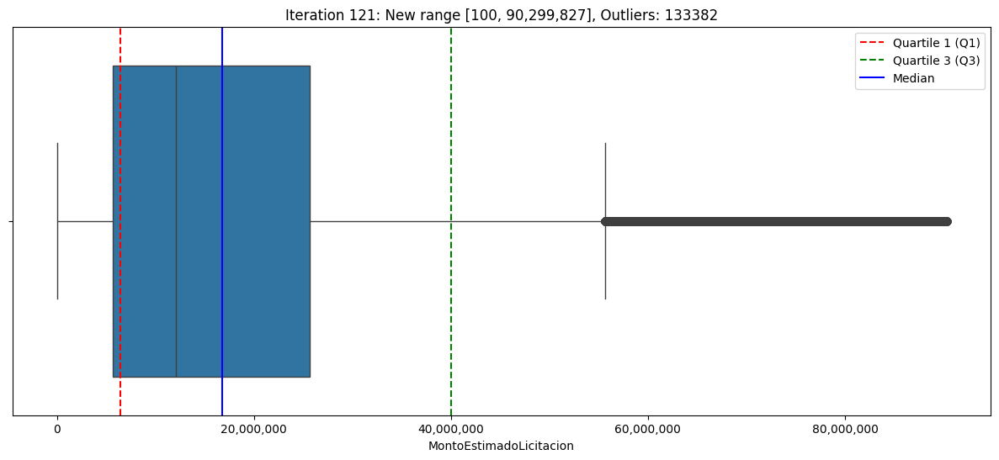

Iteration 121: New range [100, 90,299,827]


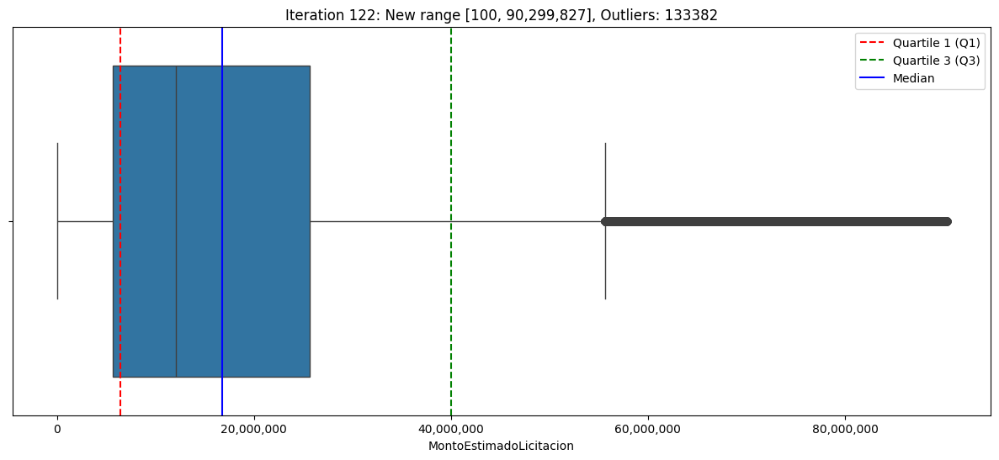

Iteration 122: New range [100, 90,299,827]


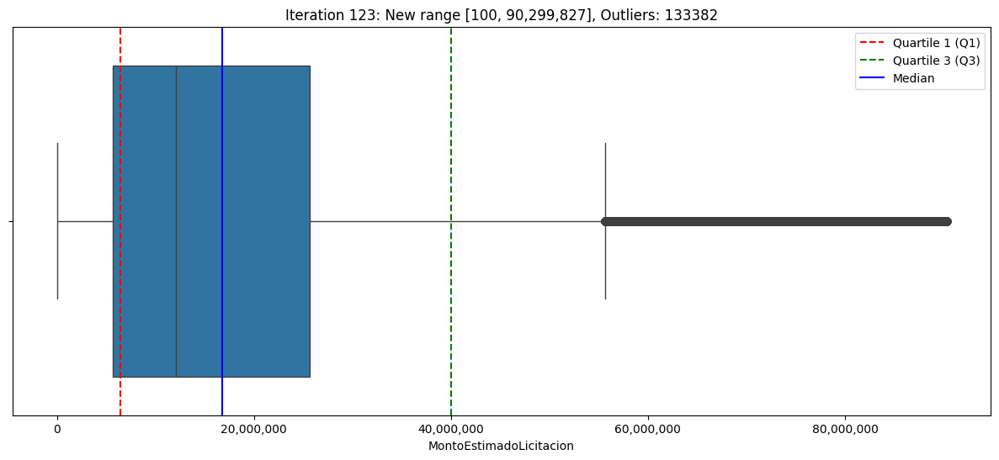

Iteration 123: New range [100, 90,299,827]


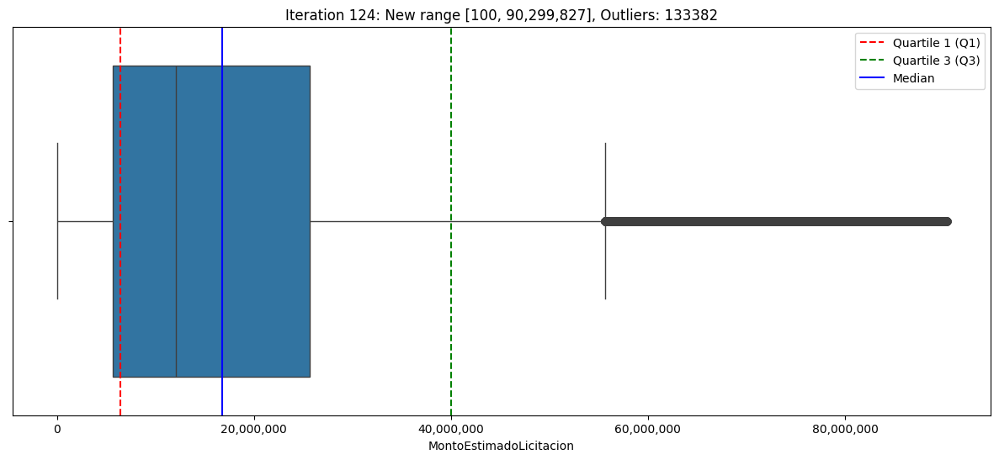

Iteration 124: New range [100, 90,299,827]


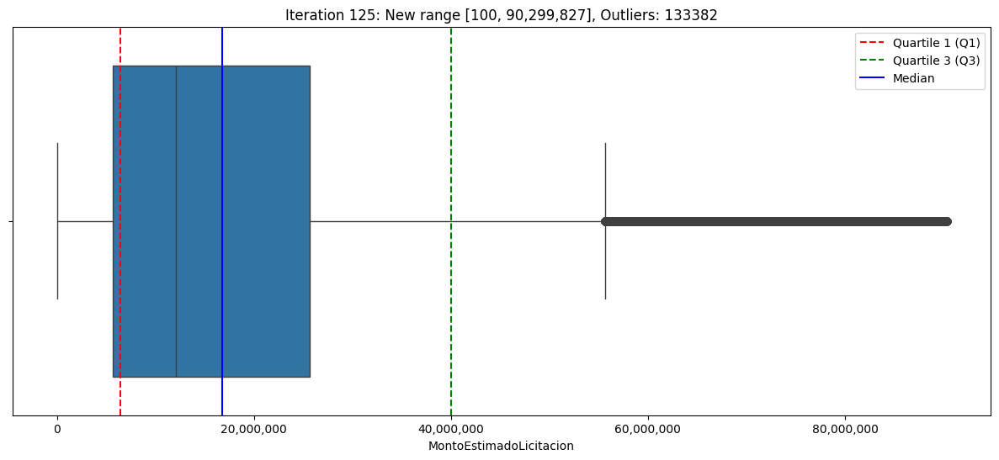

Iteration 125: New range [100, 90,299,827]


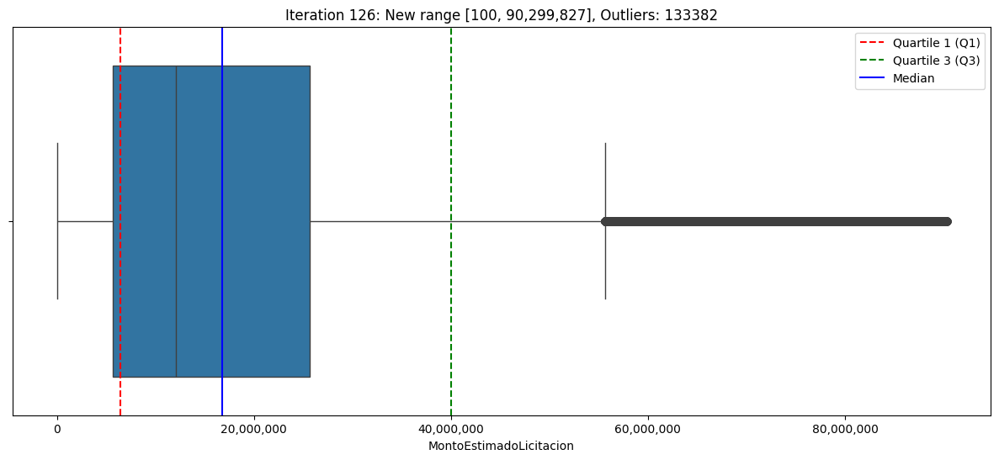

Iteration 126: New range [100, 90,299,827]


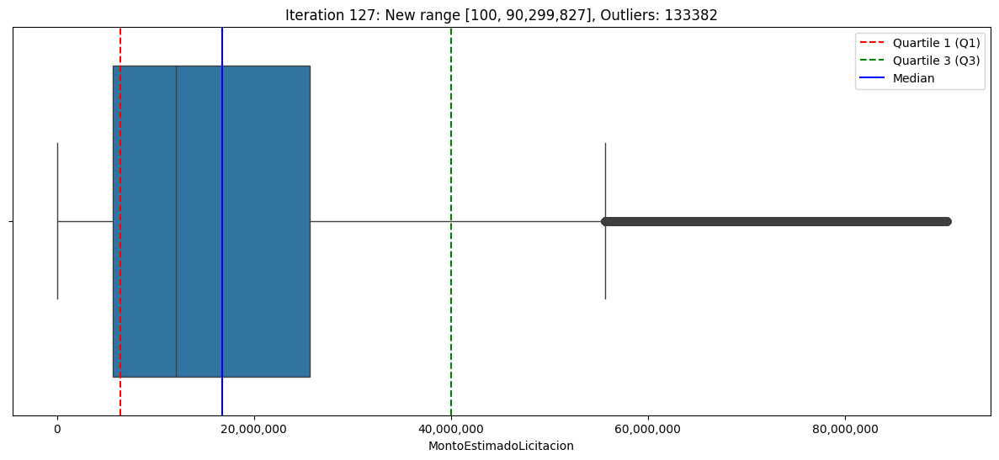

Iteration 127: New range [100, 90,299,827]


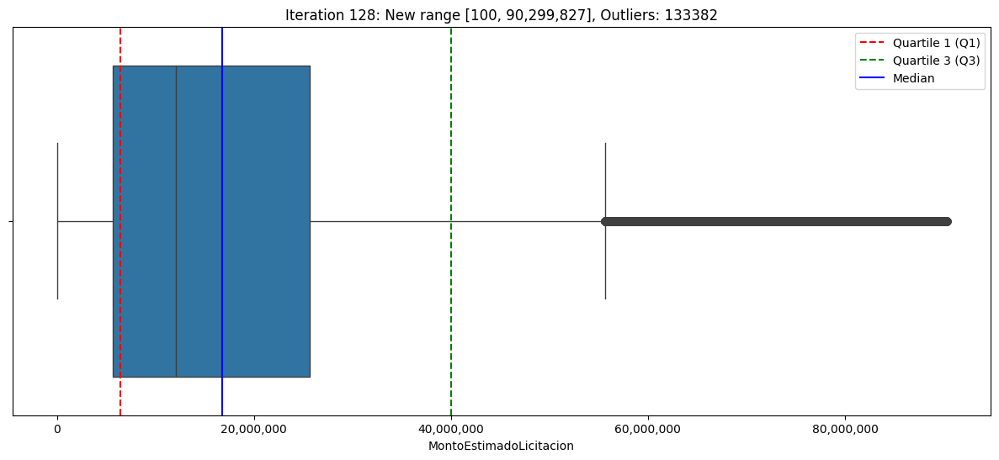

Iteration 128: New range [100, 90,299,827]


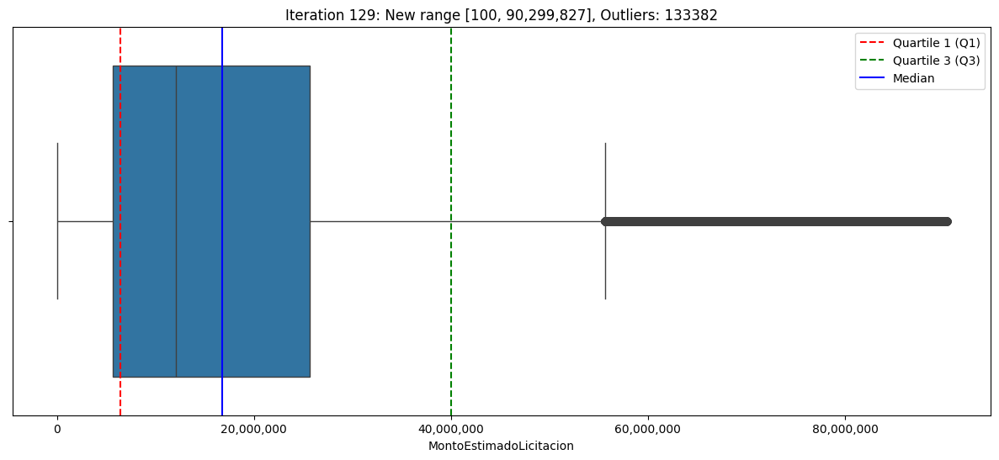

Iteration 129: New range [100, 90,299,827]


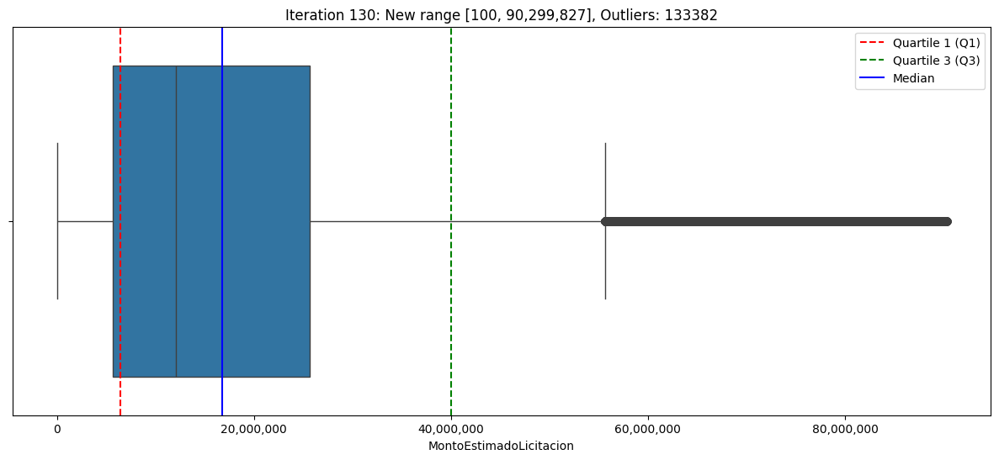

Iteration 130: New range [100, 90,299,827]


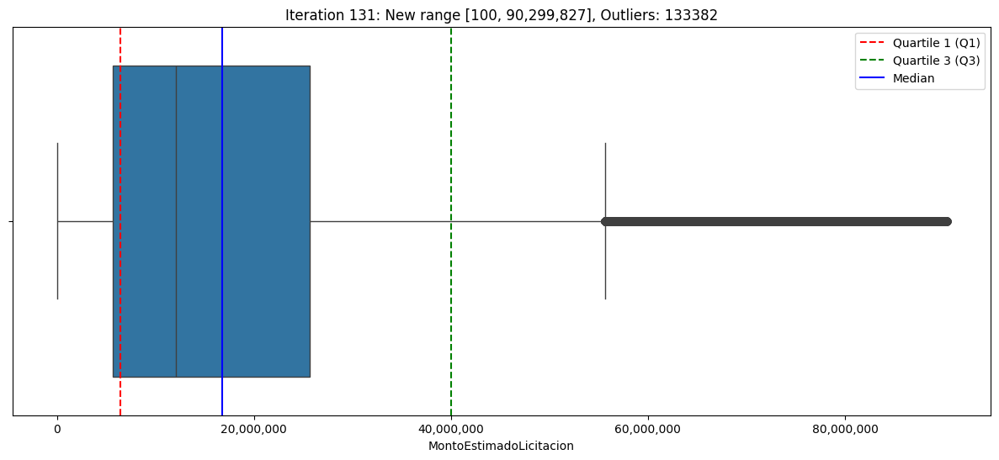

Iteration 131: New range [100, 90,299,827]


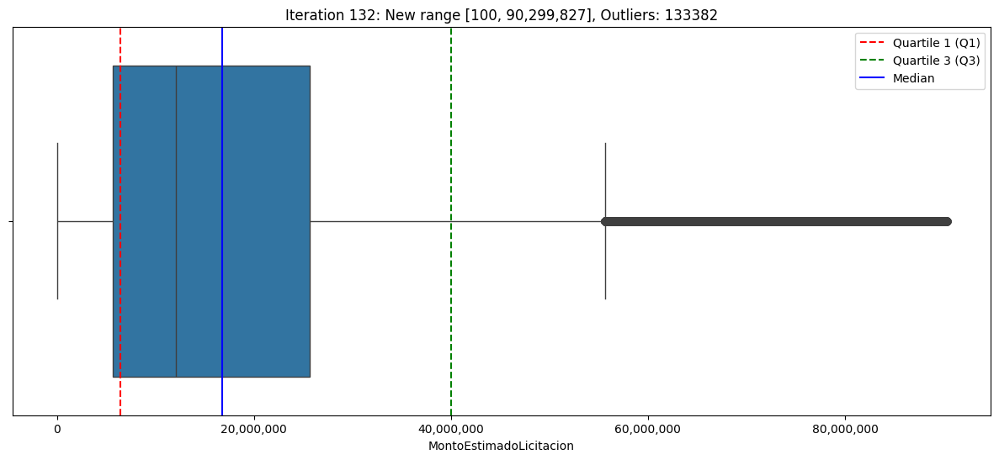

Iteration 132: New range [100, 90,299,827]


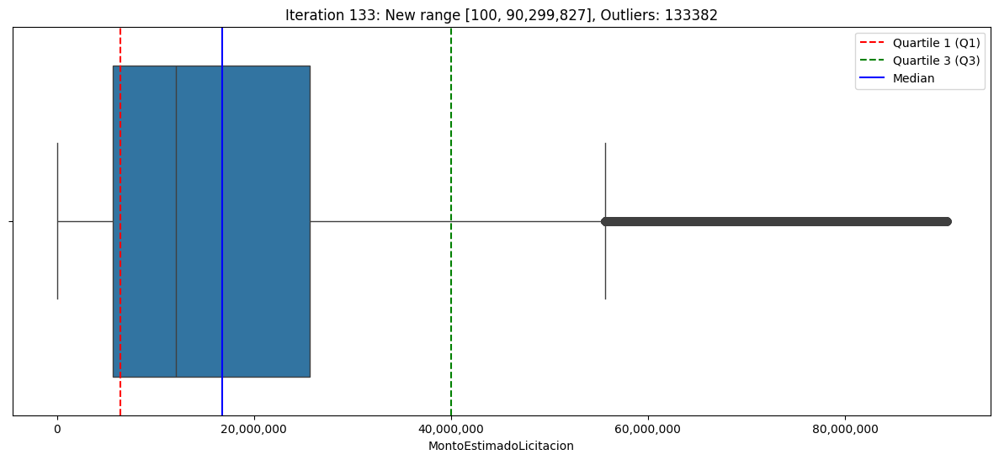

Iteration 133: New range [100, 90,299,827]


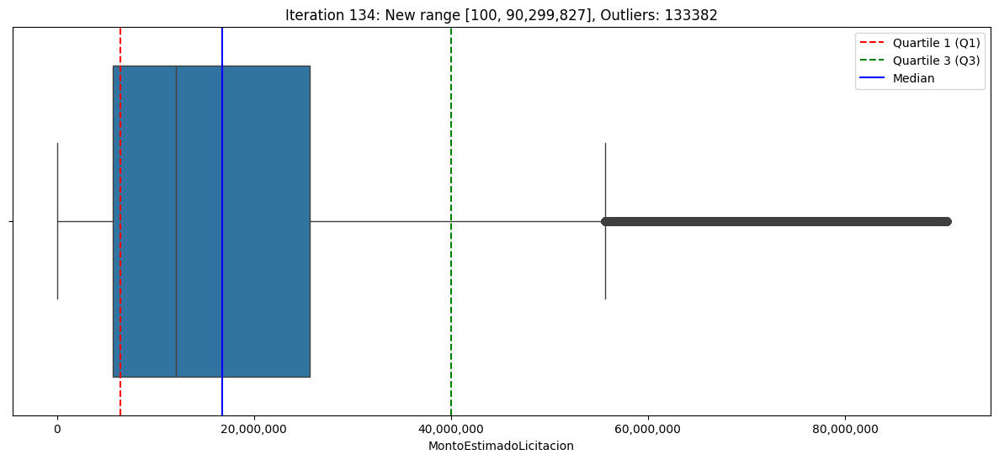

Iteration 134: New range [100, 90,299,827]


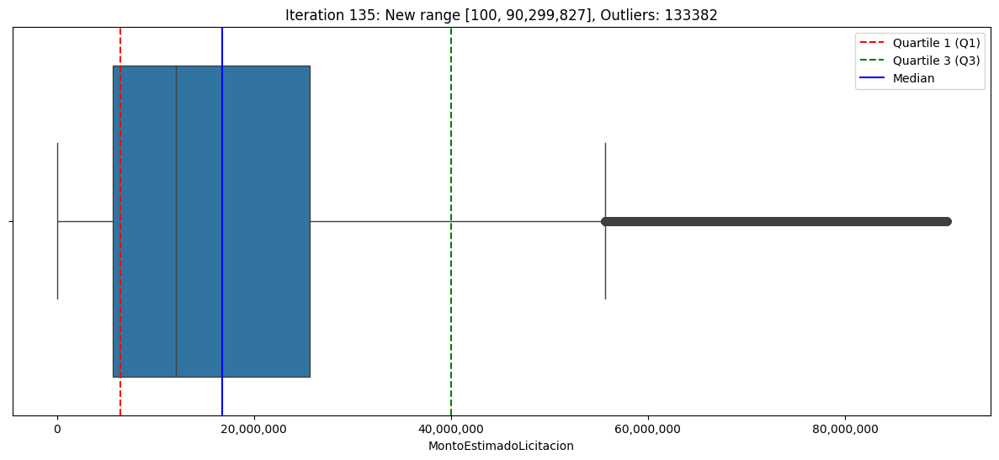

Iteration 135: New range [100, 90,299,827]


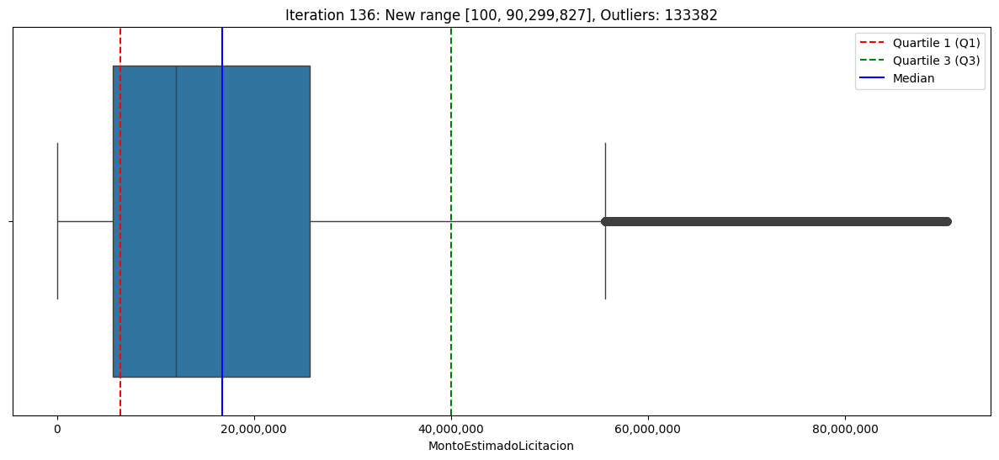

Iteration 136: New range [100, 90,299,827]


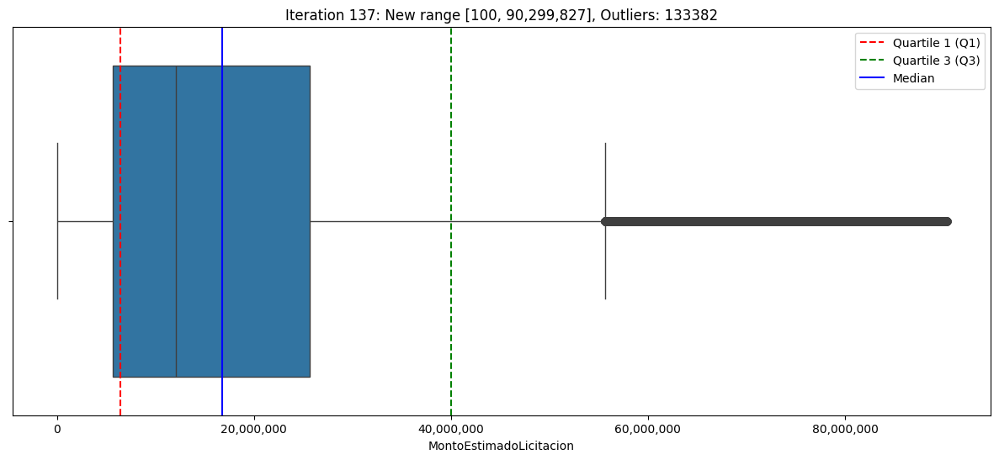

Iteration 137: New range [100, 90,299,827]


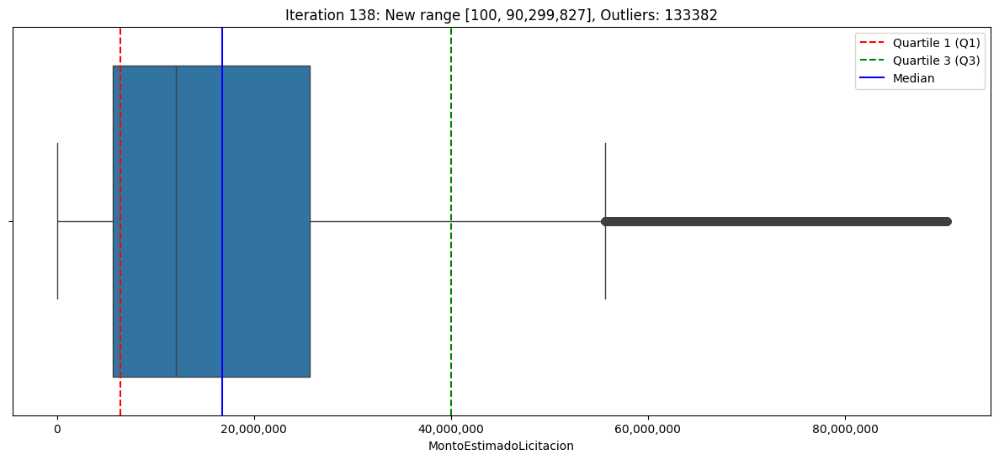

Iteration 138: New range [100, 90,299,827]


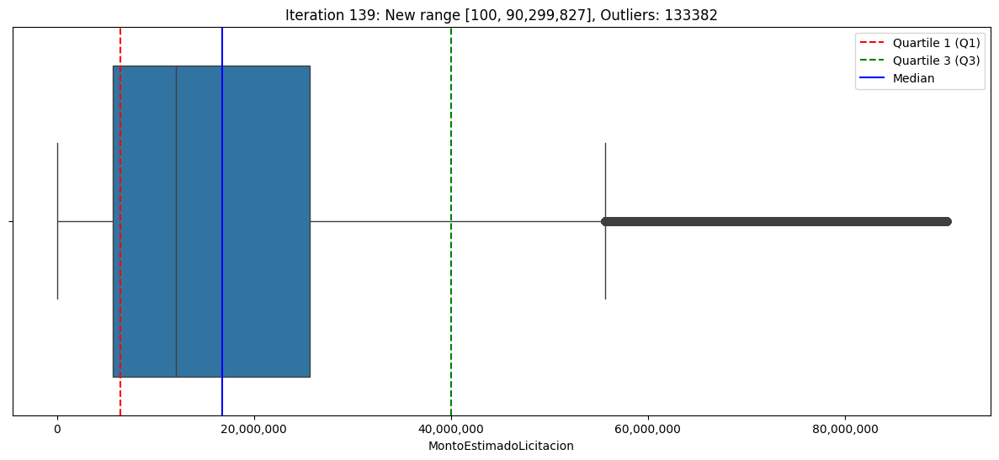

Iteration 139: New range [100, 90,299,827]


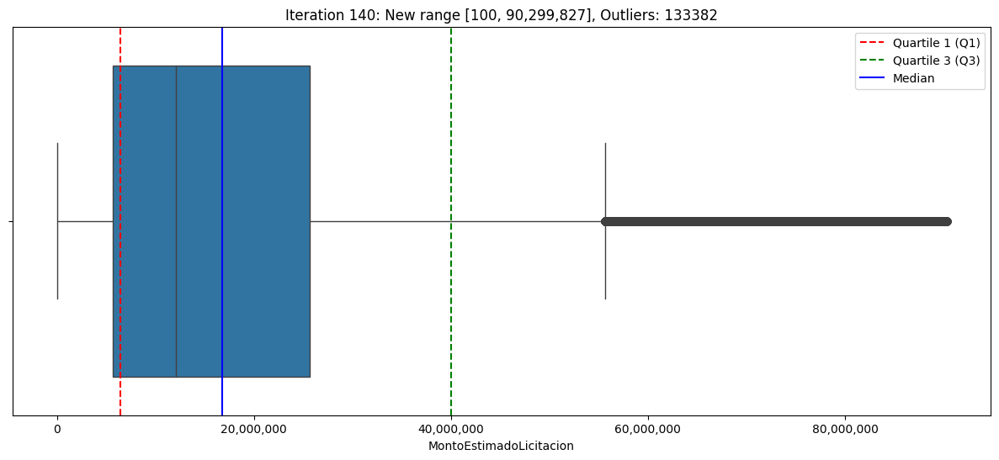

Iteration 140: New range [100, 90,299,827]


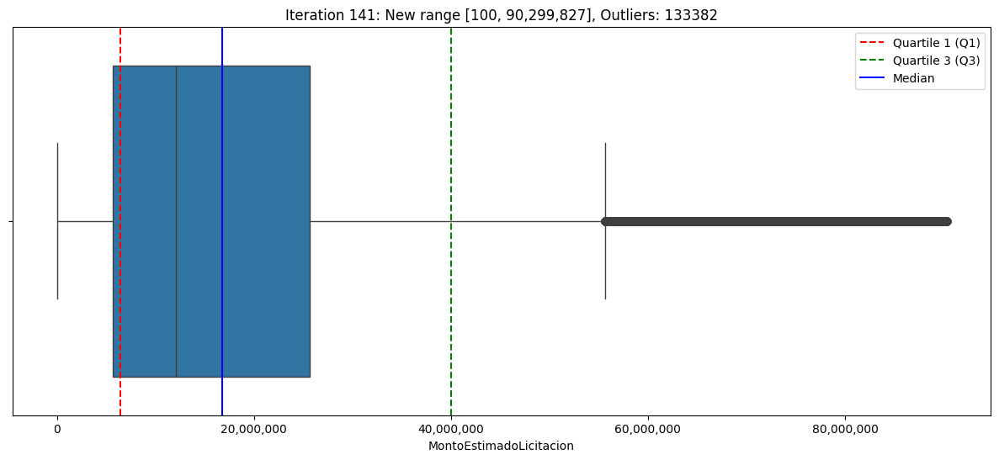

Iteration 141: New range [100, 90,299,827]


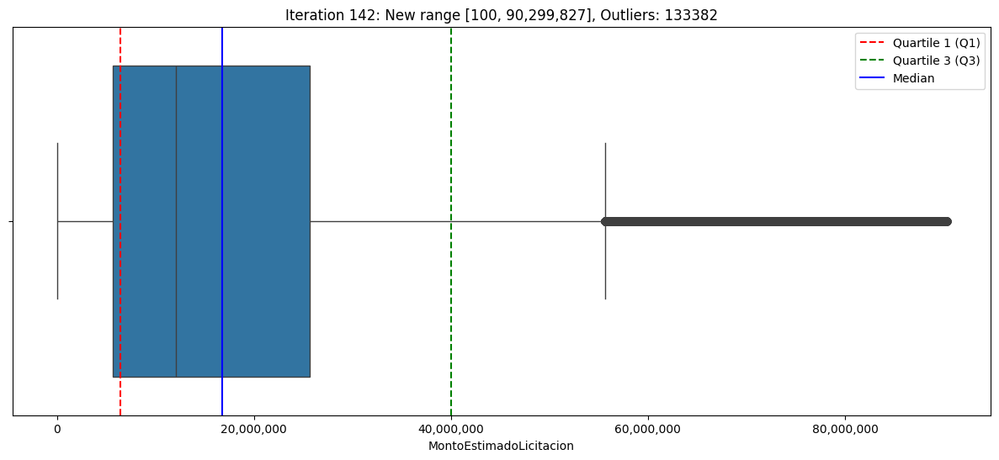

Iteration 142: New range [100, 90,299,827]


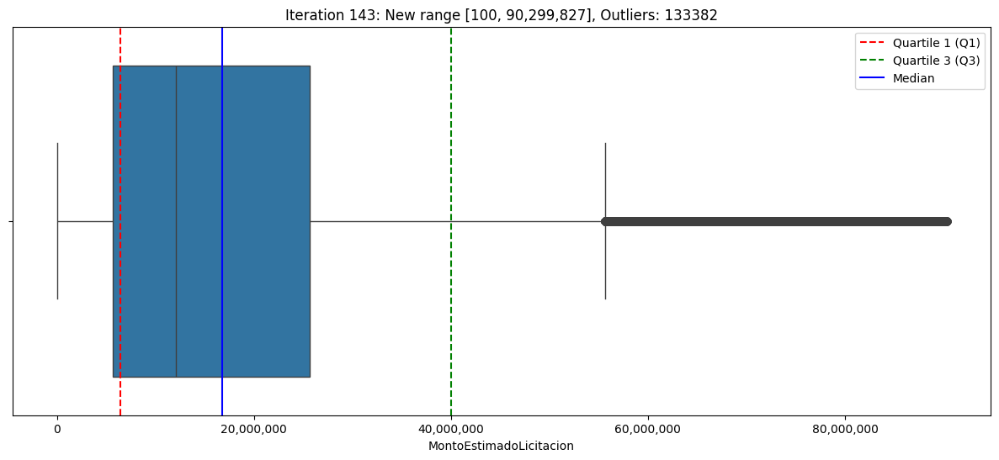

Iteration 143: New range [100, 90,299,827]


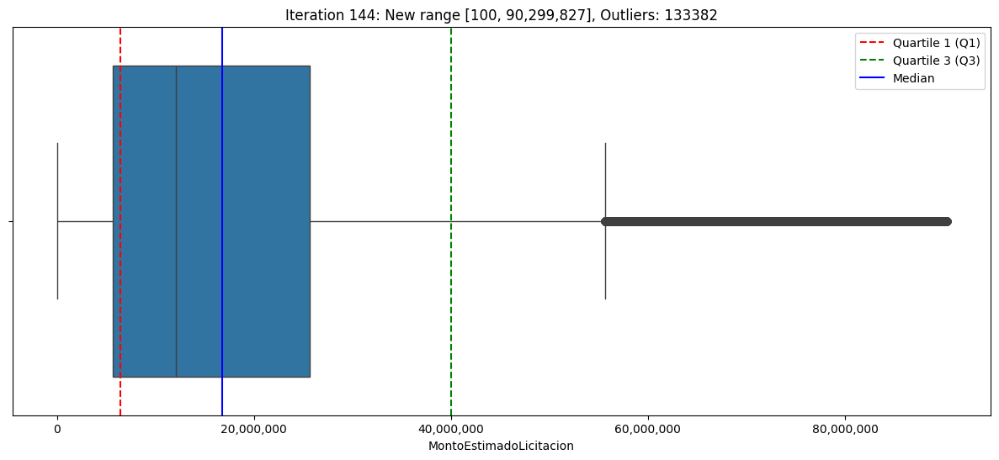

Iteration 144: New range [100, 90,299,827]


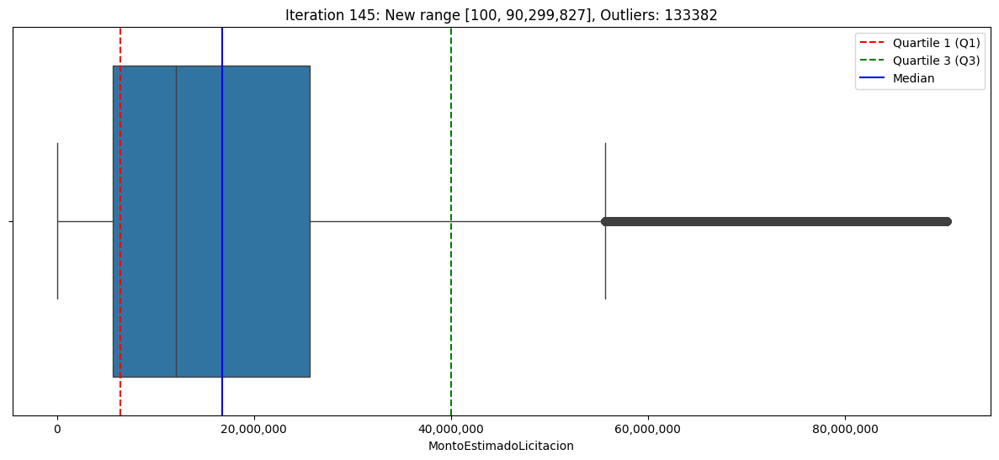

Iteration 145: New range [100, 90,299,827]


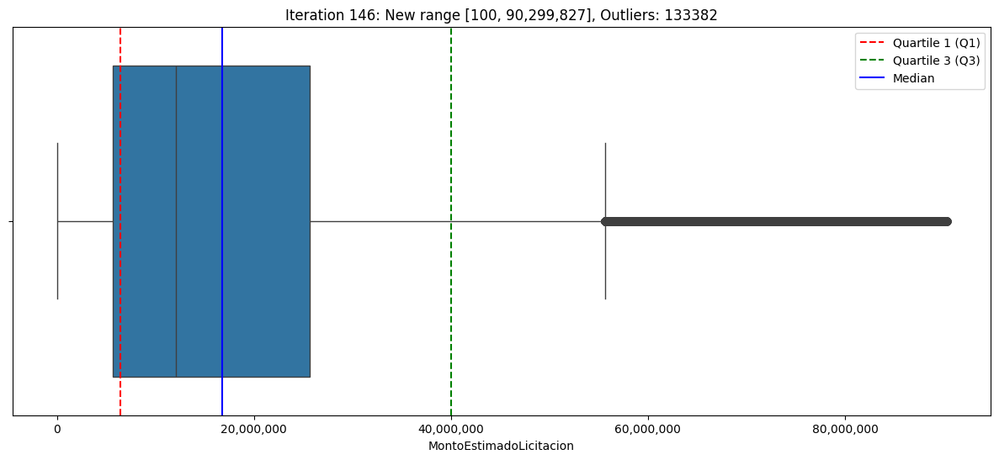

Iteration 146: New range [100, 90,299,827]


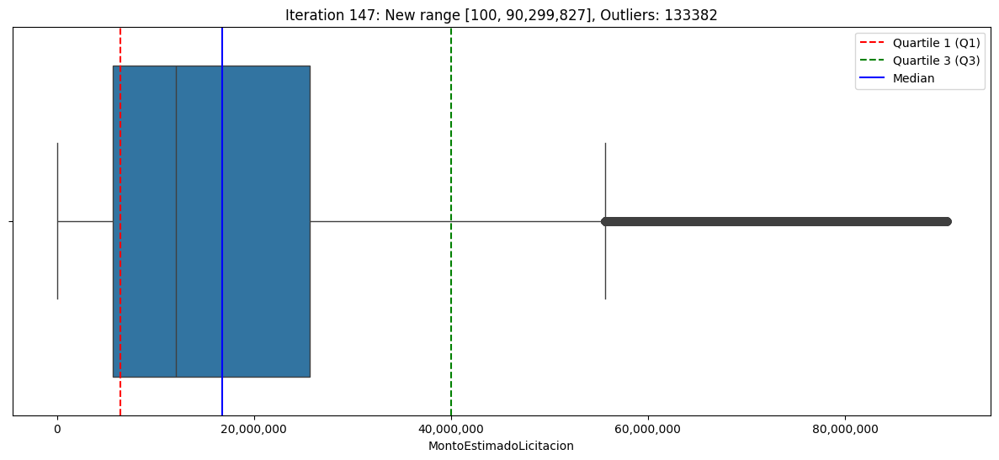

Iteration 147: New range [100, 90,299,827]


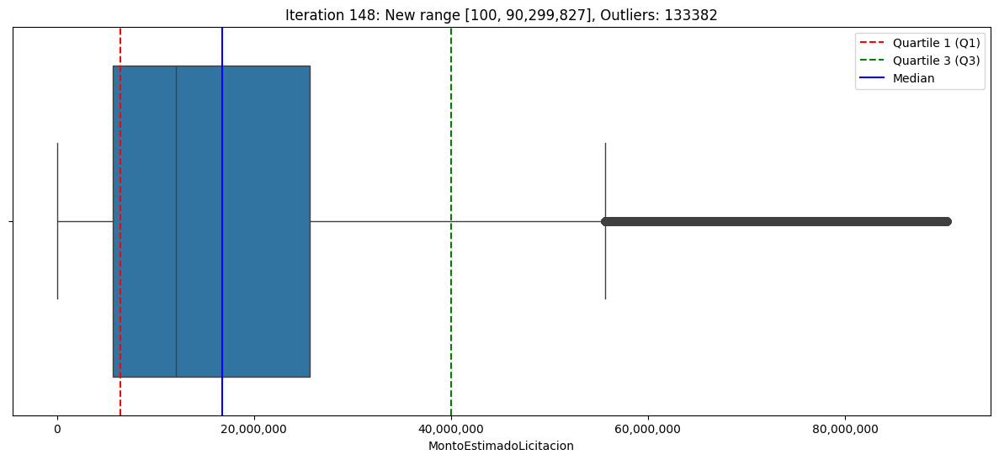

Iteration 148: New range [100, 90,299,827]


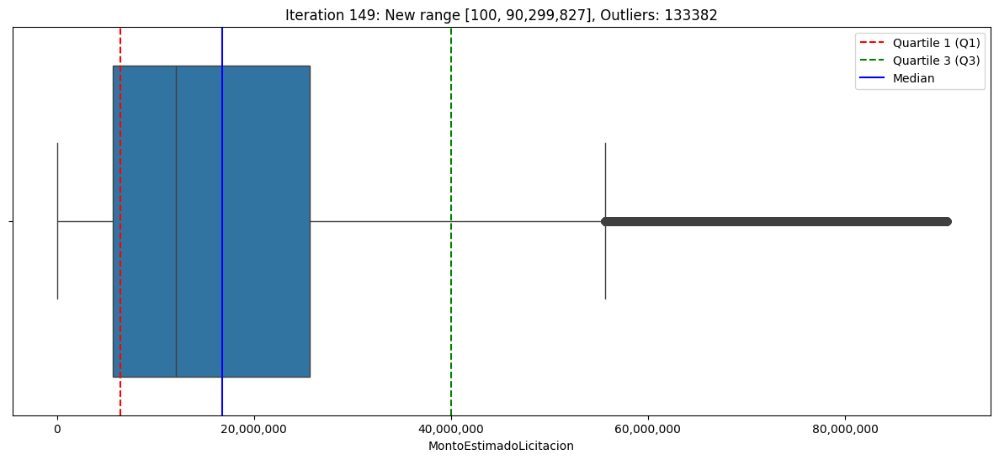

Iteration 149: New range [100, 90,299,827]


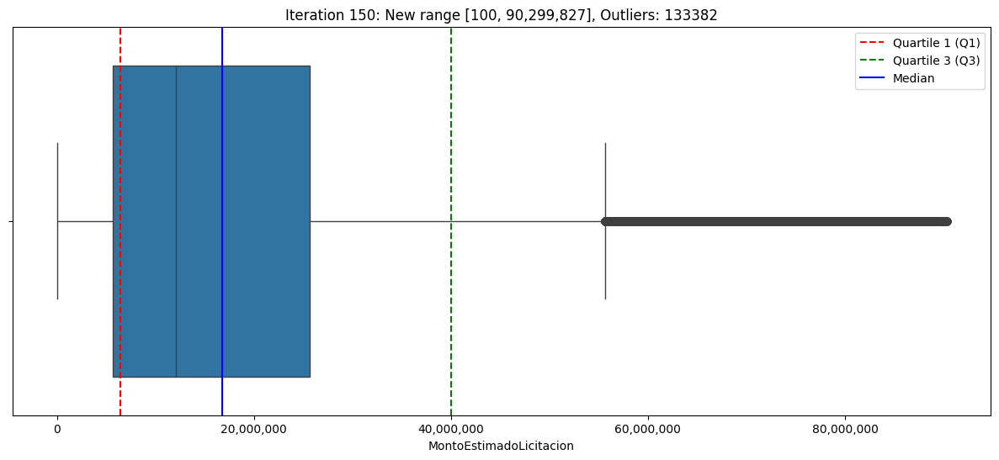

Iteration 150: New range [100, 90,299,827]


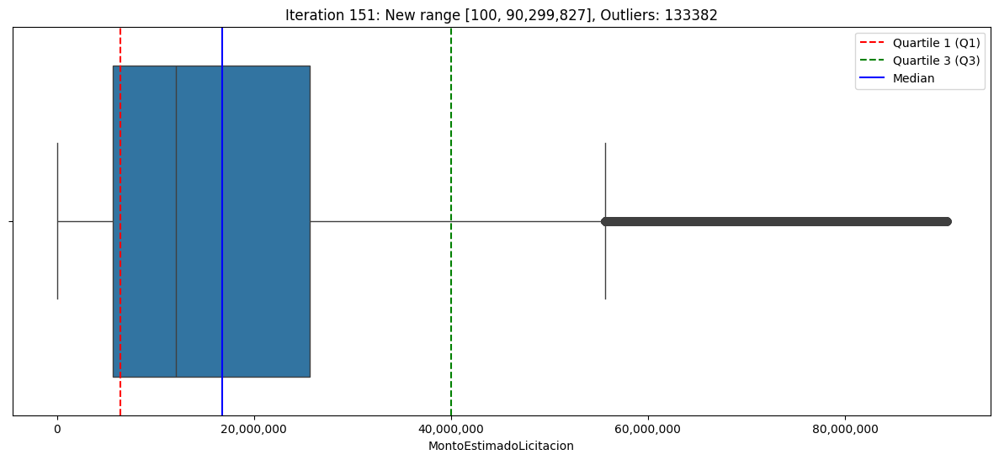

Iteration 151: New range [100, 90,299,827]


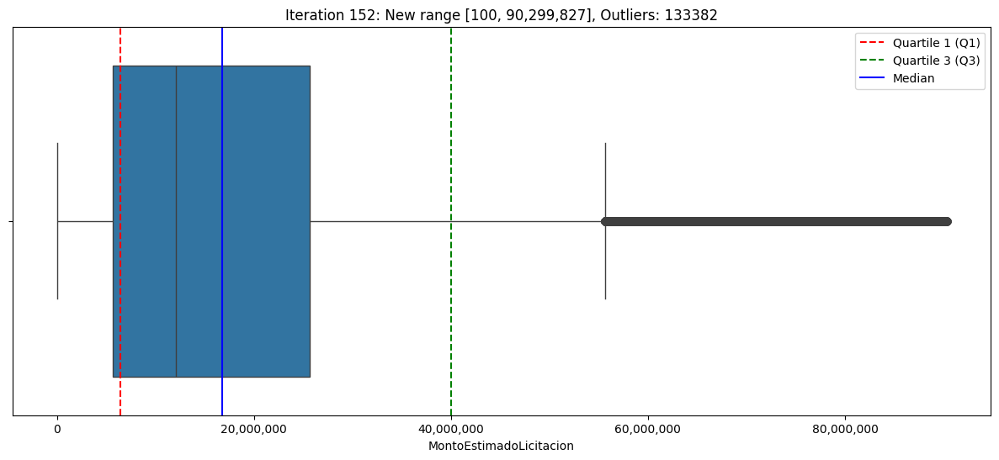

Iteration 152: New range [100, 90,299,827]


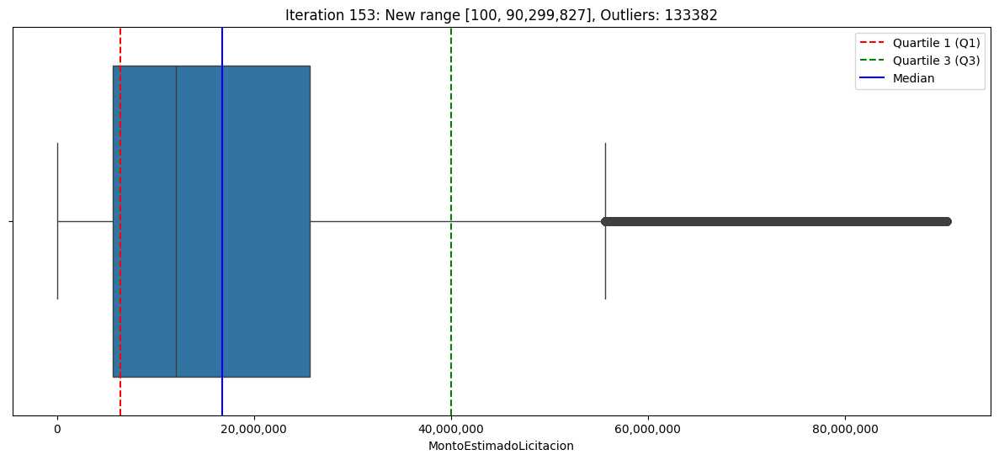

Iteration 153: New range [100, 90,299,827]


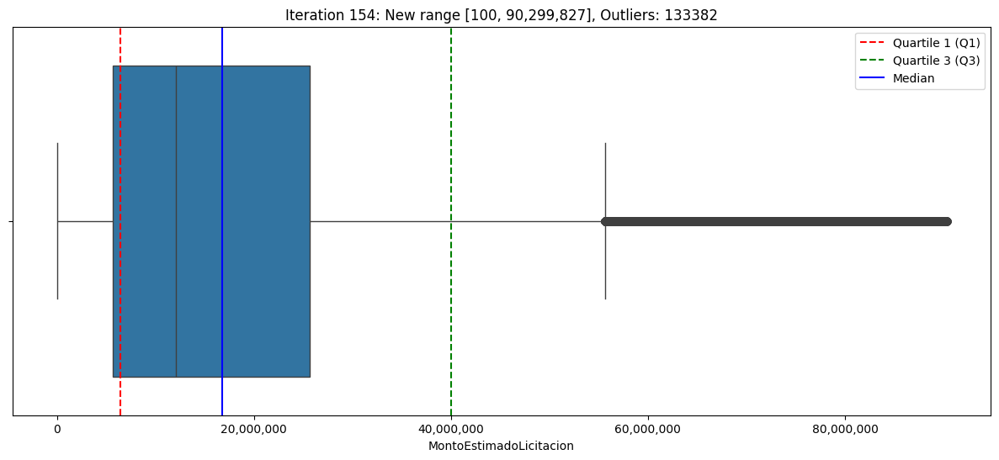

Iteration 154: New range [100, 90,299,827]


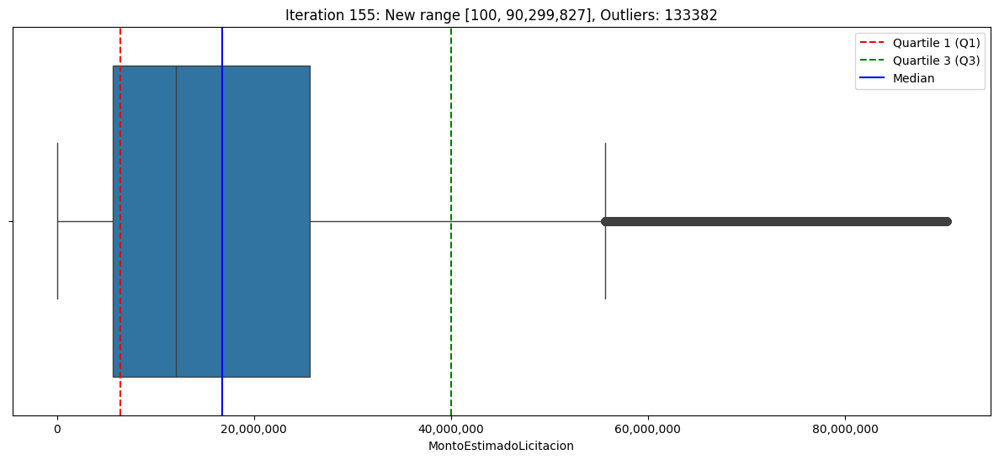

Iteration 155: New range [100, 90,299,827]


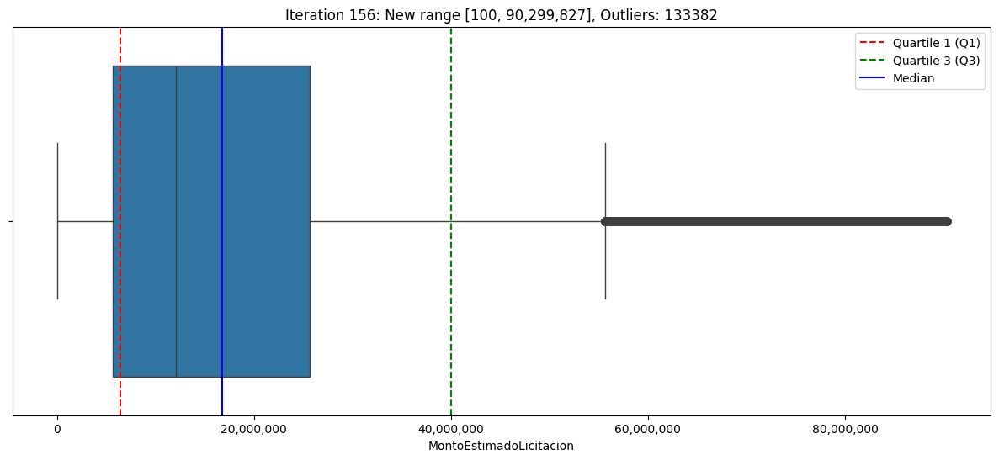

Iteration 156: New range [100, 90,299,827]


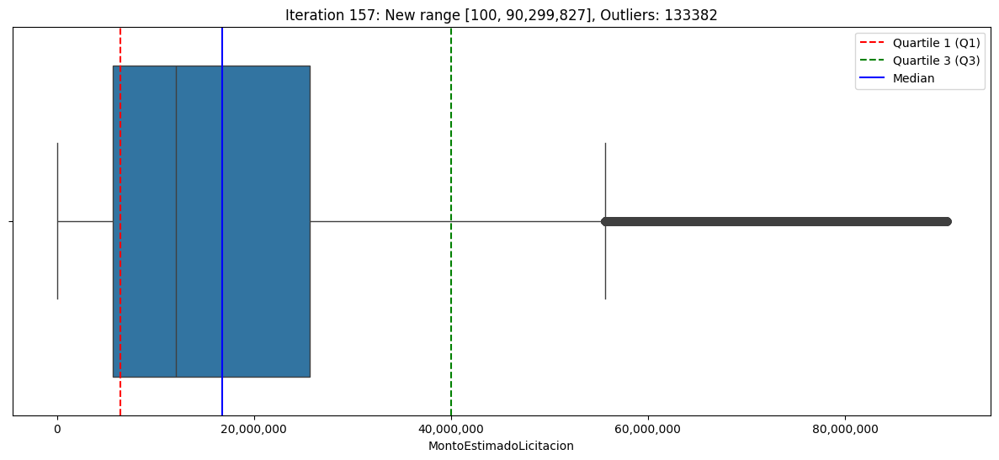

Iteration 157: New range [100, 90,299,827]


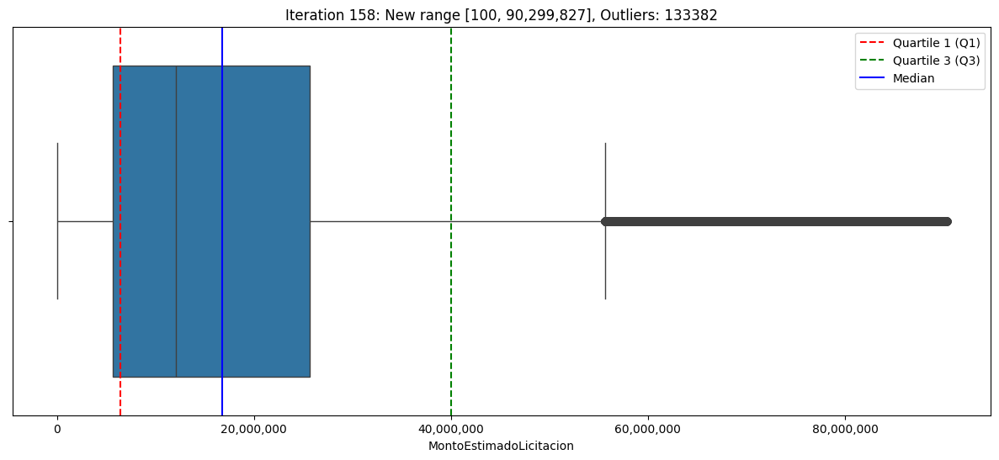

Iteration 158: New range [100, 90,299,827]


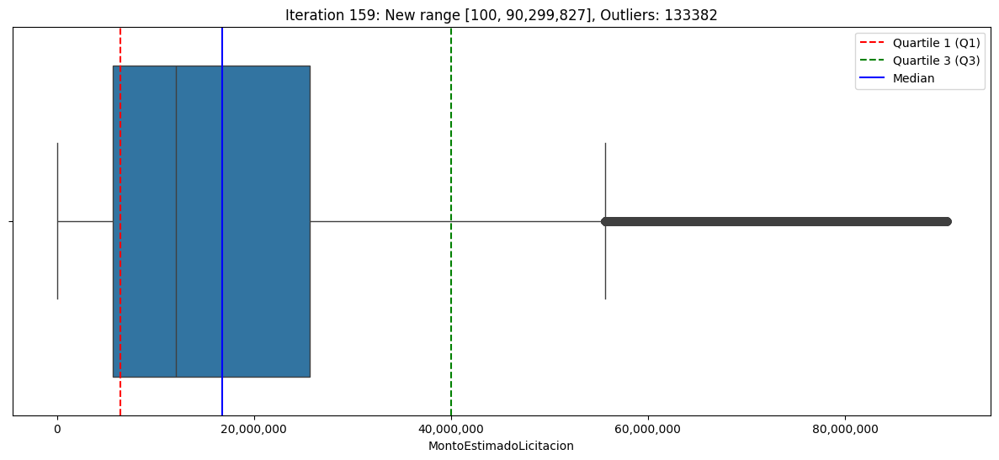

Iteration 159: New range [100, 90,299,827]


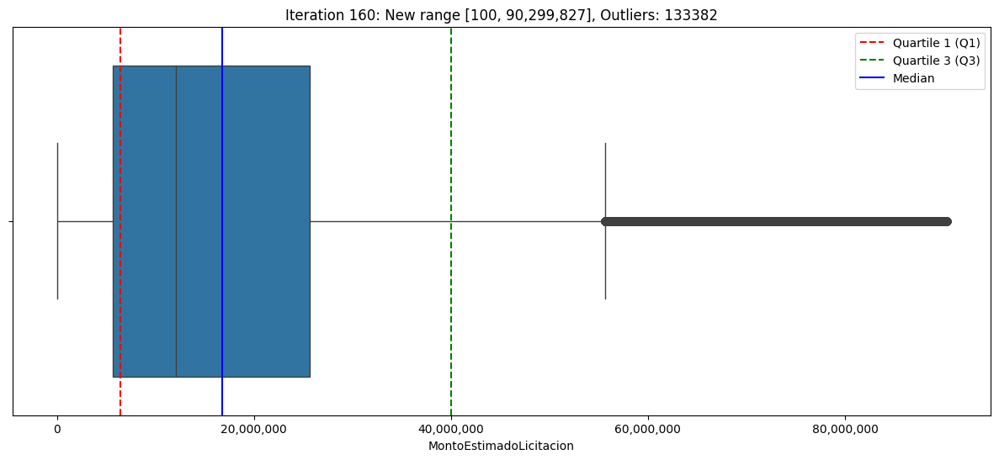

Iteration 160: New range [100, 90,299,827]


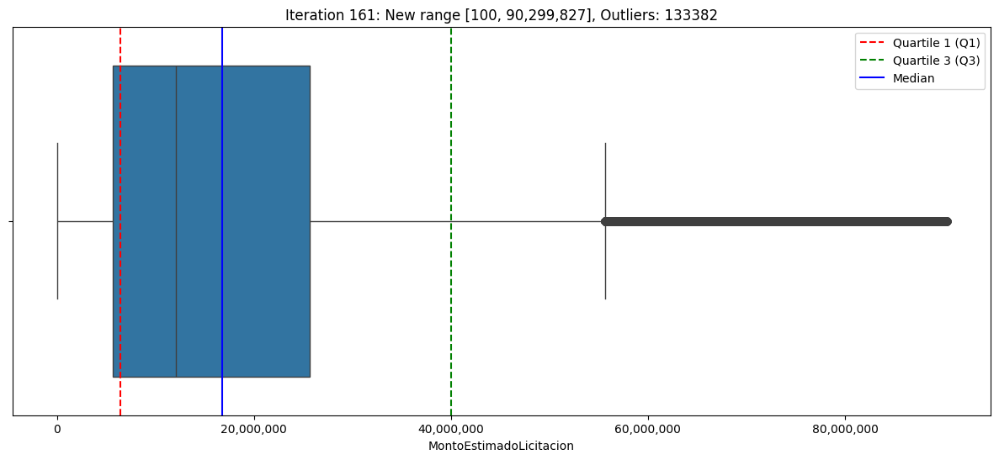

Iteration 161: New range [100, 90,299,827]


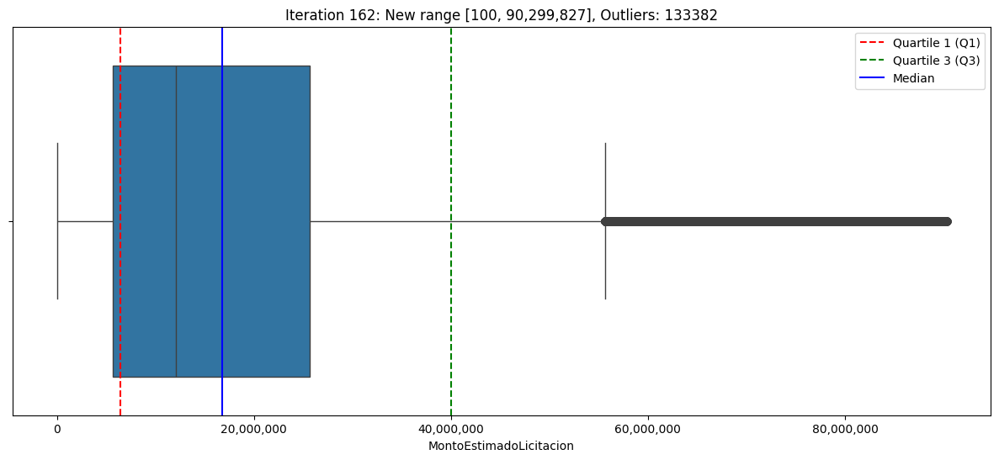

Iteration 162: New range [100, 90,299,827]


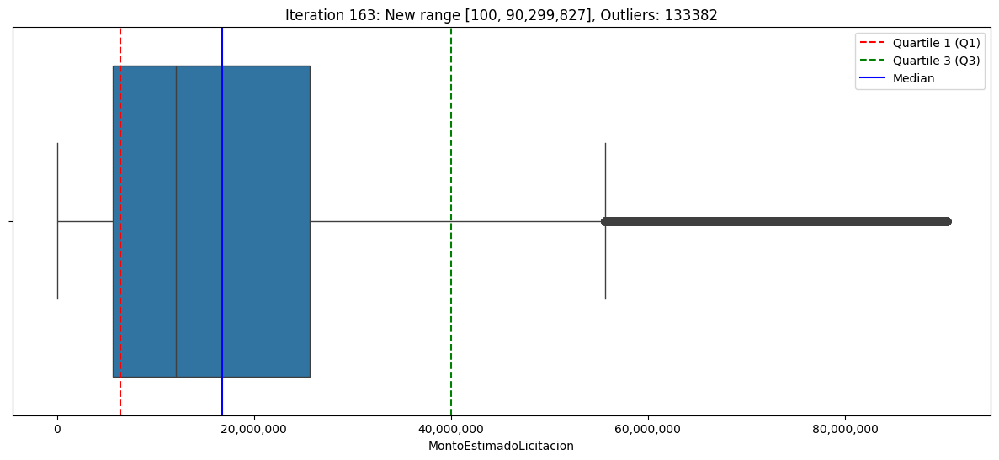

Iteration 163: New range [100, 90,299,827]


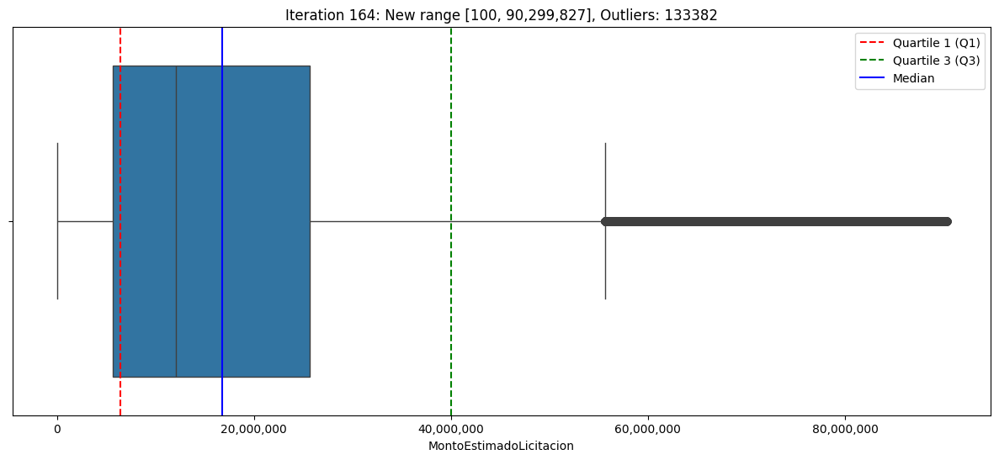

Iteration 164: New range [100, 90,299,827]


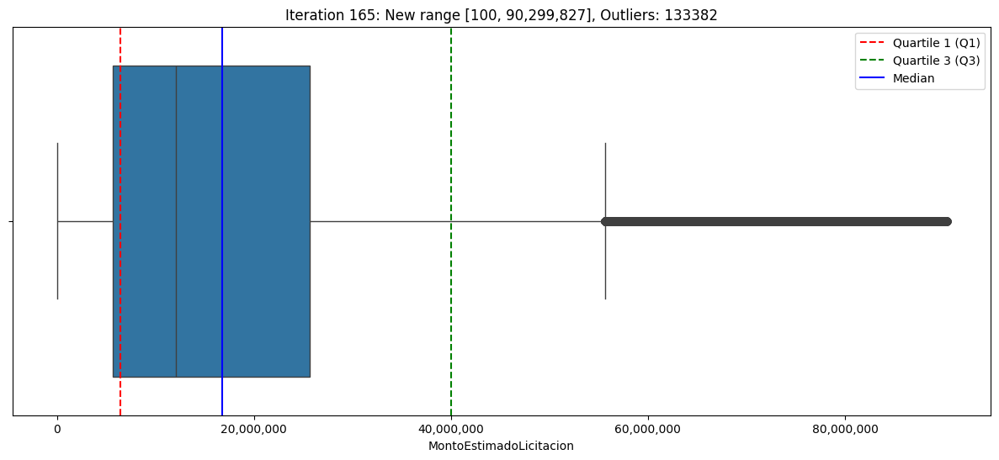

Iteration 165: New range [100, 90,299,827]


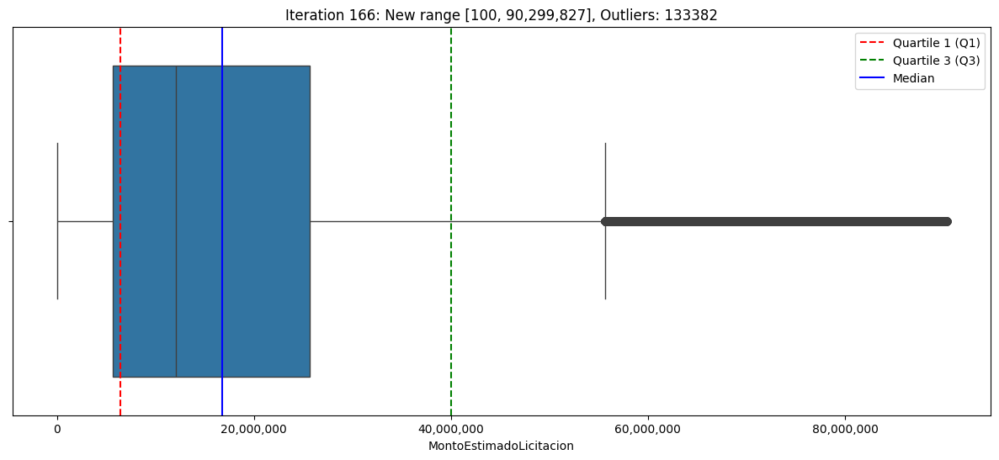

Iteration 166: New range [100, 90,299,827]


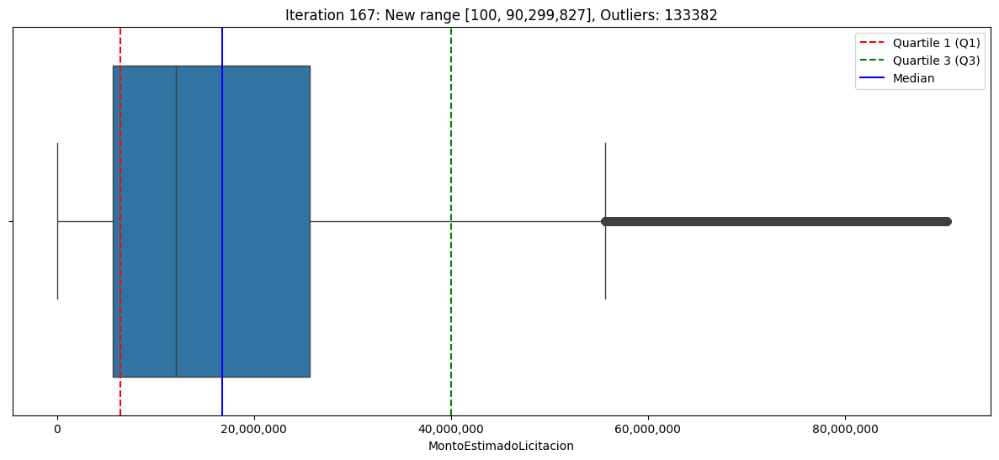

Iteration 167: New range [100, 90,299,827]


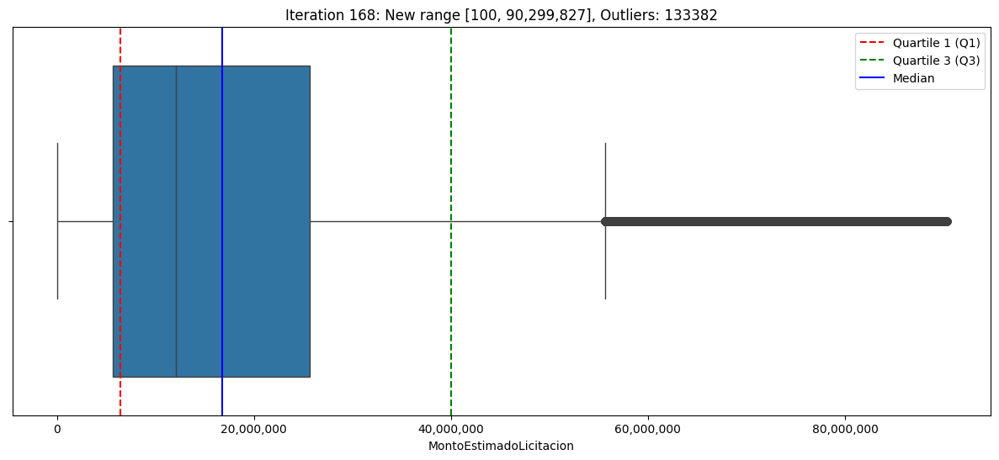

Iteration 168: New range [100, 90,299,827]


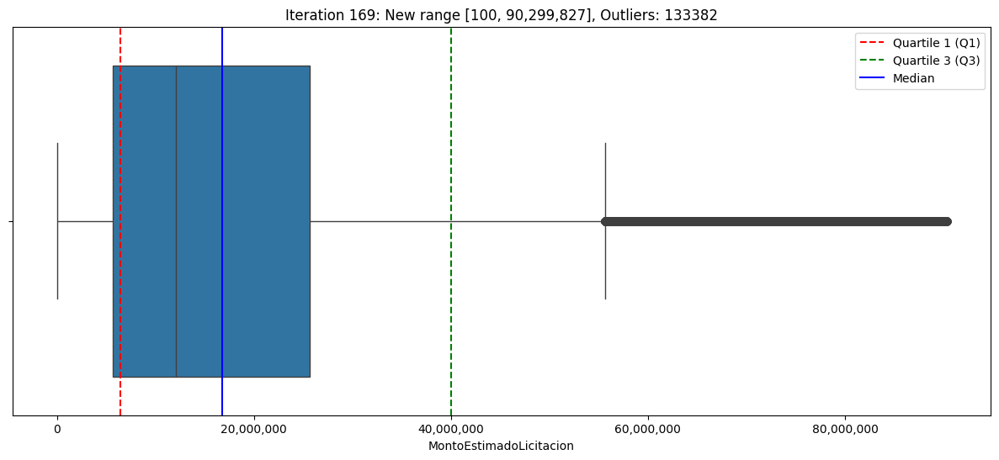

Iteration 169: New range [100, 90,299,827]


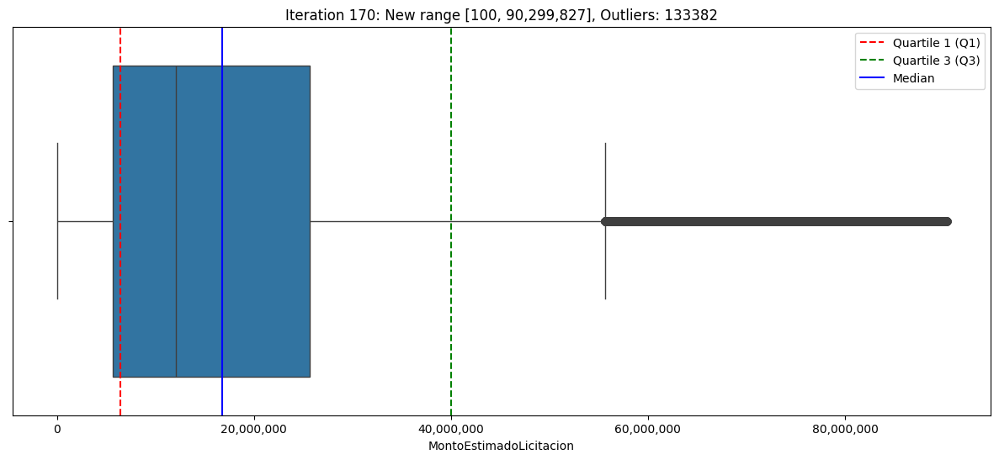

Iteration 170: New range [100, 90,299,827]


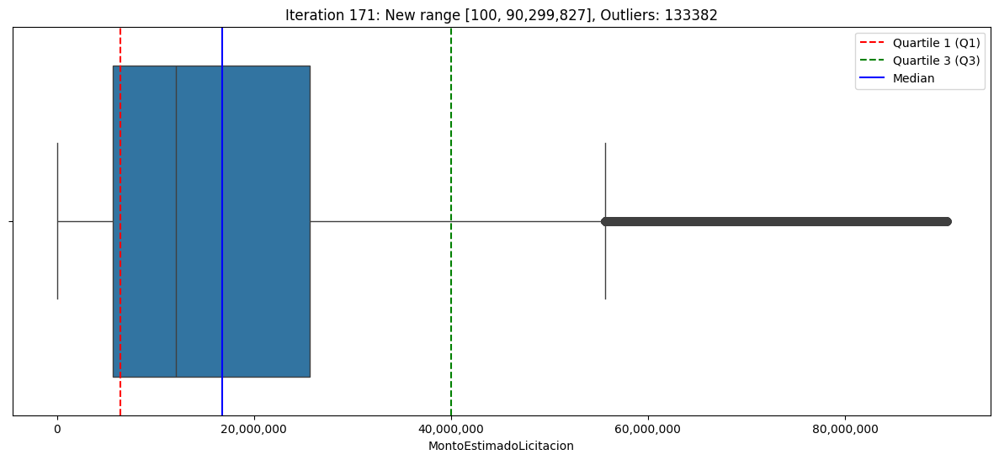

Iteration 171: New range [100, 90,299,827]


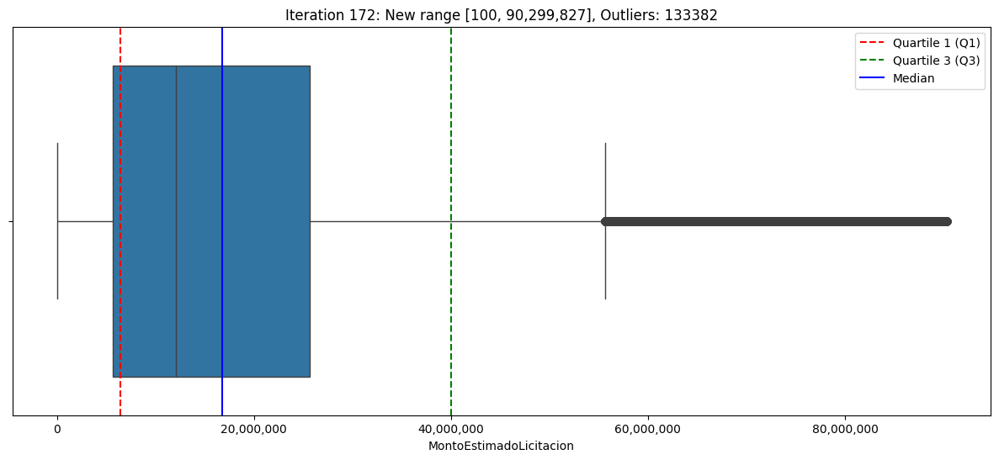

Iteration 172: New range [100, 90,299,827]


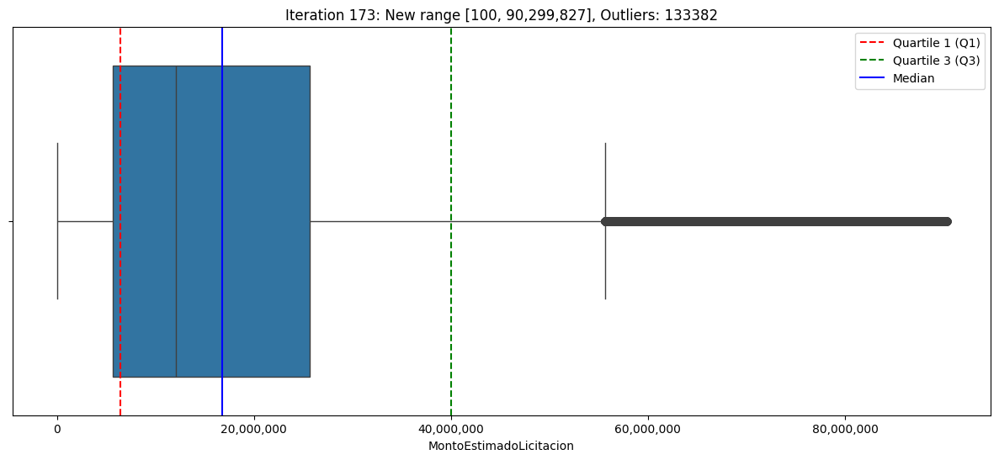

Iteration 173: New range [100, 90,299,827]


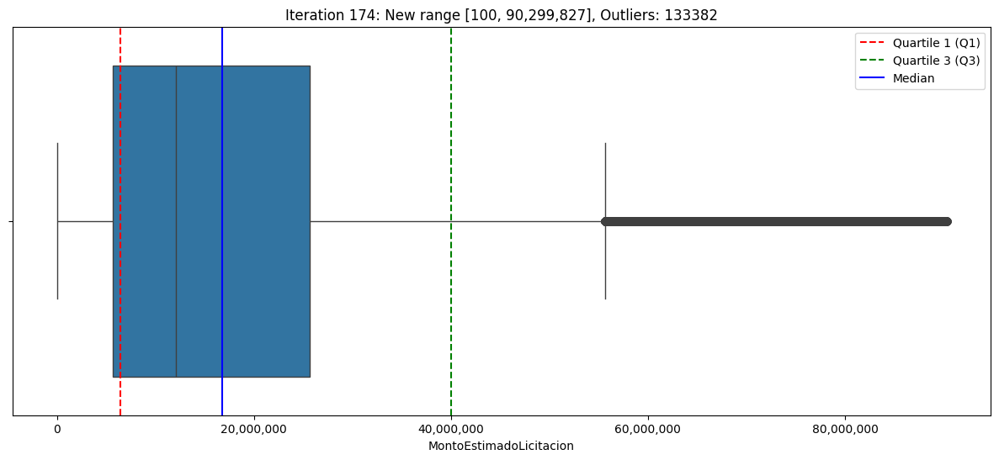

Iteration 174: New range [100, 90,299,827]


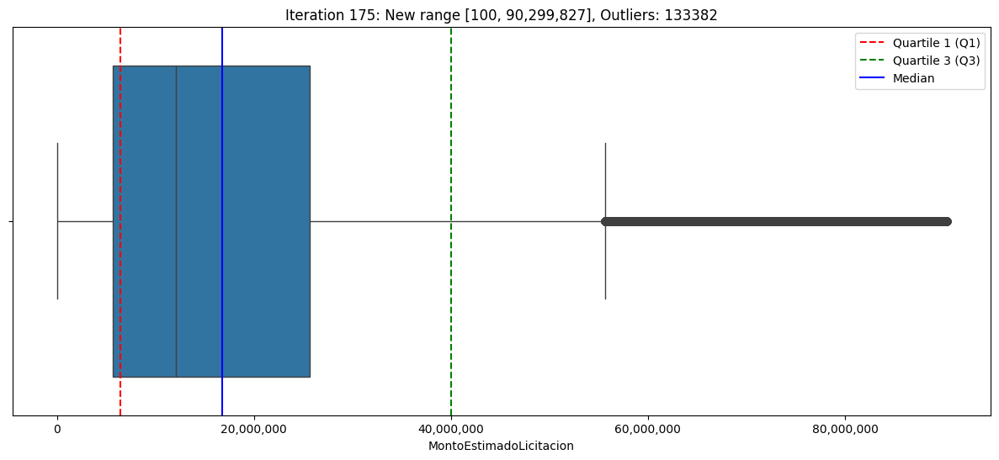

Iteration 175: New range [100, 90,299,827]


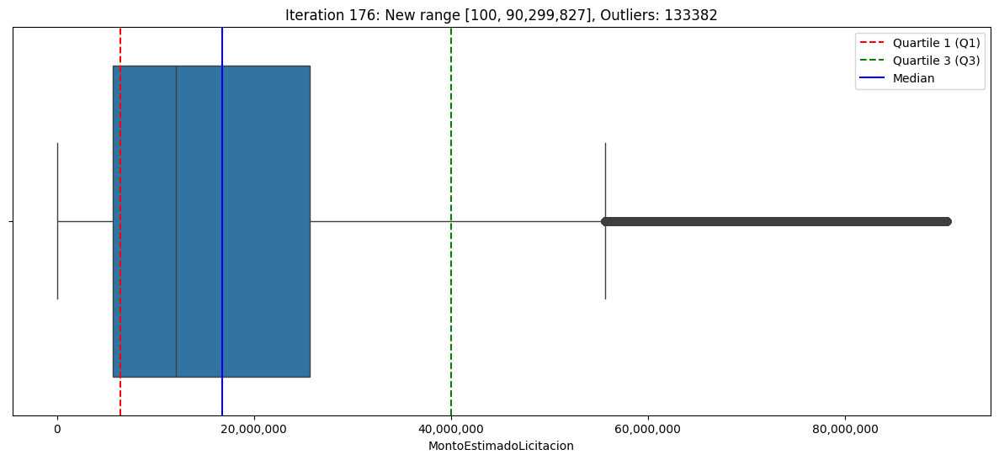

Iteration 176: New range [100, 90,299,827]


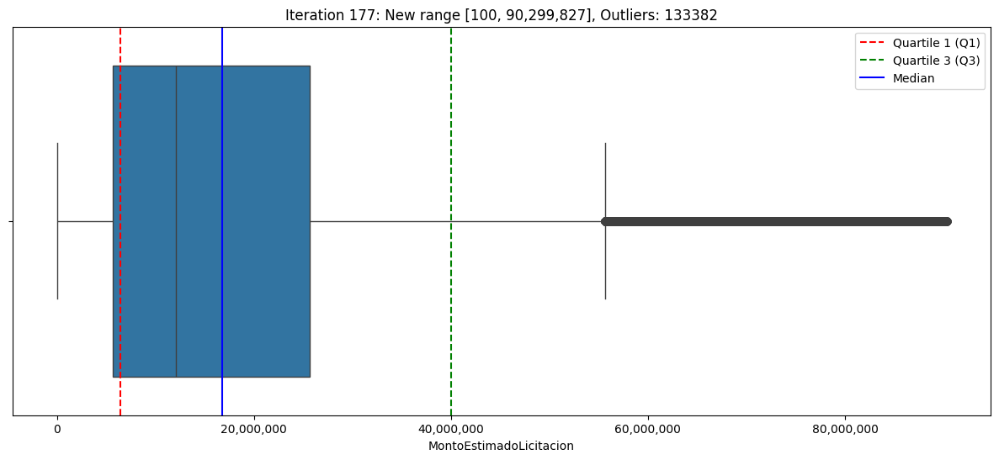

Iteration 177: New range [100, 90,299,827]


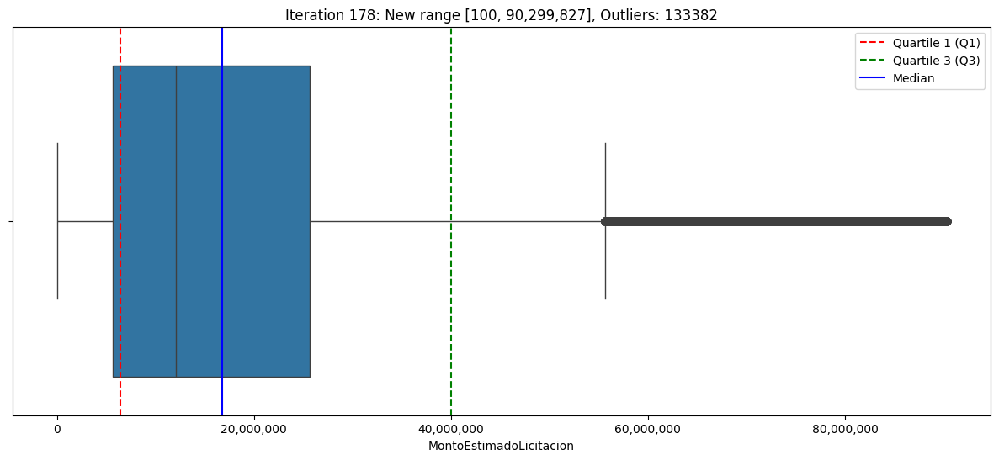

Iteration 178: New range [100, 90,299,827]


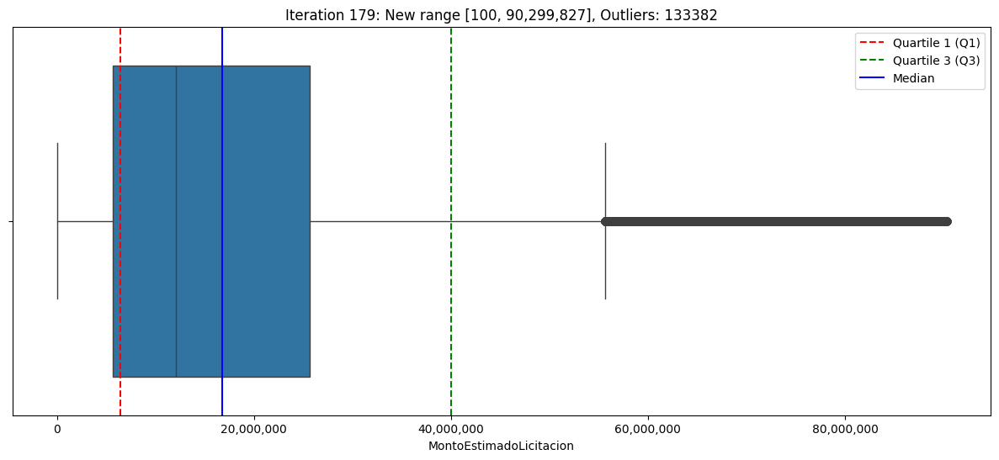

Iteration 179: New range [100, 90,299,827]


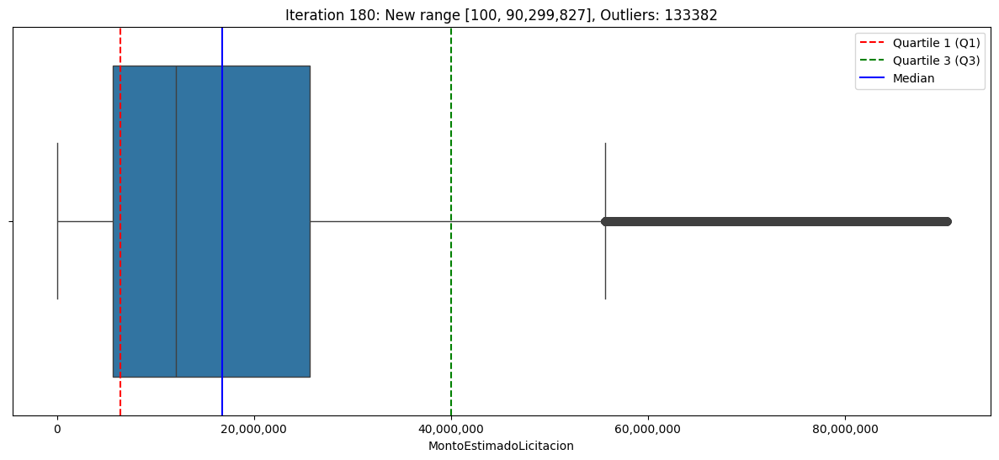

Iteration 180: New range [100, 90,299,827]


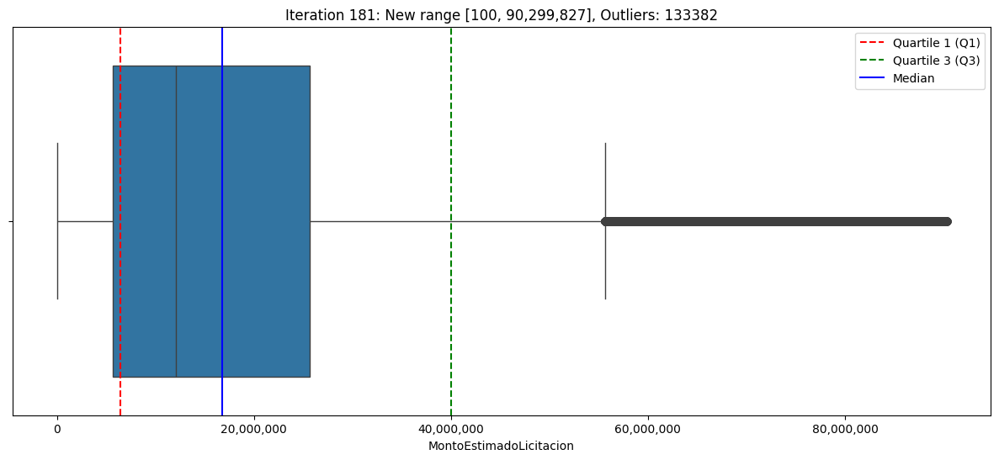

Iteration 181: New range [100, 90,299,827]


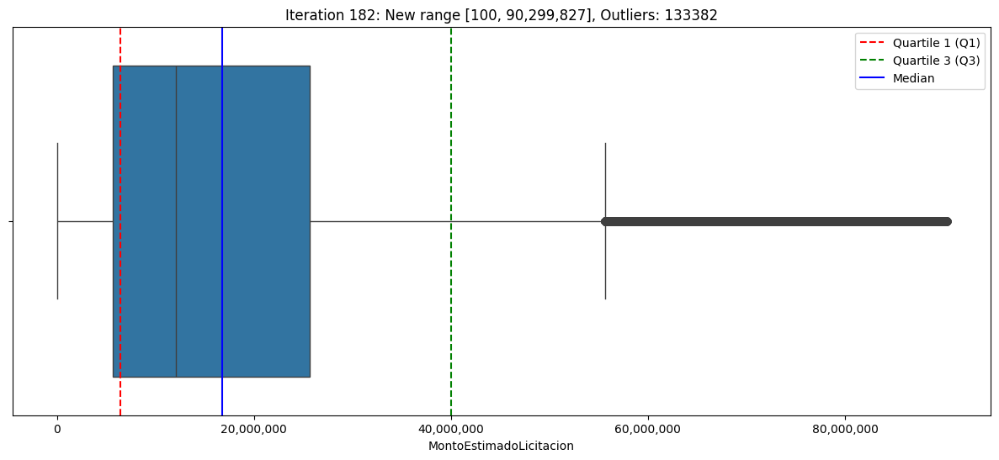

Iteration 182: New range [100, 90,299,827]


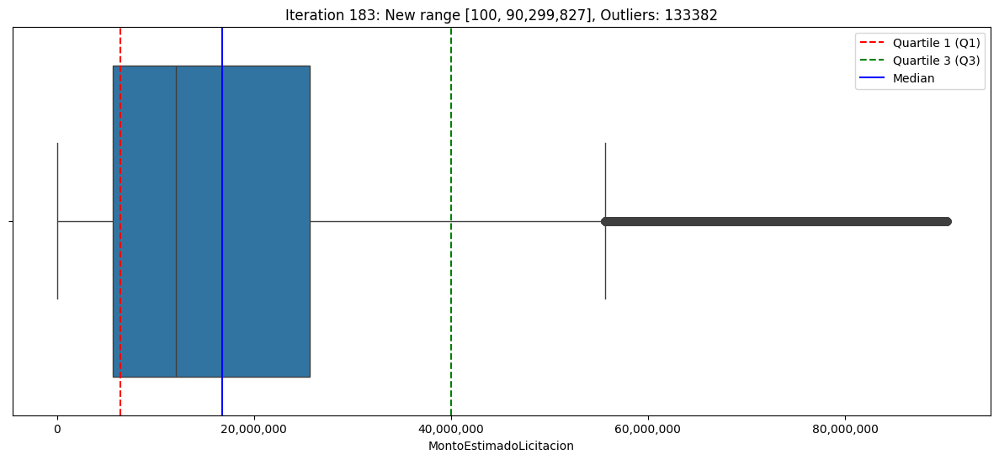

Iteration 183: New range [100, 90,299,827]


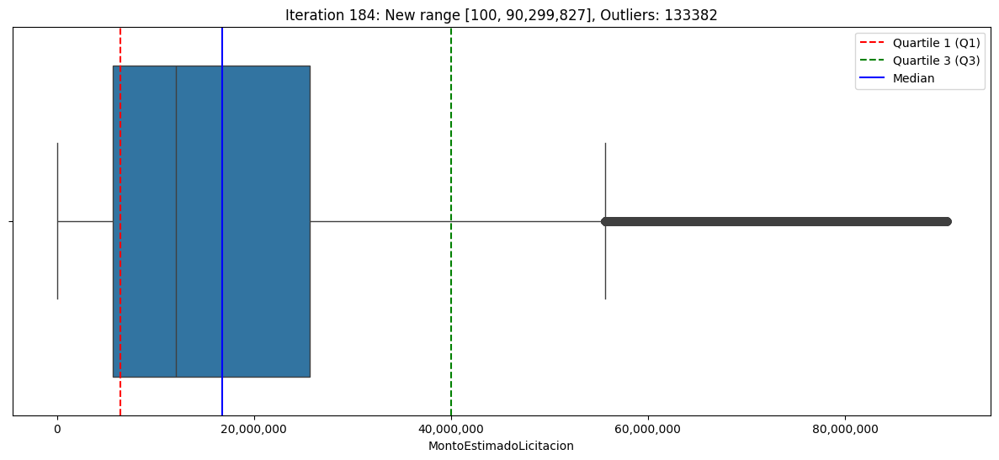

Iteration 184: New range [100, 90,299,827]


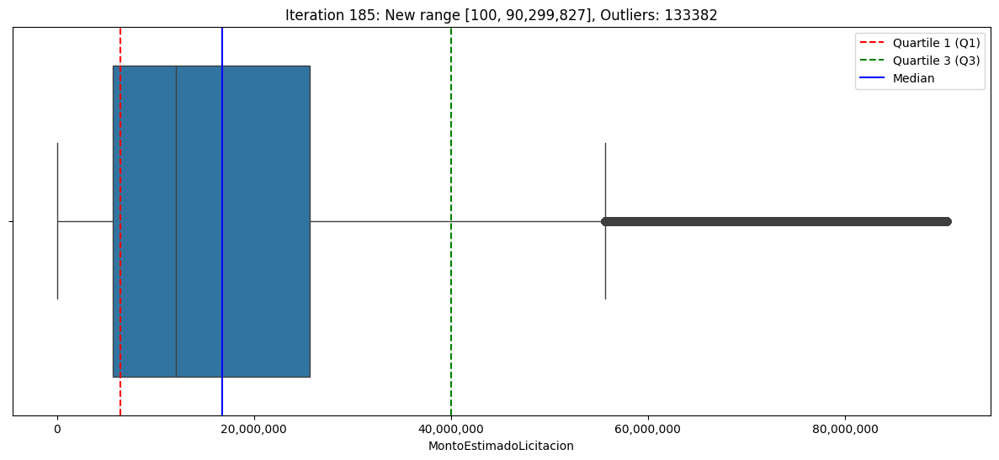

Iteration 185: New range [100, 90,299,827]


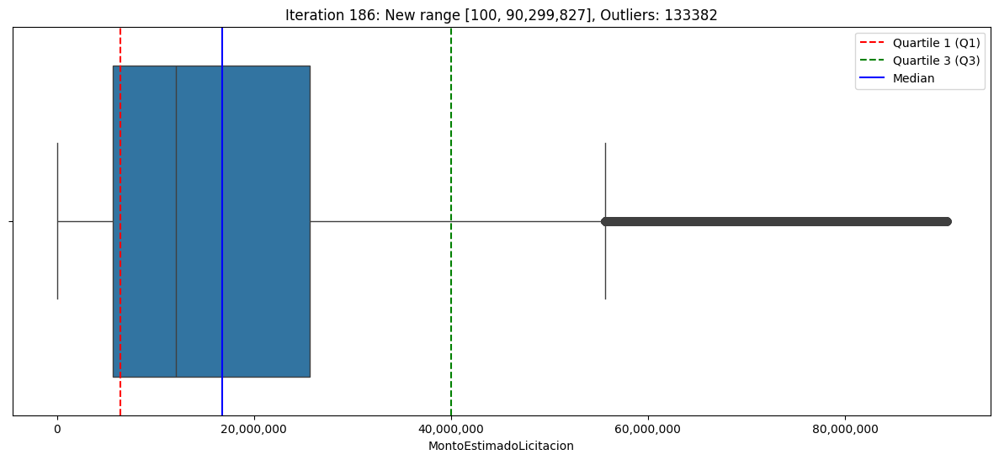

Iteration 186: New range [100, 90,299,827]


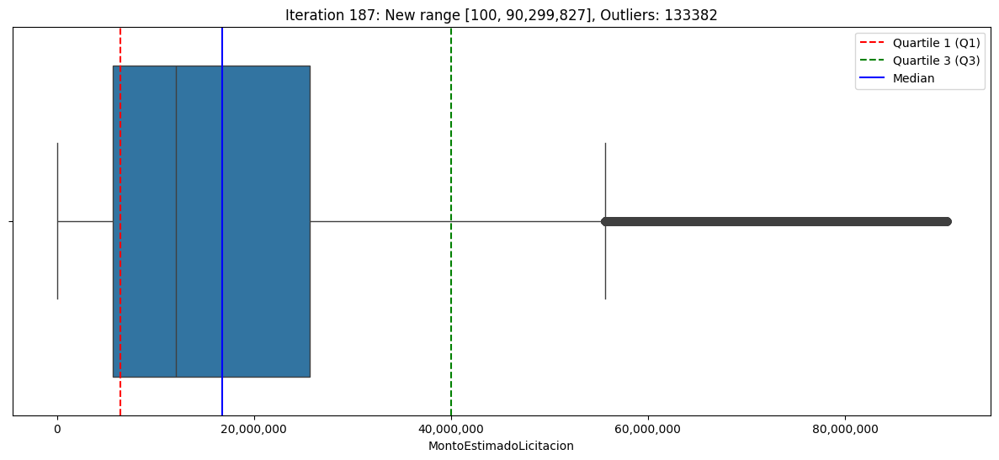

Iteration 187: New range [100, 90,299,827]


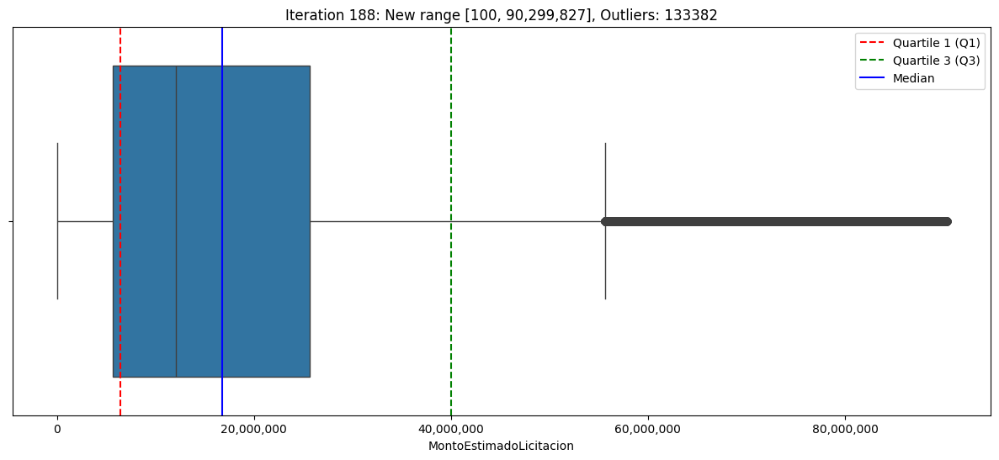

Iteration 188: New range [100, 90,299,827]


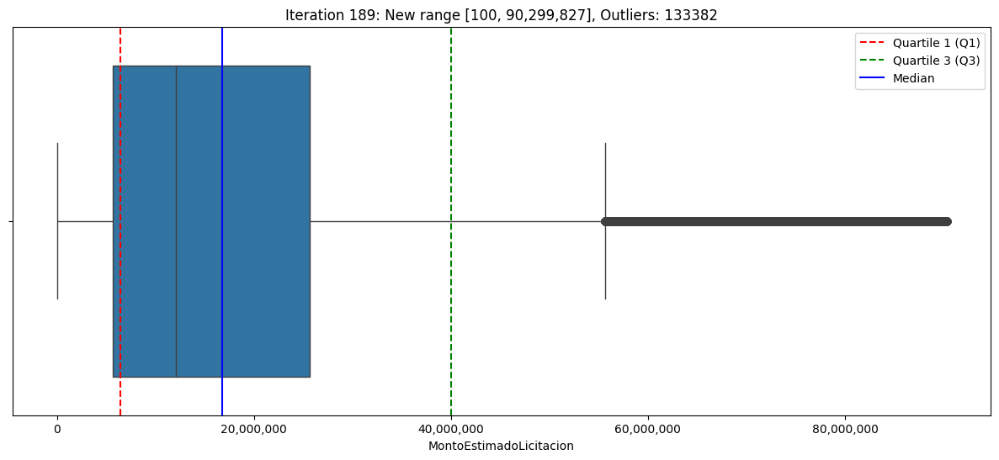

Iteration 189: New range [100, 90,299,827]


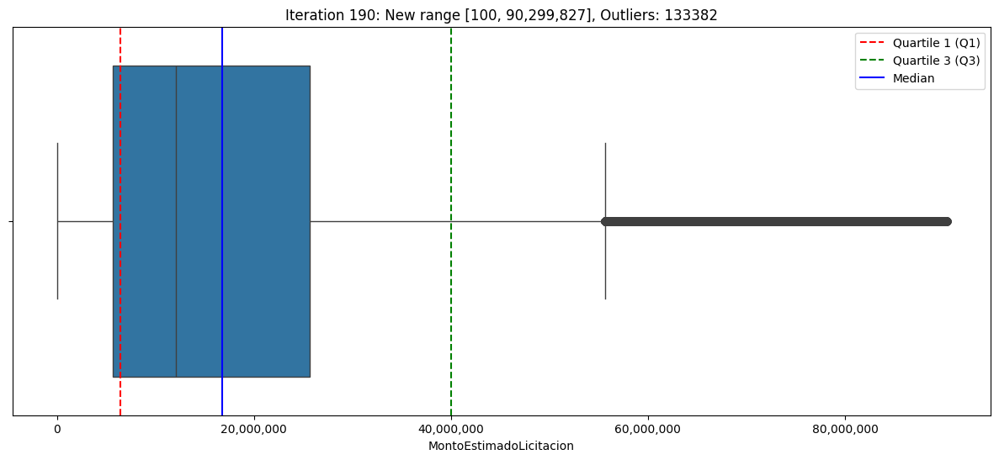

Iteration 190: New range [100, 90,299,827]


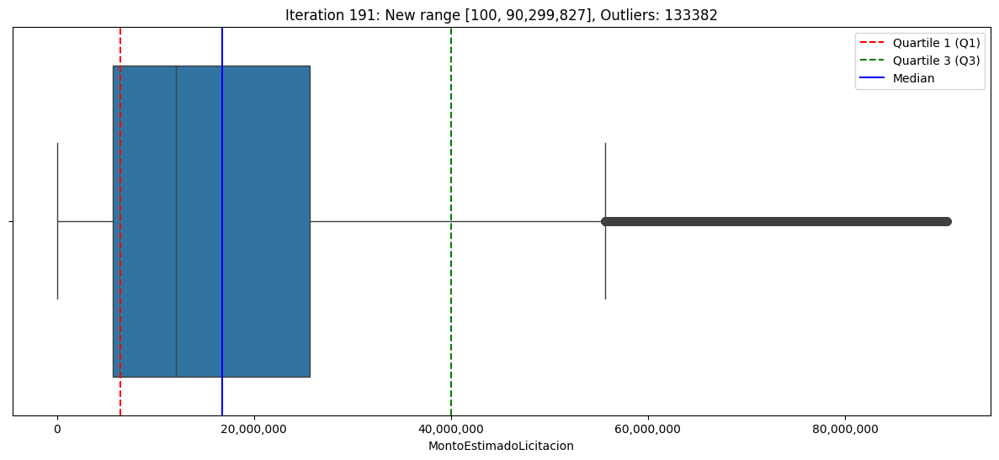

Iteration 191: New range [100, 90,299,827]


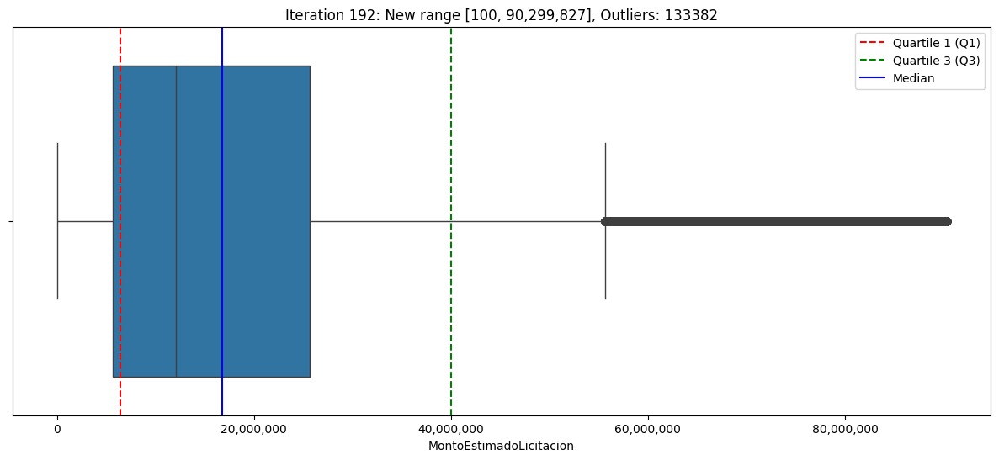

Iteration 192: New range [100, 90,299,827]


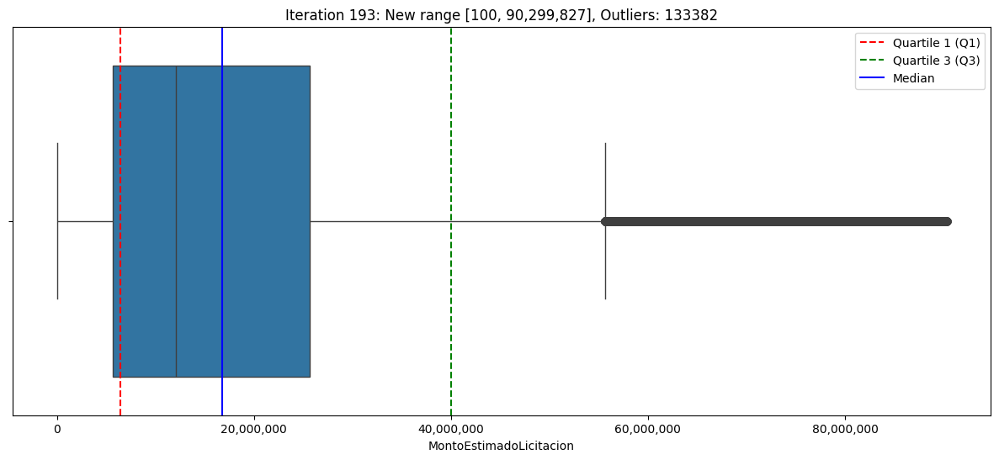

Iteration 193: New range [100, 90,299,827]


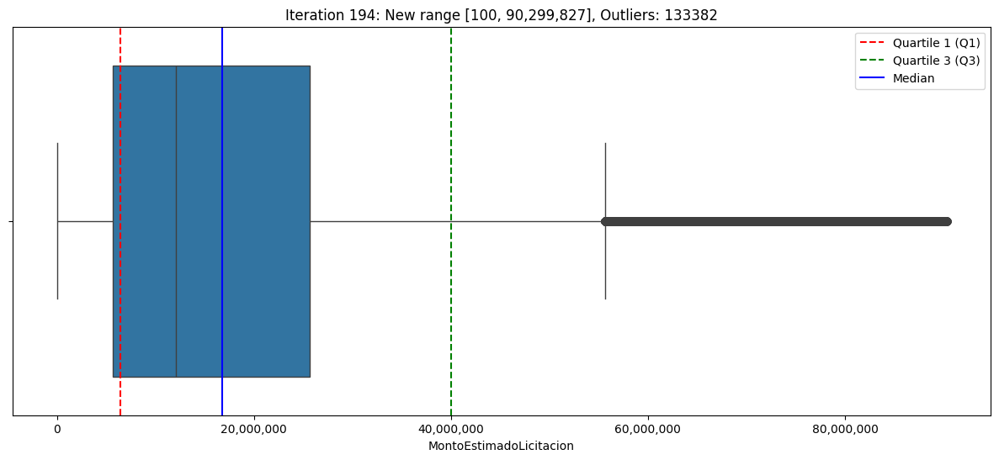

Iteration 194: New range [100, 90,299,827]


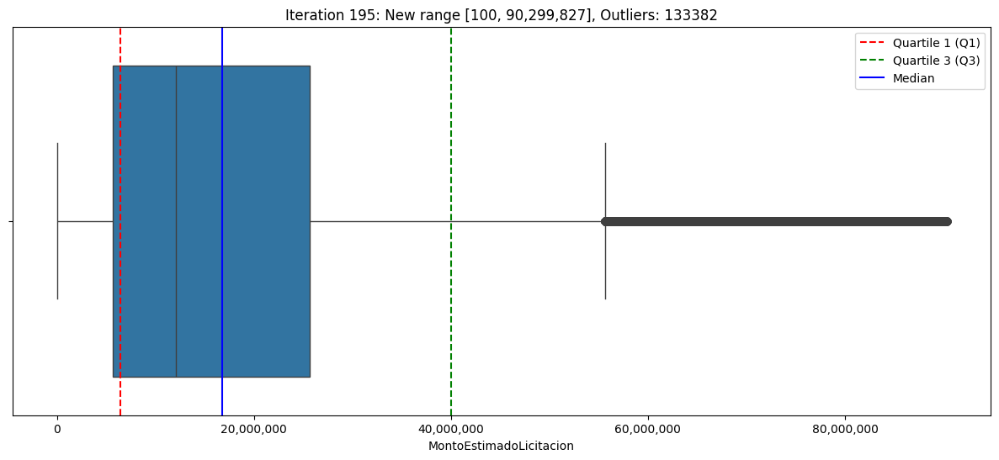

Iteration 195: New range [100, 90,299,827]


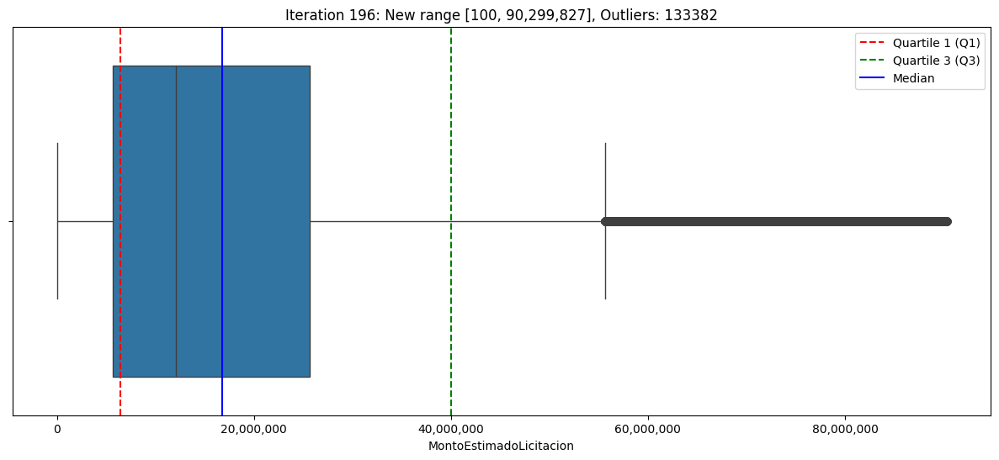

Iteration 196: New range [100, 90,299,827]


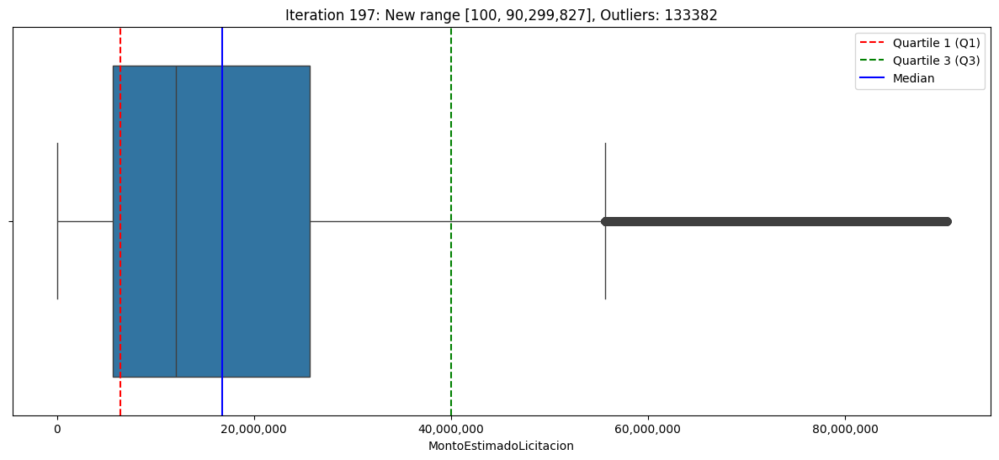

Iteration 197: New range [100, 90,299,827]


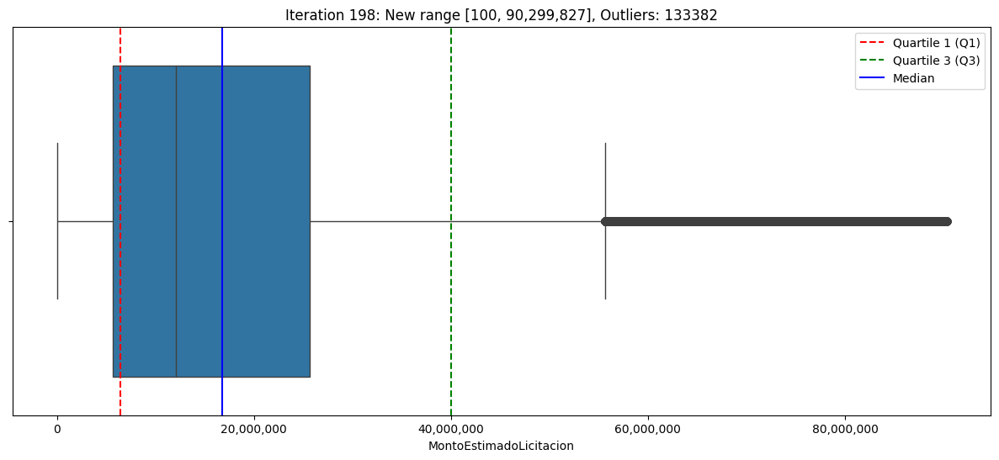

Iteration 198: New range [100, 90,299,827]


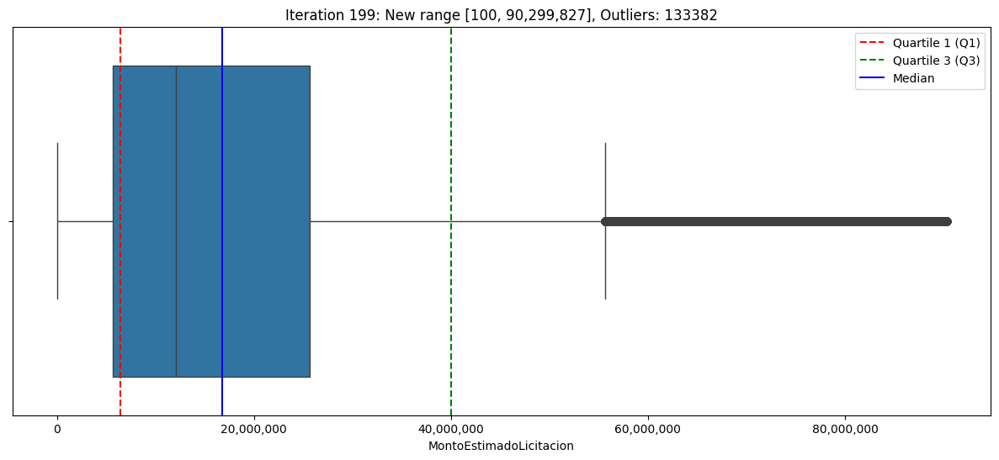

Iteration 199: New range [100, 90,299,827]


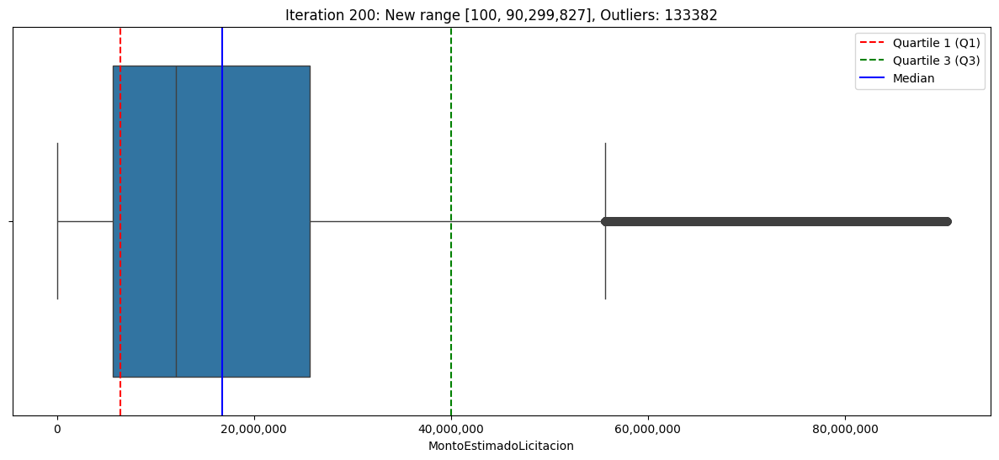

Iteration 200: New range [100, 90,299,827]


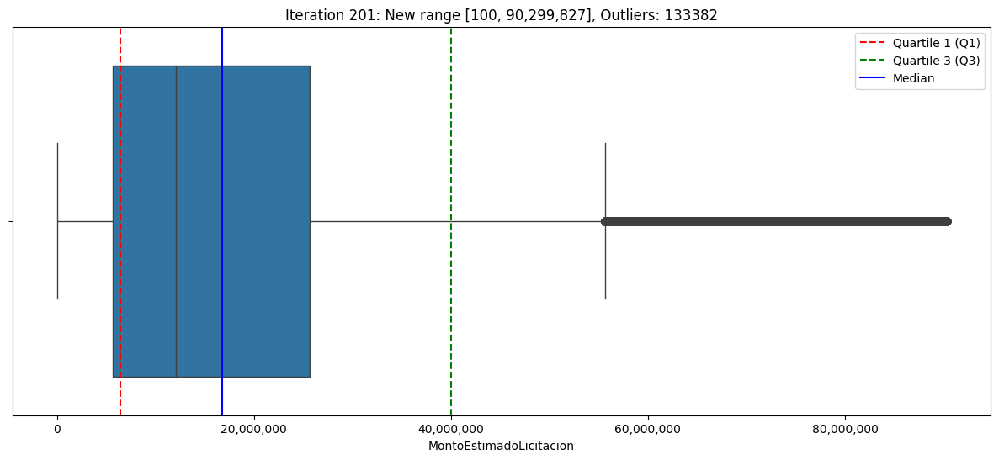

Iteration 201: New range [100, 90,299,827]


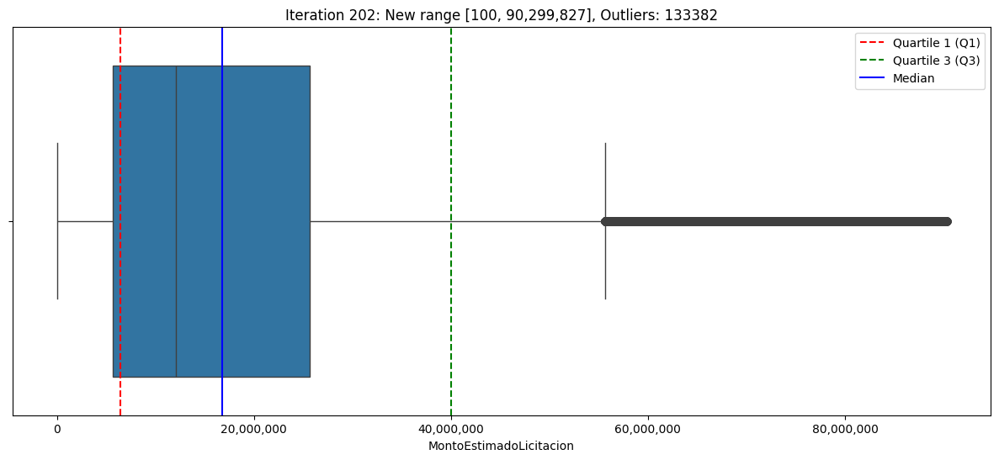

Iteration 202: New range [100, 90,299,827]


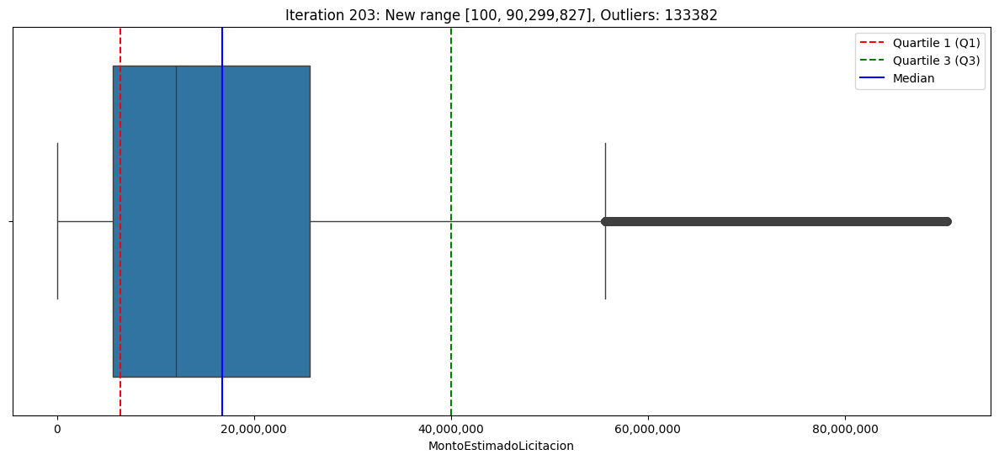

Iteration 203: New range [100, 90,299,827]


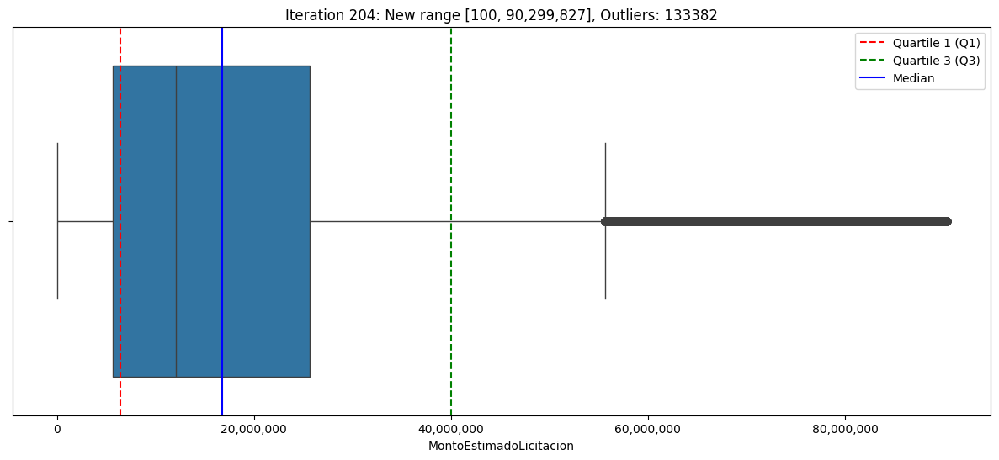

Iteration 204: New range [100, 90,299,827]


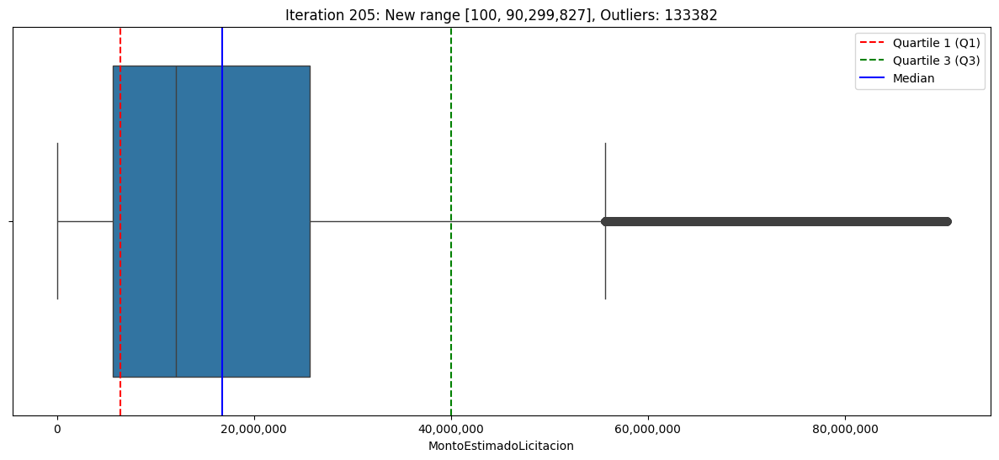

Iteration 205: New range [100, 90,299,827]


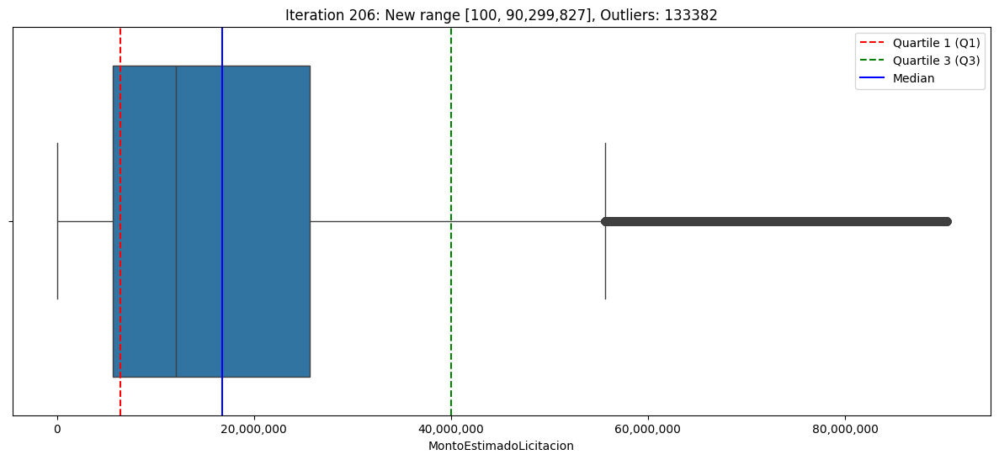

Iteration 206: New range [100, 90,299,827]


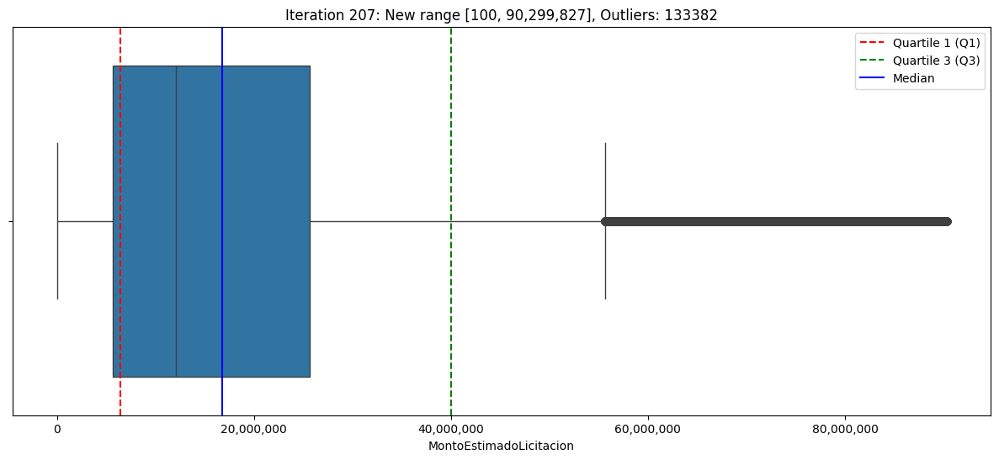

Iteration 207: New range [100, 90,299,827]


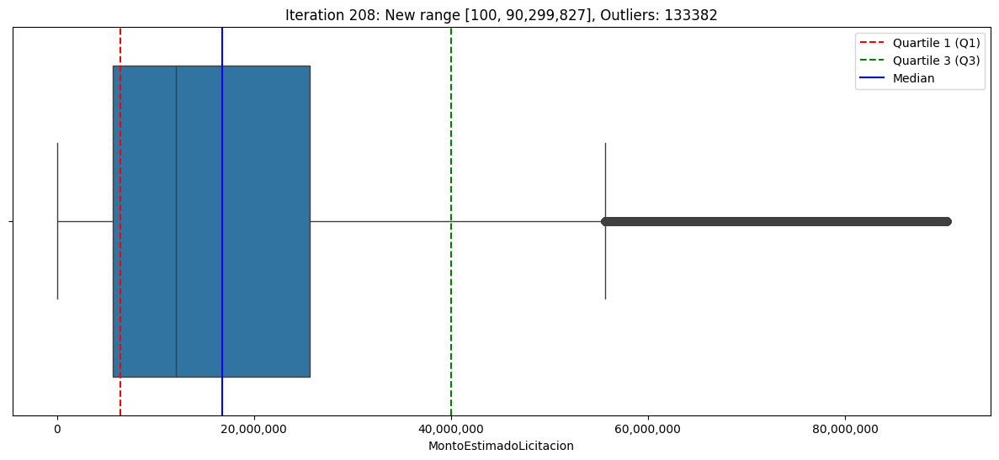

Iteration 208: New range [100, 90,299,827]


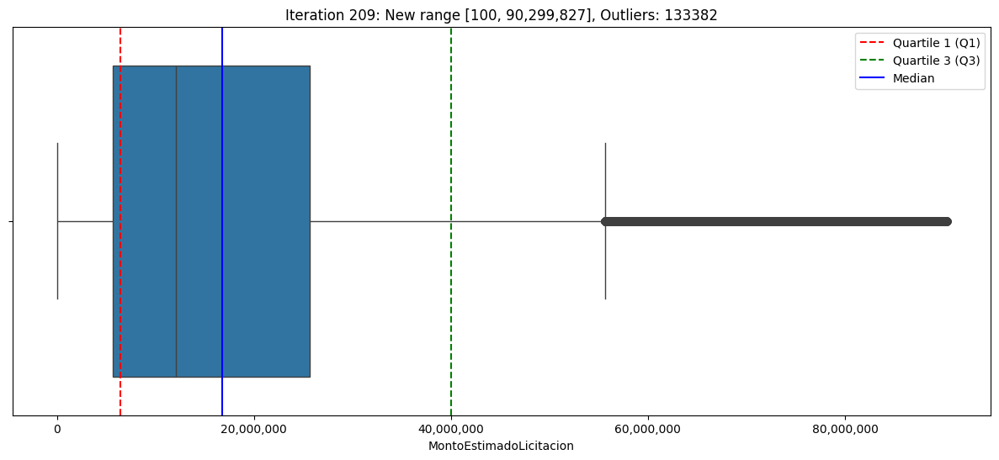

Iteration 209: New range [100, 90,299,827]


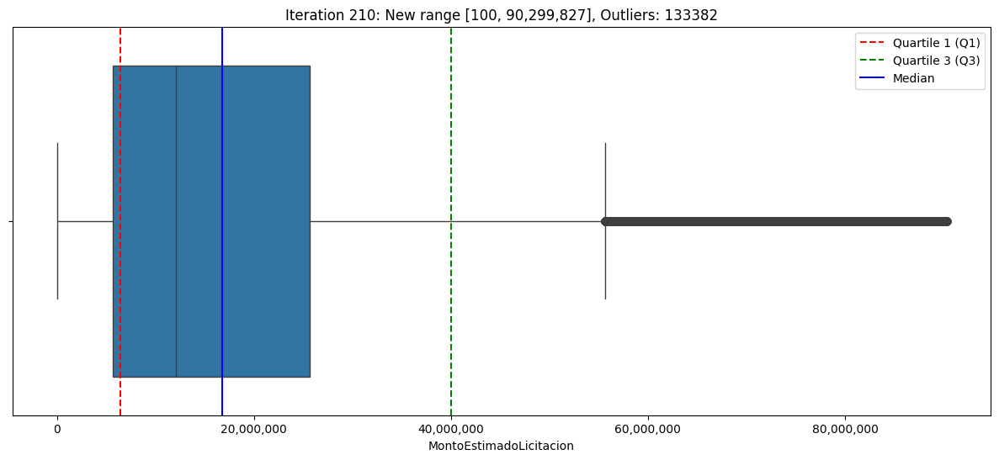

Iteration 210: New range [100, 90,299,827]


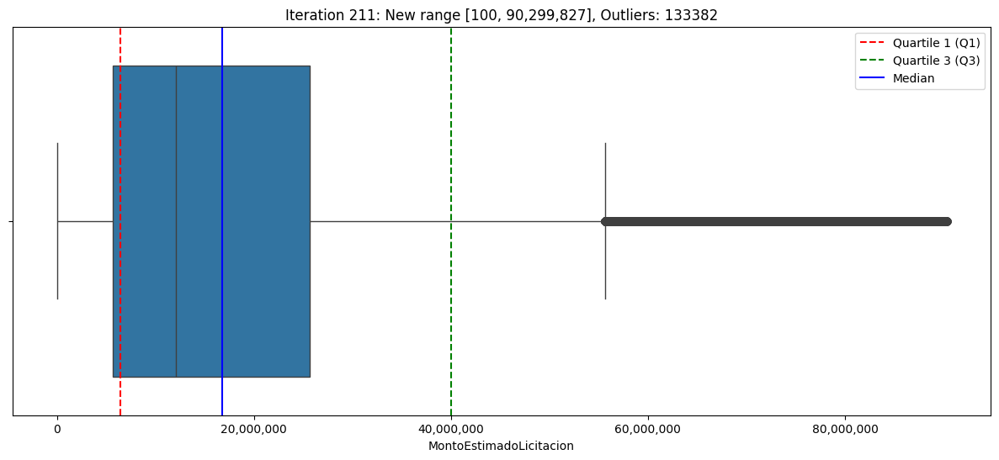

Iteration 211: New range [100, 90,299,827]


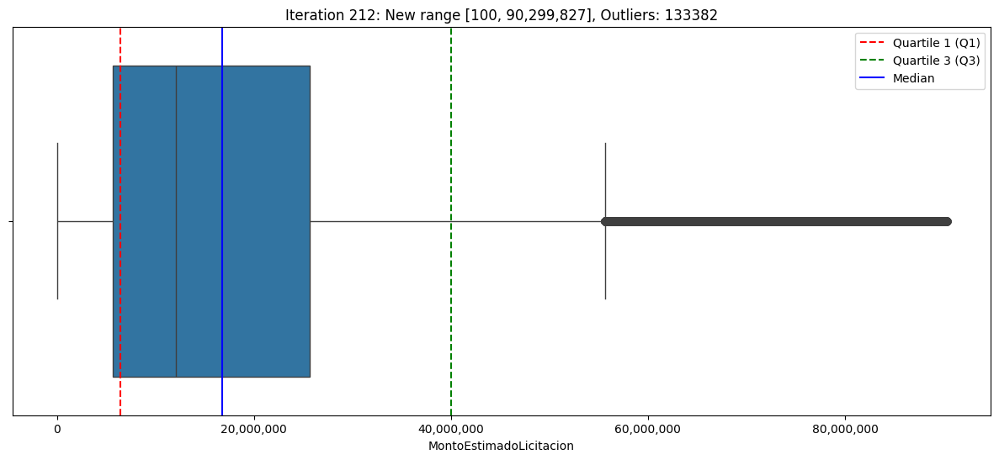

Iteration 212: New range [100, 90,299,827]


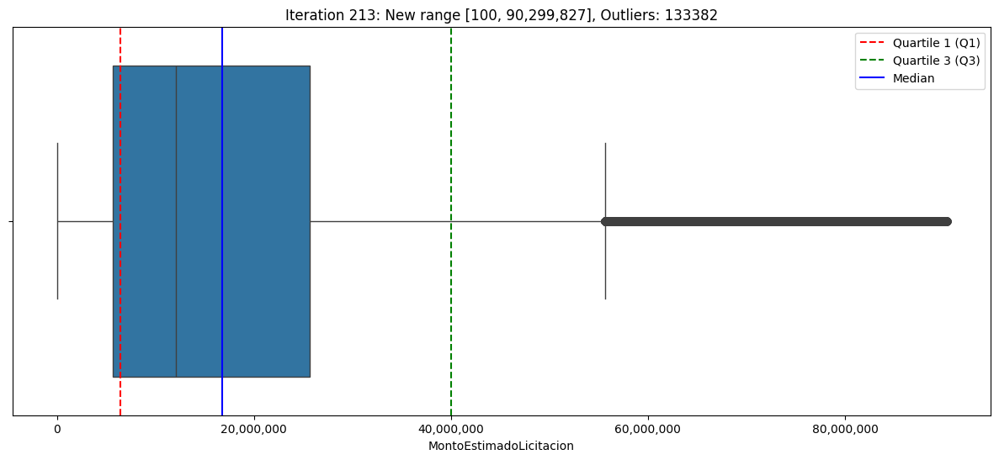

Iteration 213: New range [100, 90,299,827]


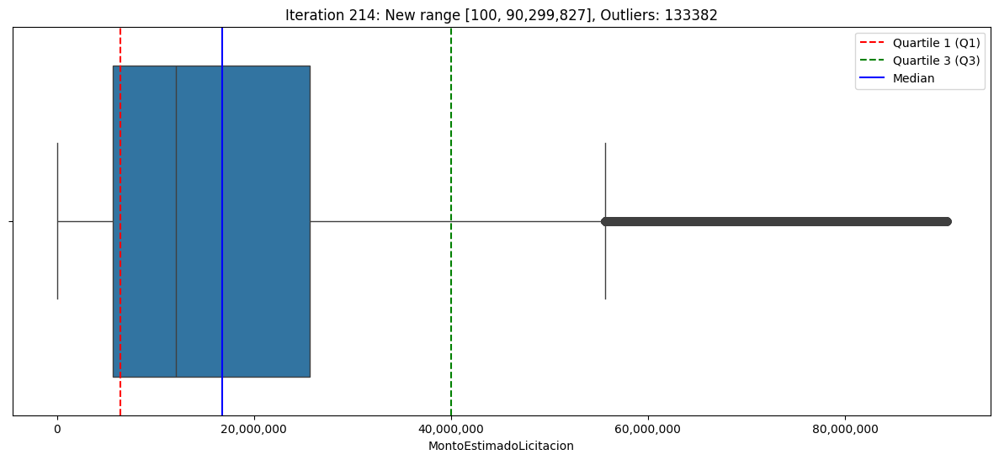

Iteration 214: New range [100, 90,299,827]


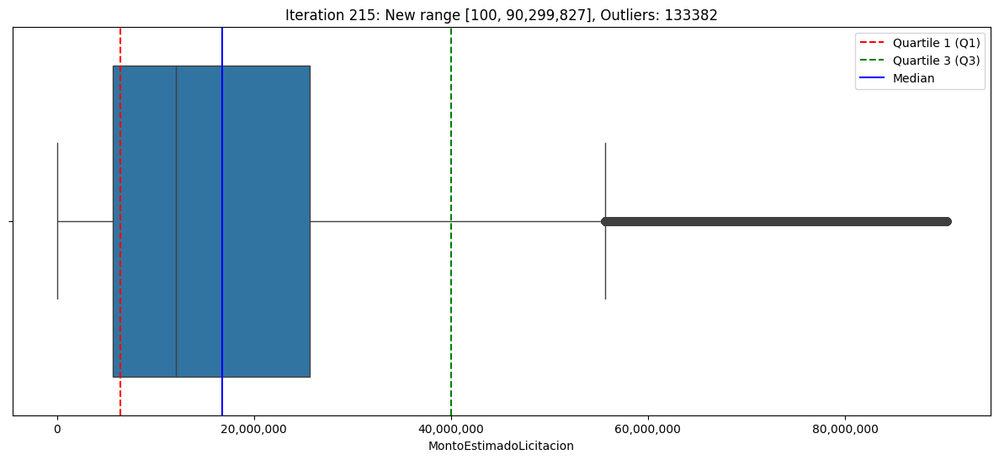

Iteration 215: New range [100, 90,299,827]


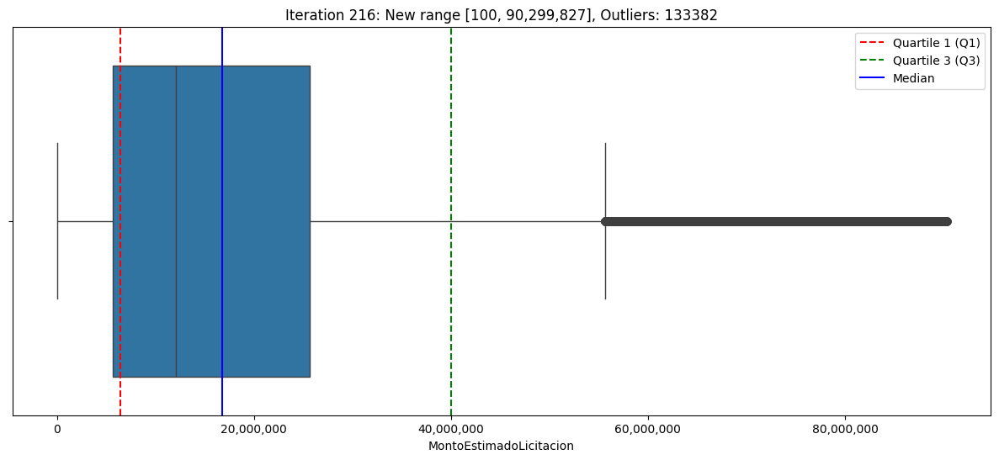

Iteration 216: New range [100, 90,299,827]


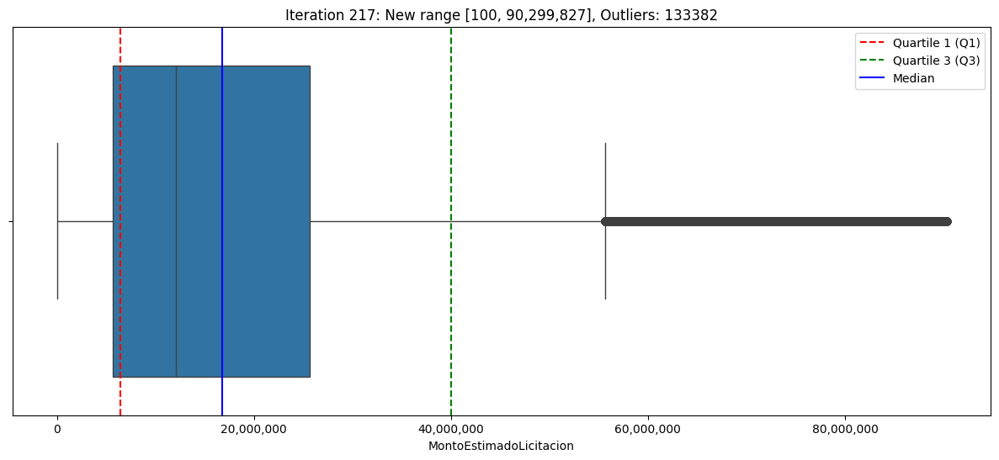

Iteration 217: New range [100, 90,299,827]


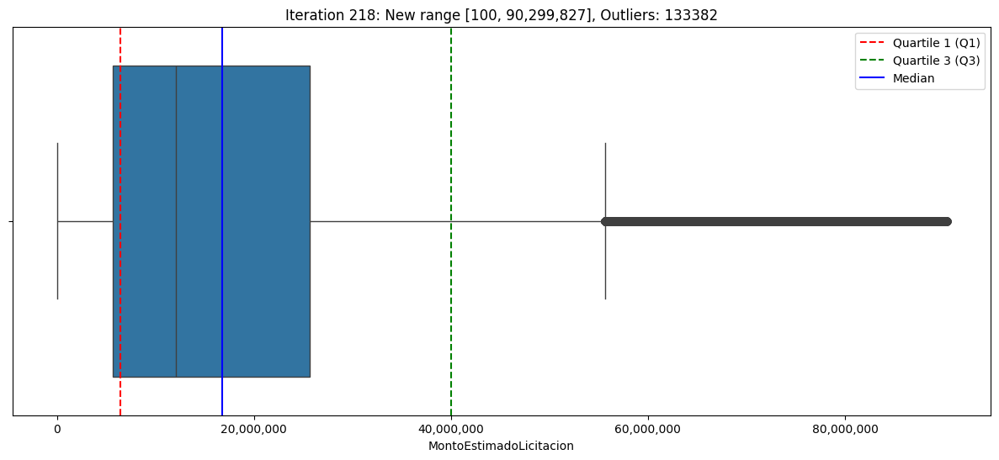

Iteration 218: New range [100, 90,299,827]


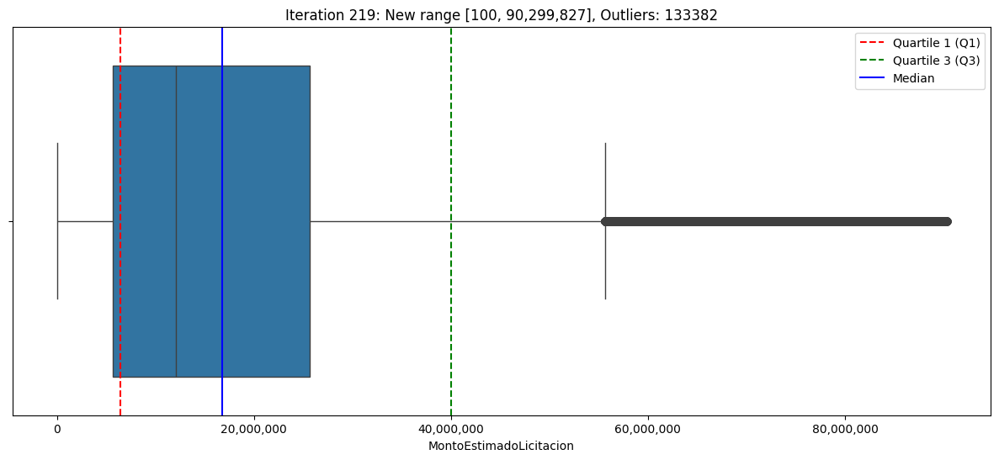

Iteration 219: New range [100, 90,299,827]


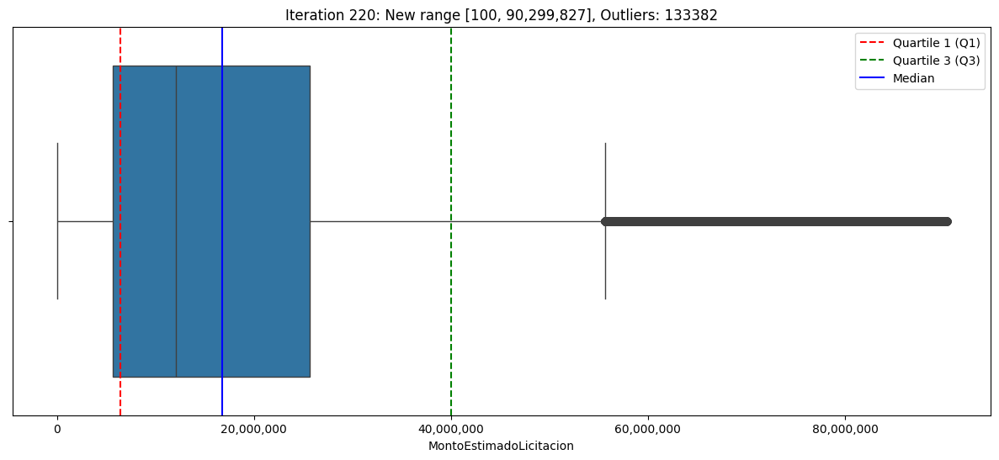

Iteration 220: New range [100, 90,299,827]


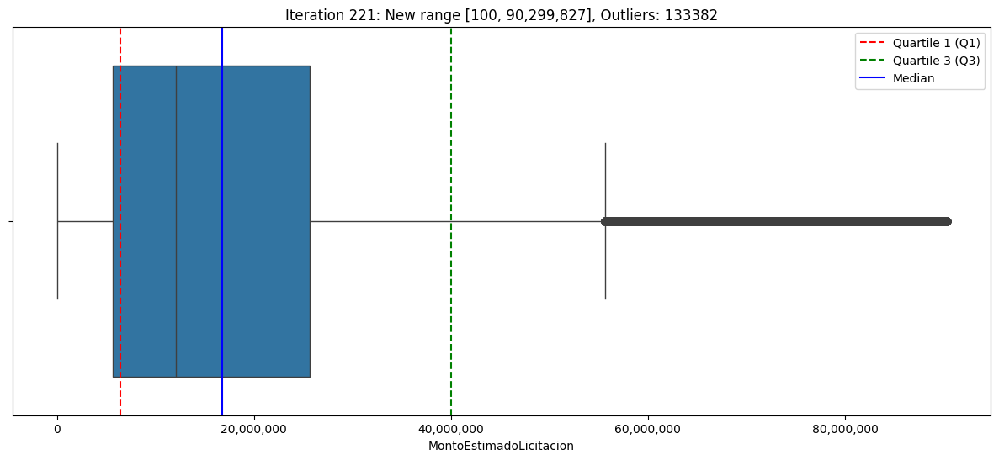

Iteration 221: New range [100, 90,299,827]


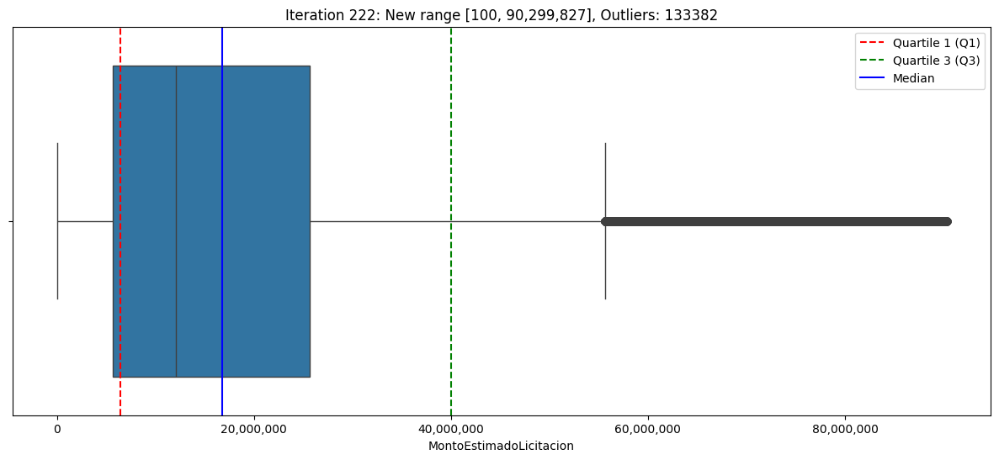

Iteration 222: New range [100, 90,299,827]


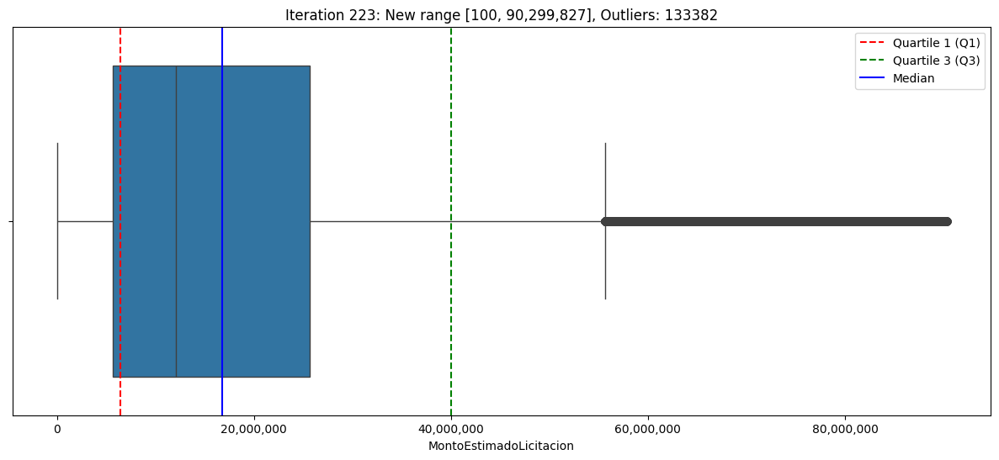

Iteration 223: New range [100, 90,299,827]


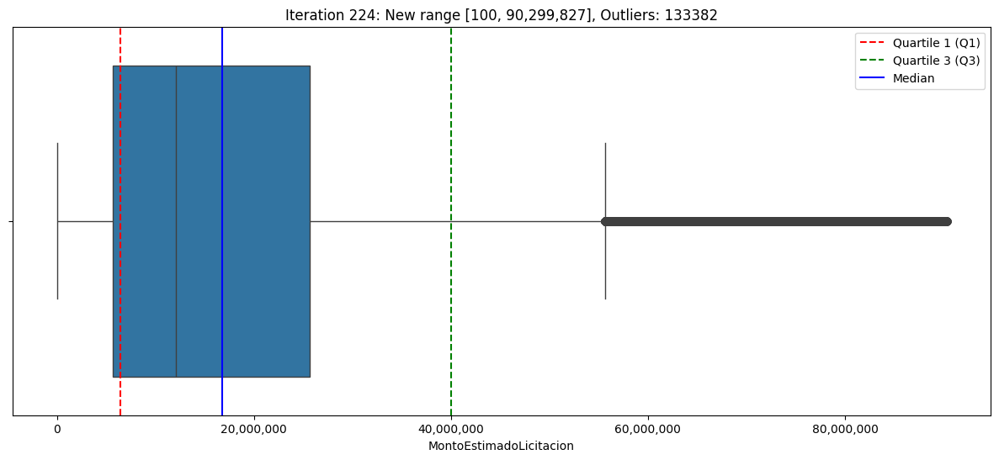

Iteration 224: New range [100, 90,299,827]


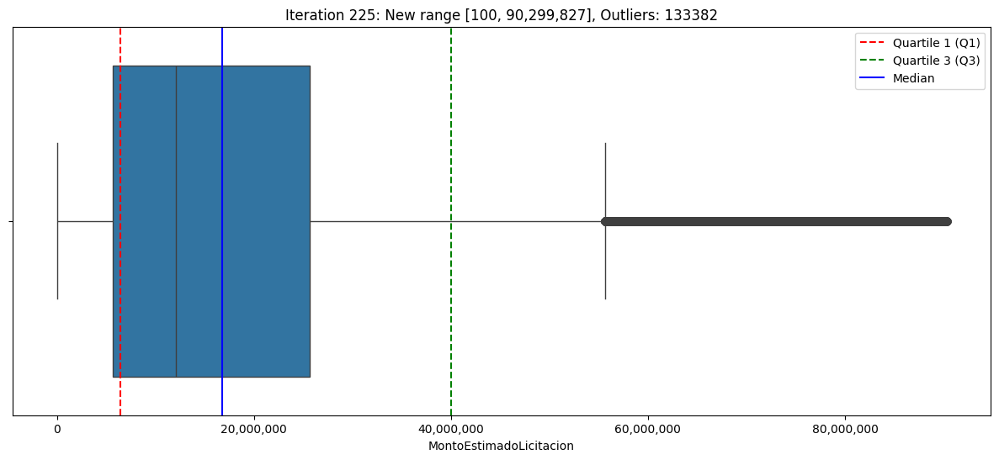

Iteration 225: New range [100, 90,299,827]


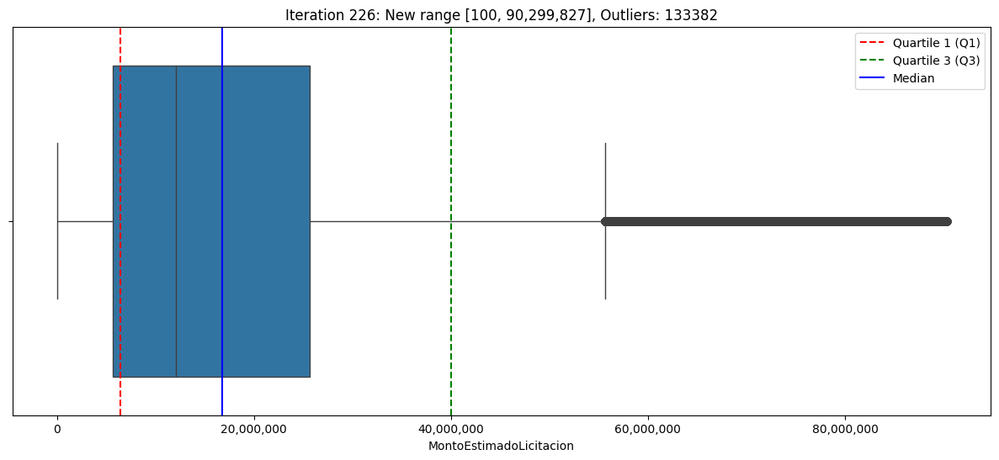

Iteration 226: New range [100, 90,299,827]


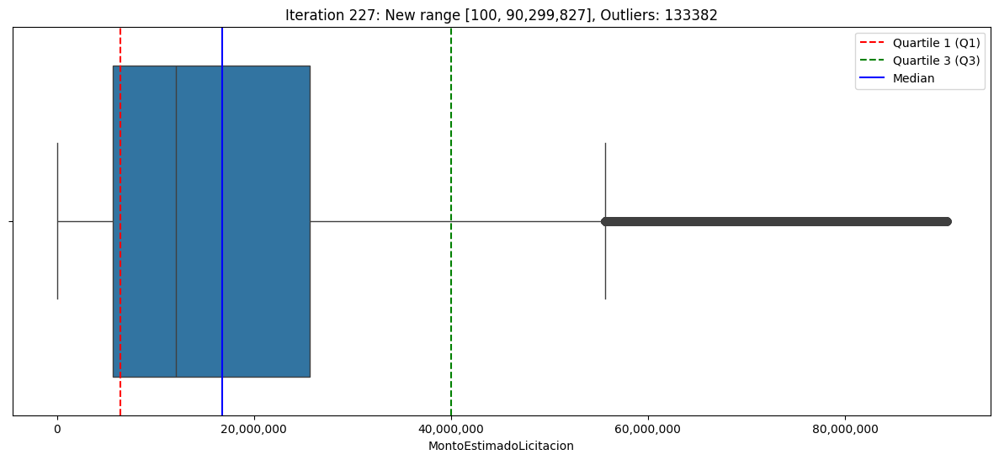

Iteration 227: New range [100, 90,299,827]


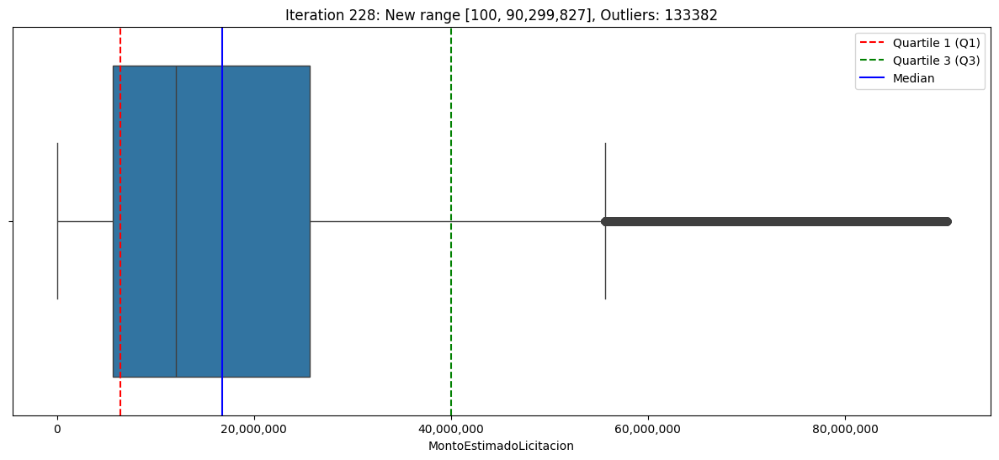

Iteration 228: New range [100, 90,299,827]


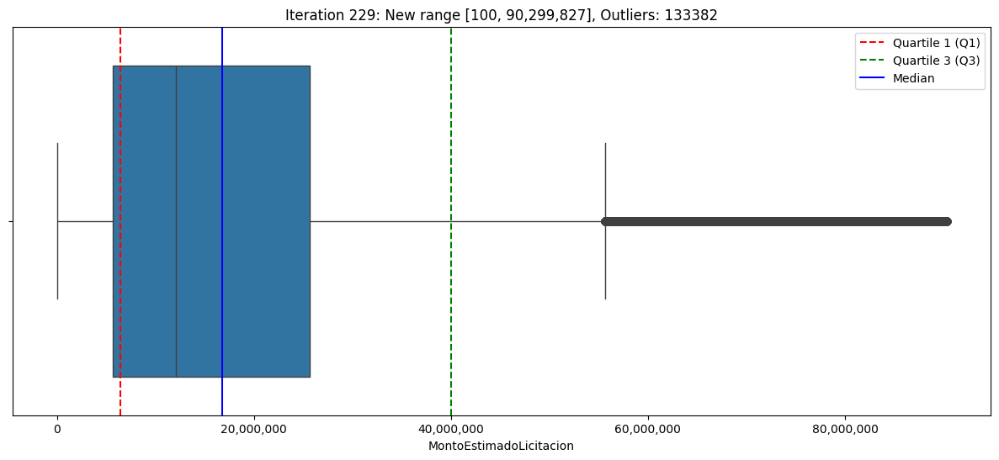

Iteration 229: New range [100, 90,299,827]


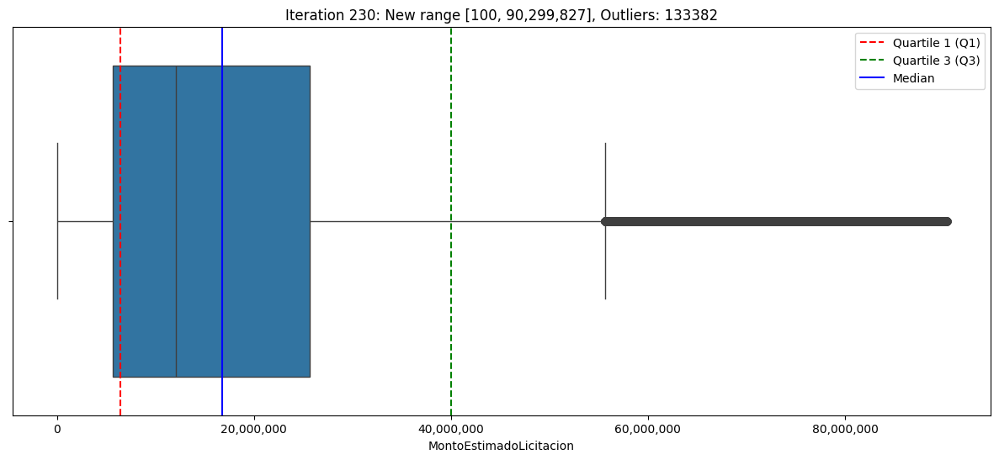

Iteration 230: New range [100, 90,299,827]


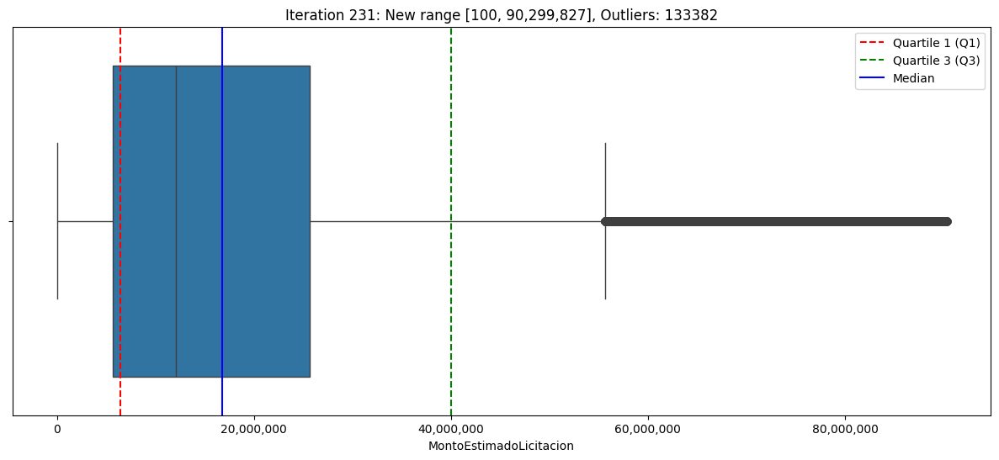

Iteration 231: New range [100, 90,299,827]


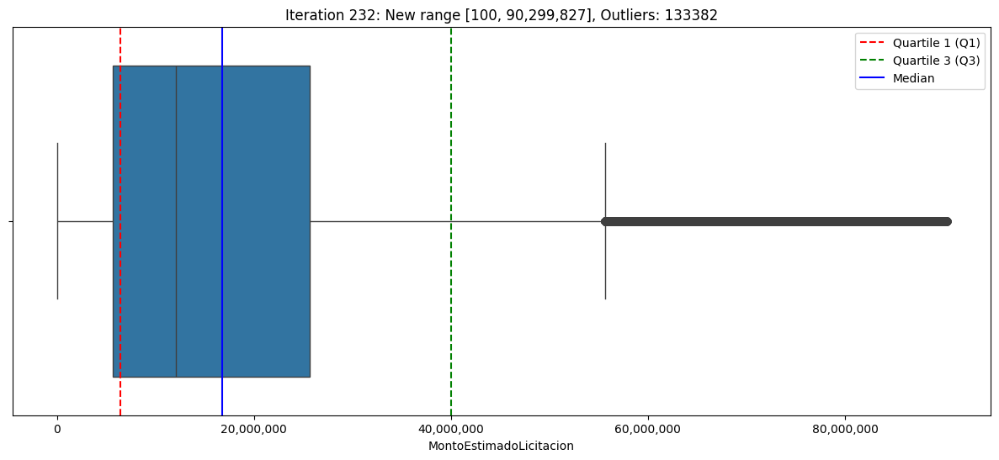

Iteration 232: New range [100, 90,299,827]


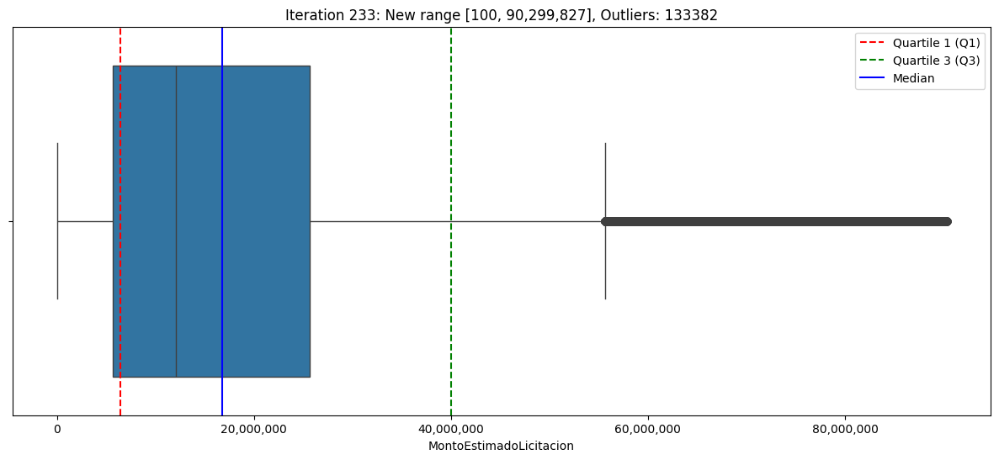

Iteration 233: New range [100, 90,299,827]


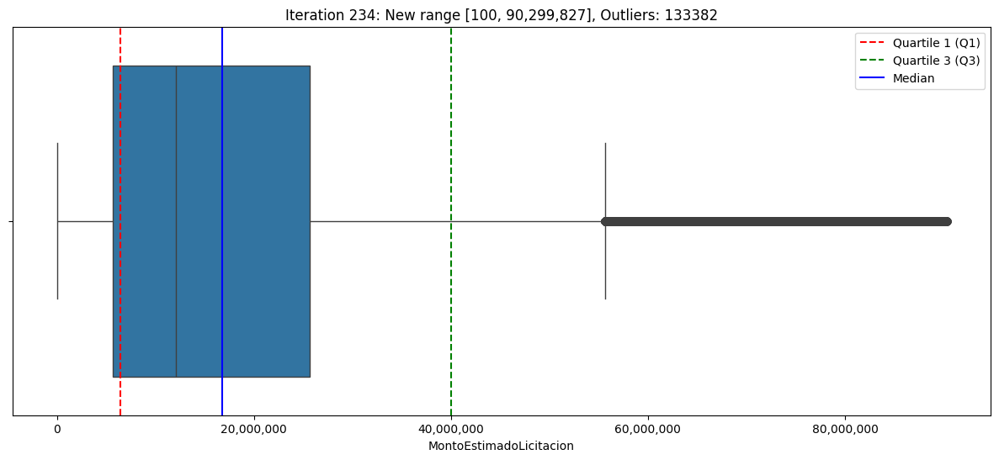

Iteration 234: New range [100, 90,299,827]


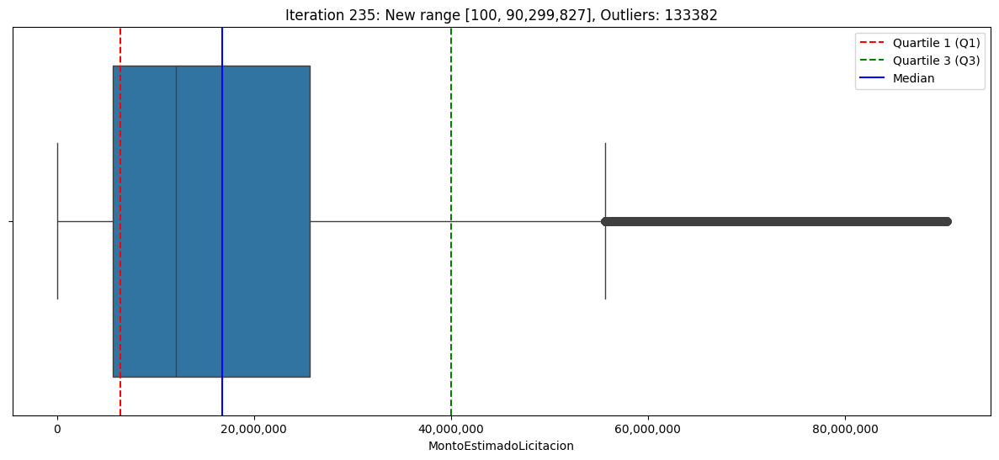

Iteration 235: New range [100, 90,299,827]


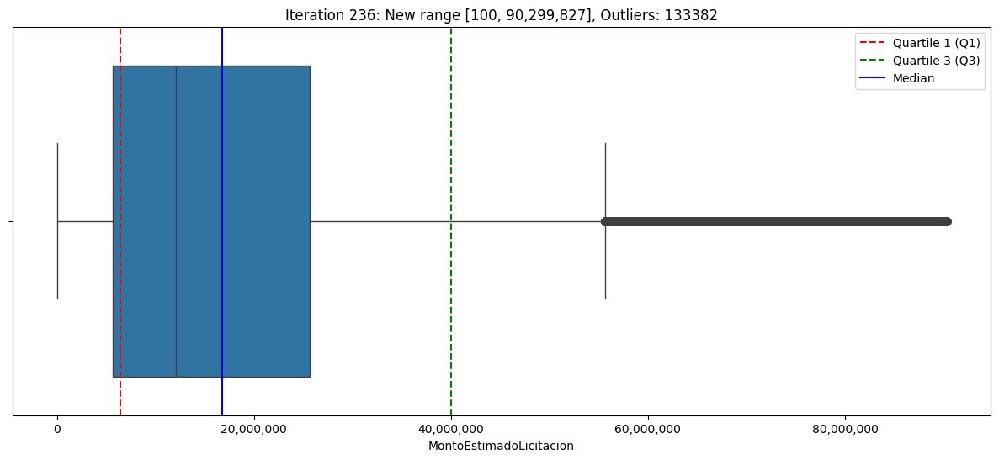

Iteration 236: New range [100, 90,299,827]


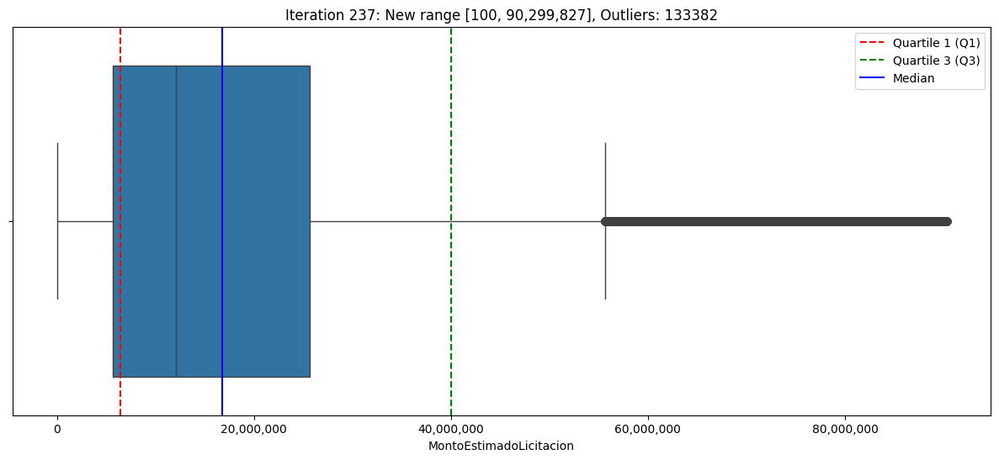

Iteration 237: New range [100, 90,299,827]


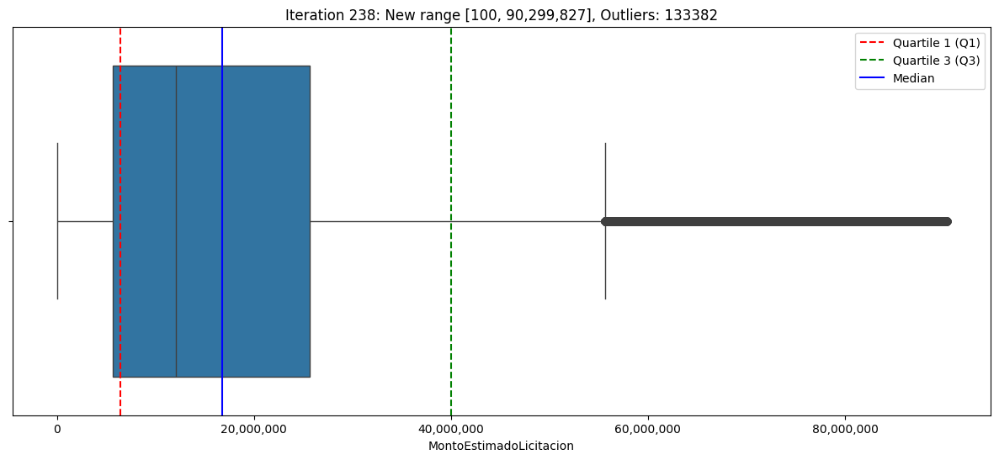

Iteration 238: New range [100, 90,299,827]


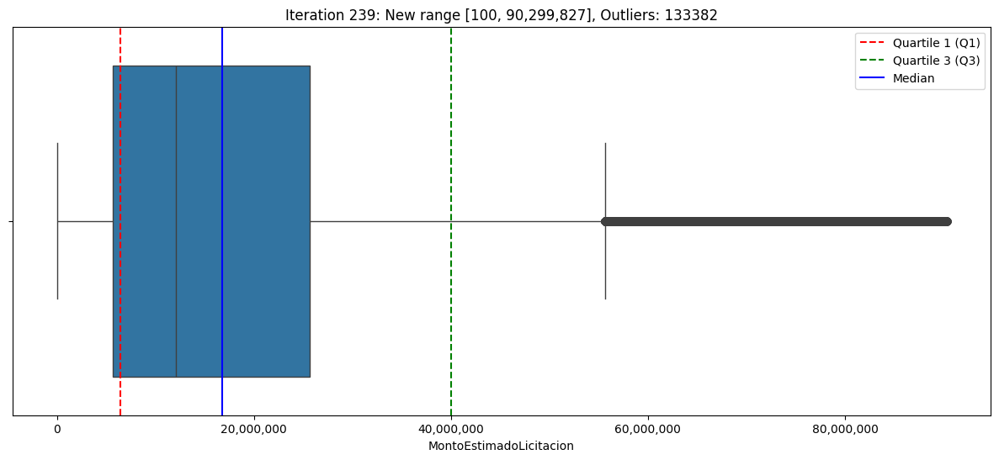

Iteration 239: New range [100, 90,299,827]


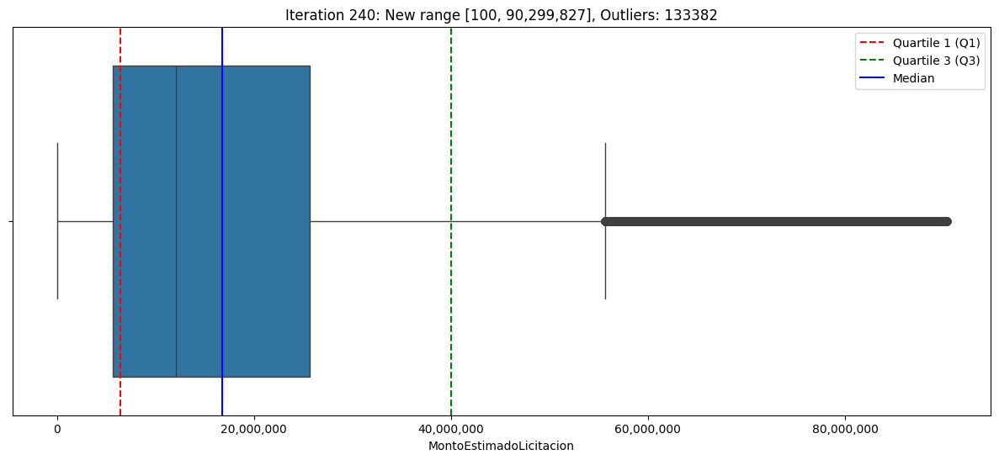

Iteration 240: New range [100, 90,299,827]


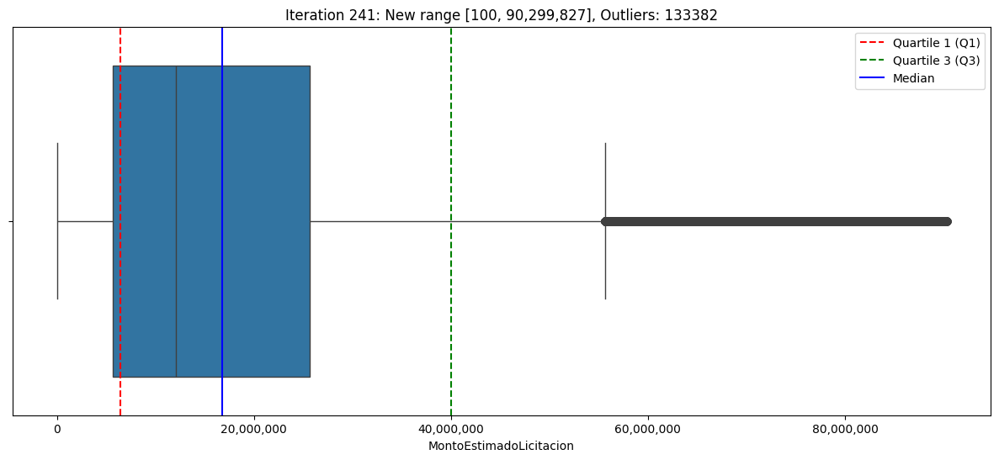

Iteration 241: New range [100, 90,299,827]


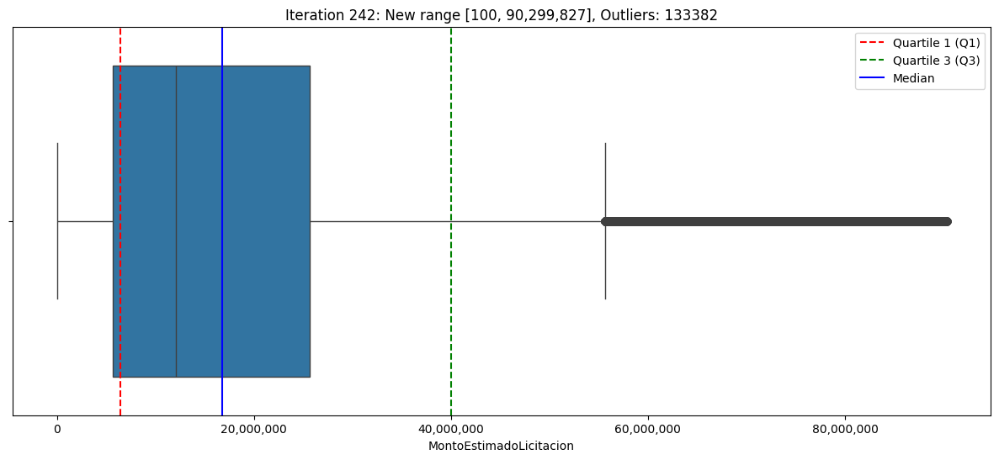

Iteration 242: New range [100, 90,299,827]


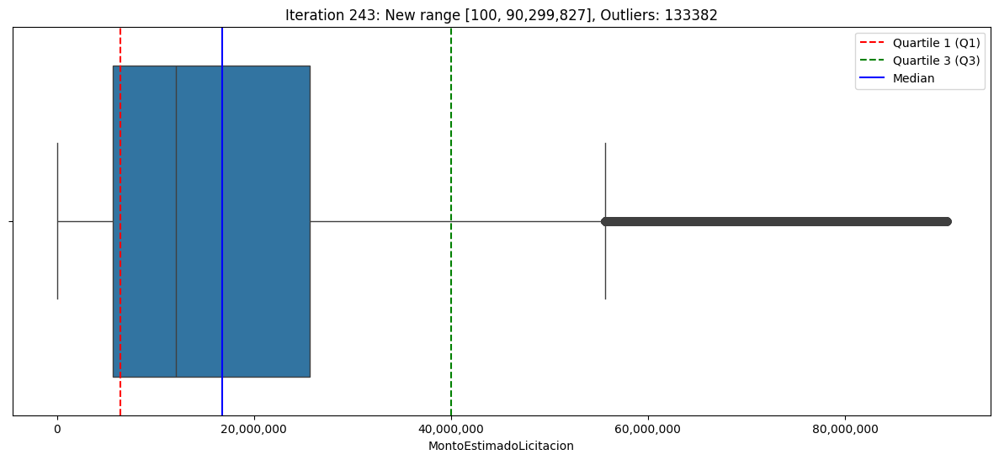

Iteration 243: New range [100, 90,299,827]


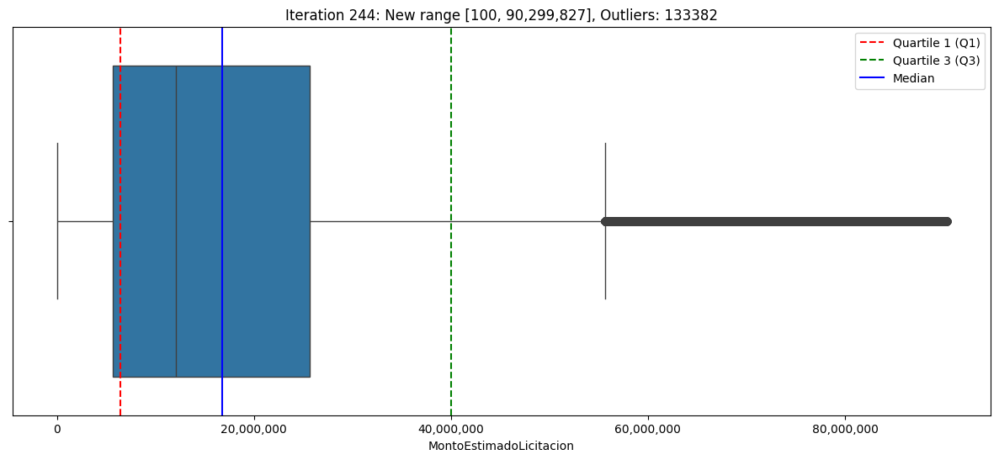

Iteration 244: New range [100, 90,299,827]


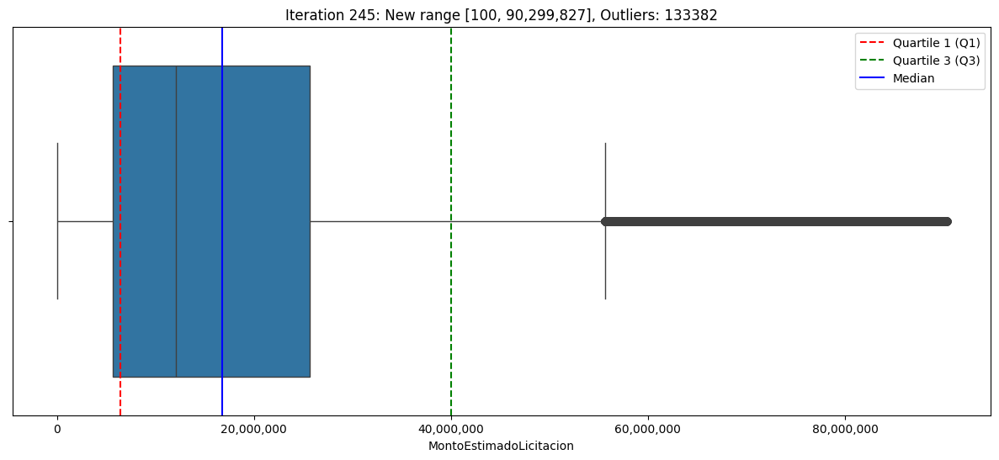

Iteration 245: New range [100, 90,299,827]


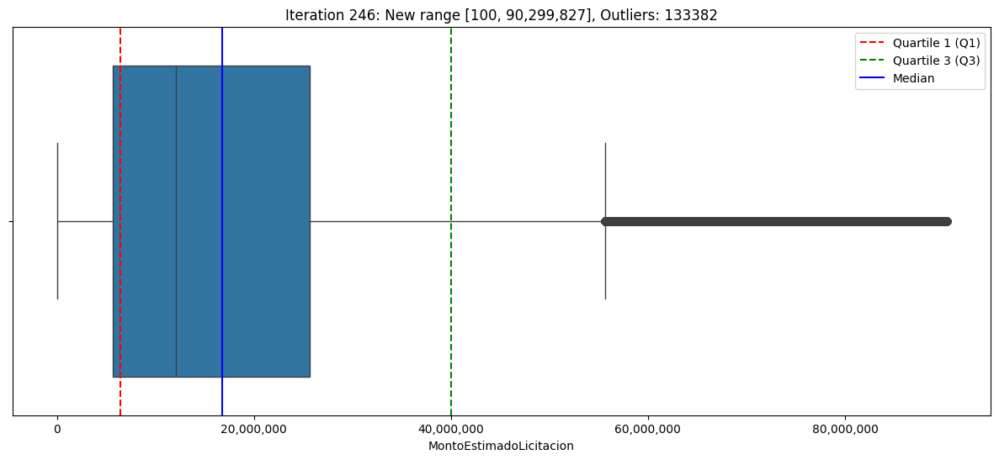

Iteration 246: New range [100, 90,299,827]


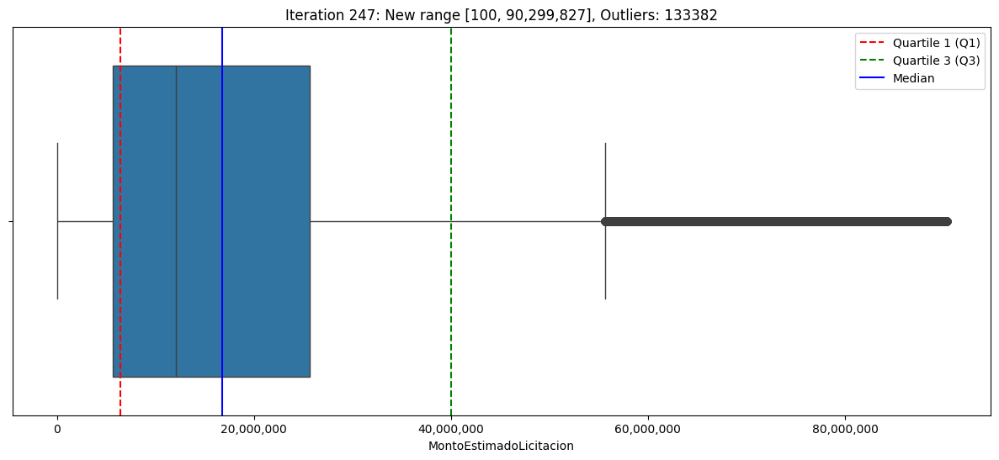

Iteration 247: New range [100, 90,299,827]


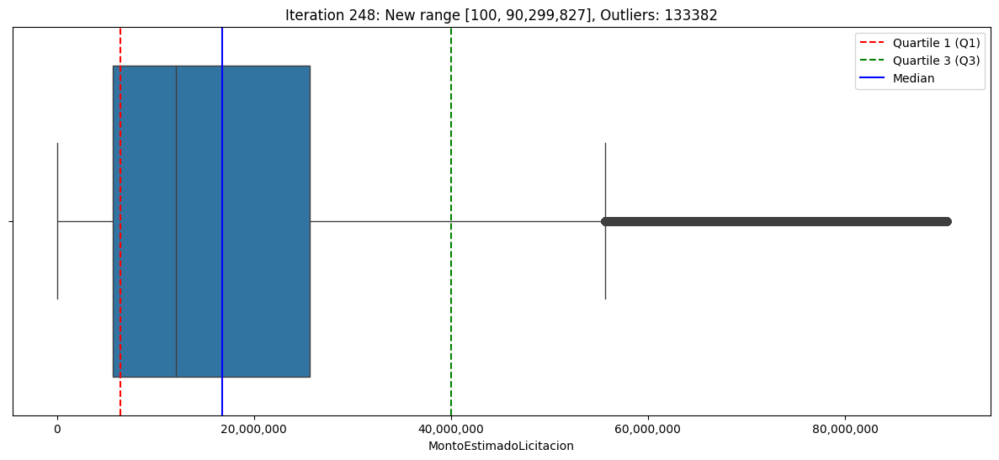

Iteration 248: New range [100, 90,299,827]


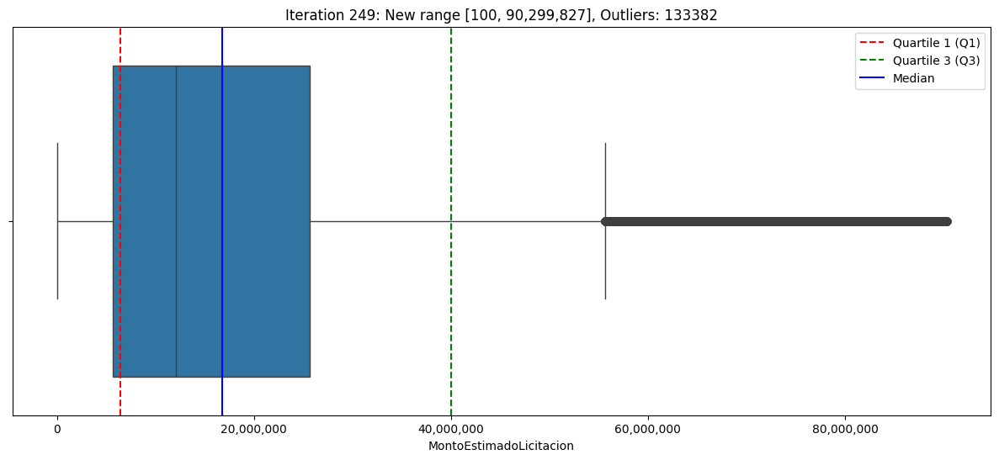

Iteration 249: New range [100, 90,299,827]


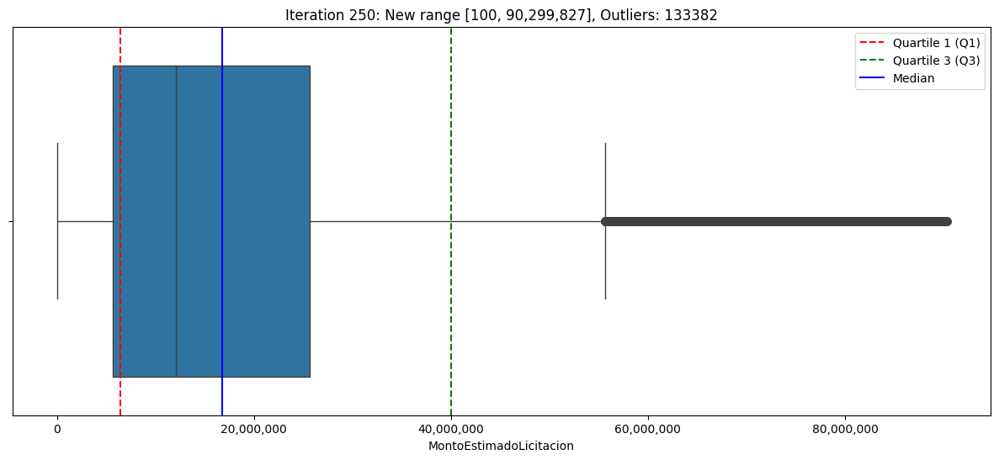

Iteration 250: New range [100, 90,299,827]


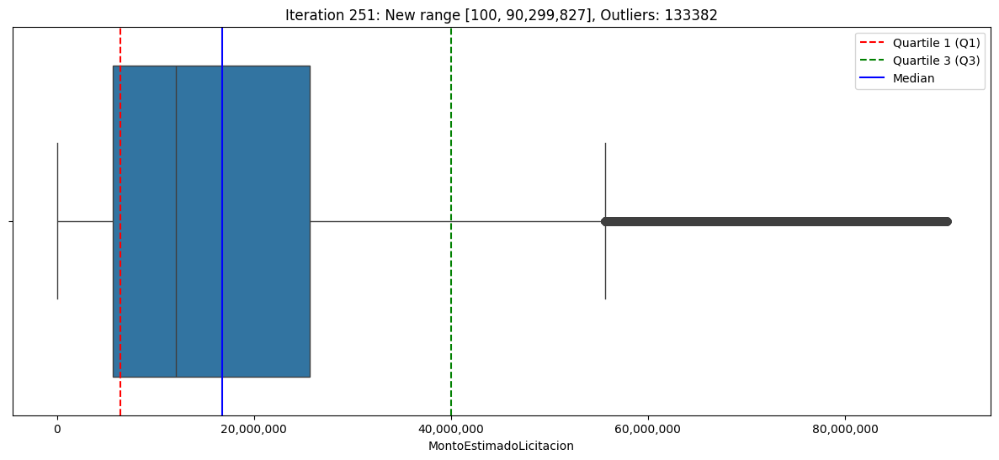

Iteration 251: New range [100, 90,299,827]


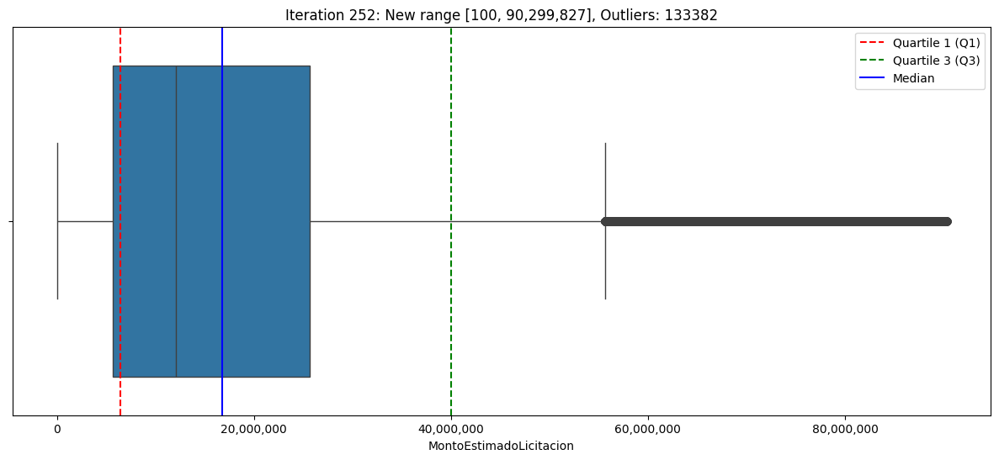

Iteration 252: New range [100, 90,299,827]


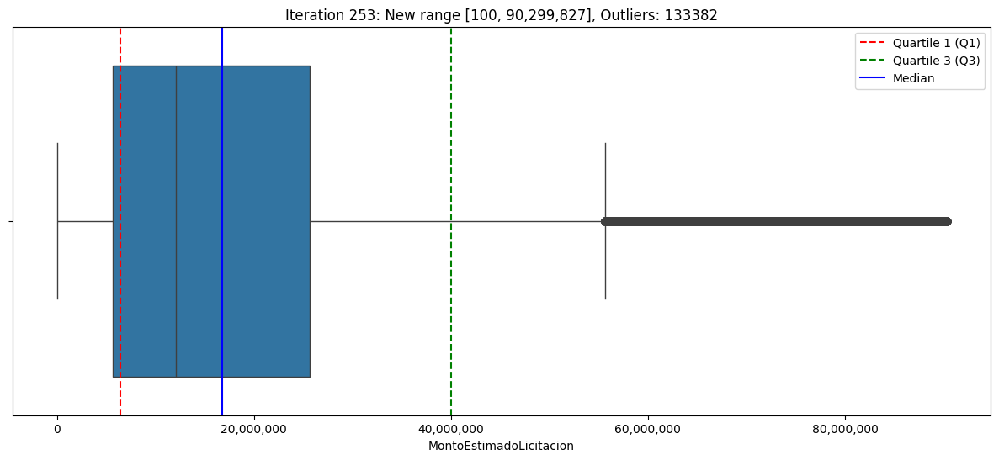

Iteration 253: New range [100, 90,299,827]


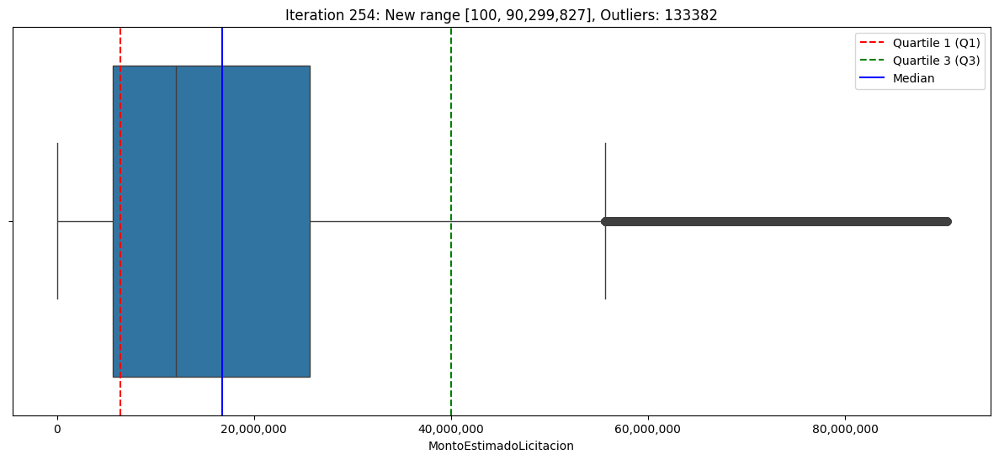

Iteration 254: New range [100, 90,299,827]


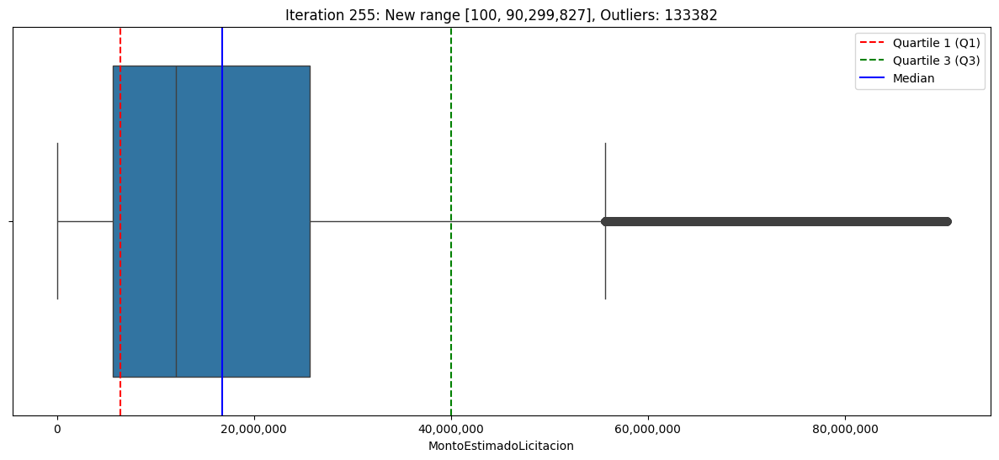

Iteration 255: New range [100, 90,299,827]


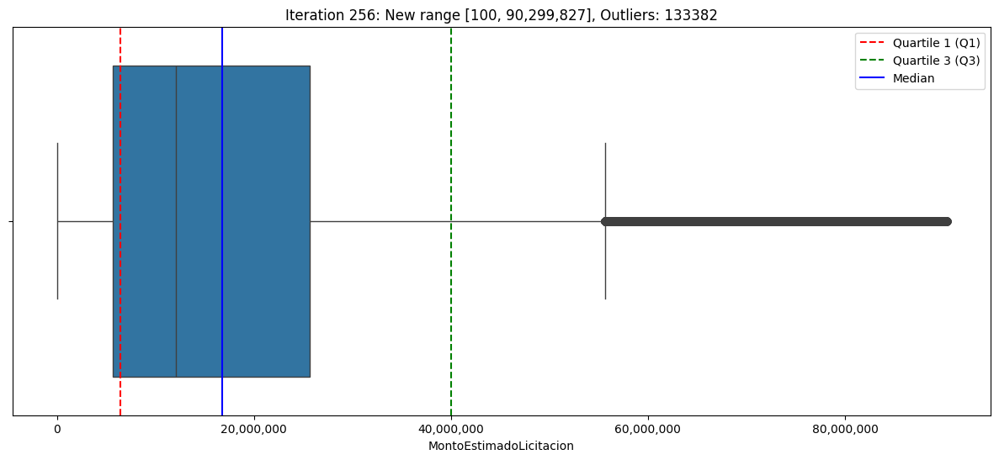

Iteration 256: New range [100, 90,299,827]


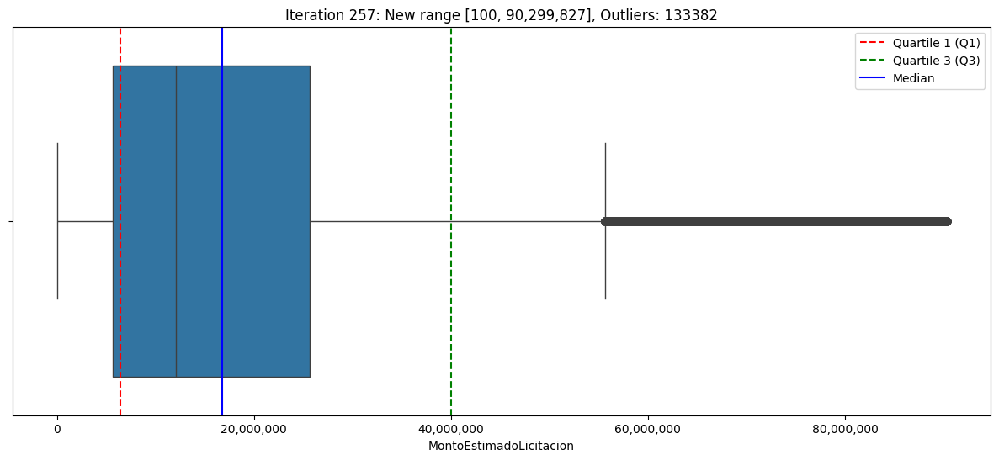

Iteration 257: New range [100, 90,299,827]


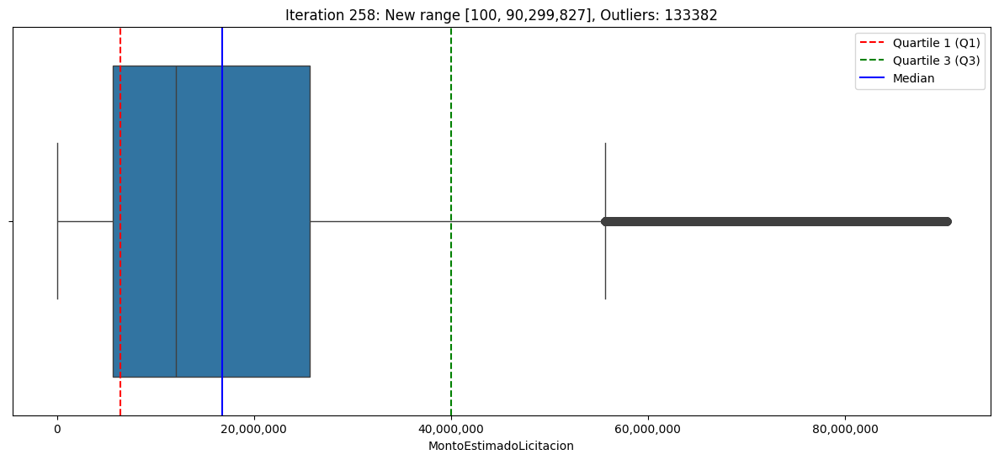

Iteration 258: New range [100, 90,299,827]


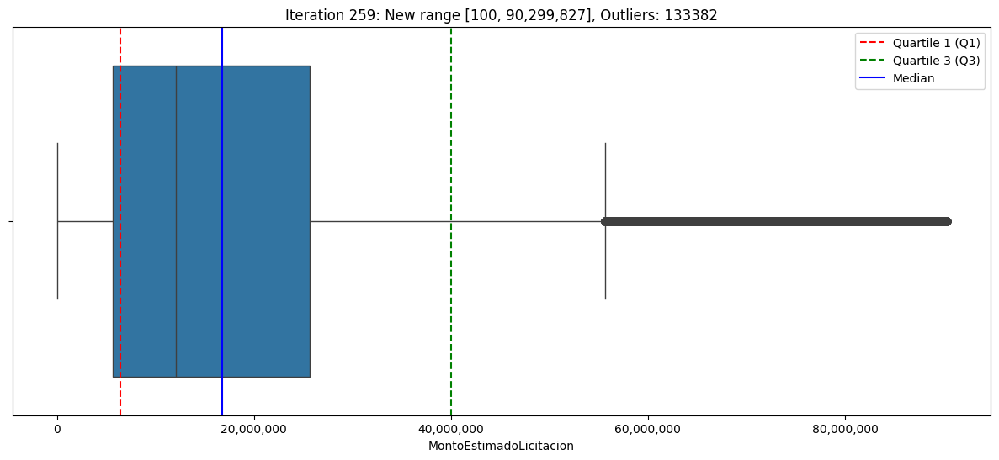

Iteration 259: New range [100, 90,299,827]


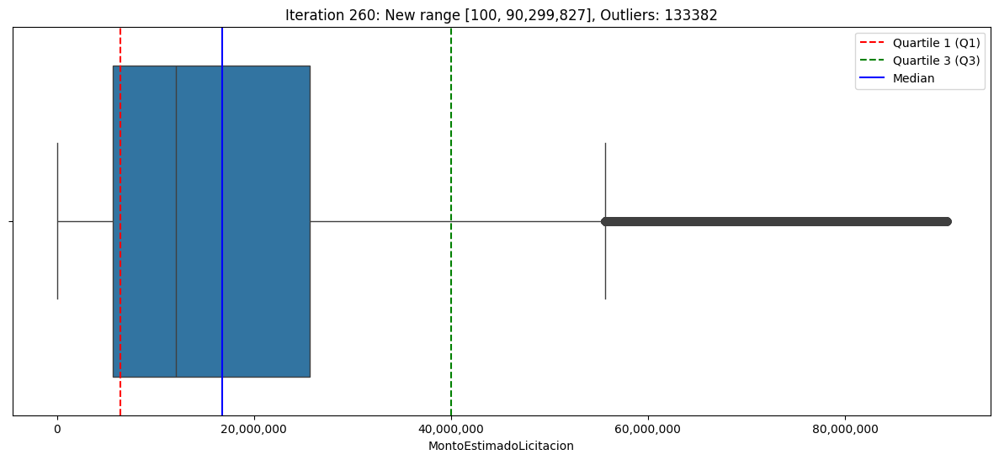

Iteration 260: New range [100, 90,299,827]


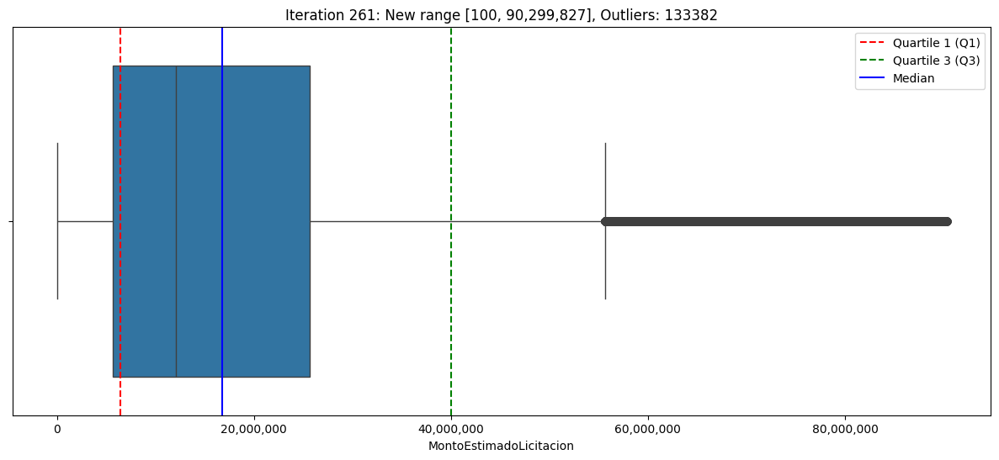

Iteration 261: New range [100, 90,299,827]


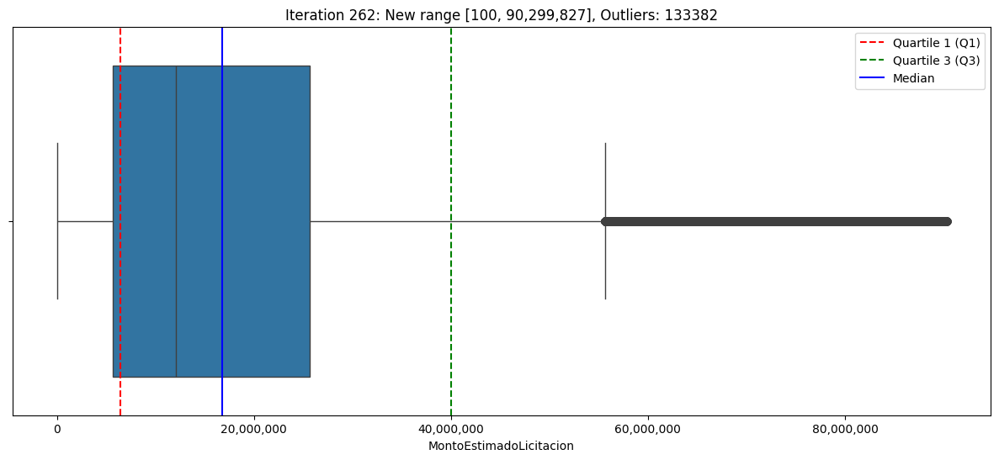

Iteration 262: New range [100, 90,299,827]


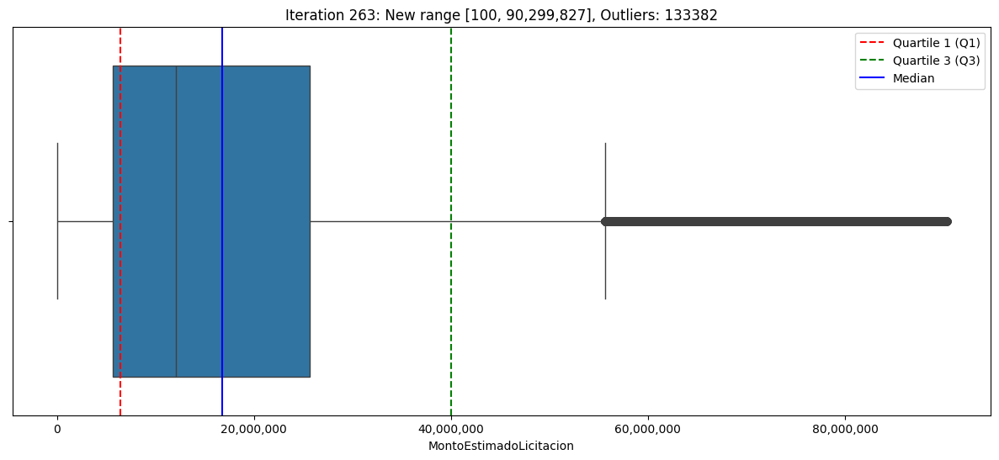

Iteration 263: New range [100, 90,299,827]


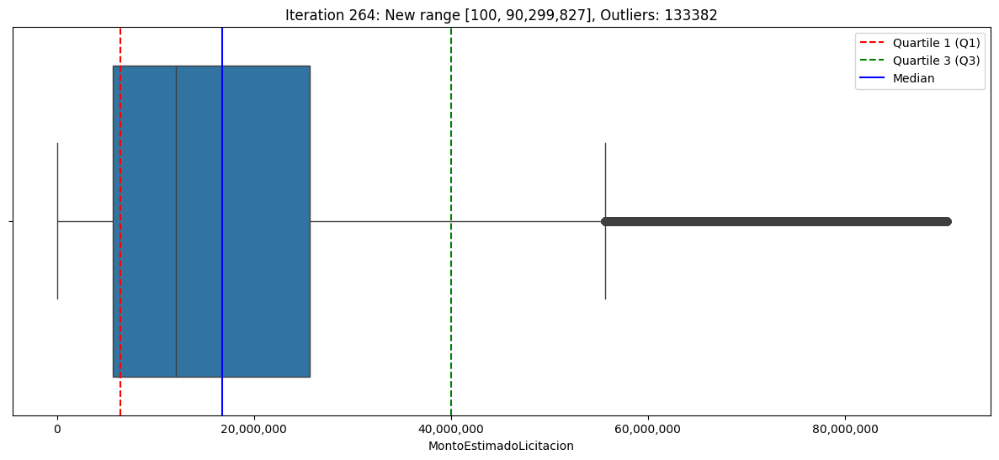

Iteration 264: New range [100, 90,299,827]


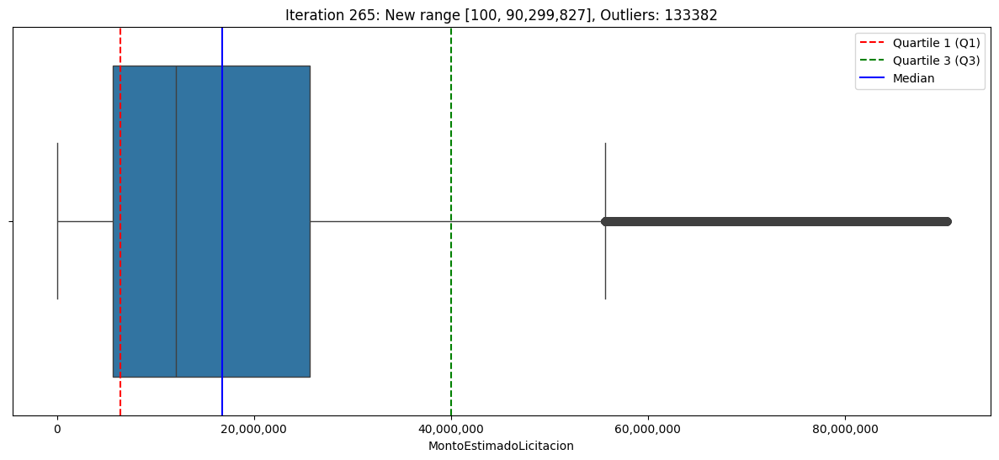

Iteration 265: New range [100, 90,299,827]


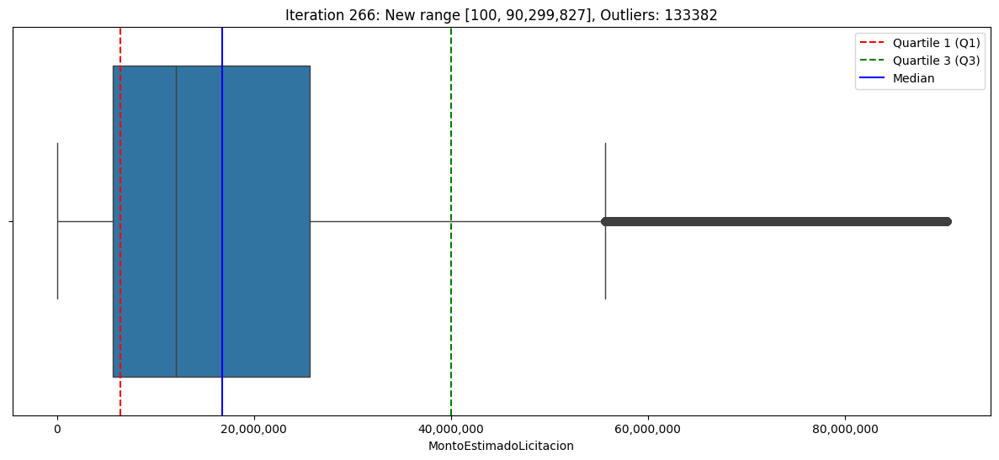

Iteration 266: New range [100, 90,299,827]


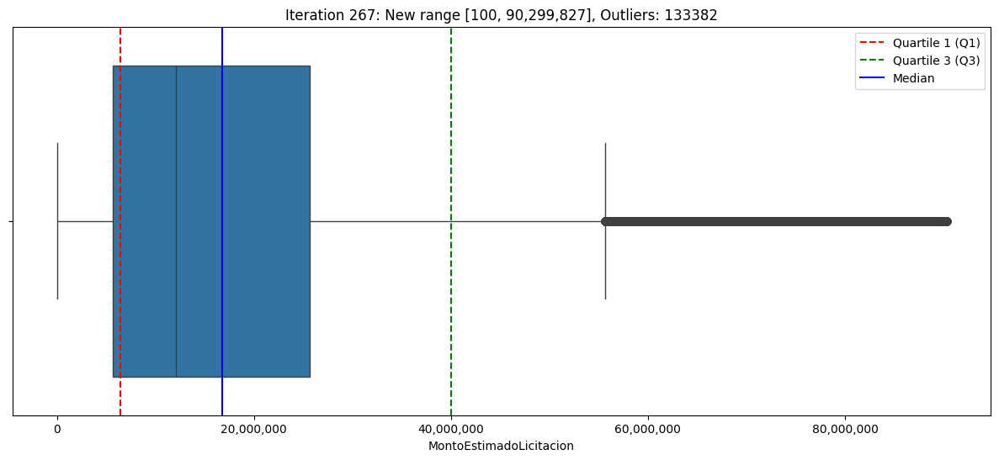

Iteration 267: New range [100, 90,299,827]


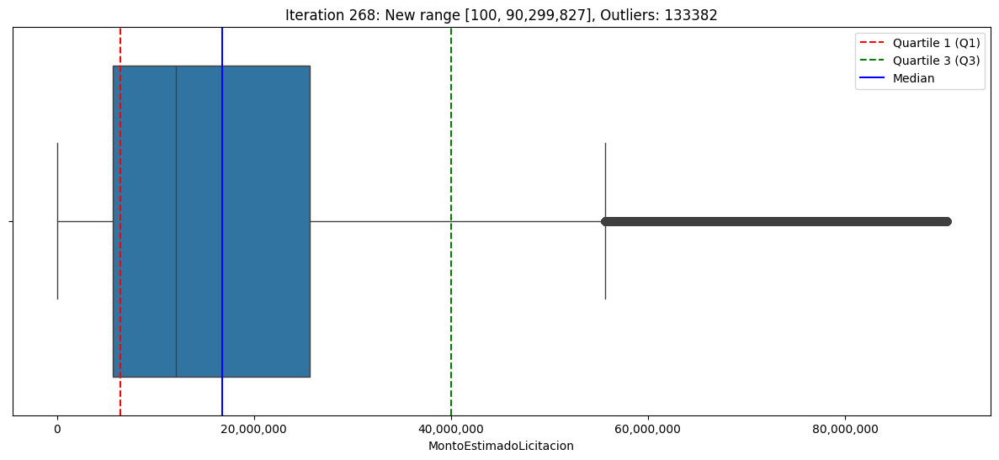

Iteration 268: New range [100, 90,299,827]


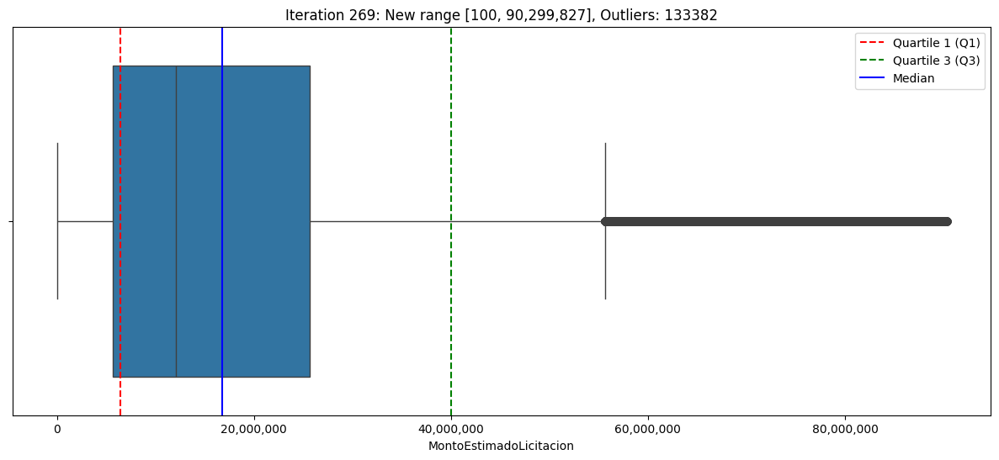

Iteration 269: New range [100, 90,299,827]


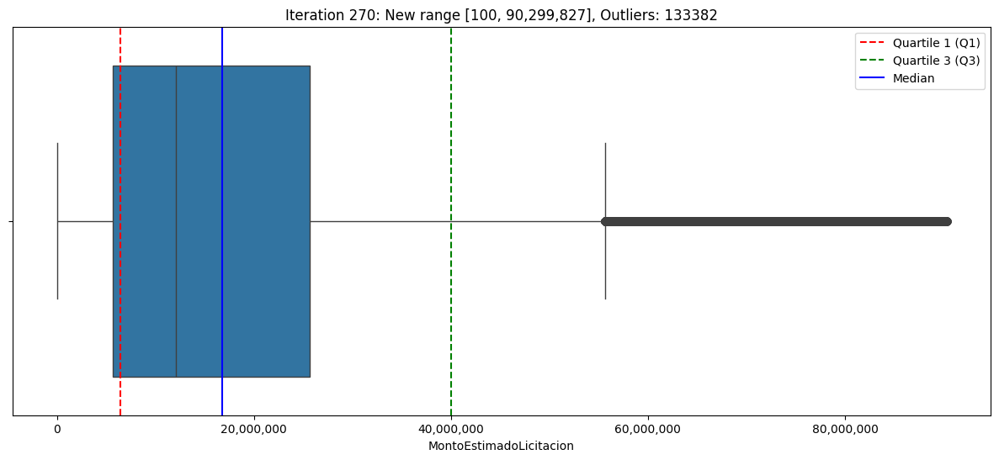

Iteration 270: New range [100, 90,299,827]


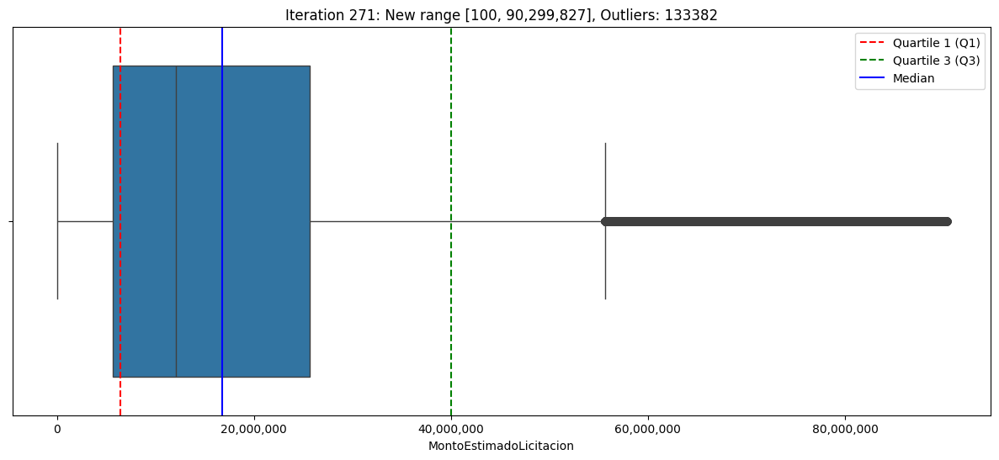

Iteration 271: New range [100, 90,299,827]


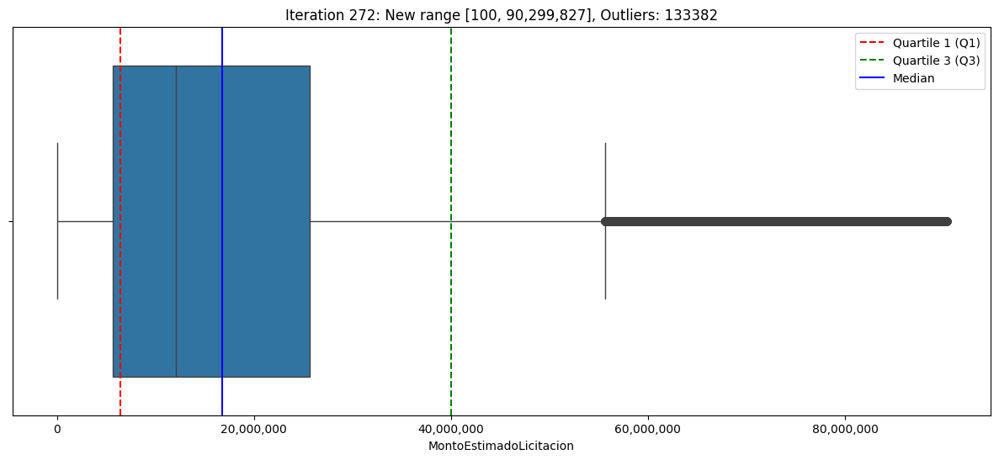

Iteration 272: New range [100, 90,299,827]


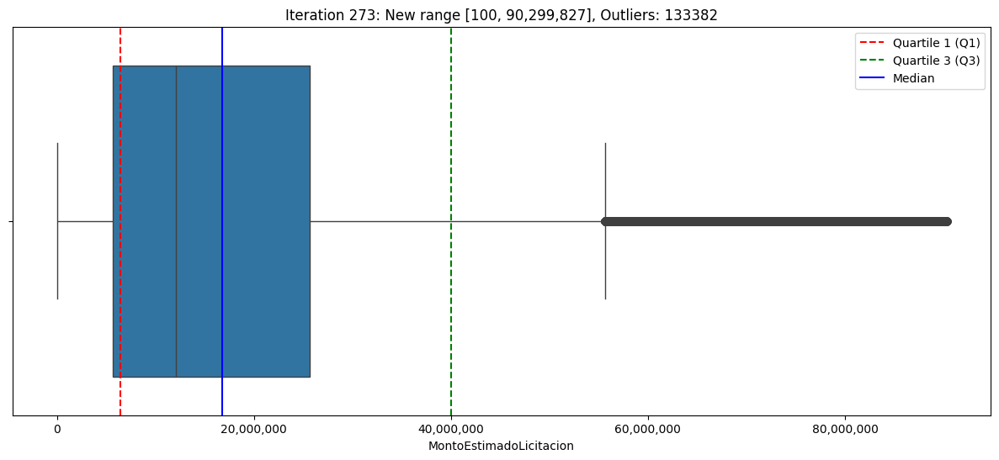

Iteration 273: New range [100, 90,299,827]


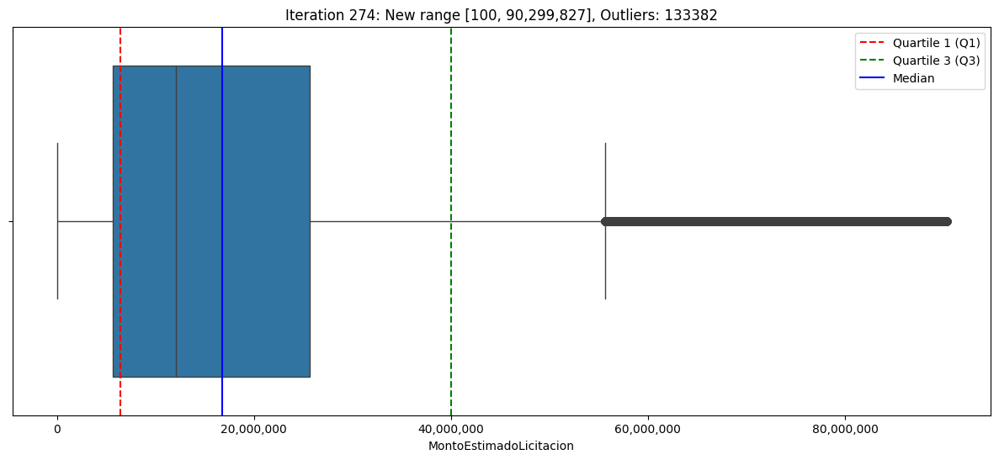

Iteration 274: New range [100, 90,299,827]


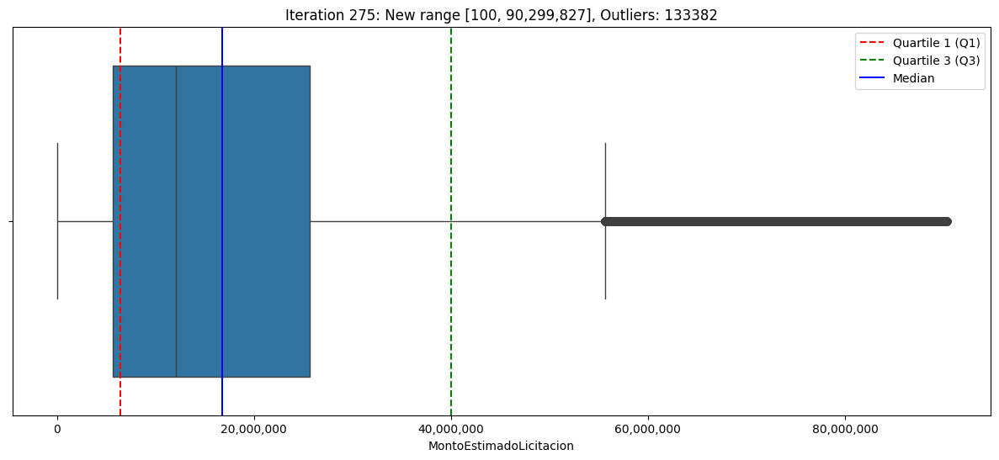

Iteration 275: New range [100, 90,299,827]


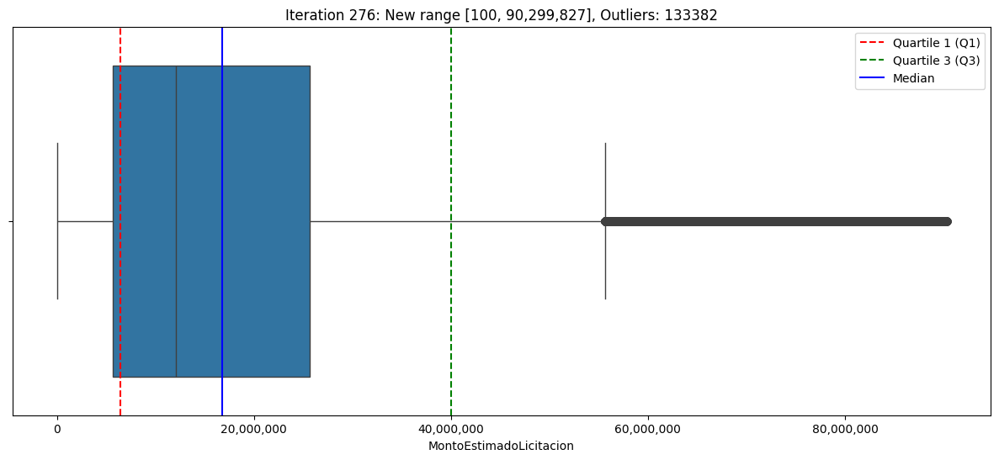

Iteration 276: New range [100, 90,299,827]


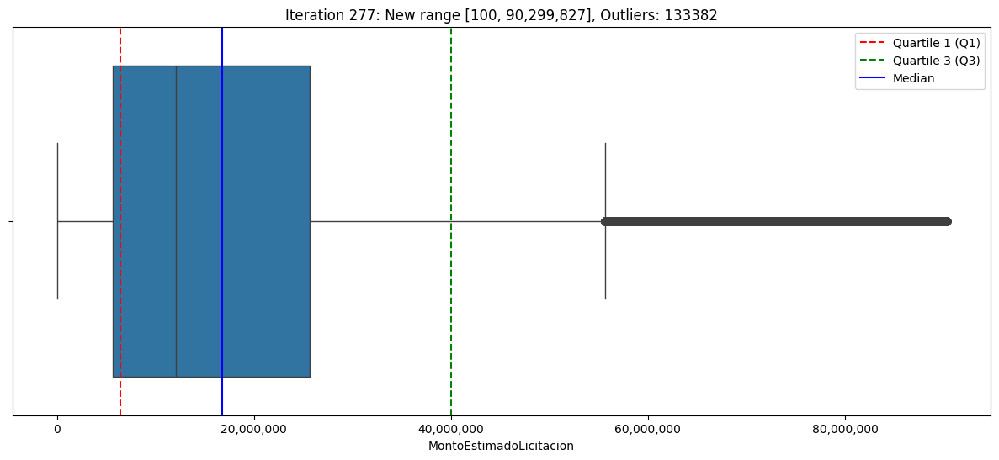

Iteration 277: New range [100, 90,299,827]


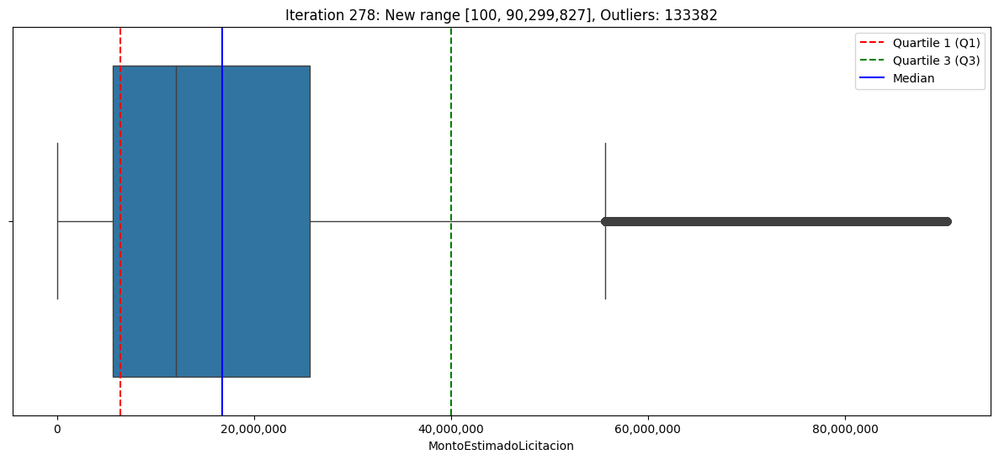

Iteration 278: New range [100, 90,299,827]


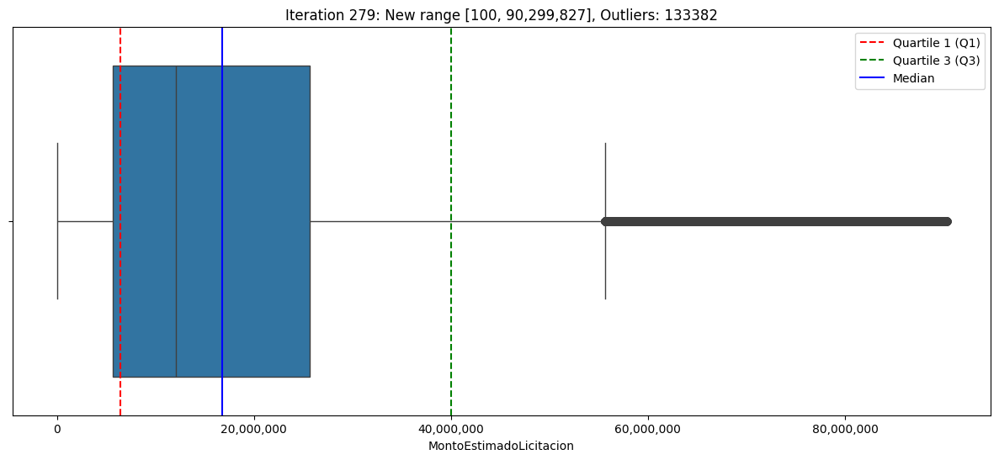

Iteration 279: New range [100, 90,299,827]


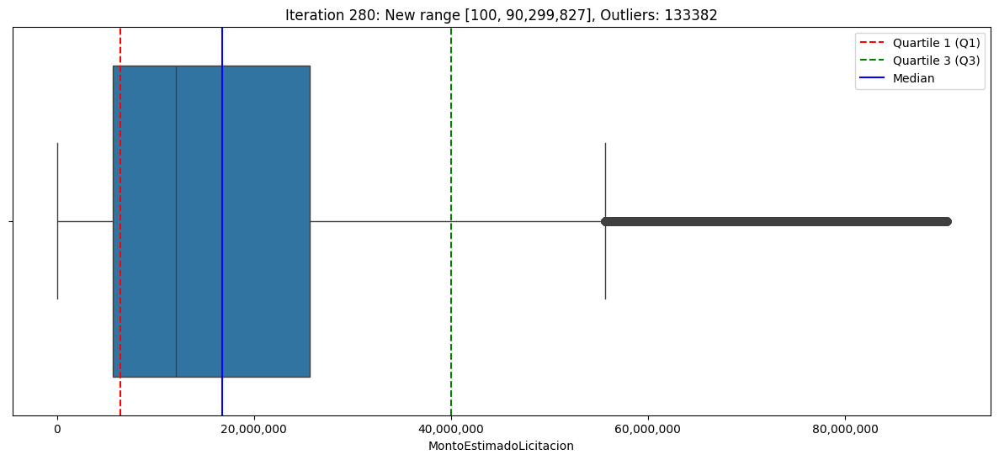

Iteration 280: New range [100, 90,299,827]


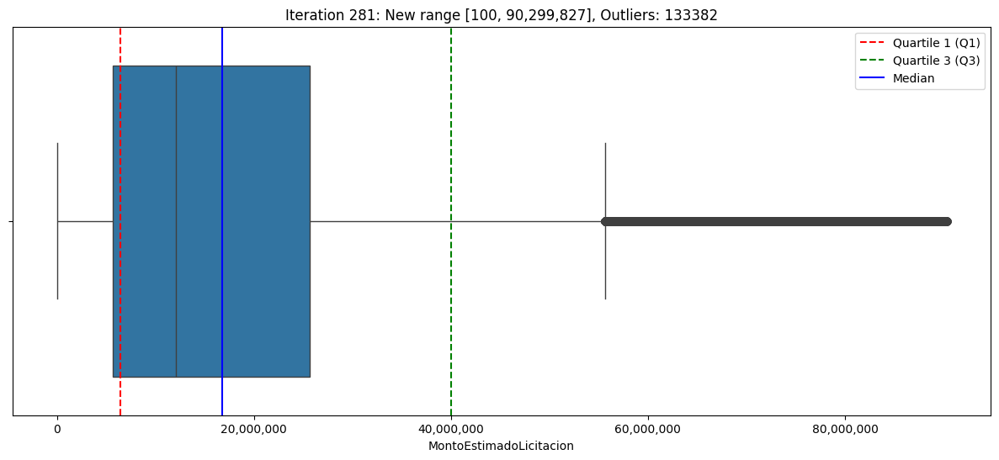

Iteration 281: New range [100, 90,299,827]


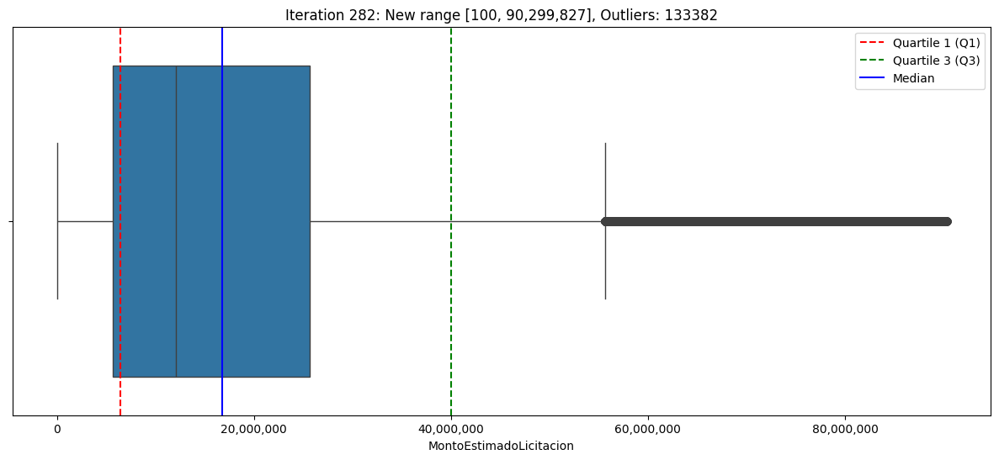

Iteration 282: New range [100, 90,299,827]


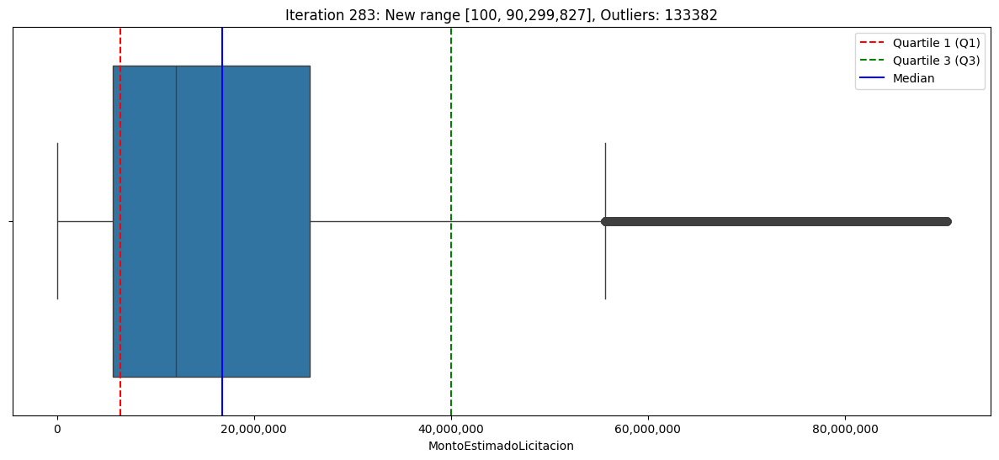

Iteration 283: New range [100, 90,299,827]


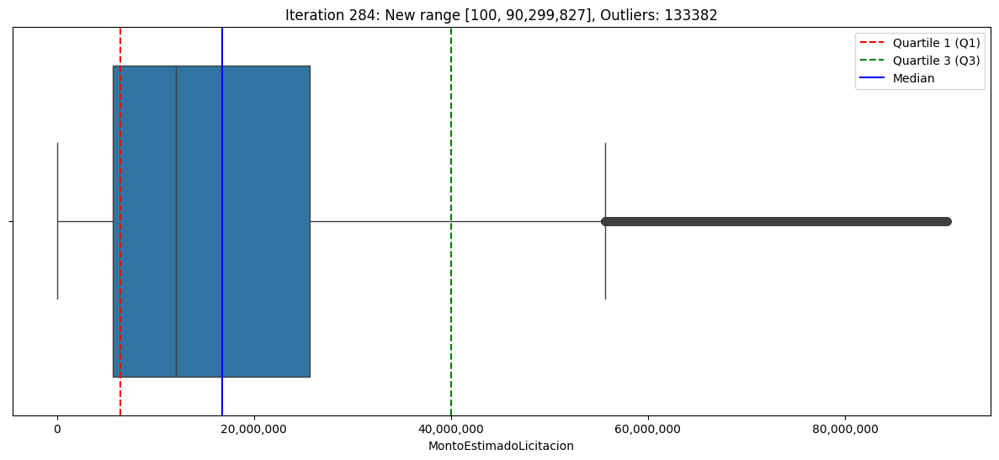

Iteration 284: New range [100, 90,299,827]


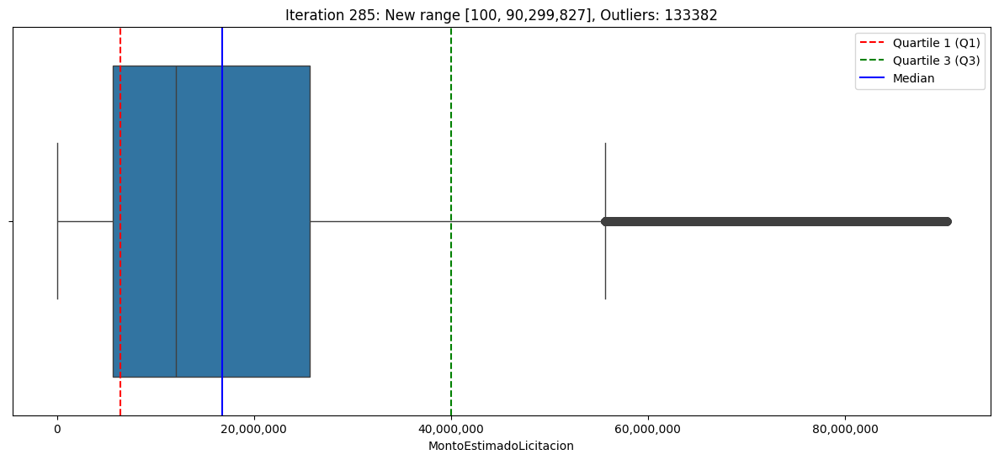

Iteration 285: New range [100, 90,299,827]


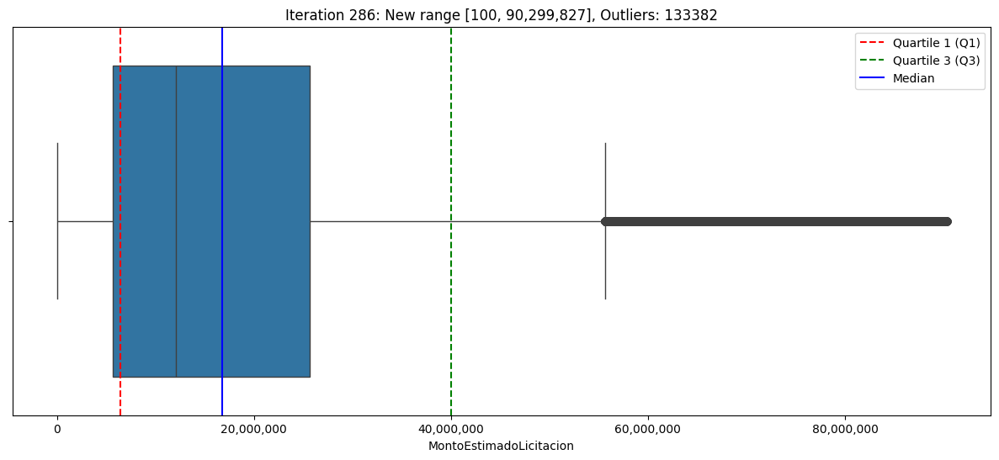

Iteration 286: New range [100, 90,299,827]


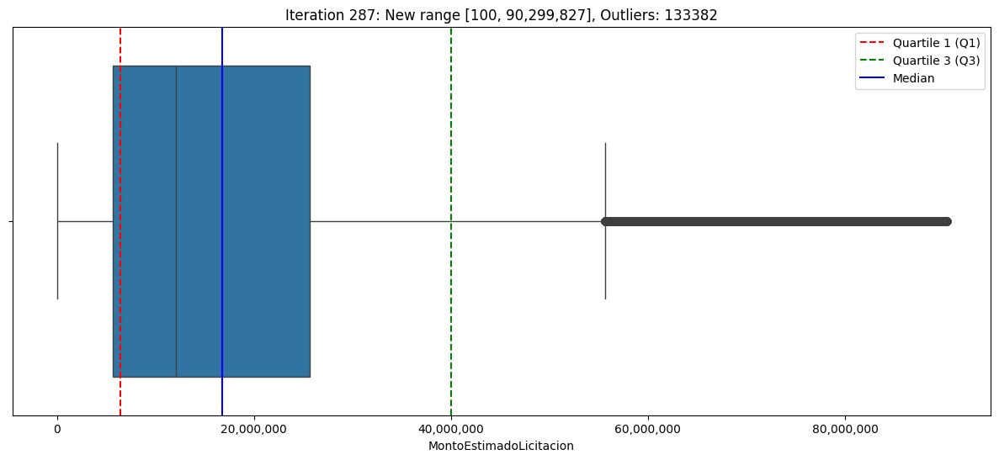

Iteration 287: New range [100, 90,299,827]


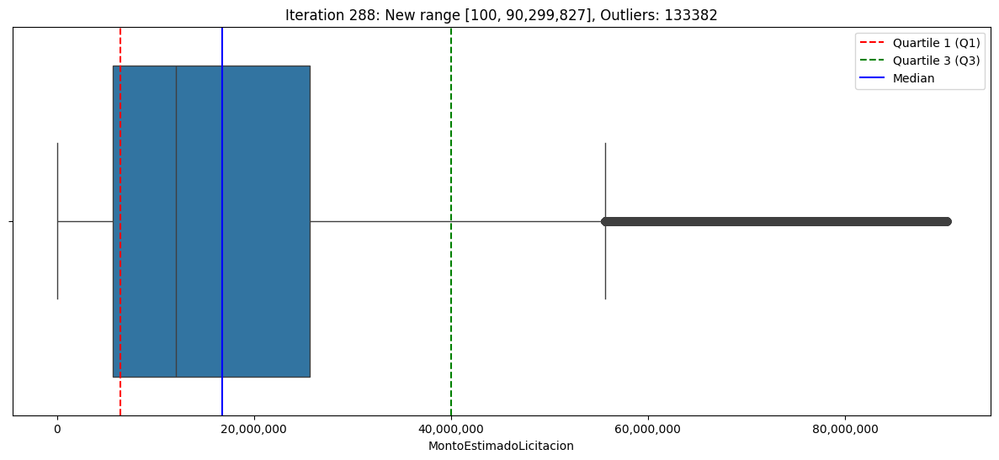

Iteration 288: New range [100, 90,299,827]


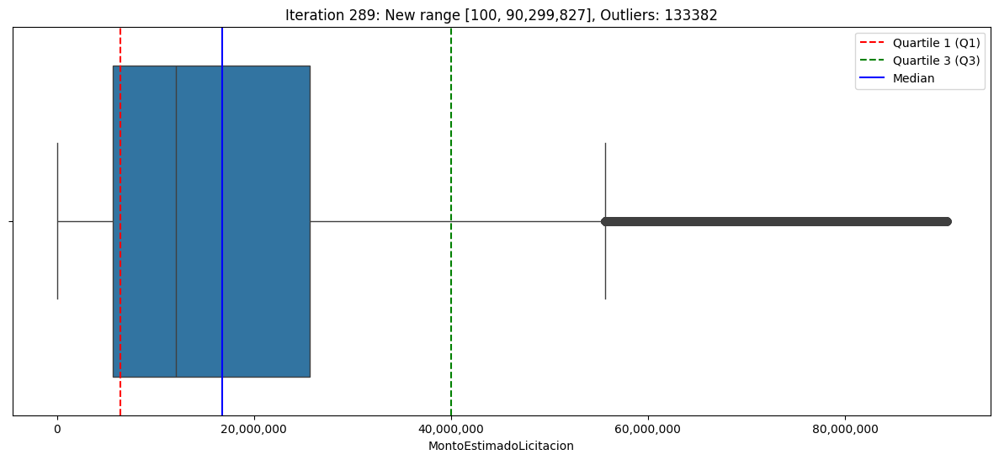

Iteration 289: New range [100, 90,299,827]


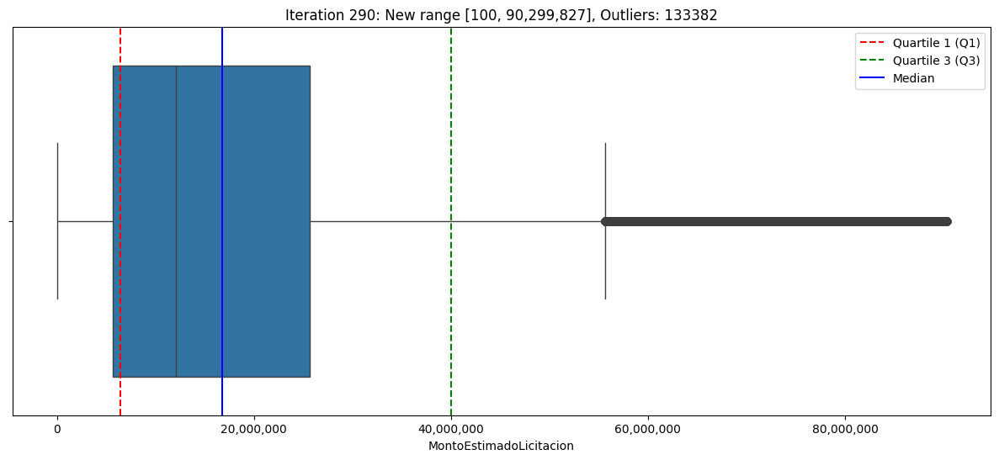

Iteration 290: New range [100, 90,299,827]


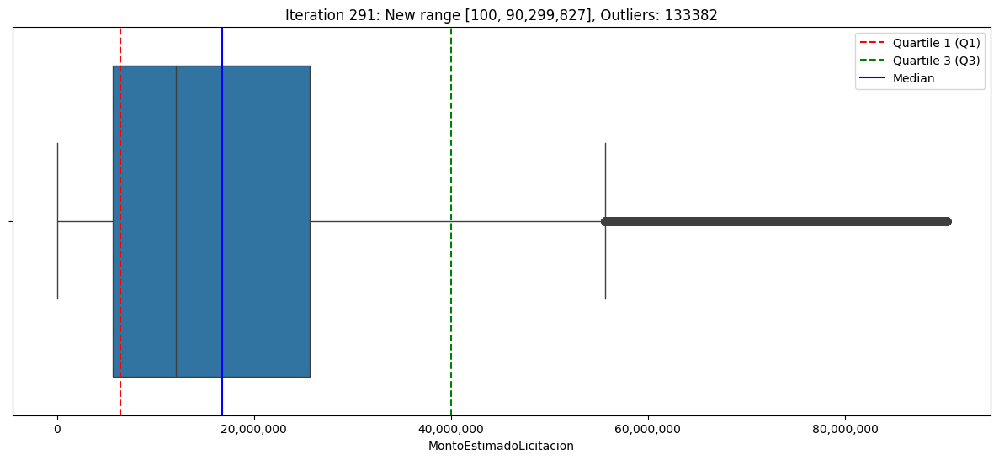

Iteration 291: New range [100, 90,299,827]


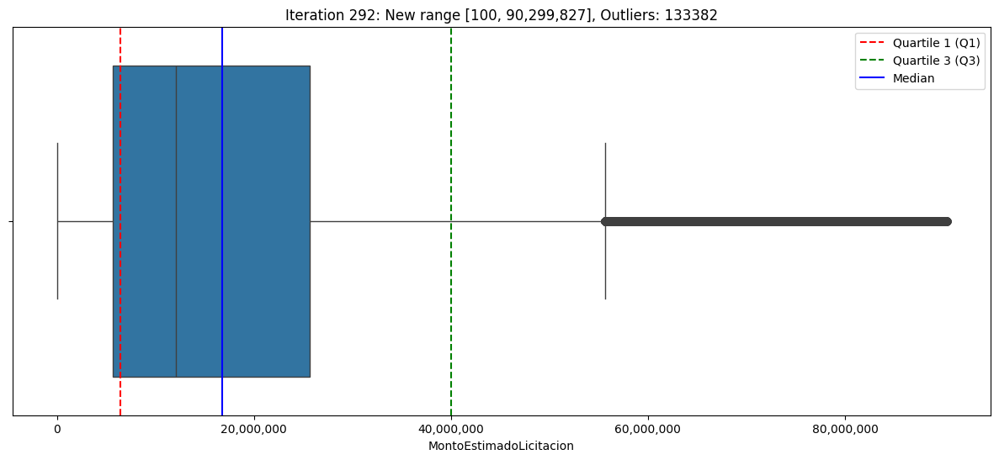

Iteration 292: New range [100, 90,299,827]


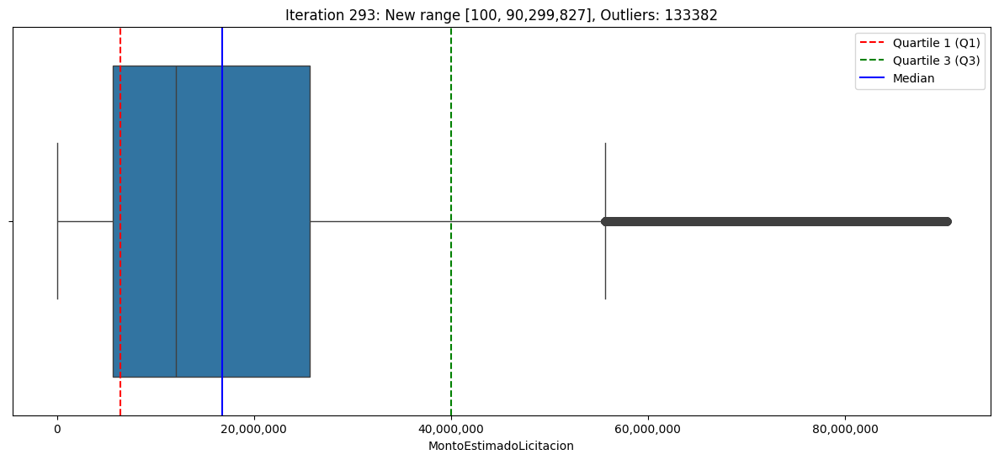

Iteration 293: New range [100, 90,299,827]


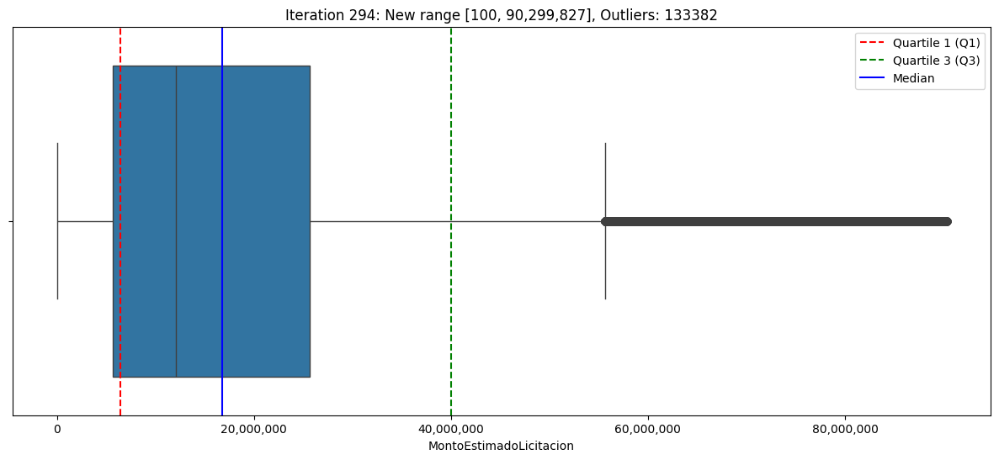

Iteration 294: New range [100, 90,299,827]


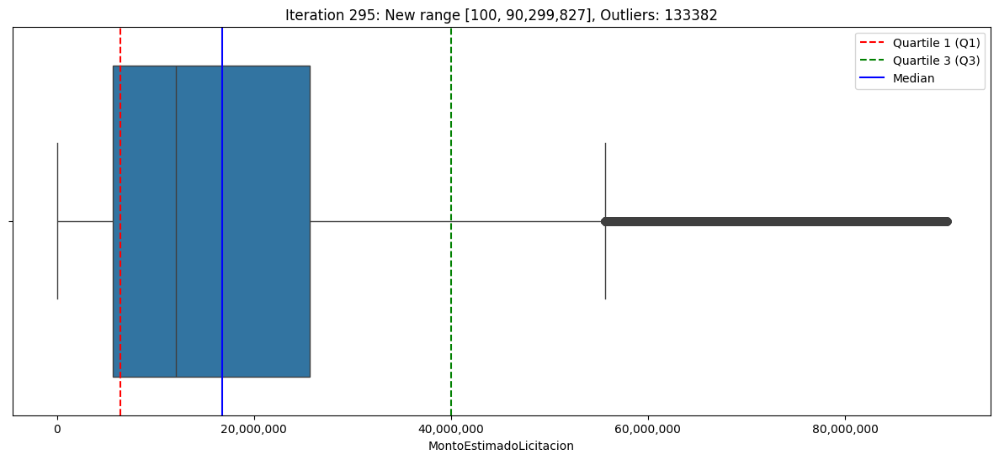

Iteration 295: New range [100, 90,299,827]


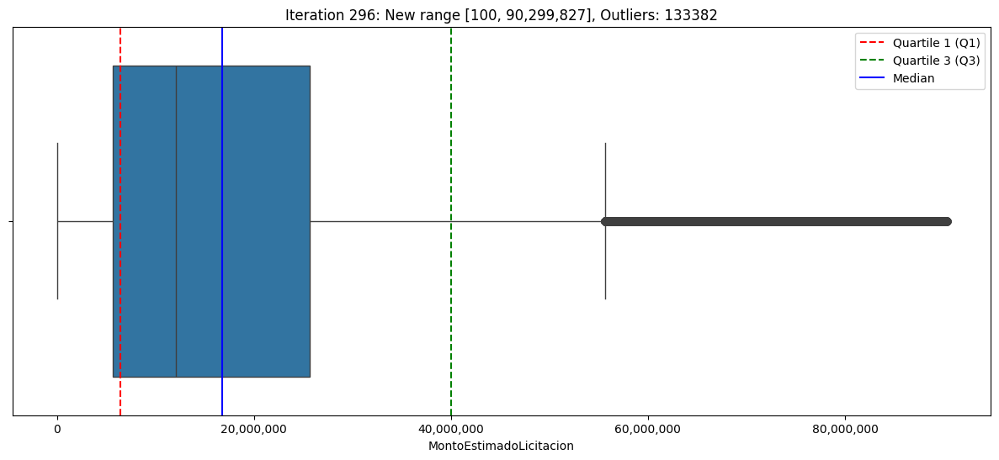

Iteration 296: New range [100, 90,299,827]


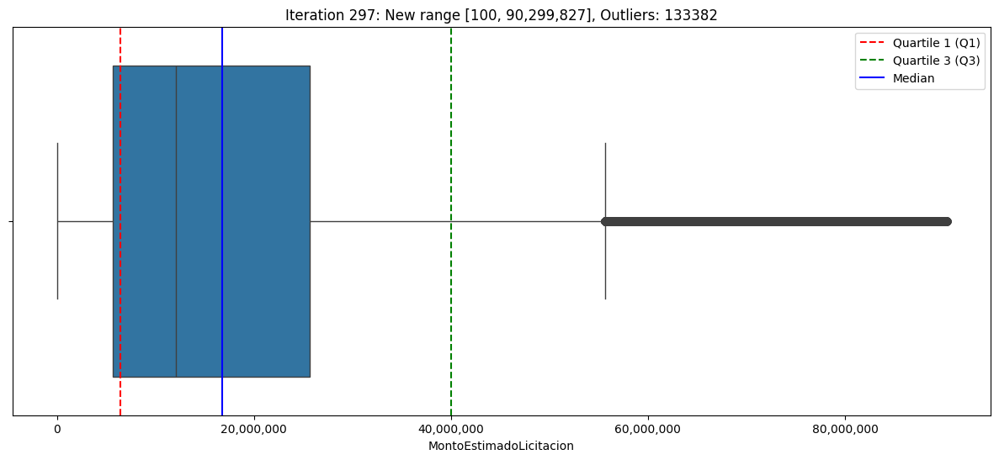

Iteration 297: New range [100, 90,299,827]


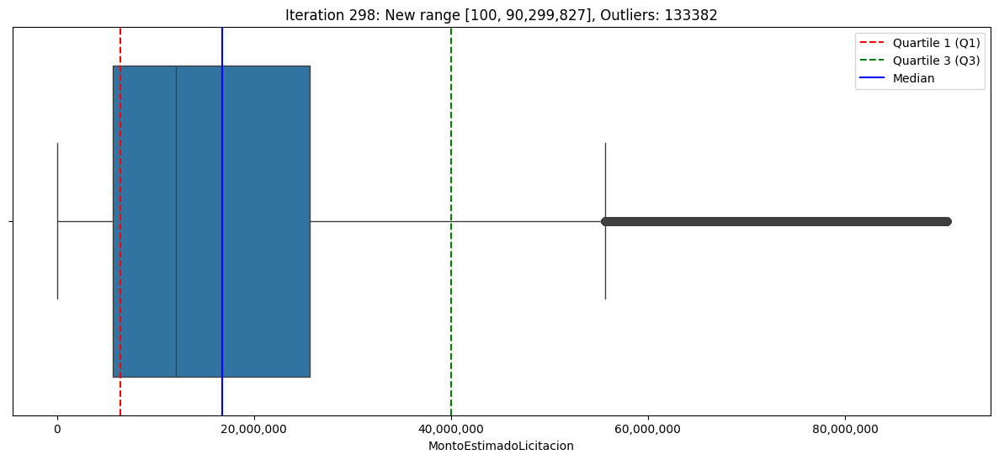

Iteration 298: New range [100, 90,299,827]


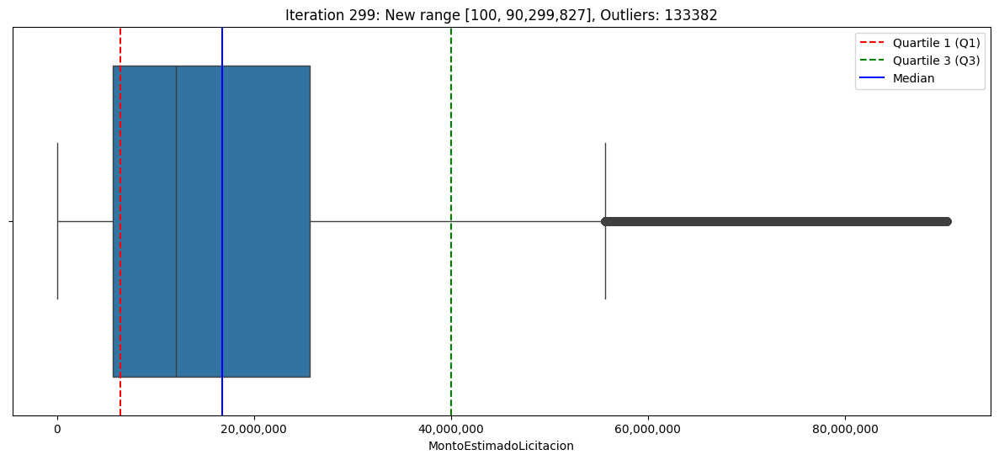

Iteration 299: New range [100, 90,299,827]


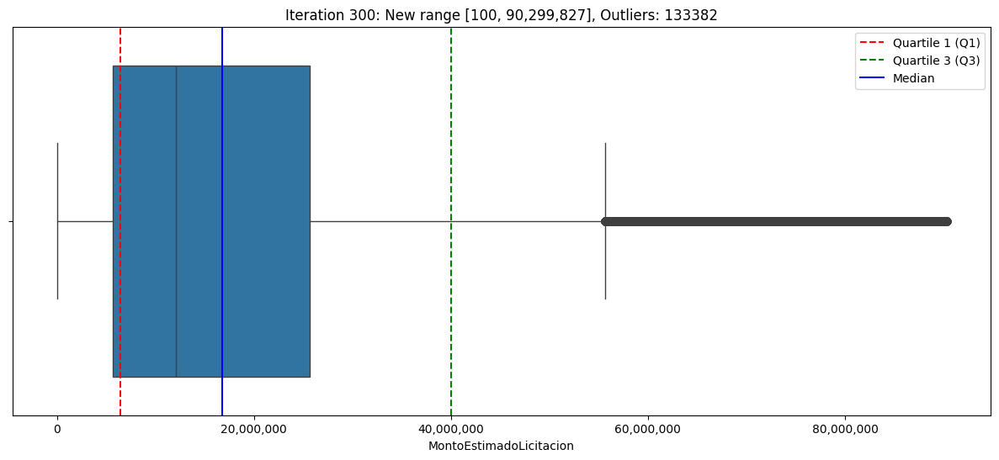

Iteration 300: New range [100, 90,299,827]


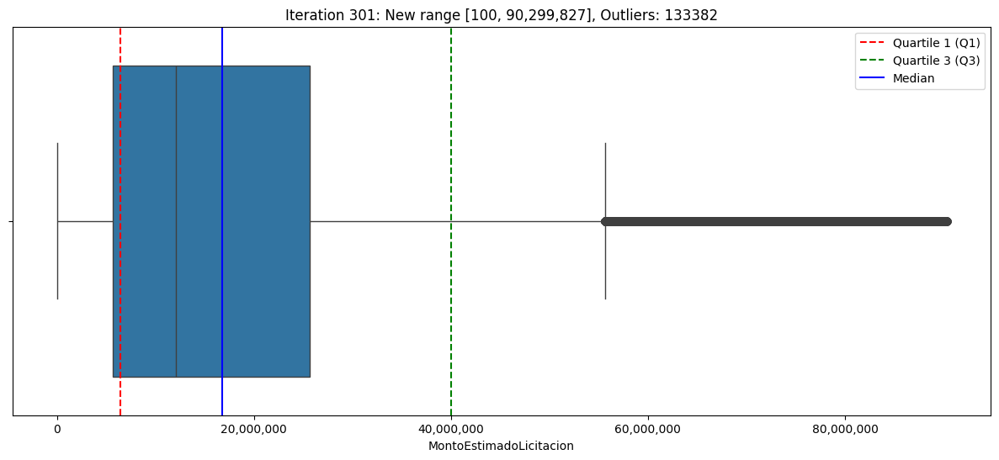

Iteration 301: New range [100, 90,299,827]


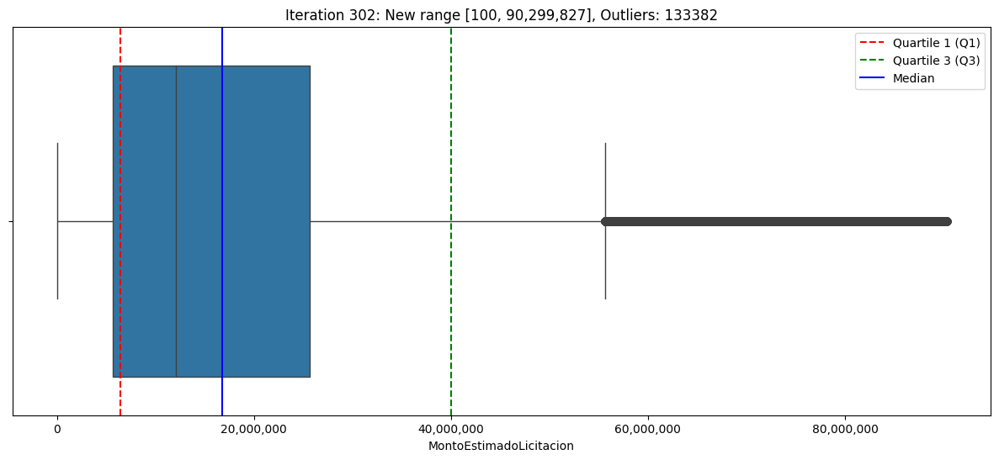

Iteration 302: New range [100, 90,299,827]


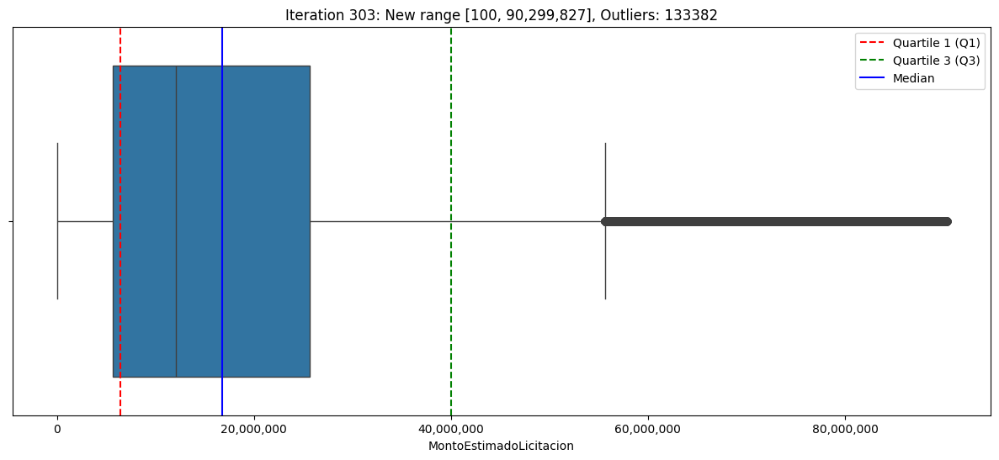

Iteration 303: New range [100, 90,299,827]


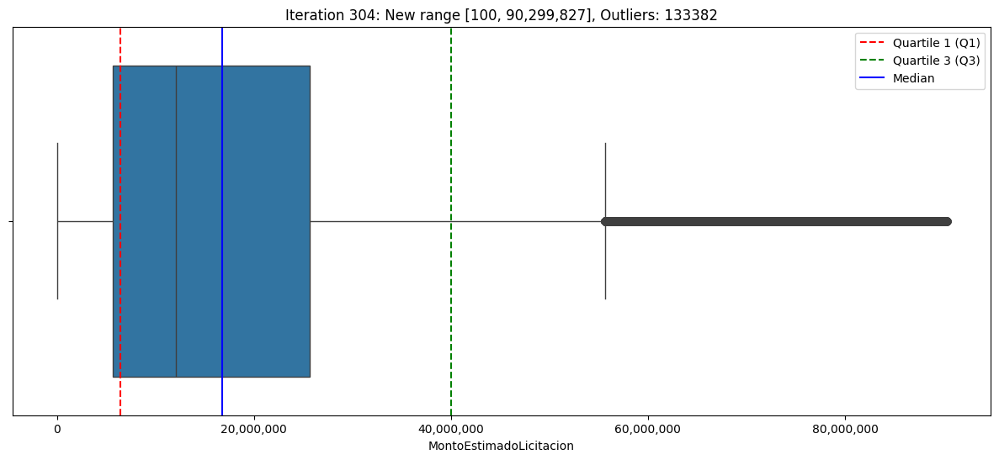

Iteration 304: New range [100, 90,299,827]


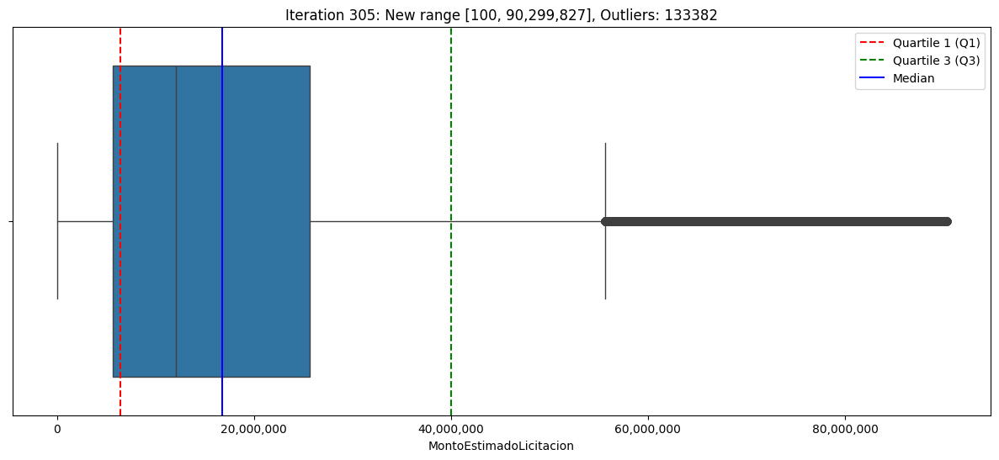

Iteration 305: New range [100, 90,299,827]


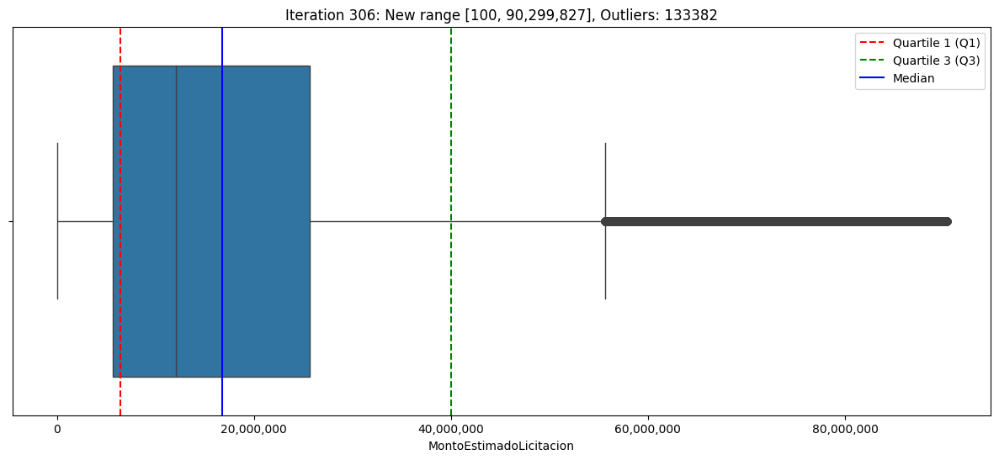

Iteration 306: New range [100, 90,299,827]


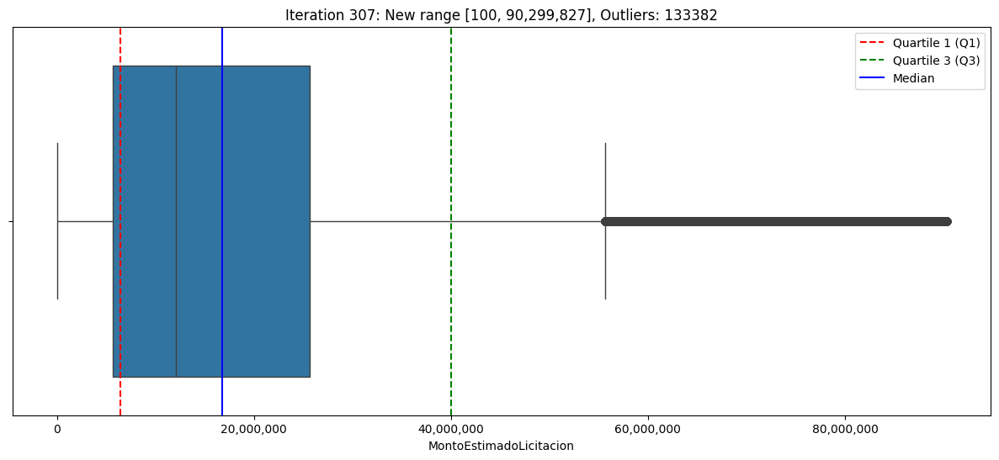

Iteration 307: New range [100, 90,299,827]


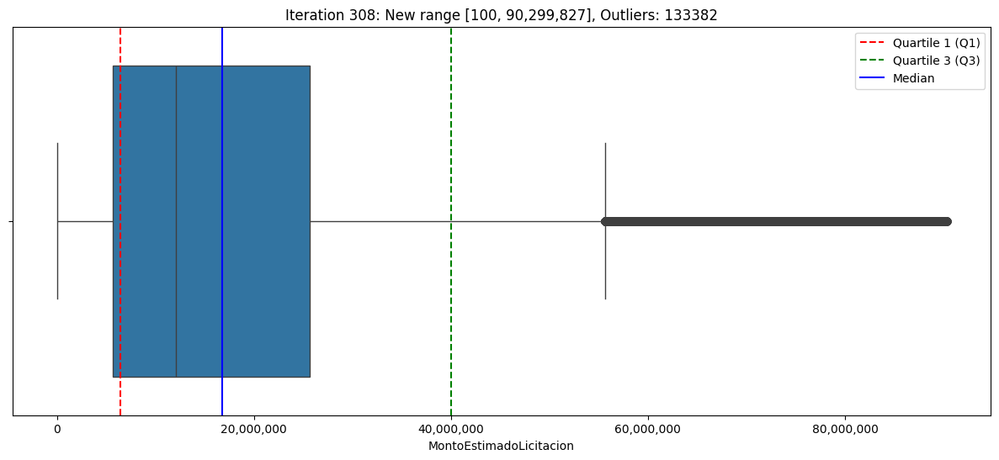

Iteration 308: New range [100, 90,299,827]


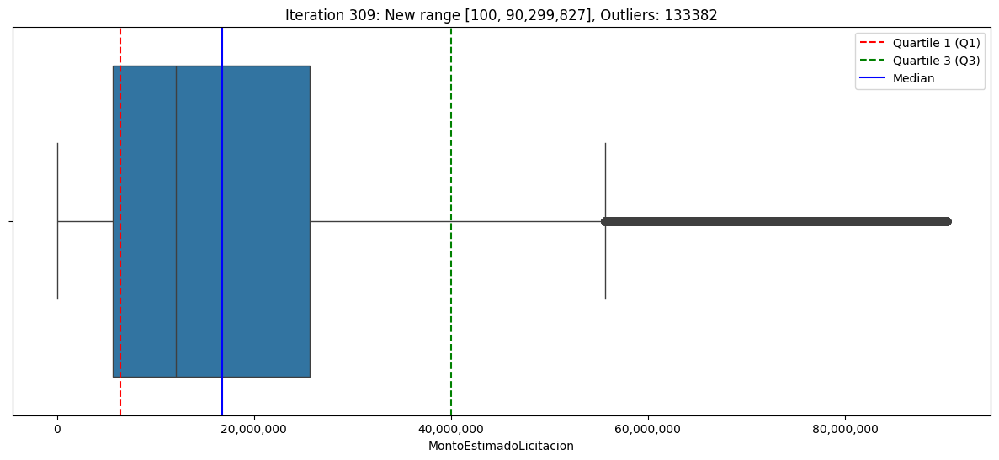

Iteration 309: New range [100, 90,299,827]


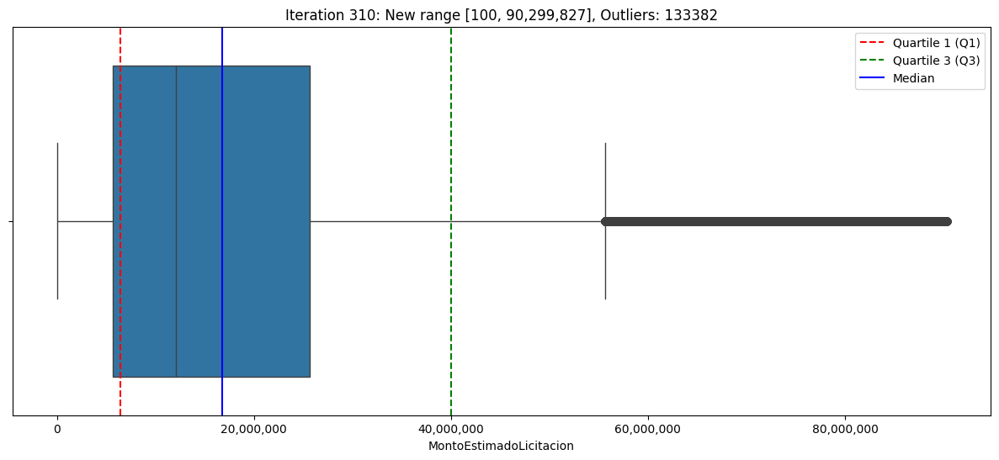

Iteration 310: New range [100, 90,299,827]


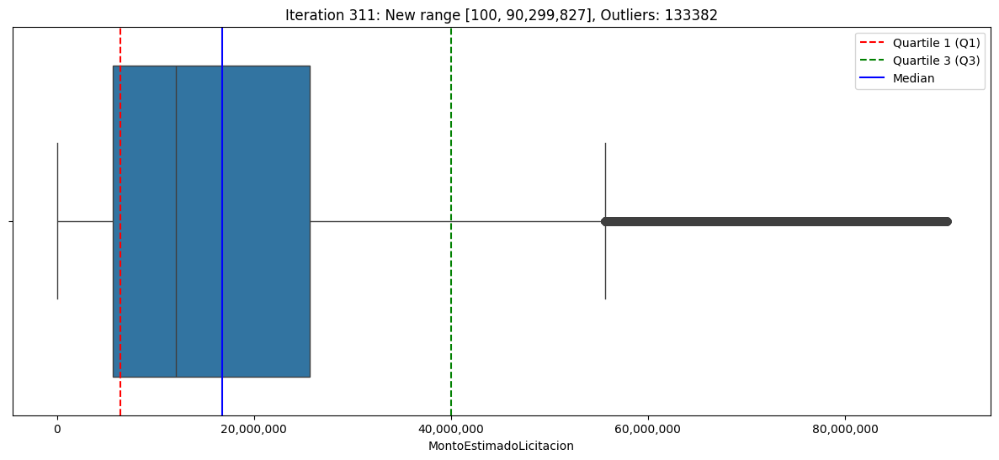

Iteration 311: New range [100, 90,299,827]


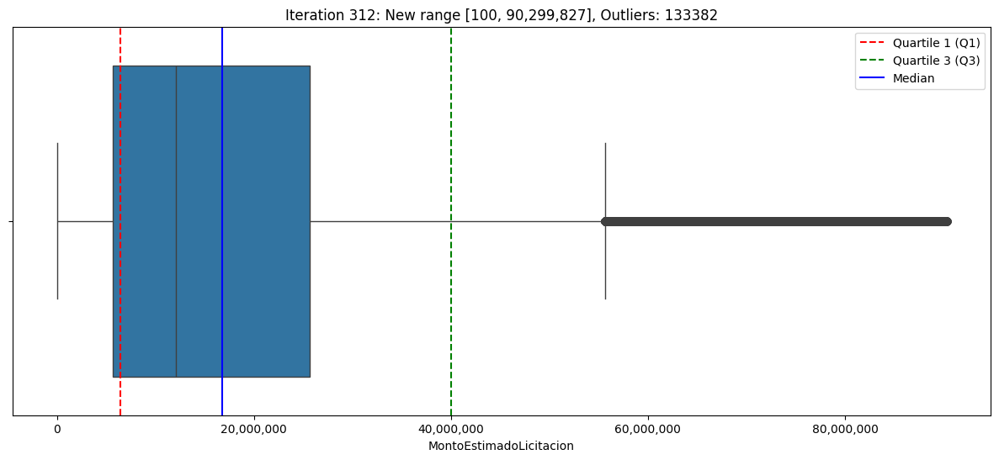

Iteration 312: New range [100, 90,299,827]


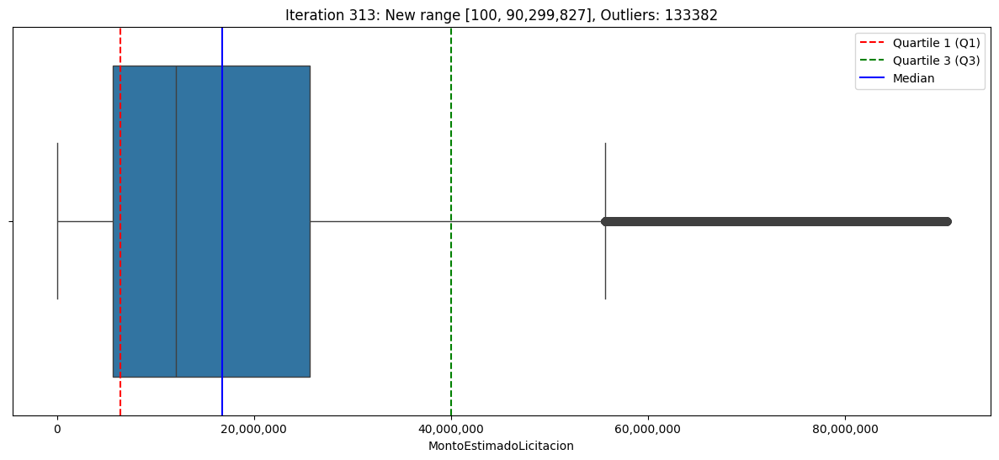

Iteration 313: New range [100, 90,299,827]


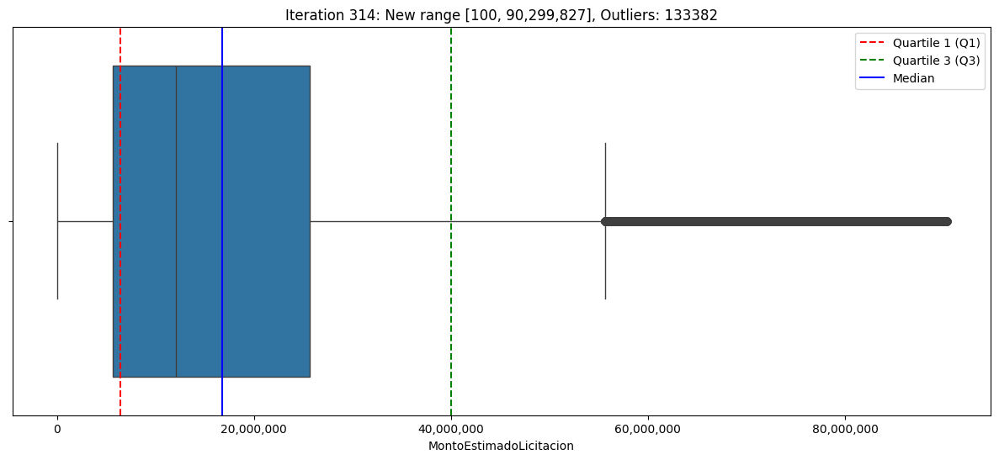

Iteration 314: New range [100, 90,299,827]


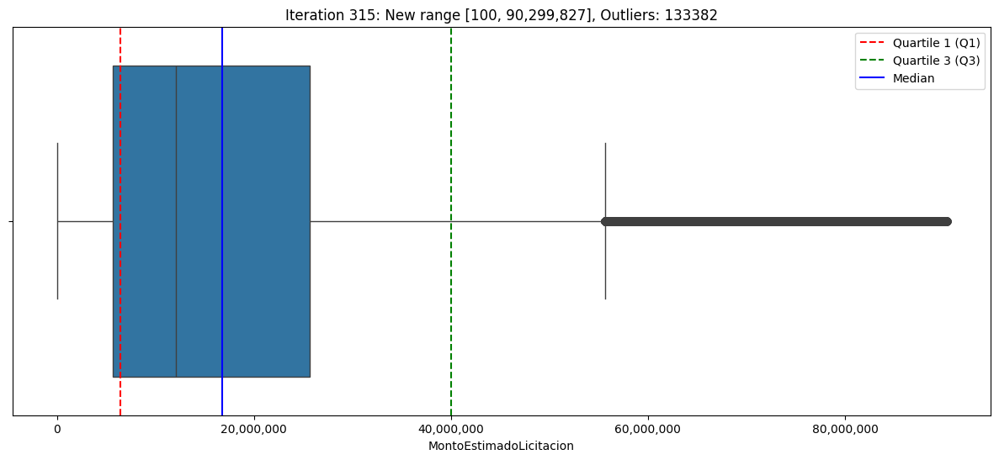

Iteration 315: New range [100, 90,299,827]


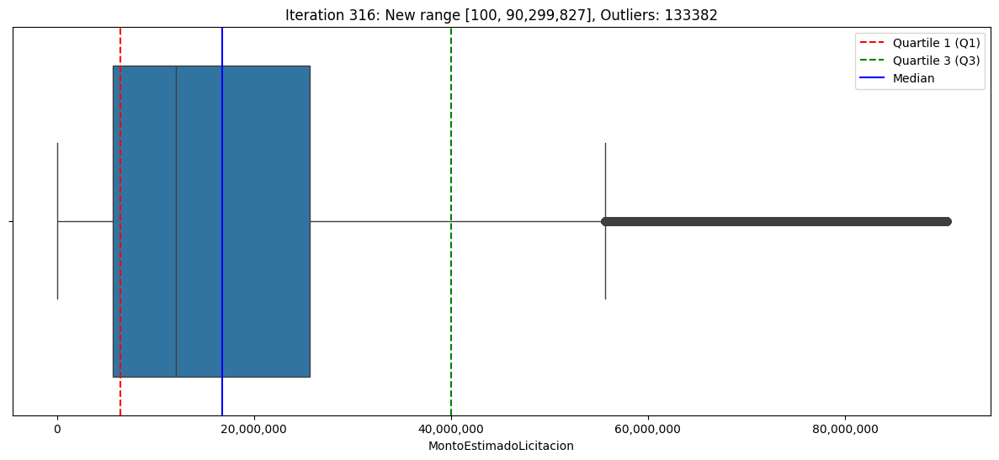

Iteration 316: New range [100, 90,299,827]


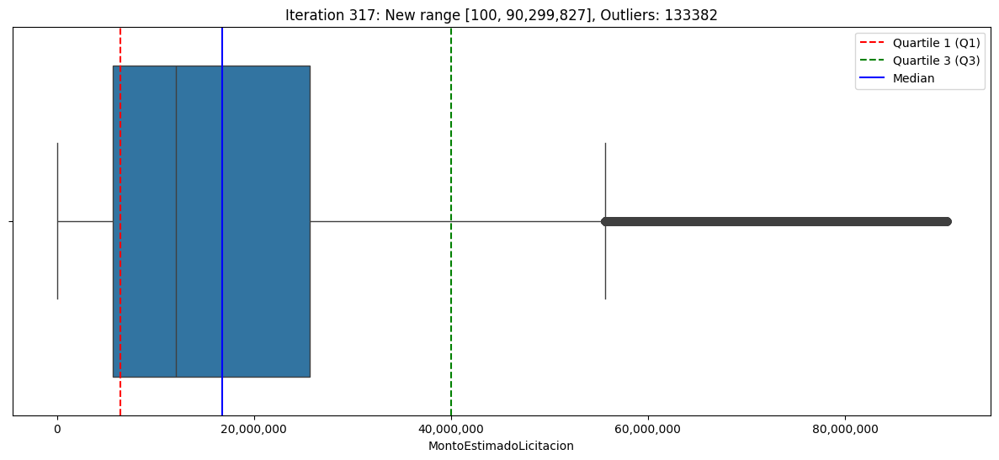

Iteration 317: New range [100, 90,299,827]


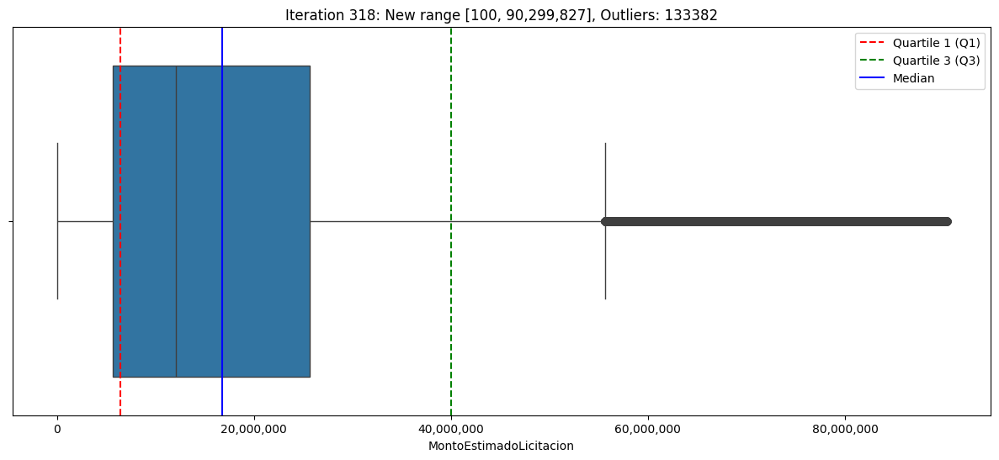

Iteration 318: New range [100, 90,299,827]


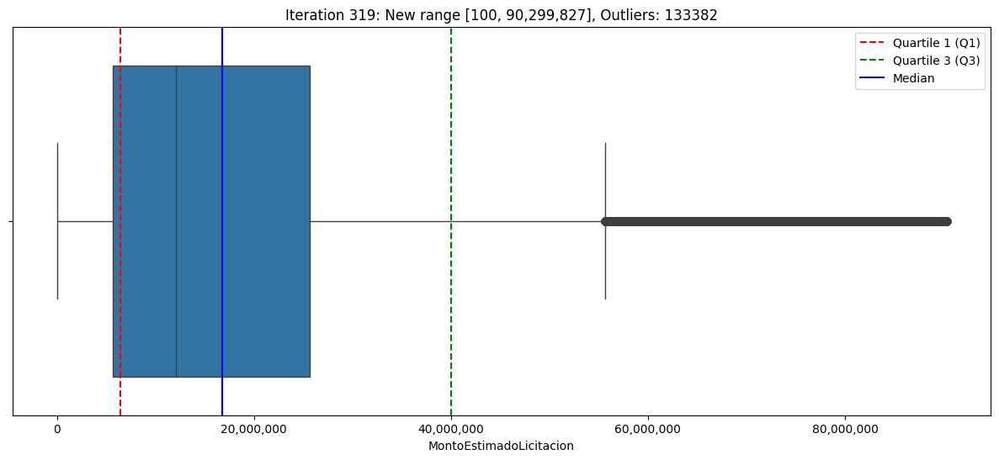

Iteration 319: New range [100, 90,299,827]


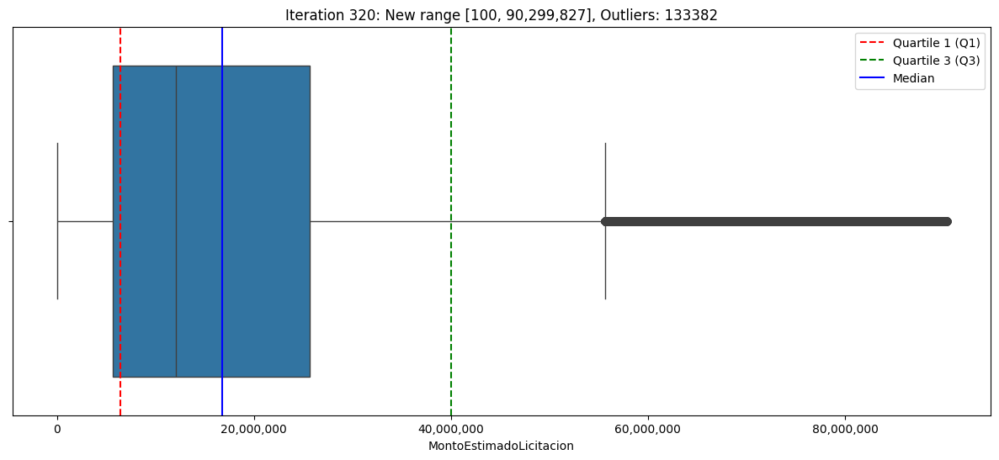

Iteration 320: New range [100, 90,299,827]


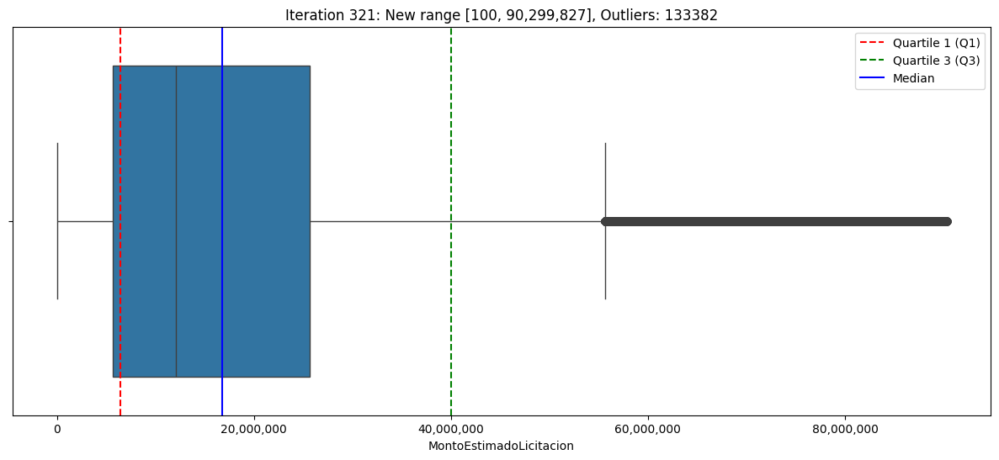

Iteration 321: New range [100, 90,299,827]


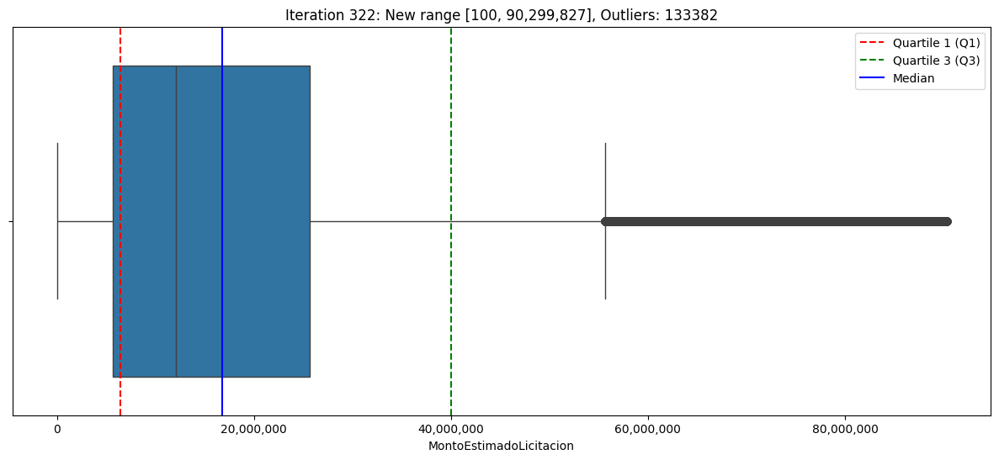

Iteration 322: New range [100, 90,299,827]


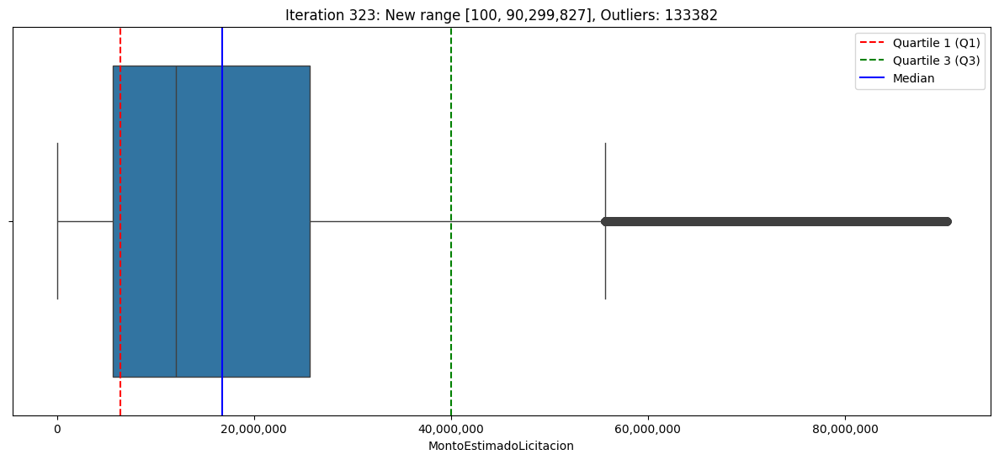

Iteration 323: New range [100, 90,299,827]


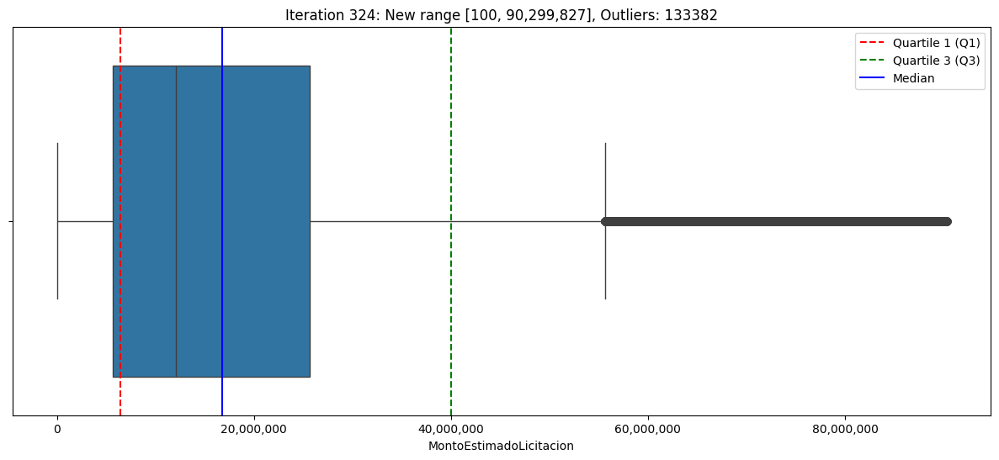

Iteration 324: New range [100, 90,299,827]


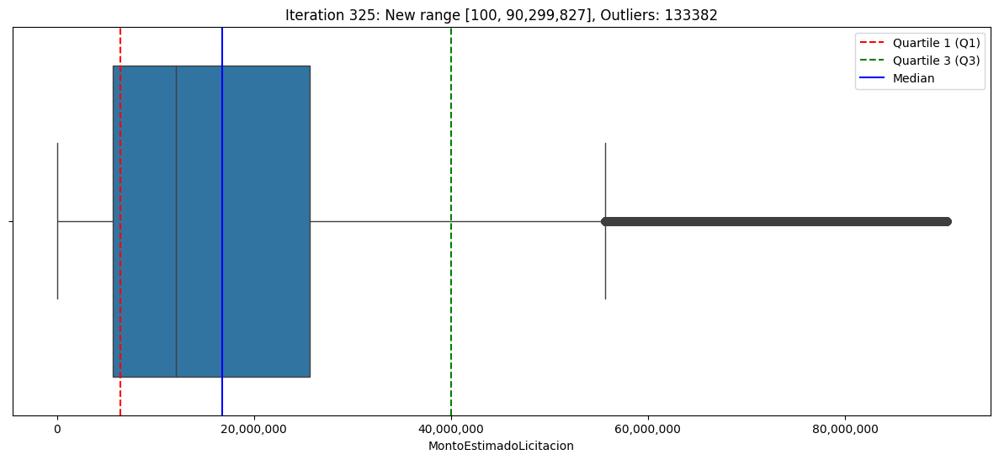

Iteration 325: New range [100, 90,299,827]


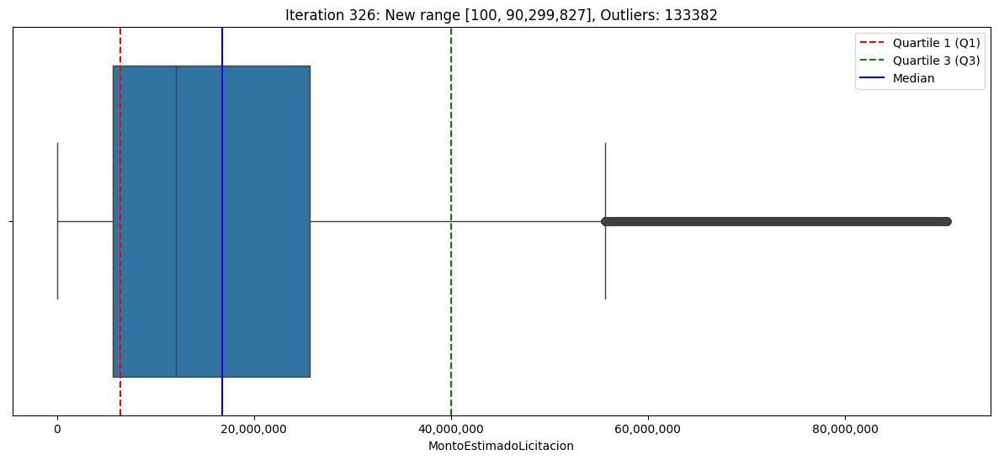

Iteration 326: New range [100, 90,299,827]


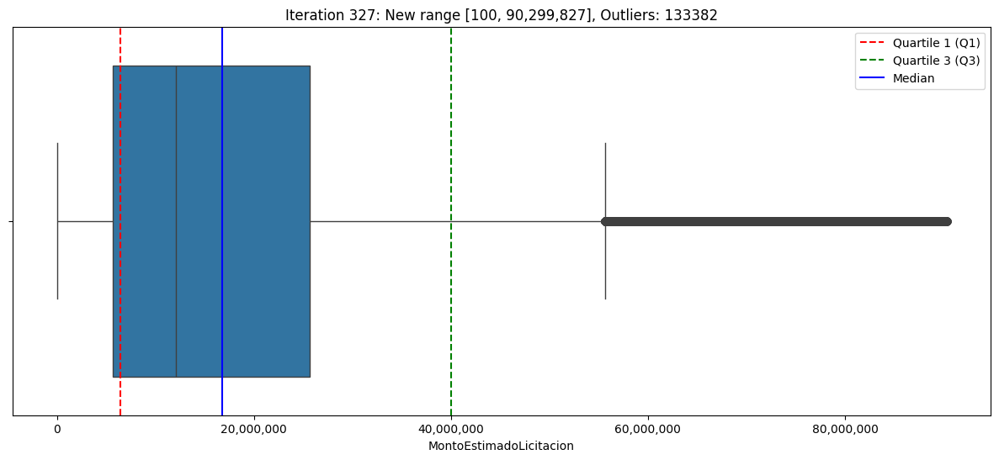

Iteration 327: New range [100, 90,299,827]


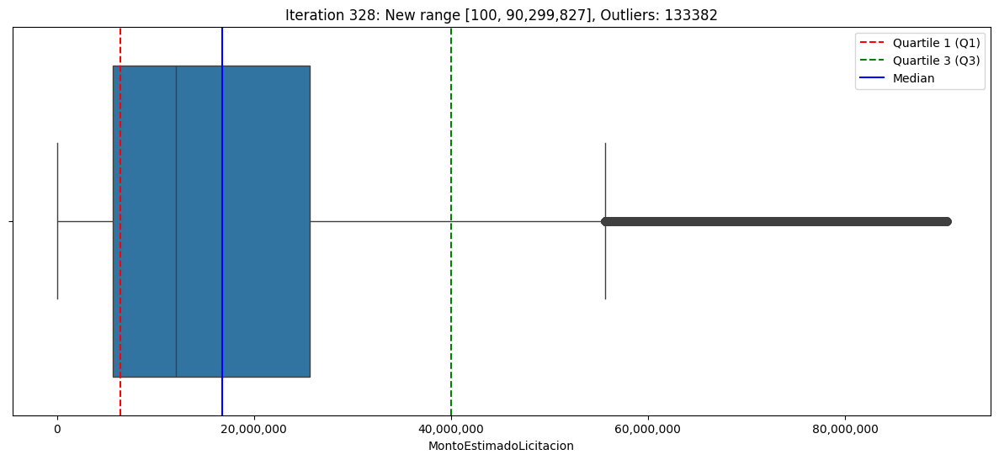

Iteration 328: New range [100, 90,299,827]


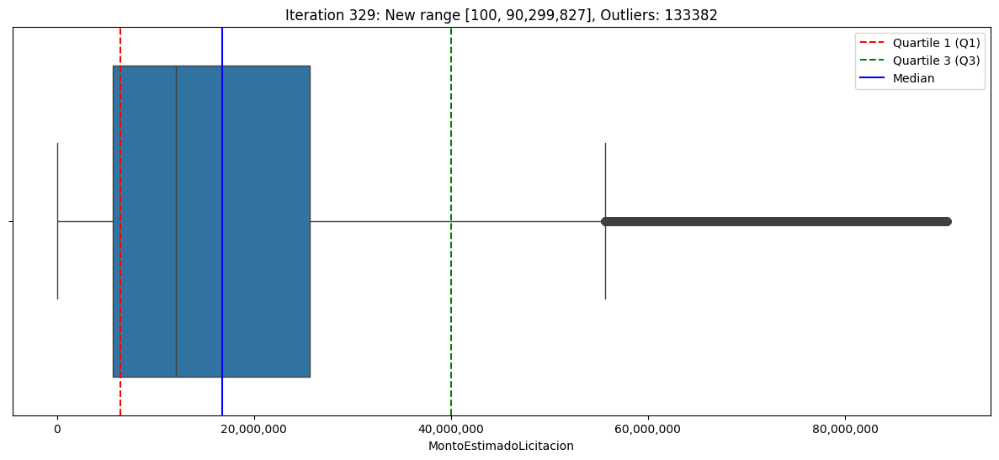

Iteration 329: New range [100, 90,299,827]


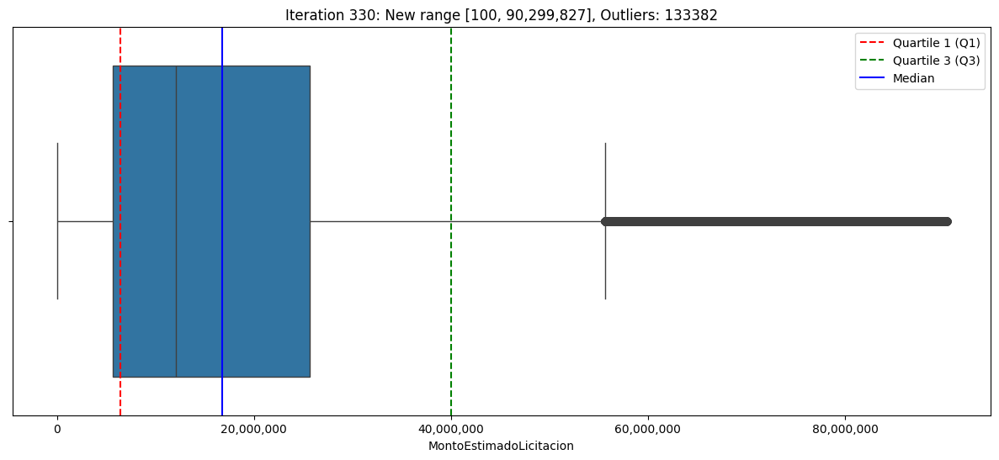

Iteration 330: New range [100, 90,299,827]


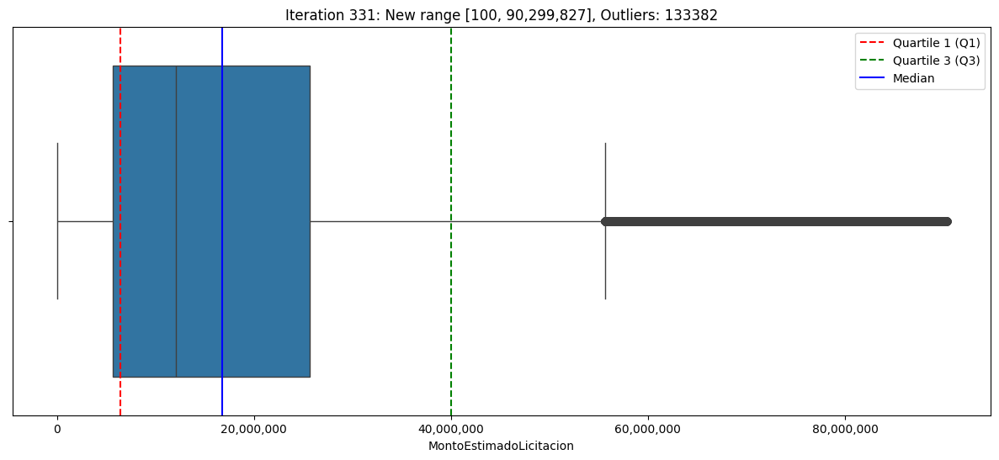

Iteration 331: New range [100, 90,299,827]


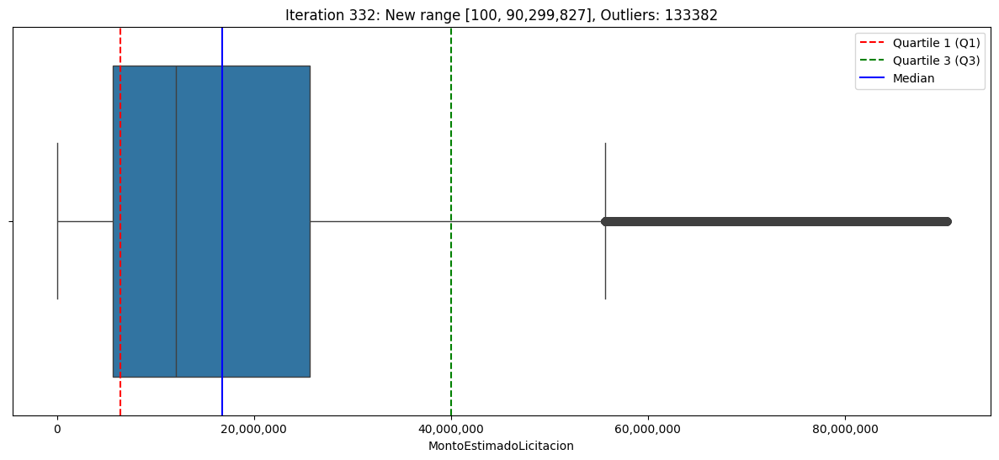

Iteration 332: New range [100, 90,299,827]


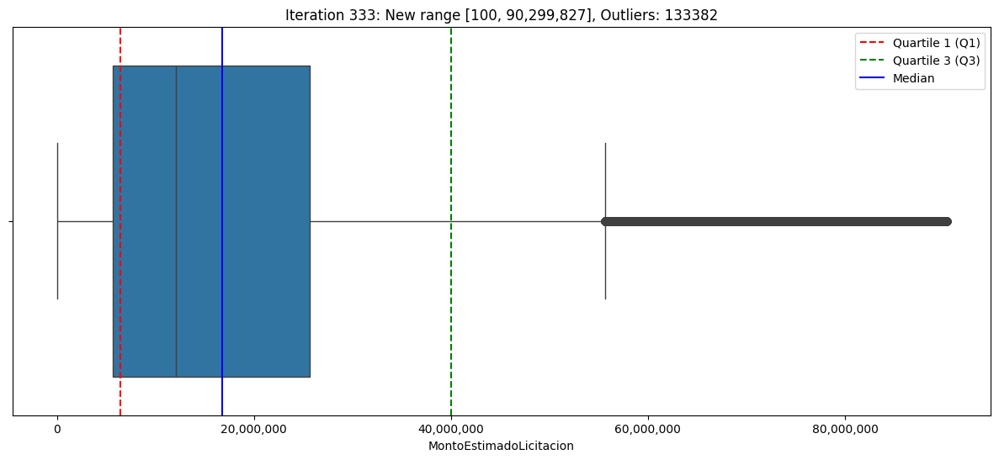

Iteration 333: New range [100, 90,299,827]


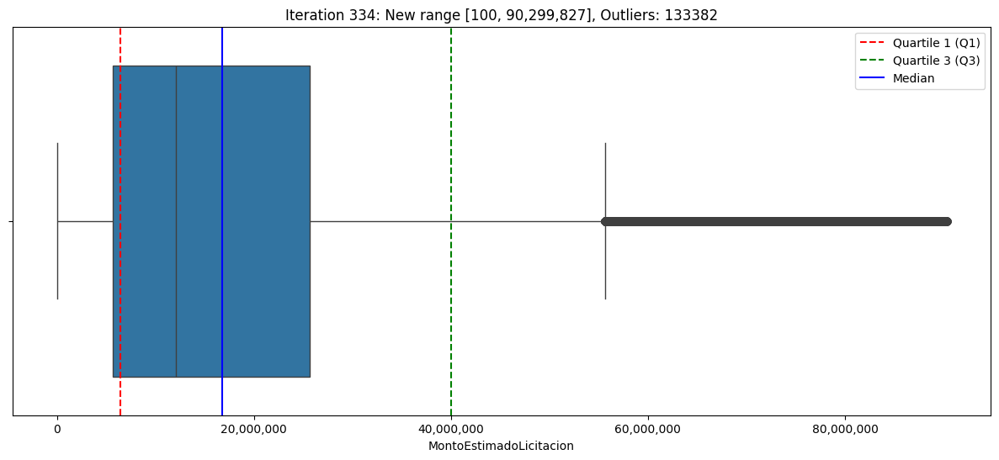

Iteration 334: New range [100, 90,299,827]


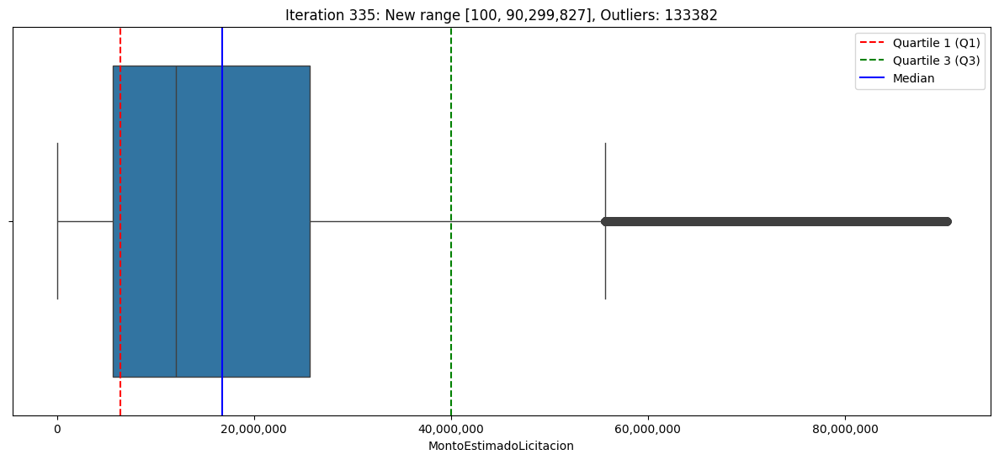

Iteration 335: New range [100, 90,299,827]


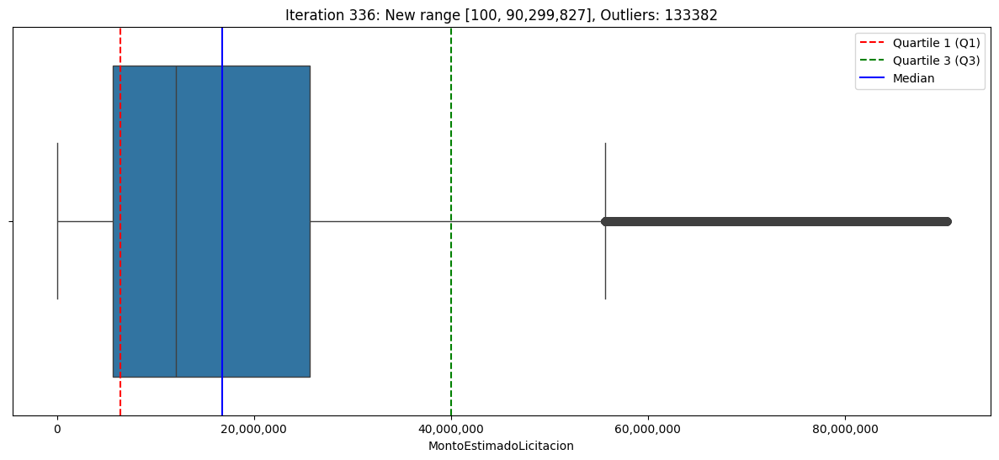

Iteration 336: New range [100, 90,299,827]


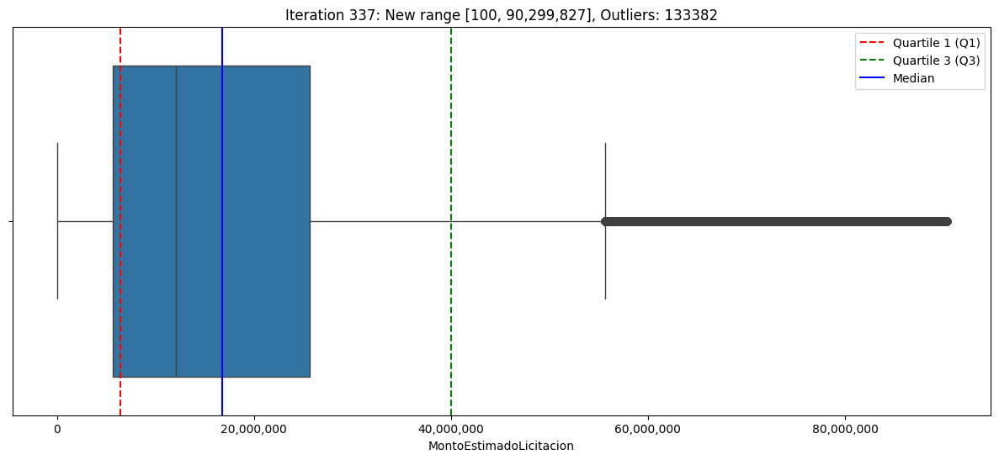

Iteration 337: New range [100, 90,299,827]


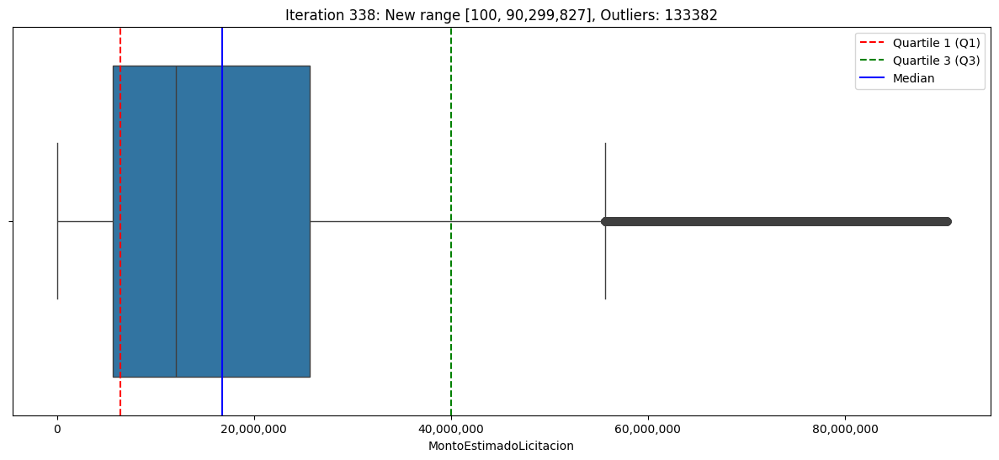

Iteration 338: New range [100, 90,299,827]


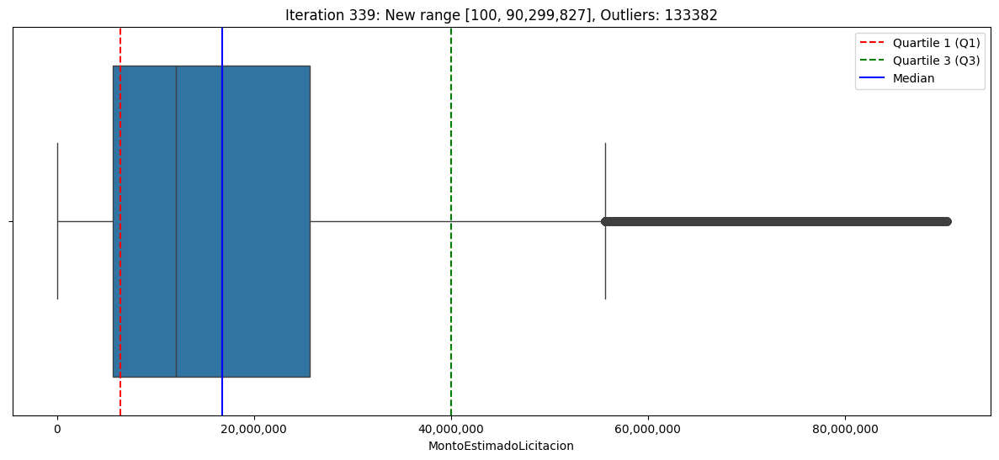

Iteration 339: New range [100, 90,299,827]


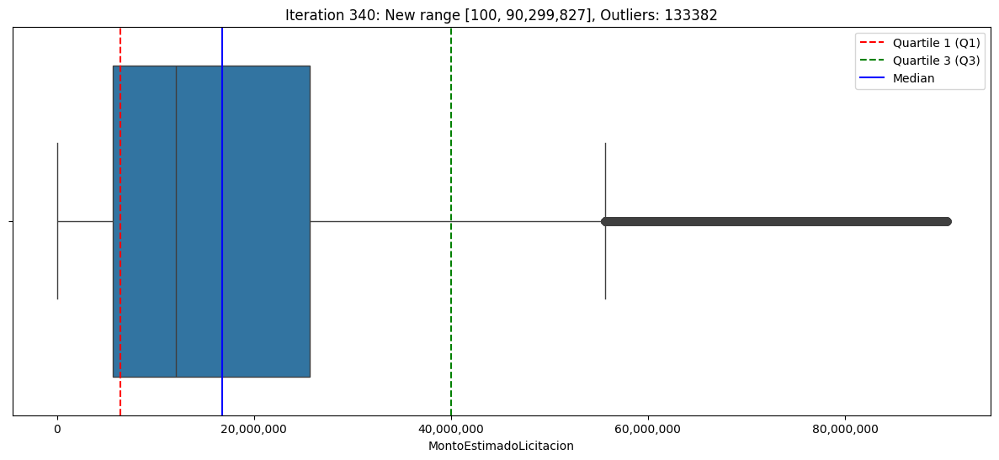

Iteration 340: New range [100, 90,299,827]


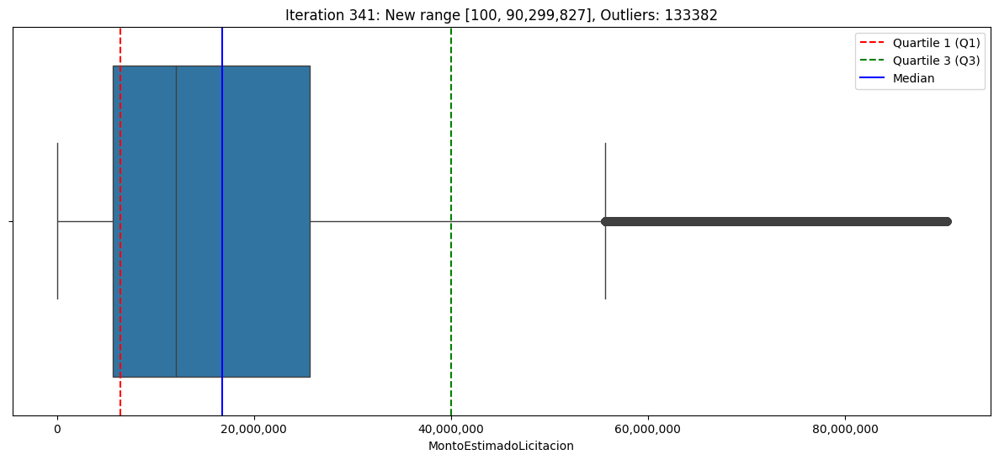

Iteration 341: New range [100, 90,299,827]


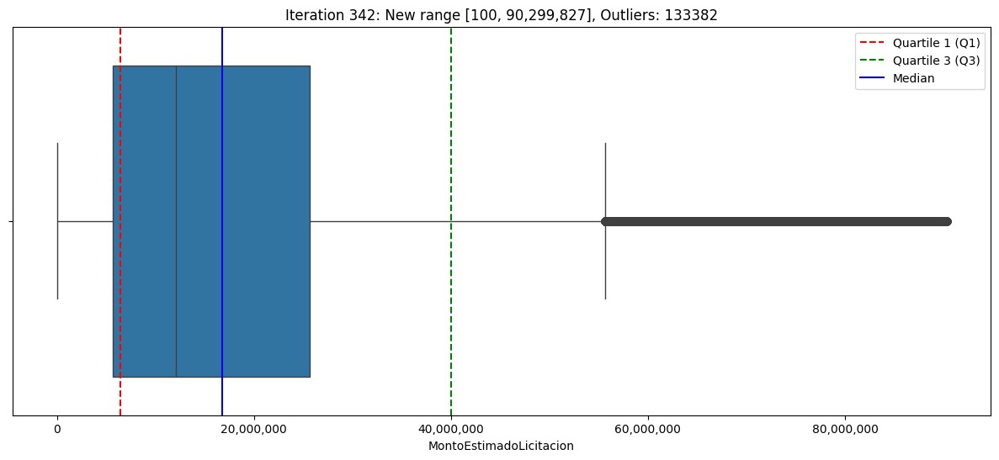

Iteration 342: New range [100, 90,299,827]


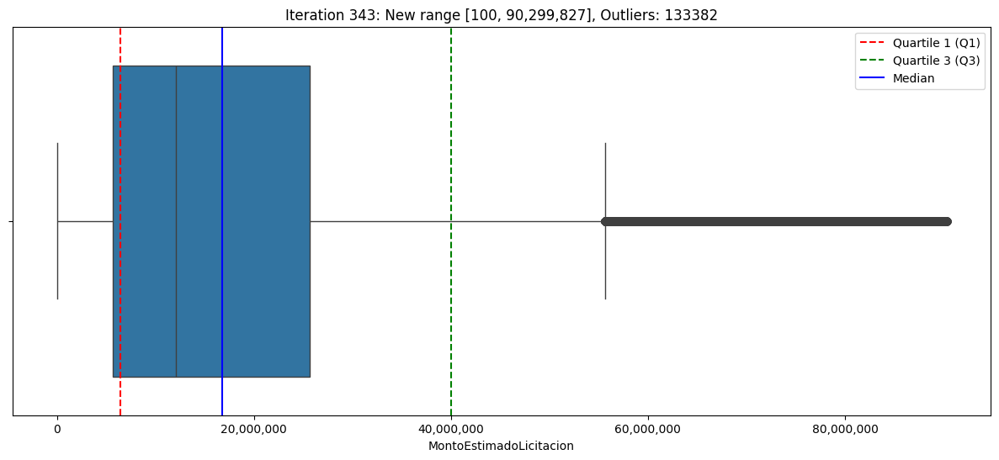

Iteration 343: New range [100, 90,299,827]


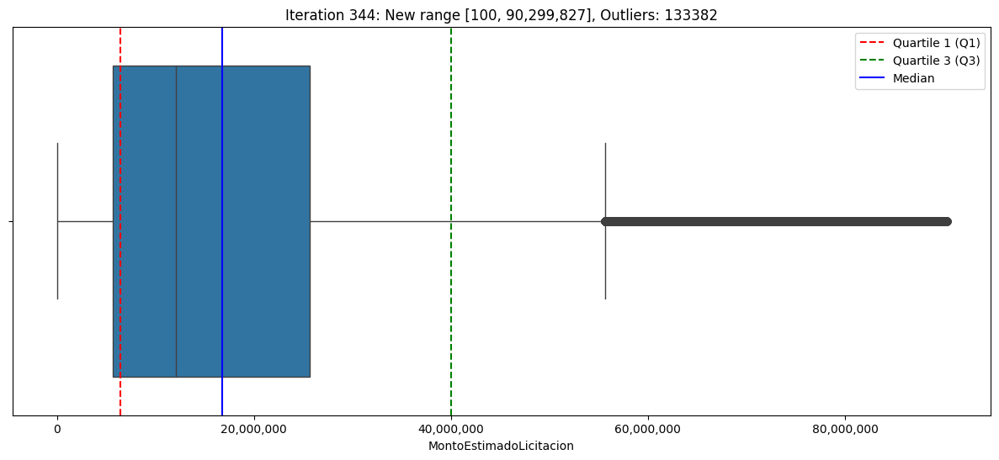

Iteration 344: New range [100, 90,299,827]


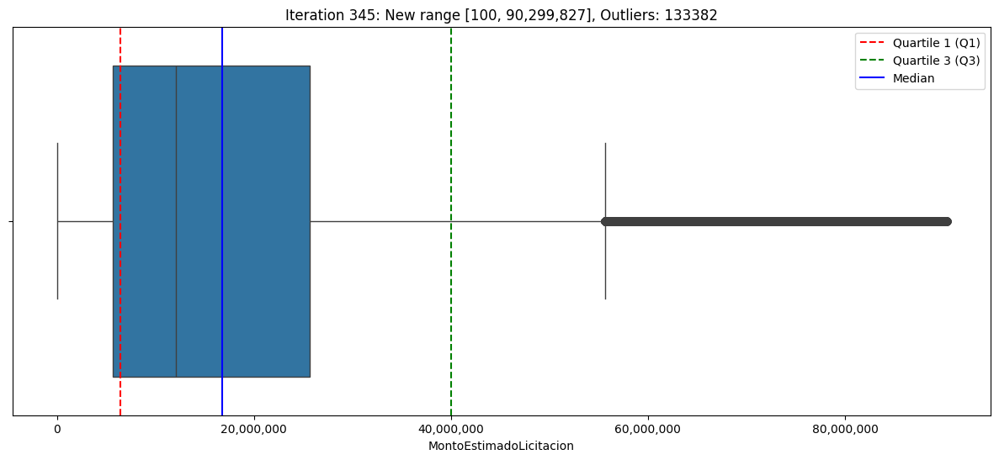

Iteration 345: New range [100, 90,299,827]


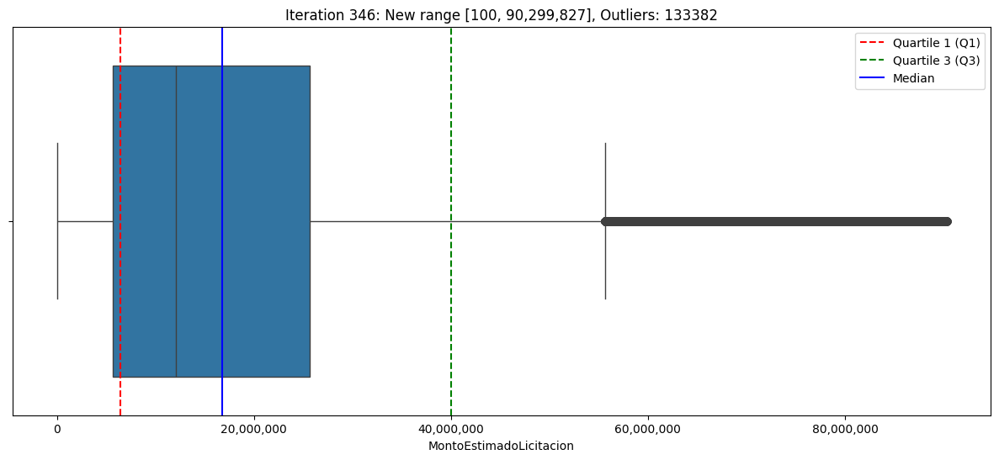

Iteration 346: New range [100, 90,299,827]


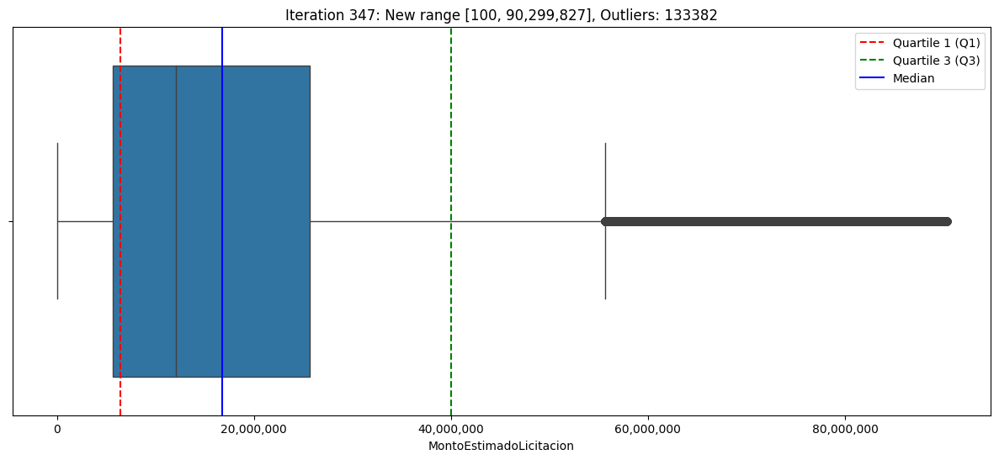

Iteration 347: New range [100, 90,299,827]


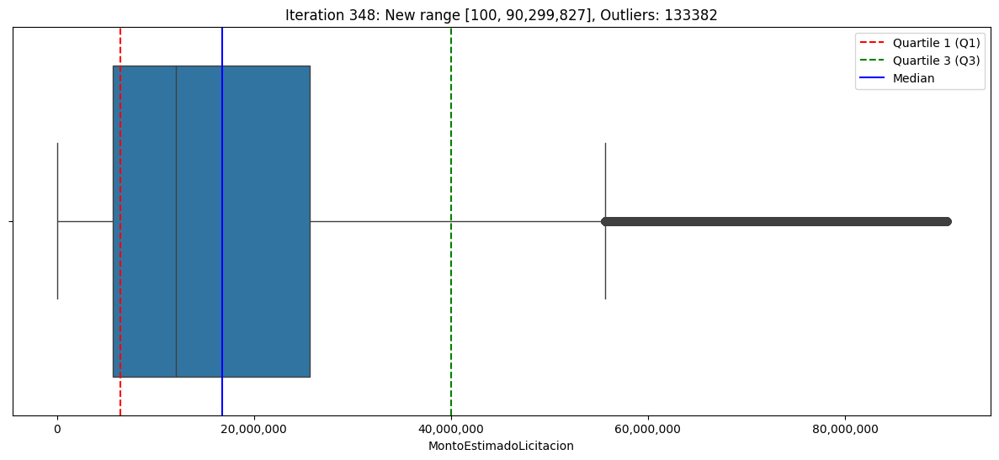

Iteration 348: New range [100, 90,299,827]


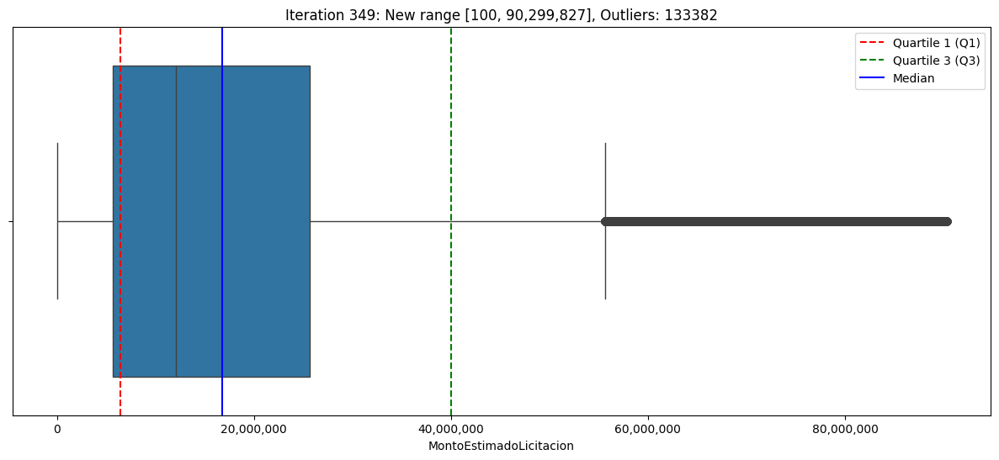

Iteration 349: New range [100, 90,299,827]


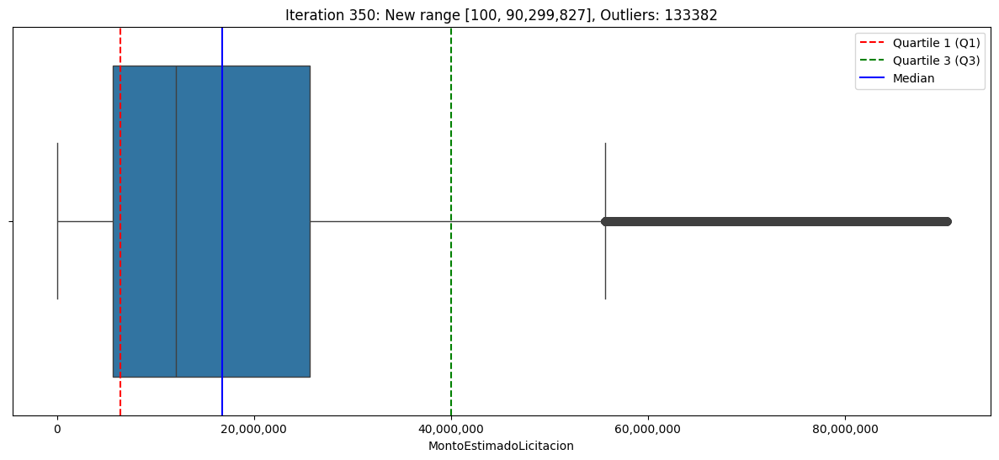

Iteration 350: New range [100, 90,299,827]


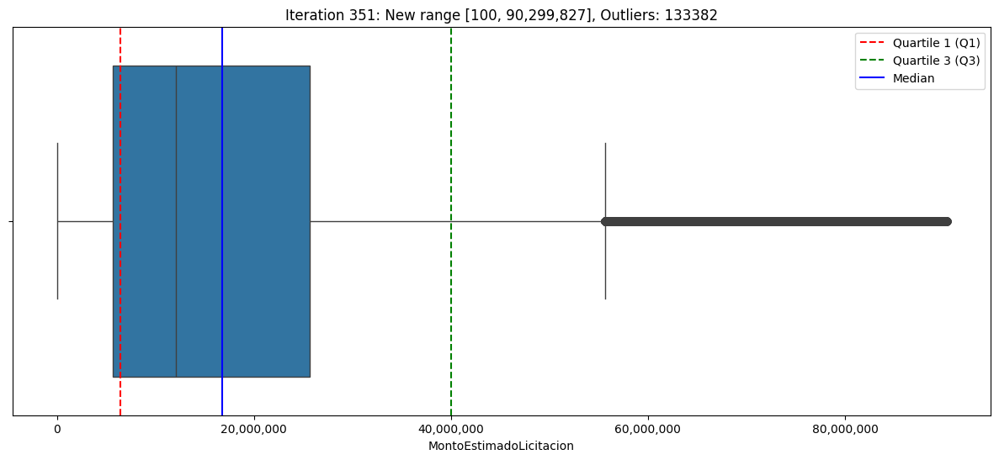

Iteration 351: New range [100, 90,299,827]


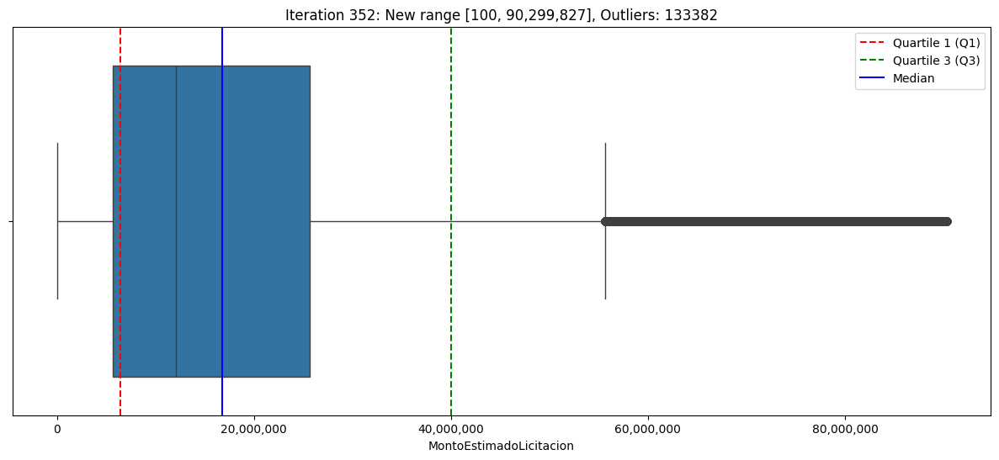

Iteration 352: New range [100, 90,299,827]


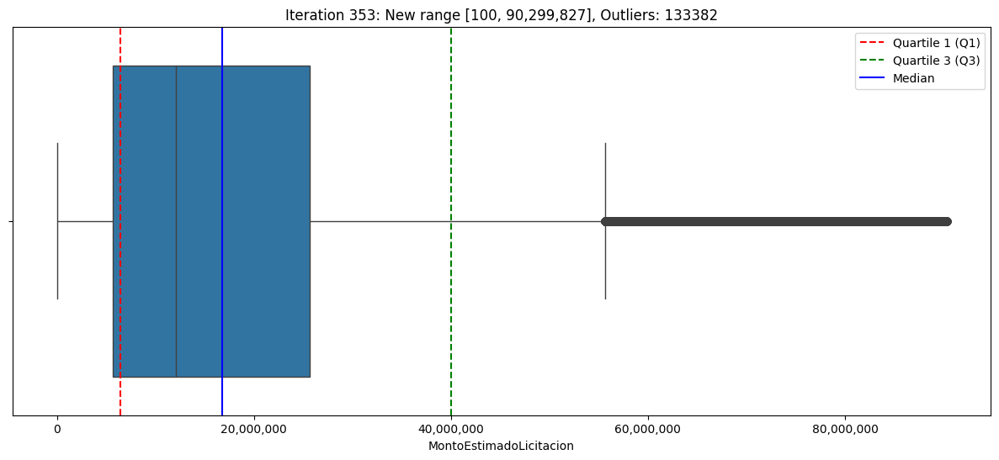

Iteration 353: New range [100, 90,299,827]


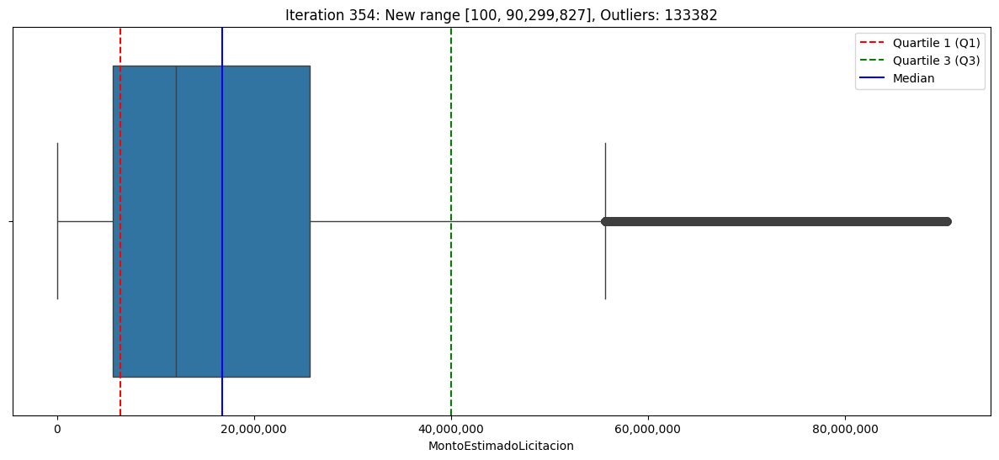

Iteration 354: New range [100, 90,299,827]


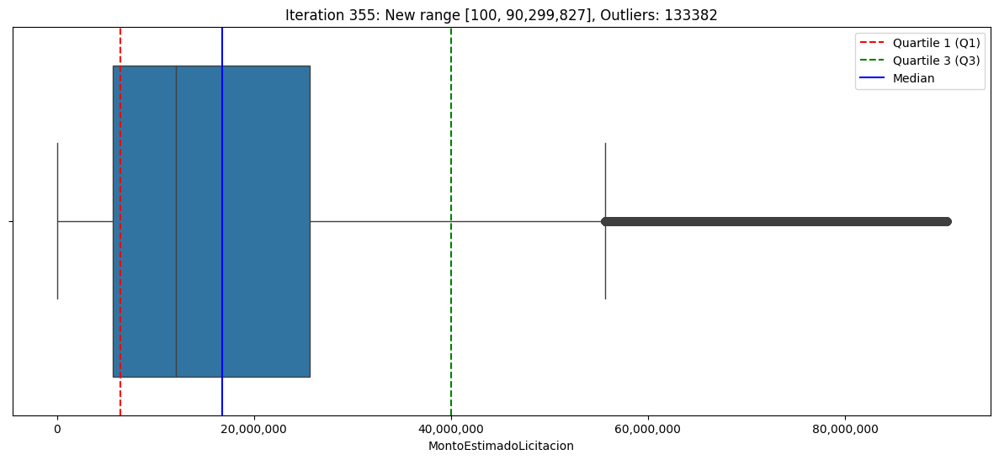

Iteration 355: New range [100, 90,299,827]


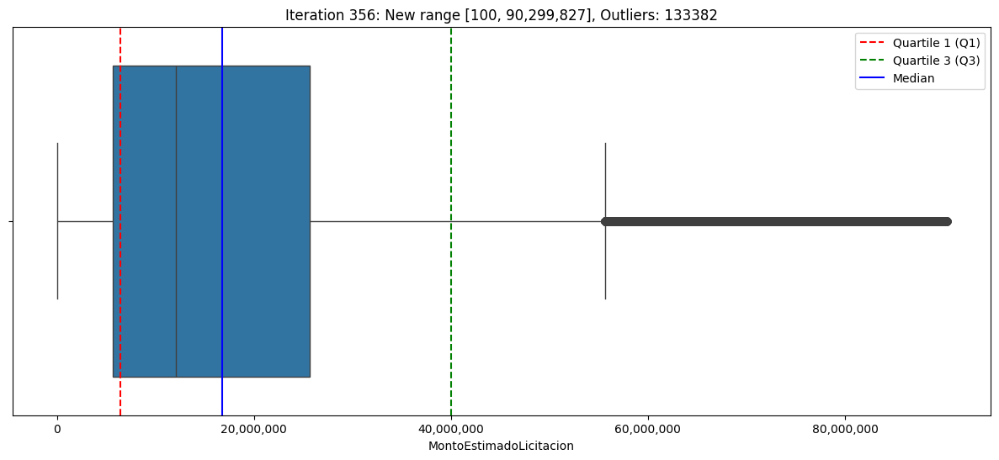

Iteration 356: New range [100, 90,299,827]


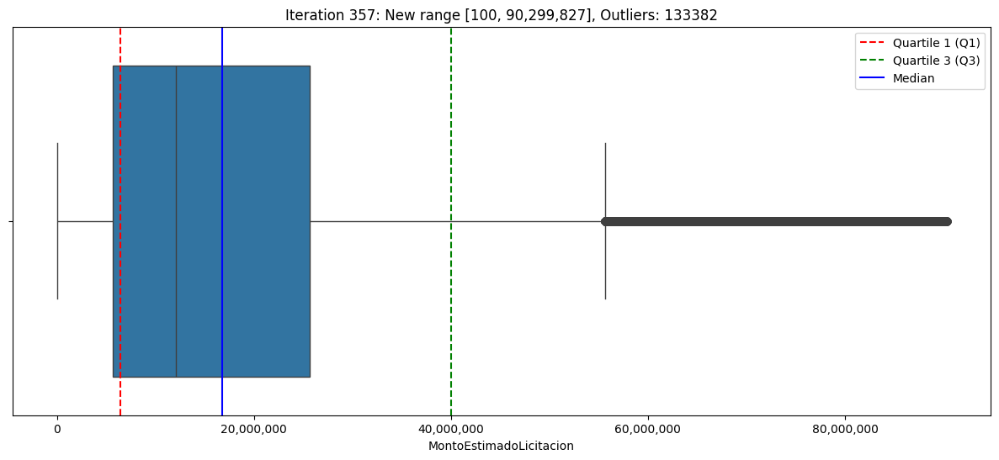

Iteration 357: New range [100, 90,299,827]


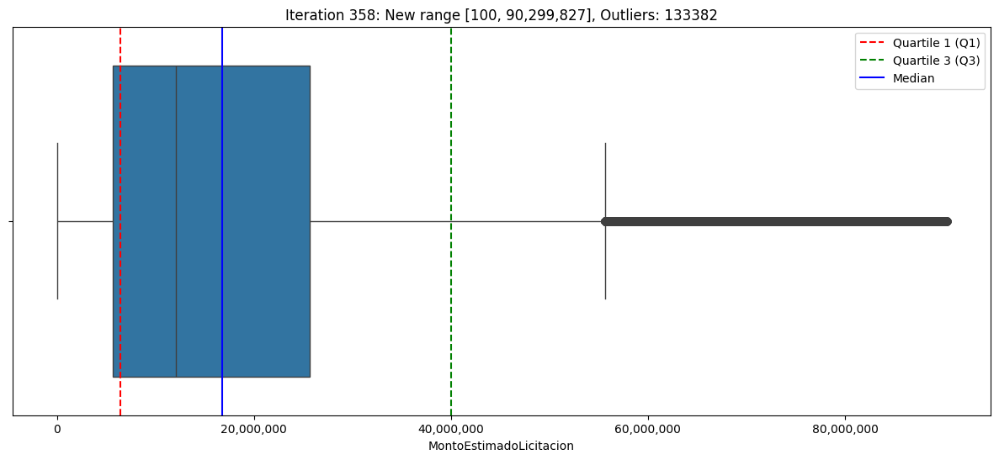

Iteration 358: New range [100, 90,299,827]


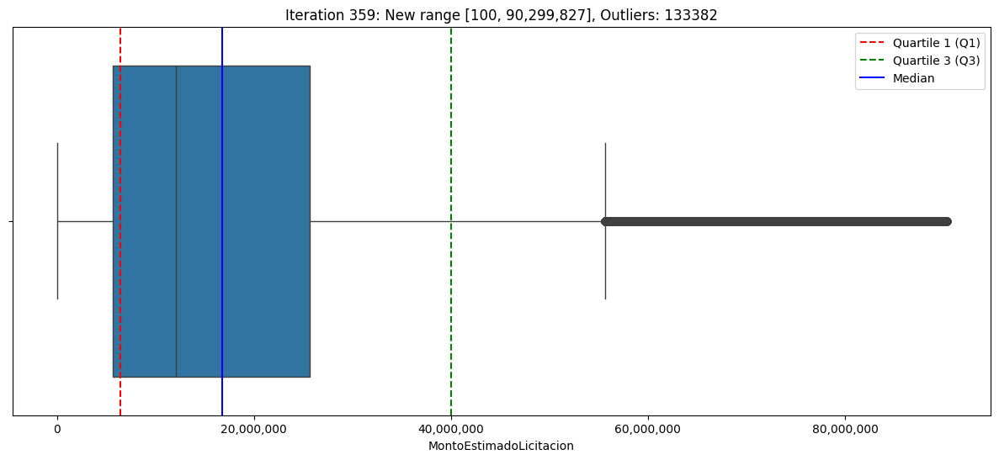

Iteration 359: New range [100, 90,299,827]


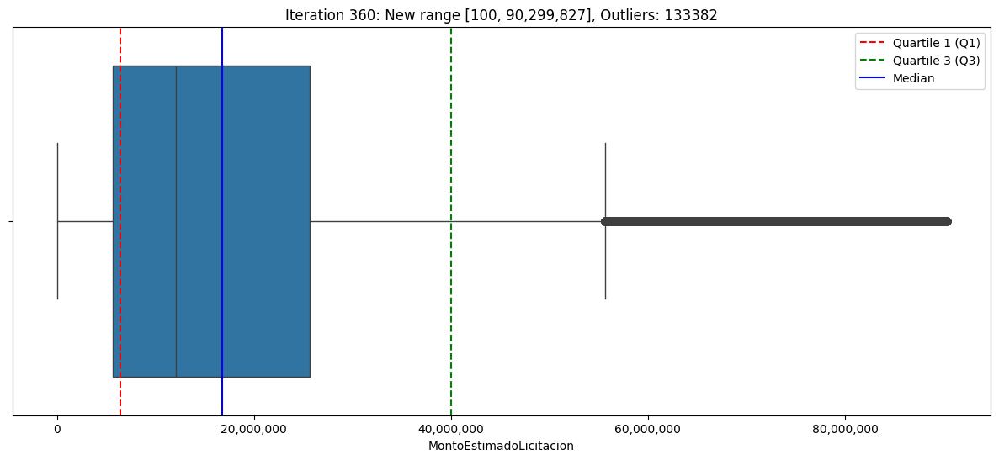

Iteration 360: New range [100, 90,299,827]


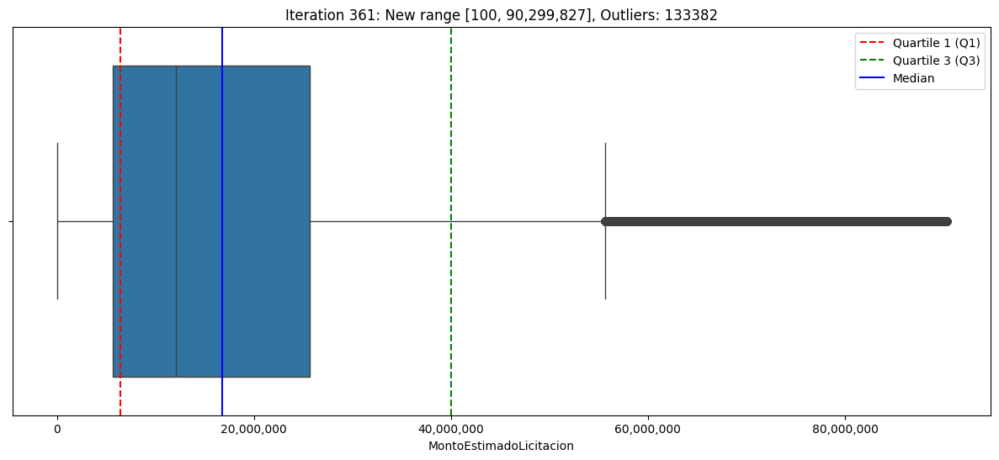

Iteration 361: New range [100, 90,299,827]


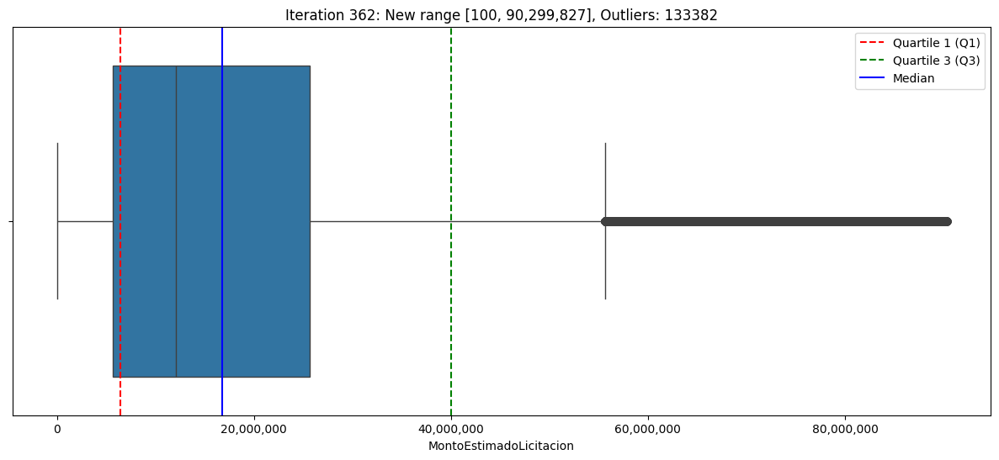

Iteration 362: New range [100, 90,299,827]


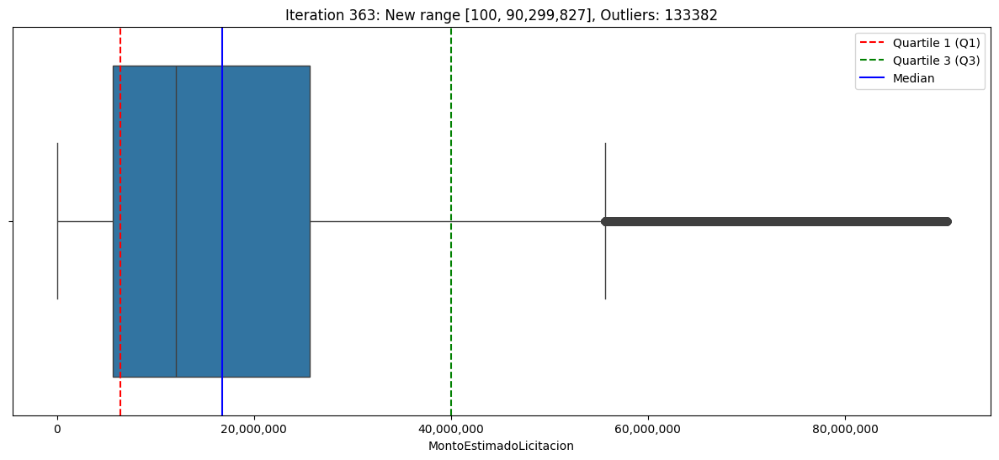

Iteration 363: New range [100, 90,299,827]


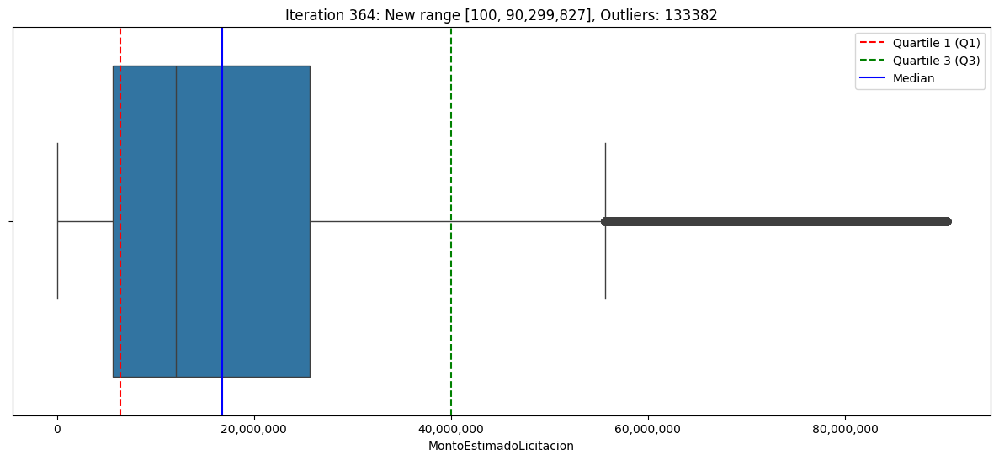

Iteration 364: New range [100, 90,299,827]


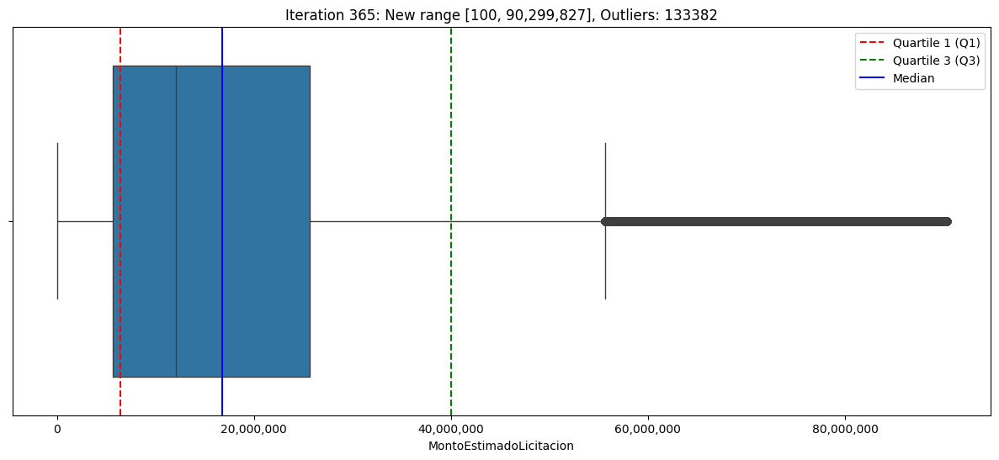

Iteration 365: New range [100, 90,299,827]


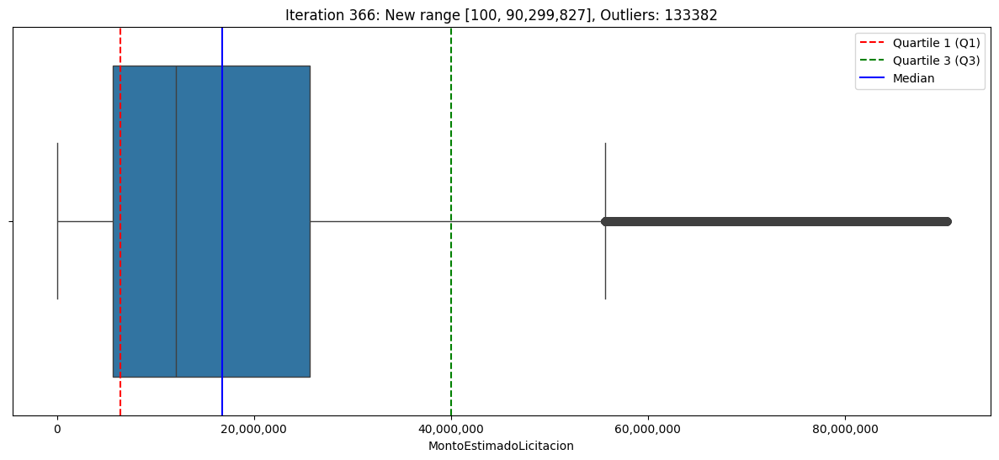

Iteration 366: New range [100, 90,299,827]


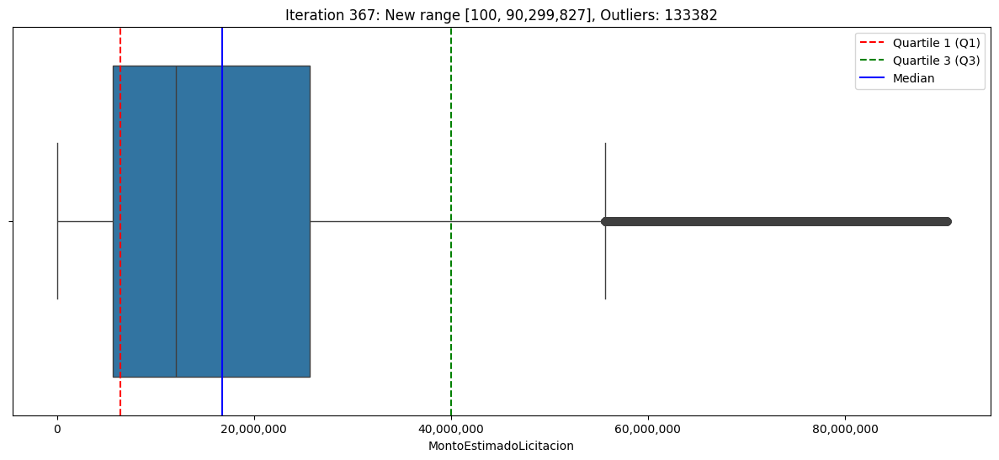

Iteration 367: New range [100, 90,299,827]


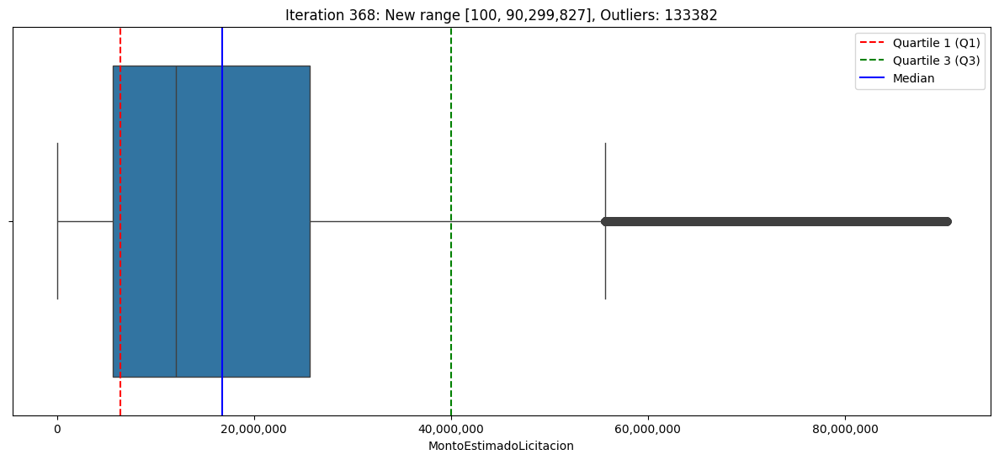

Iteration 368: New range [100, 90,299,827]


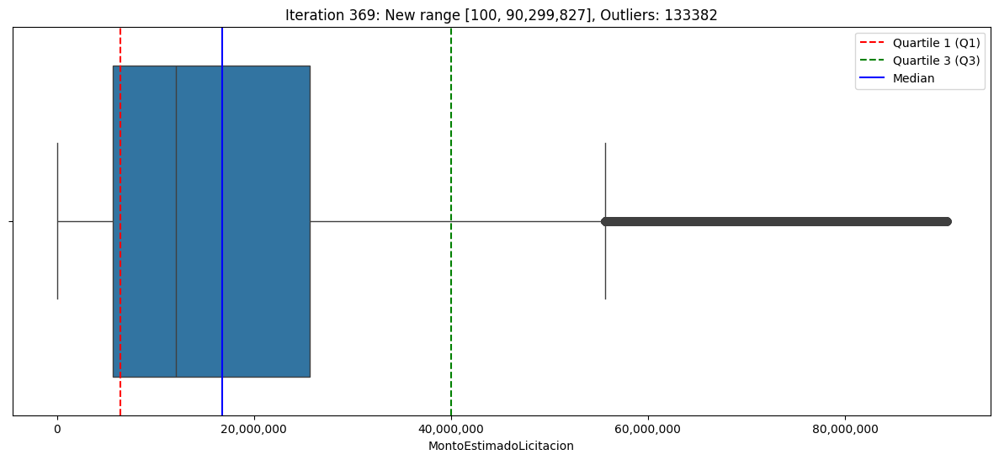

Iteration 369: New range [100, 90,299,827]


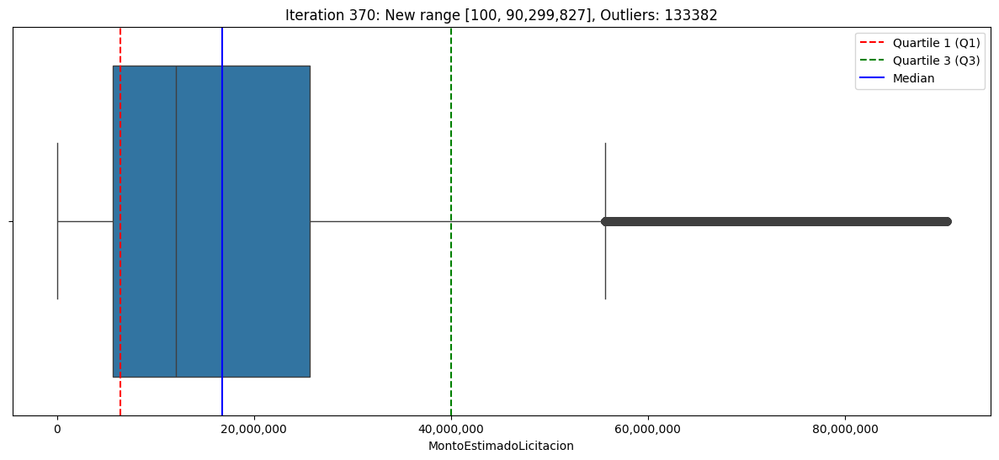

Iteration 370: New range [100, 90,299,827]


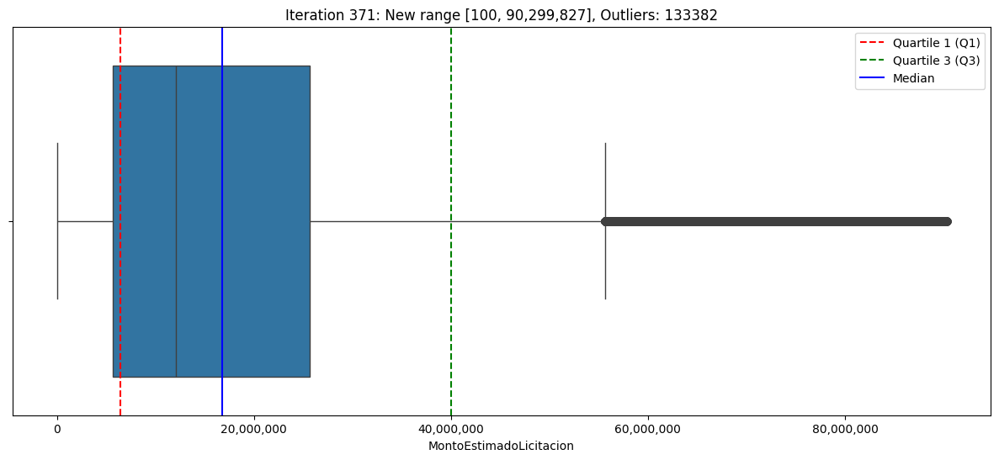

Iteration 371: New range [100, 90,299,827]


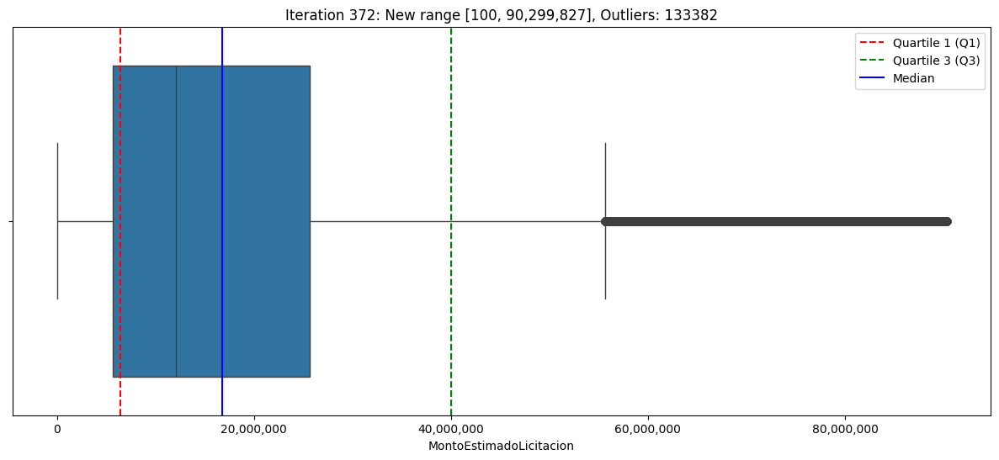

Iteration 372: New range [100, 90,299,827]


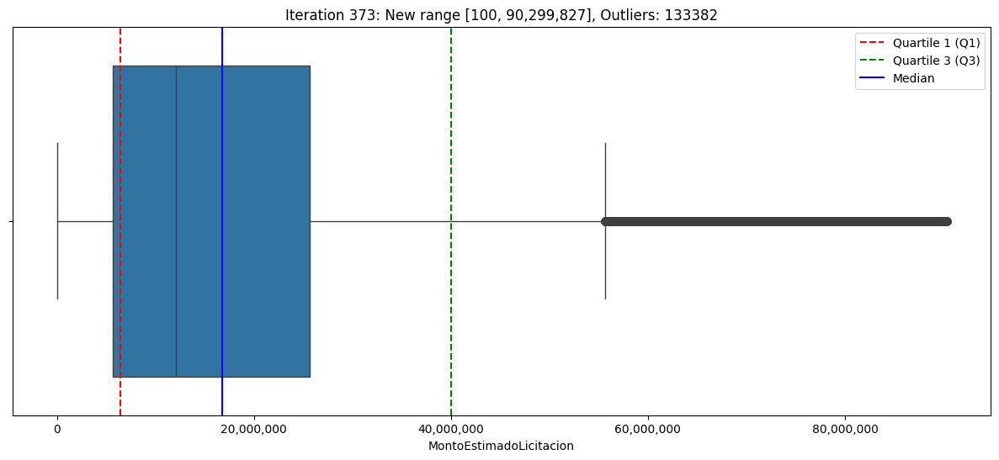

Iteration 373: New range [100, 90,299,827]


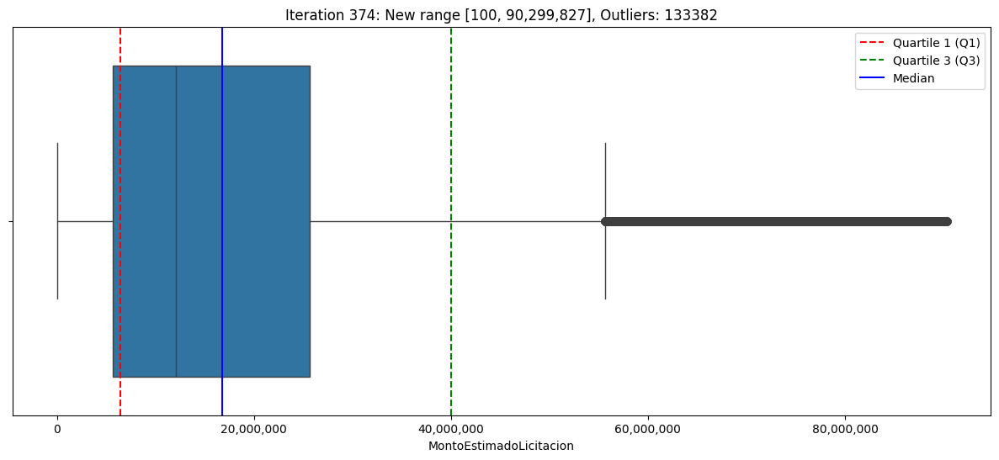

Iteration 374: New range [100, 90,299,827]


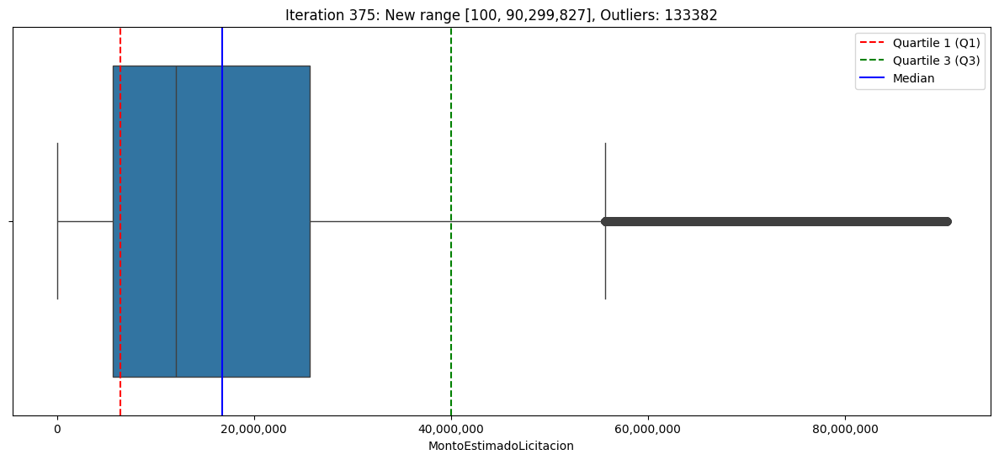

Iteration 375: New range [100, 90,299,827]


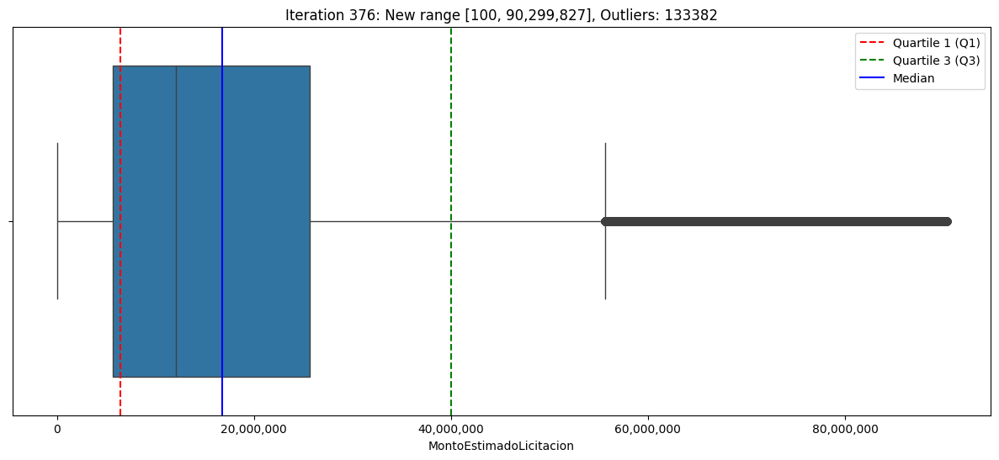

Iteration 376: New range [100, 90,299,827]


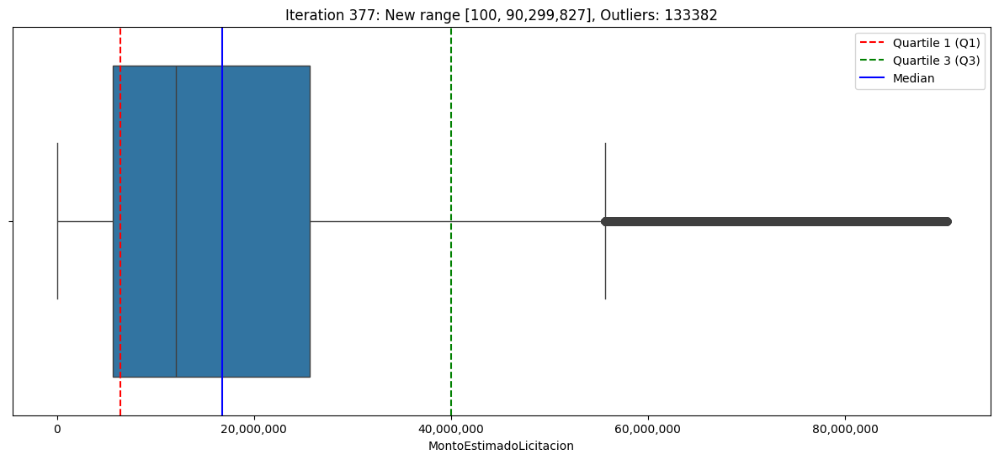

Iteration 377: New range [100, 90,299,827]


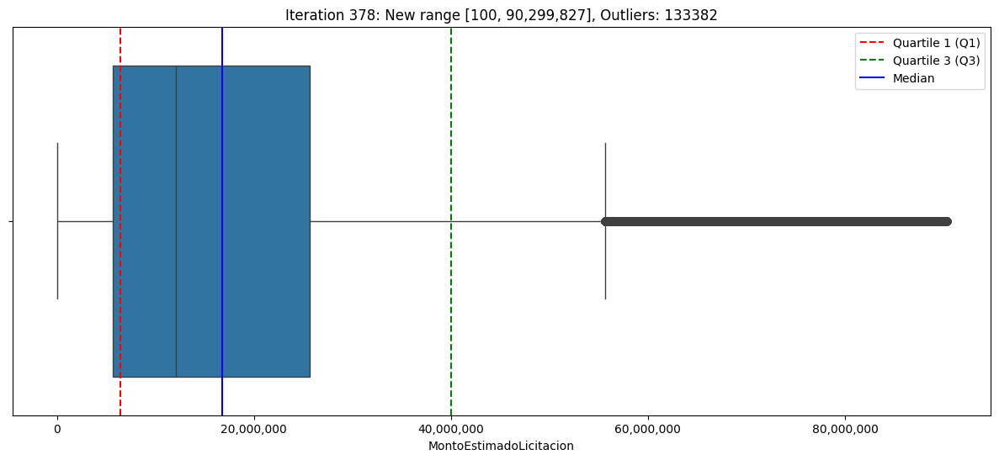

Iteration 378: New range [100, 90,299,827]


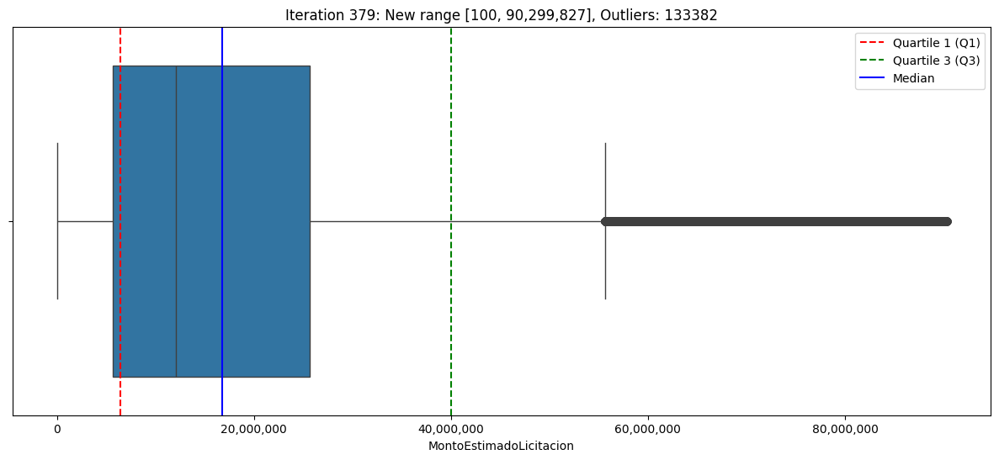

Iteration 379: New range [100, 90,299,827]


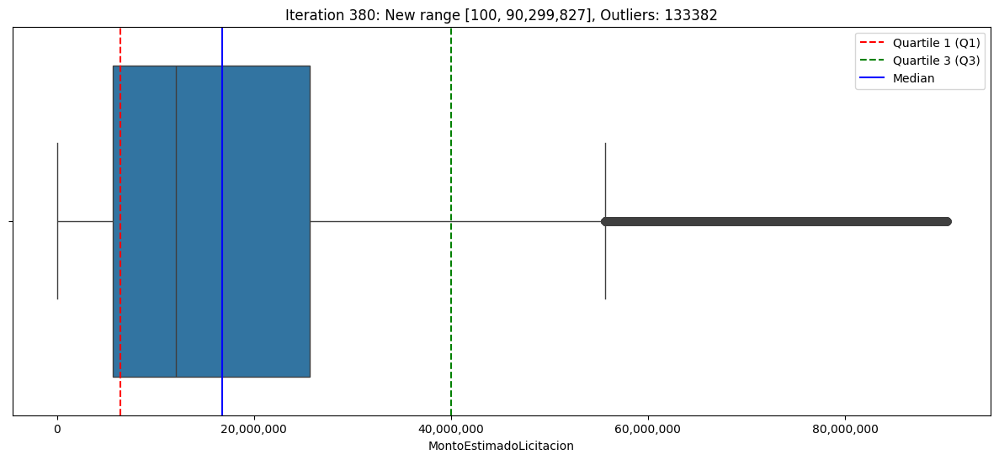

Iteration 380: New range [100, 90,299,827]


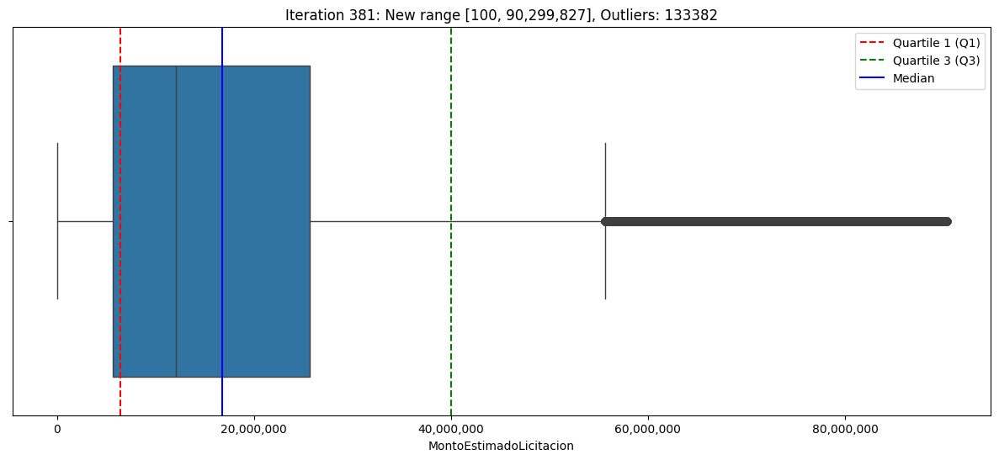

Iteration 381: New range [100, 90,299,827]


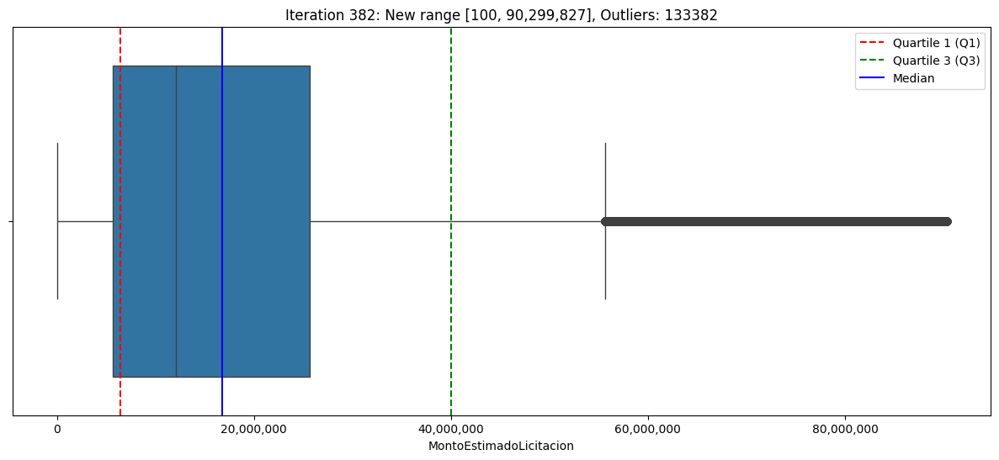

Iteration 382: New range [100, 90,299,827]


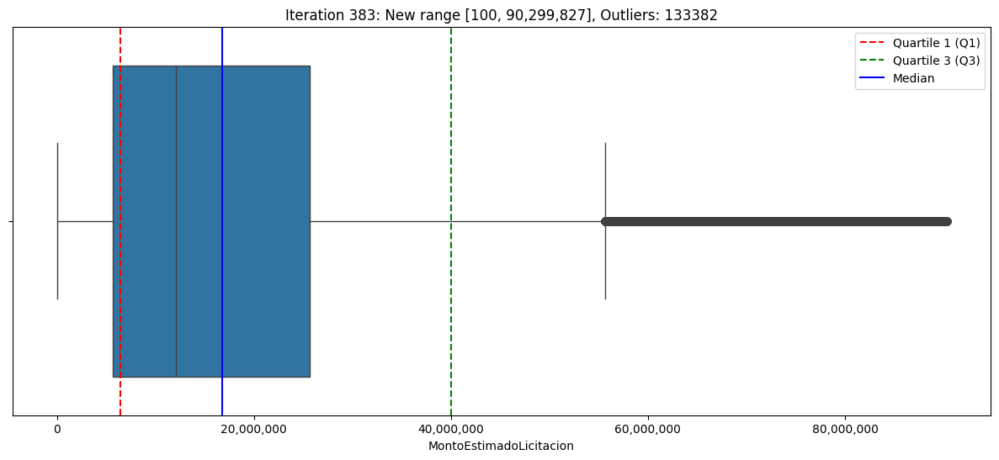

Iteration 383: New range [100, 90,299,827]


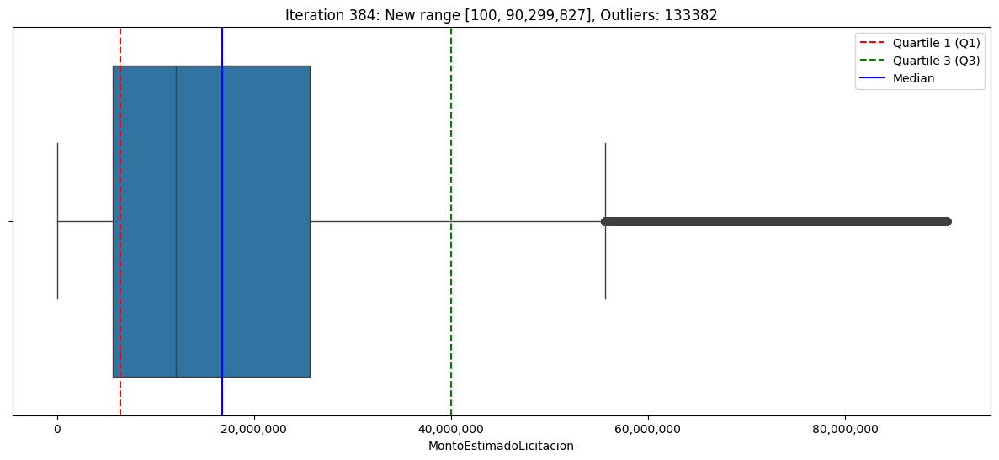

Iteration 384: New range [100, 90,299,827]


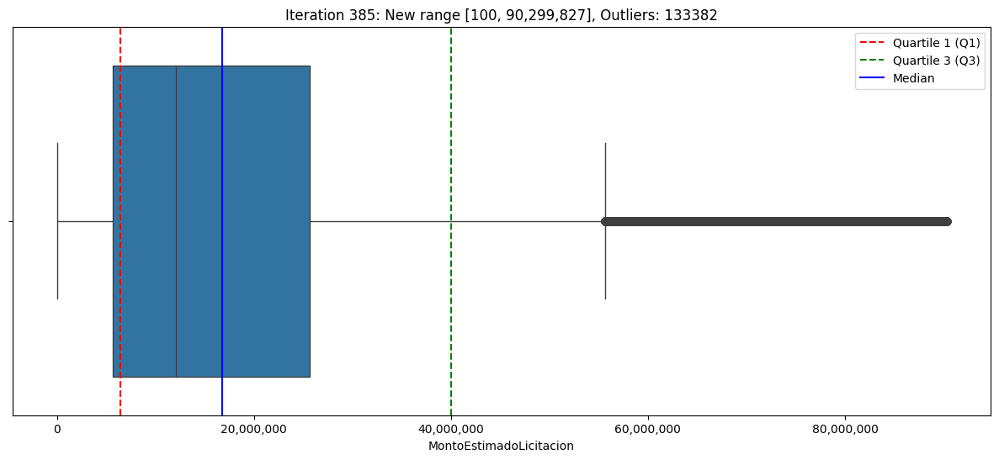

Iteration 385: New range [100, 90,299,827]


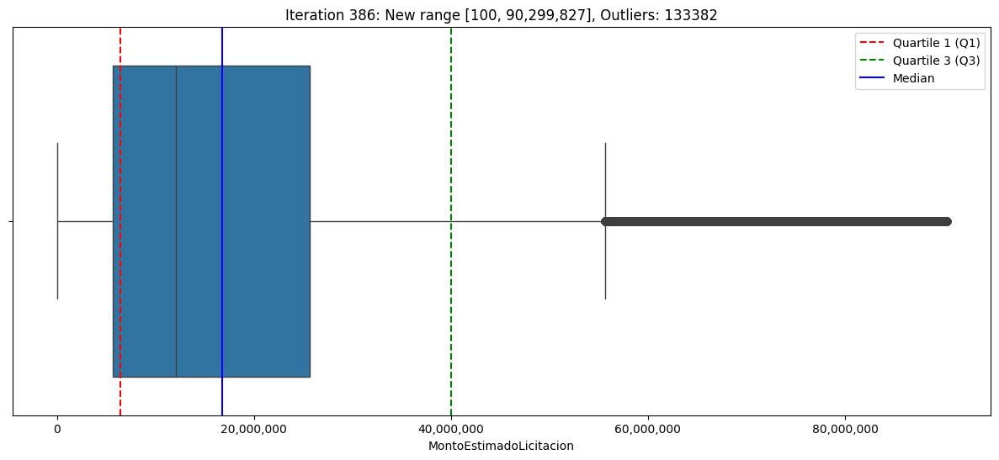

Iteration 386: New range [100, 90,299,827]


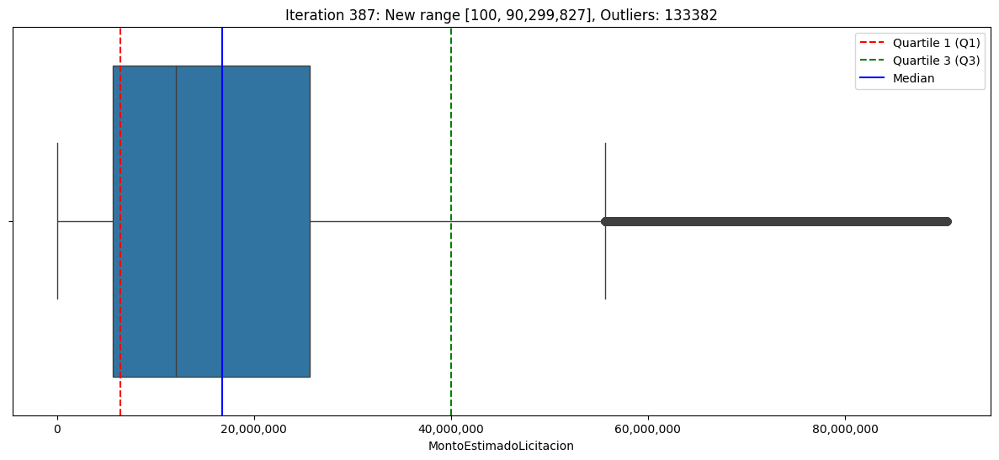

Iteration 387: New range [100, 90,299,827]


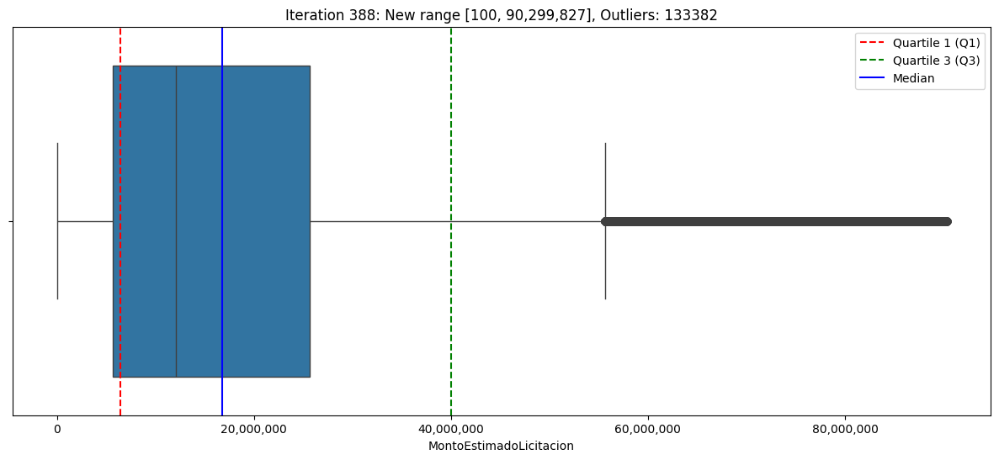

Iteration 388: New range [100, 90,299,827]


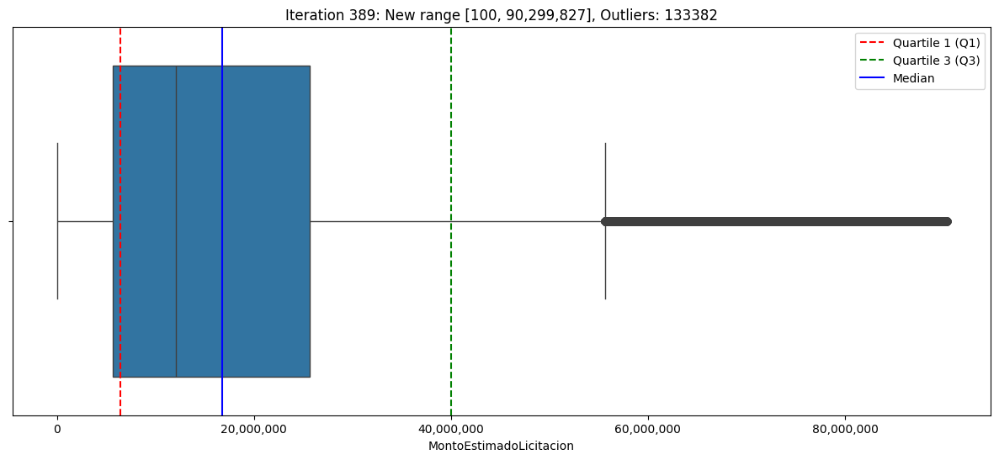

Iteration 389: New range [100, 90,299,827]


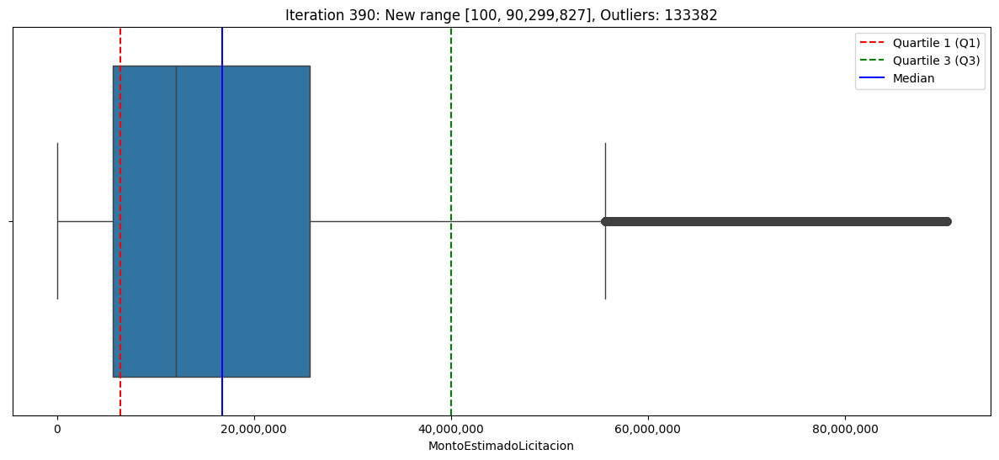

Iteration 390: New range [100, 90,299,827]


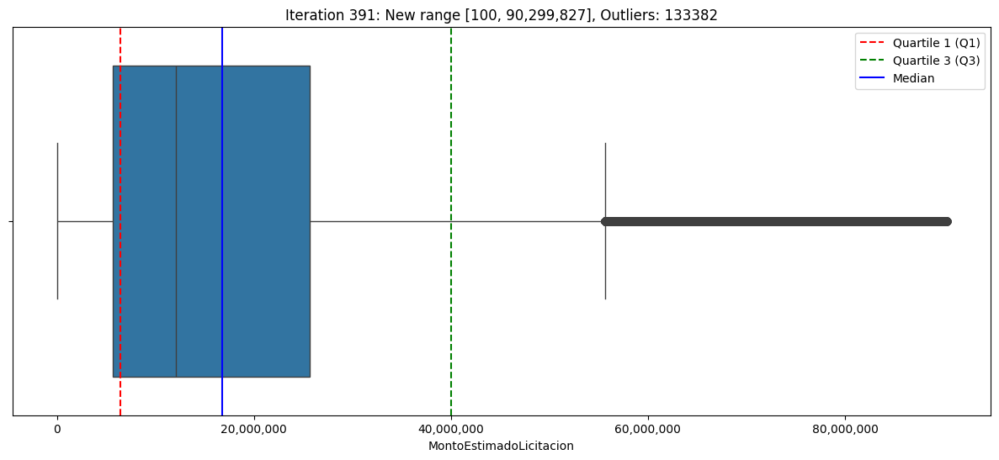

Iteration 391: New range [100, 90,299,827]


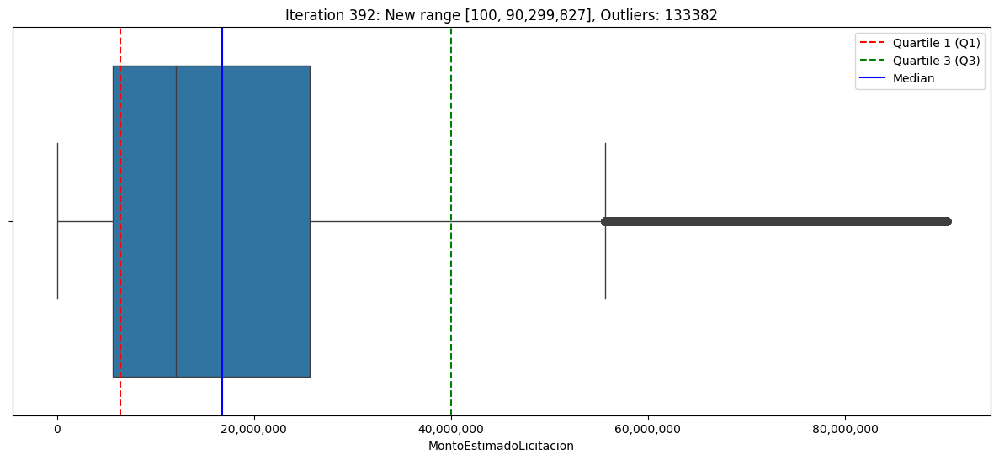

Iteration 392: New range [100, 90,299,827]


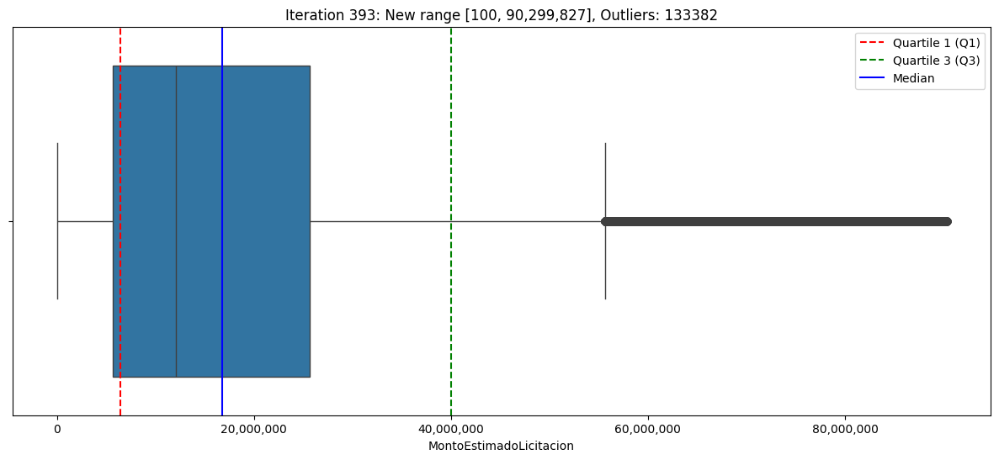

Iteration 393: New range [100, 90,299,827]


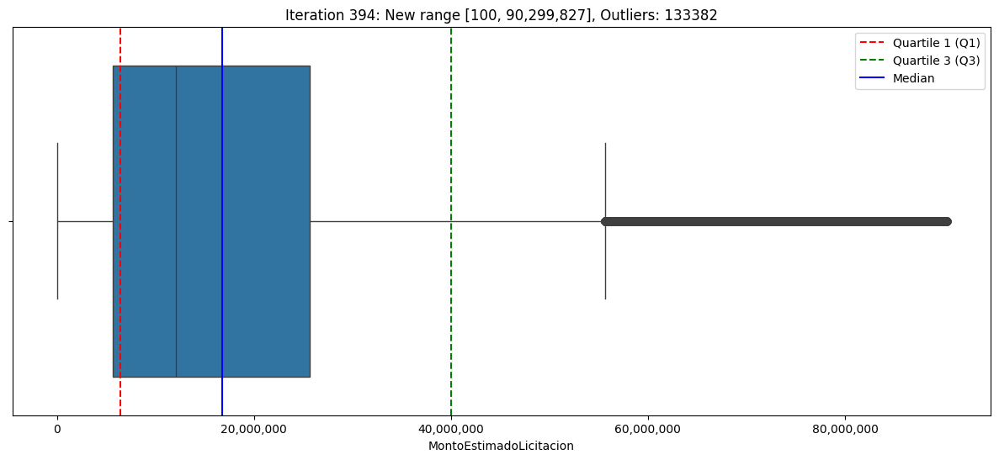

Iteration 394: New range [100, 90,299,827]


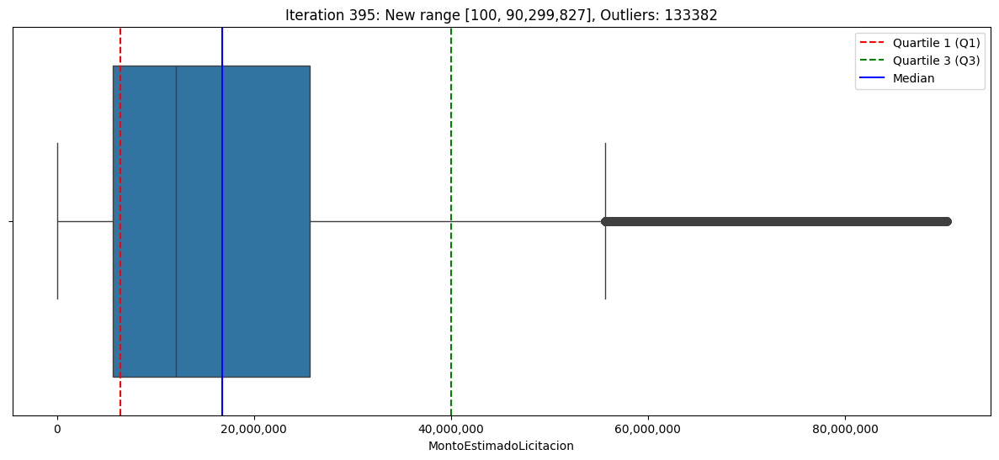

Iteration 395: New range [100, 90,299,827]


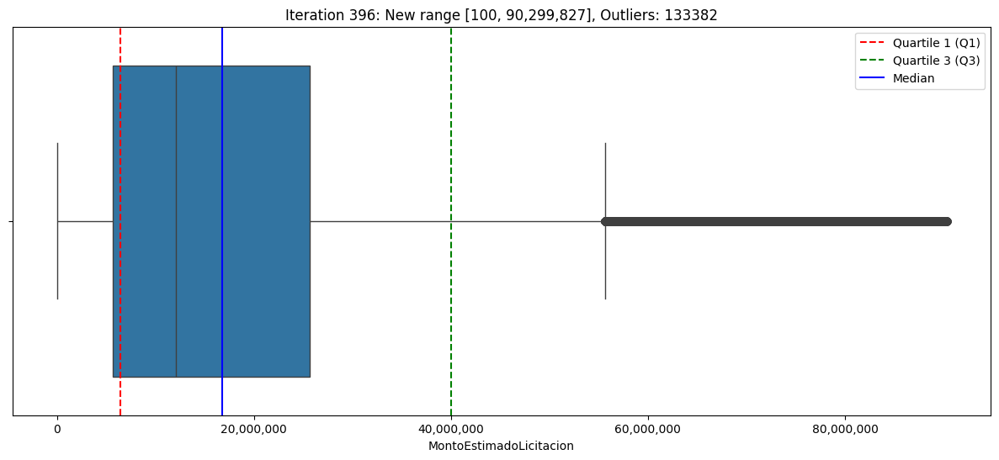

Iteration 396: New range [100, 90,299,827]


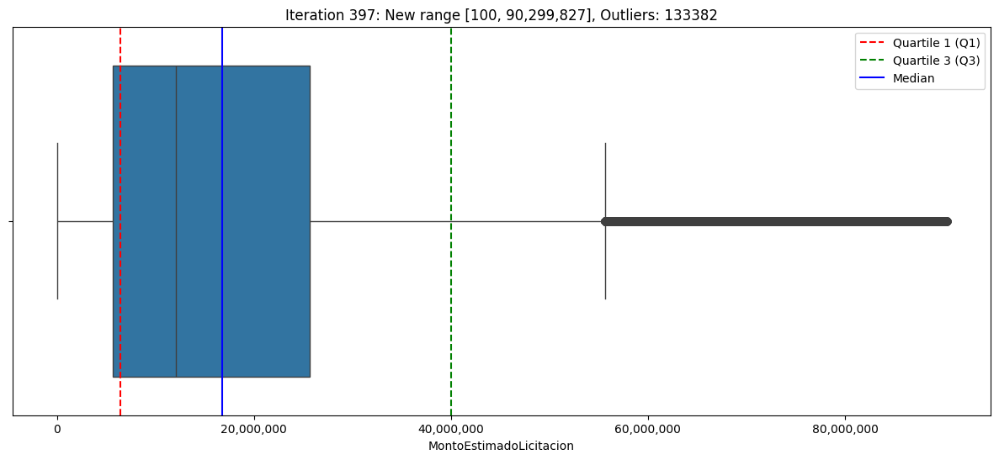

Iteration 397: New range [100, 90,299,827]


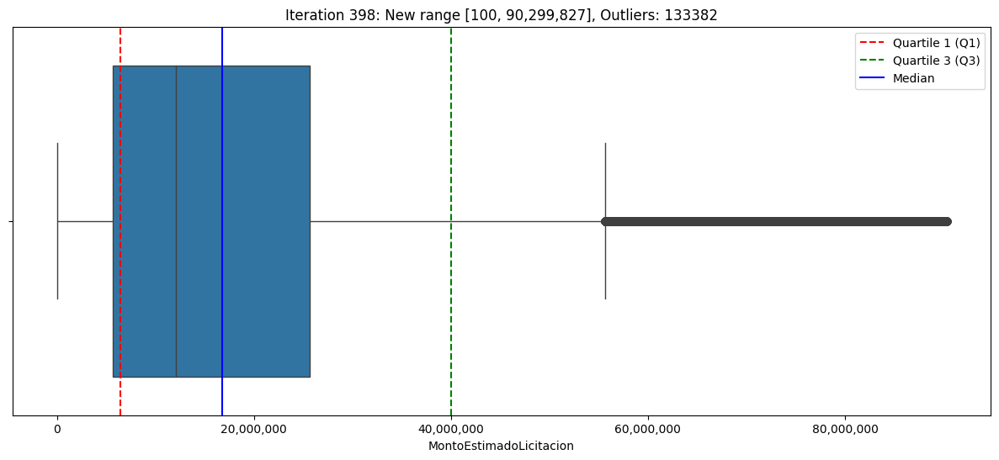

Iteration 398: New range [100, 90,299,827]


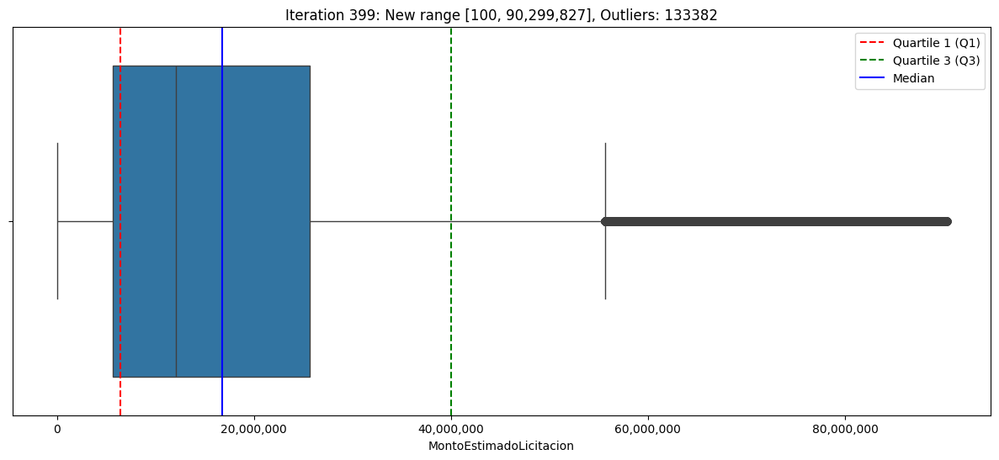

Iteration 399: New range [100, 90,299,827]


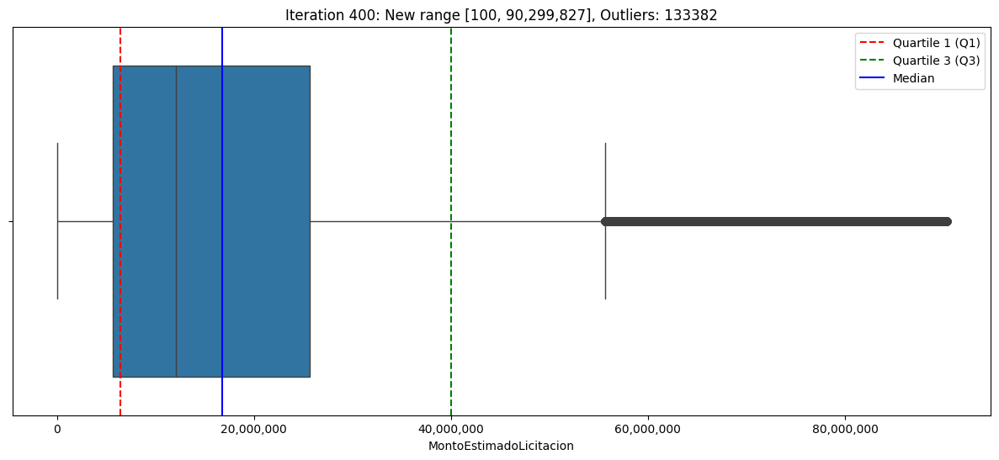

Iteration 400: New range [100, 90,299,827]


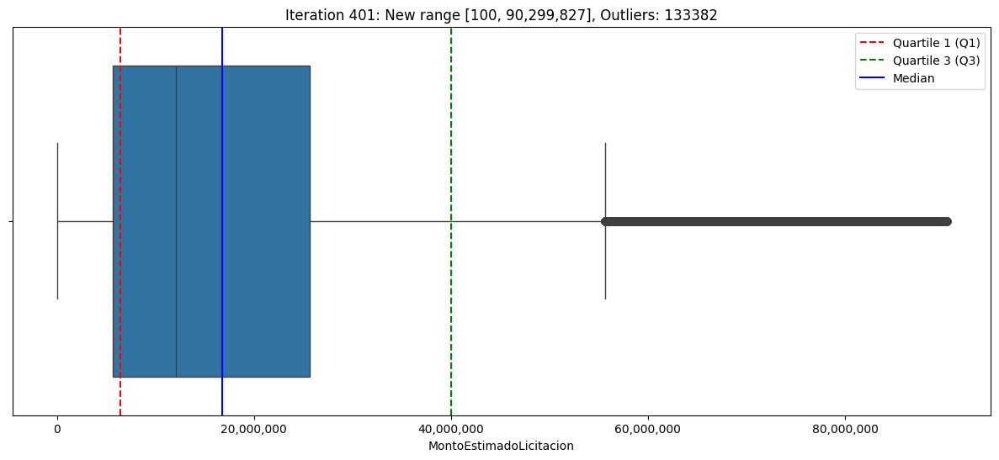

Iteration 401: New range [100, 90,299,827]


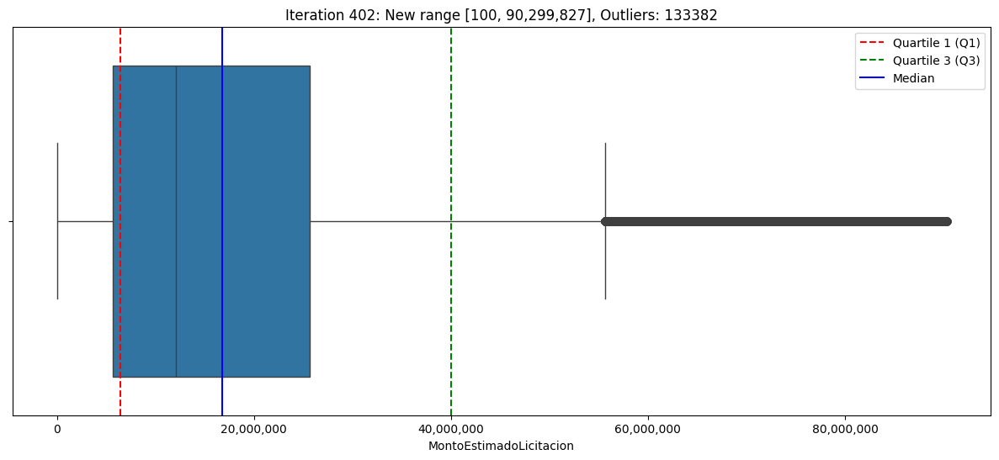

Iteration 402: New range [100, 90,299,827]


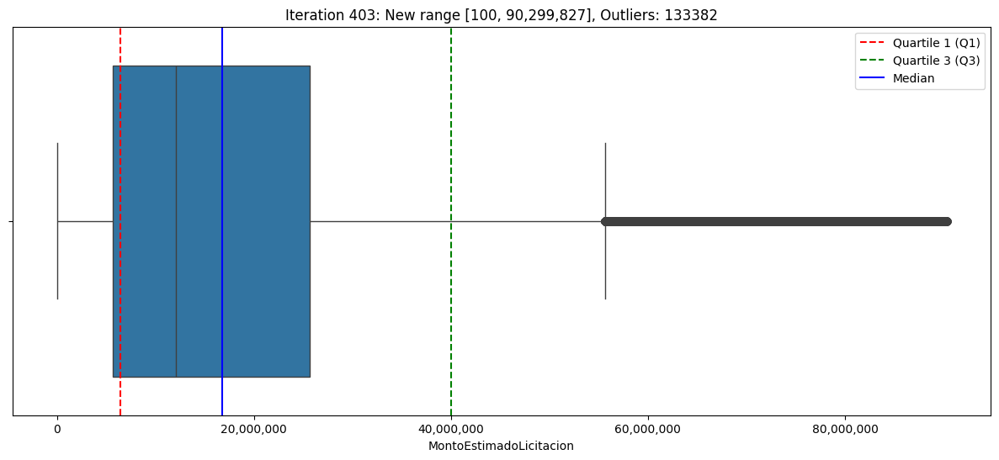

Iteration 403: New range [100, 90,299,827]


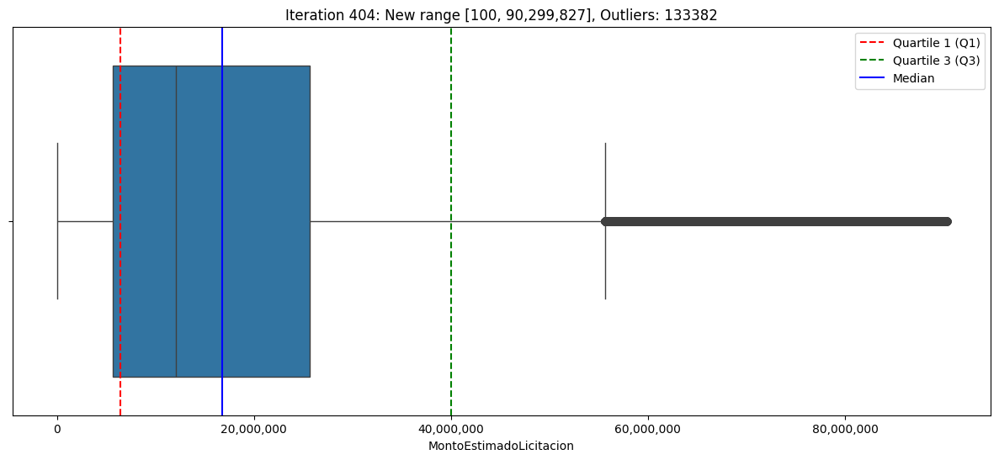

Iteration 404: New range [100, 90,299,827]


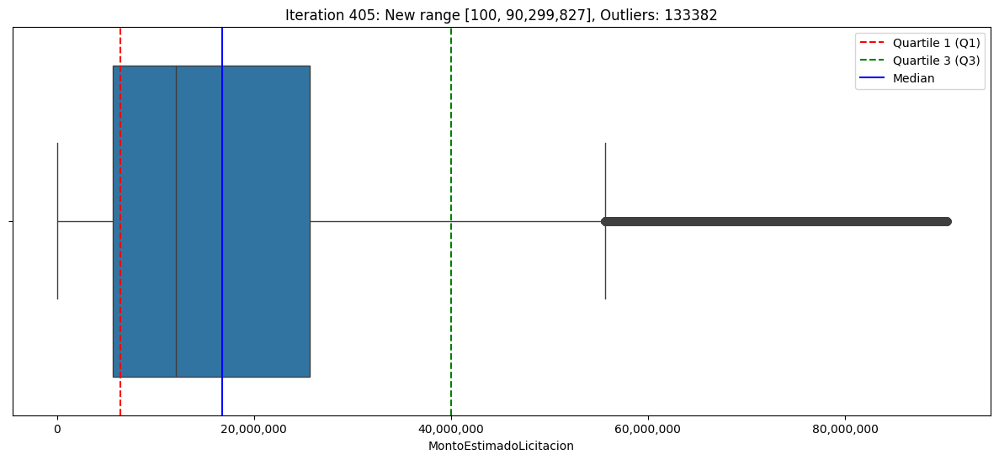

Iteration 405: New range [100, 90,299,827]


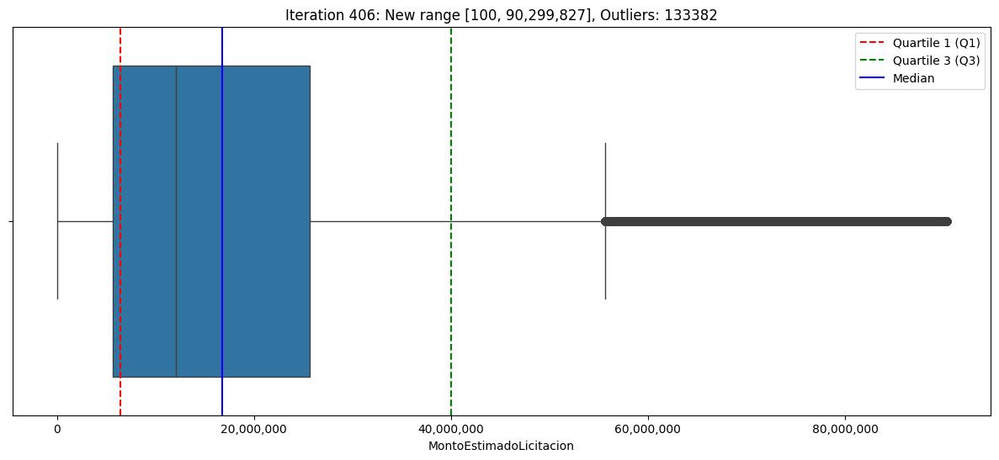

Iteration 406: New range [100, 90,299,827]


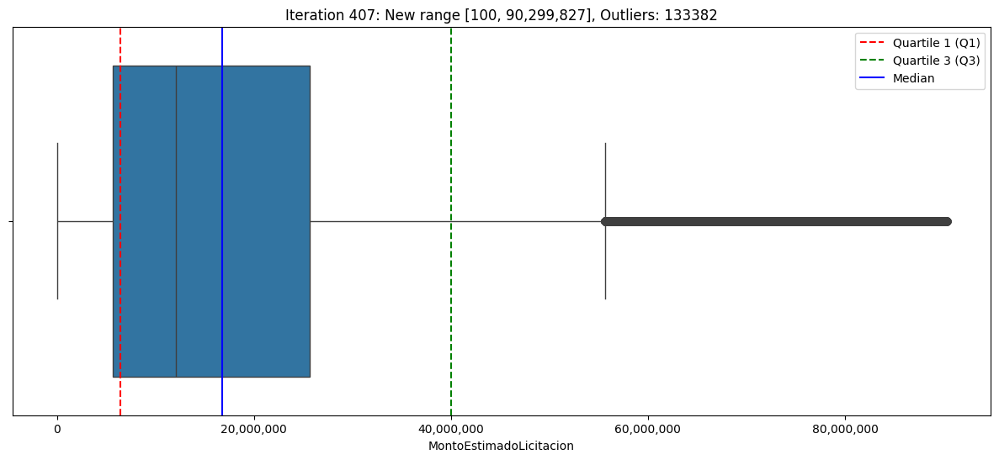

Iteration 407: New range [100, 90,299,827]


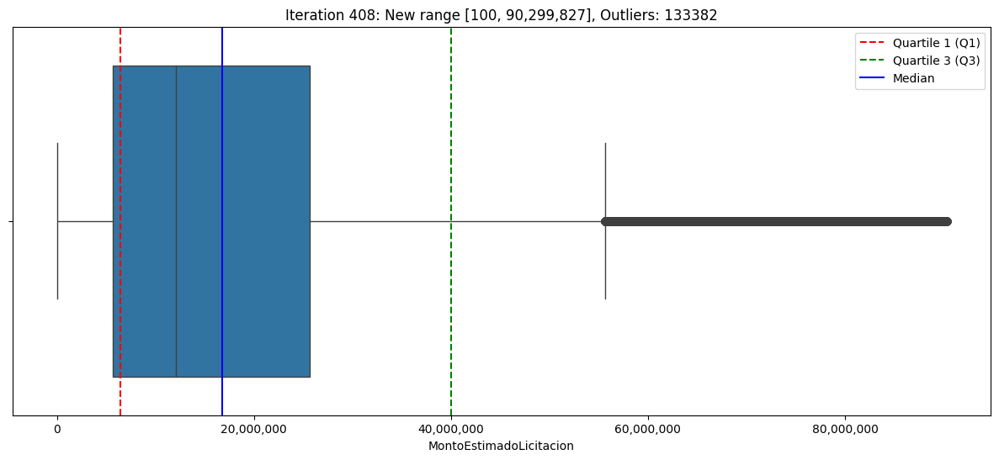

Iteration 408: New range [100, 90,299,827]


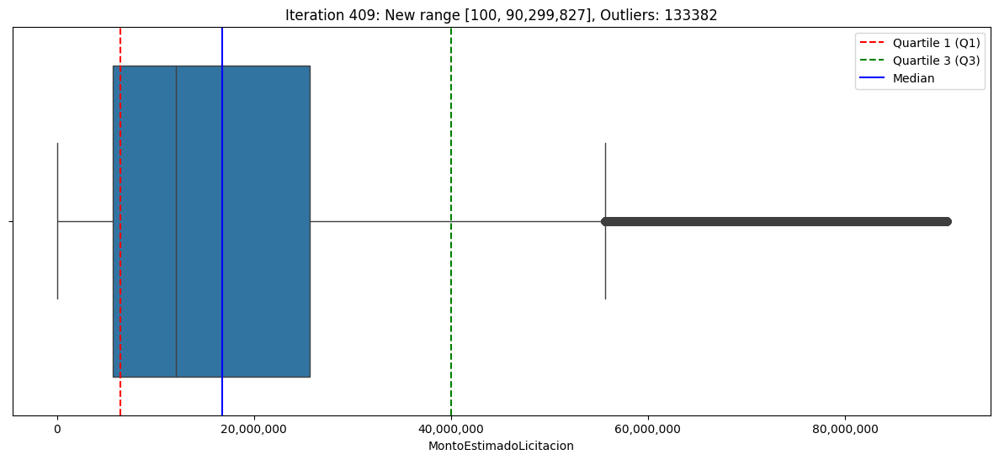

Iteration 409: New range [100, 90,299,827]


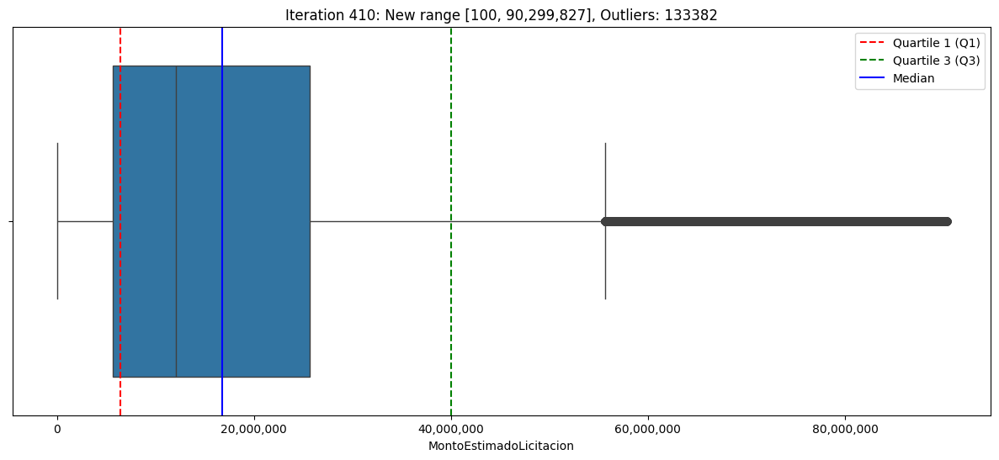

Iteration 410: New range [100, 90,299,827]


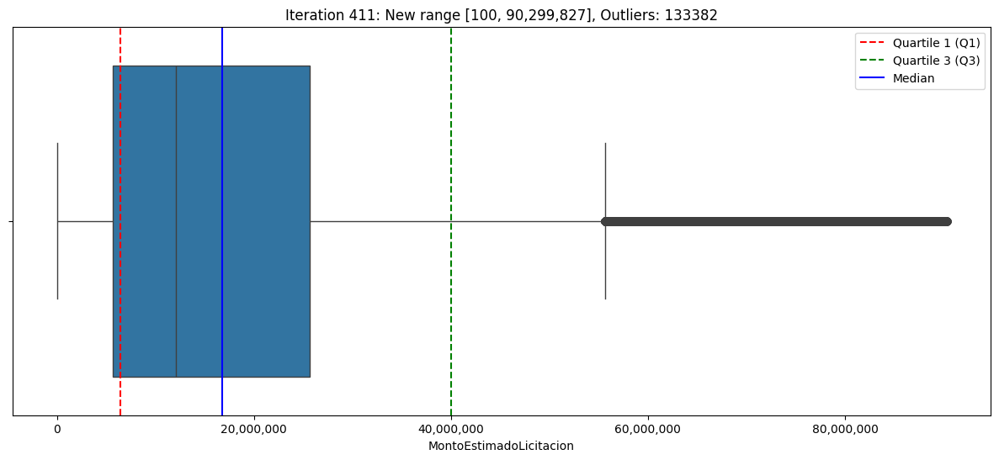

Iteration 411: New range [100, 90,299,827]


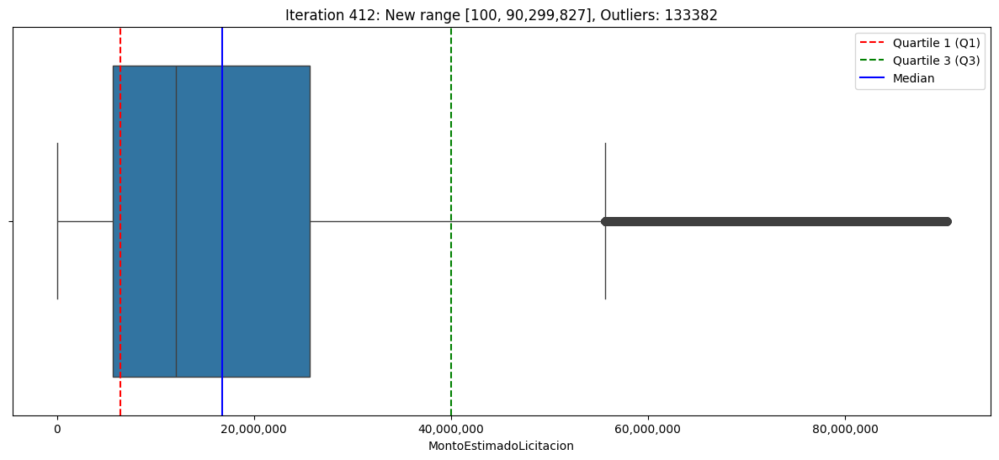

Iteration 412: New range [100, 90,299,827]


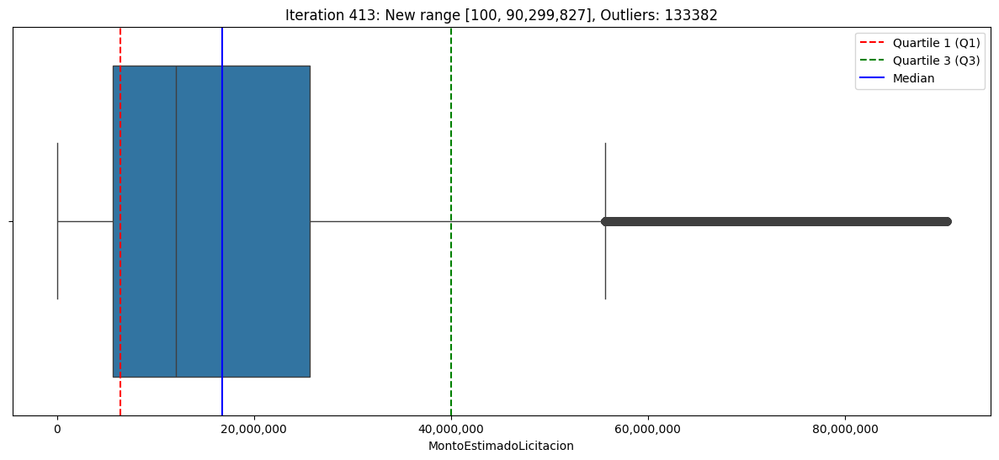

Iteration 413: New range [100, 90,299,827]


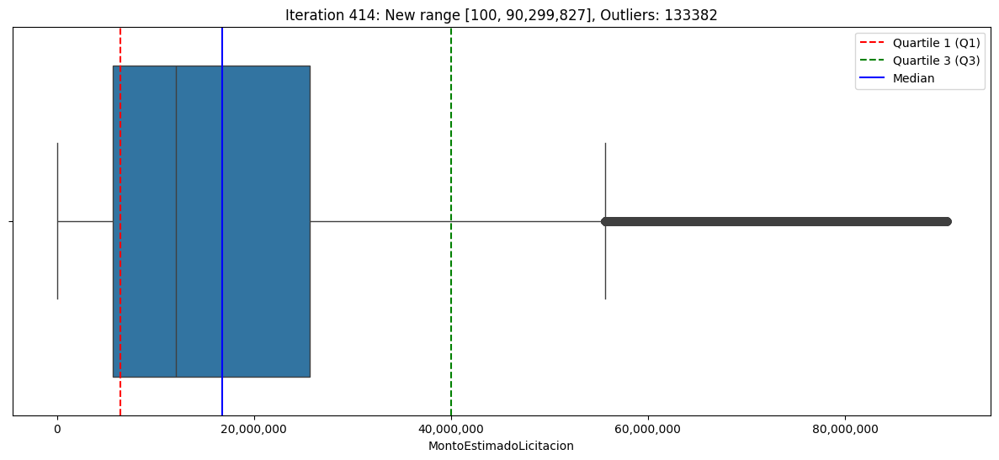

Iteration 414: New range [100, 90,299,827]


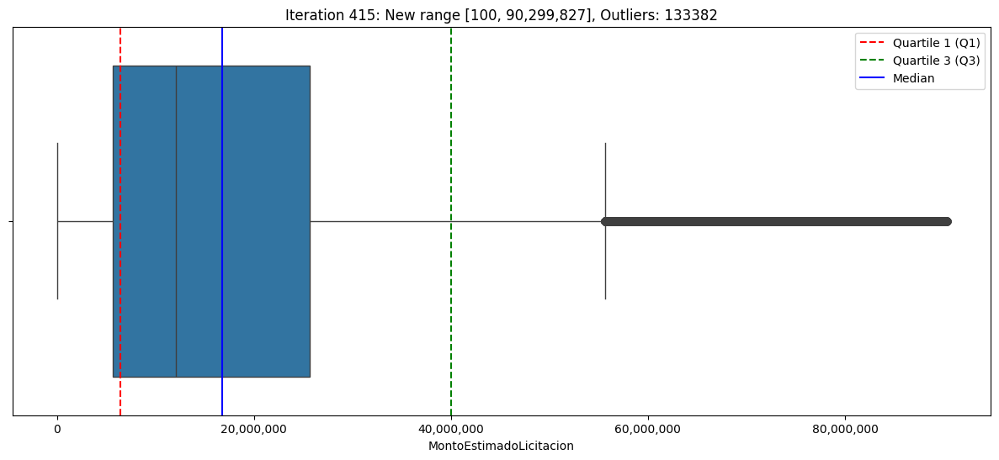

Iteration 415: New range [100, 90,299,827]


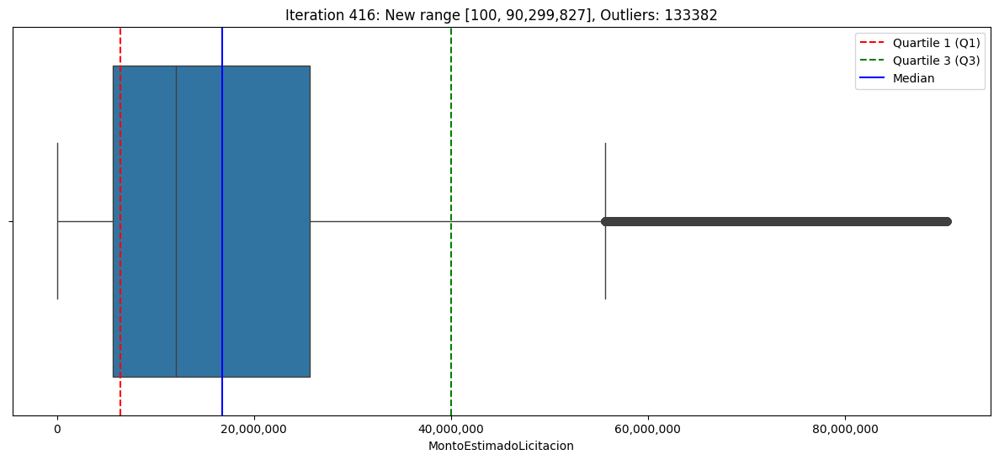

Iteration 416: New range [100, 90,299,827]


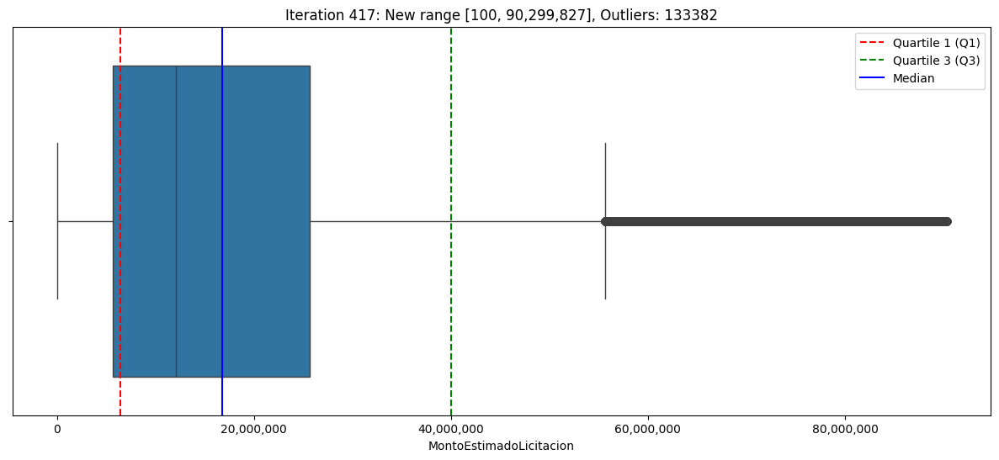

Iteration 417: New range [100, 90,299,827]


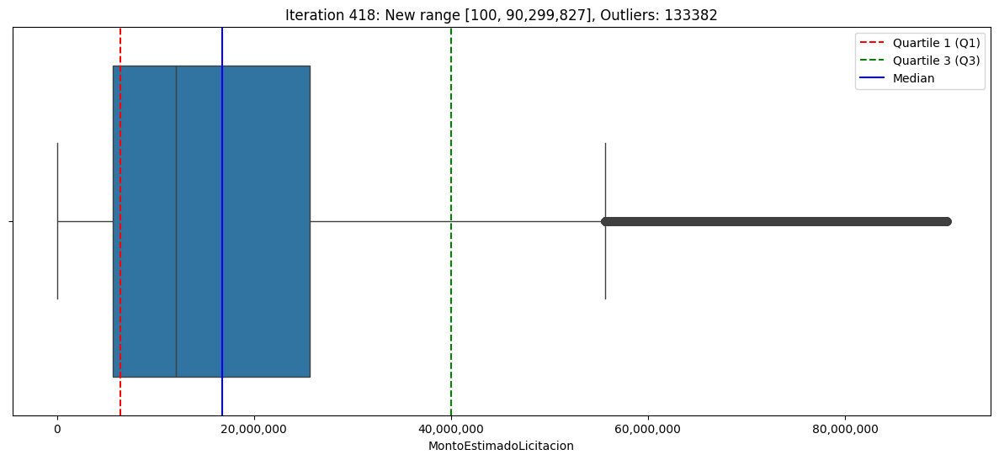

Iteration 418: New range [100, 90,299,827]


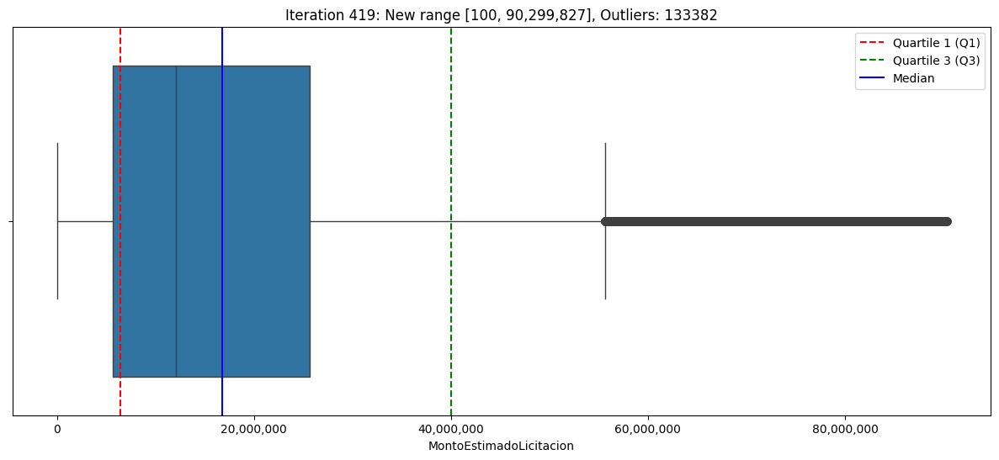

Iteration 419: New range [100, 90,299,827]


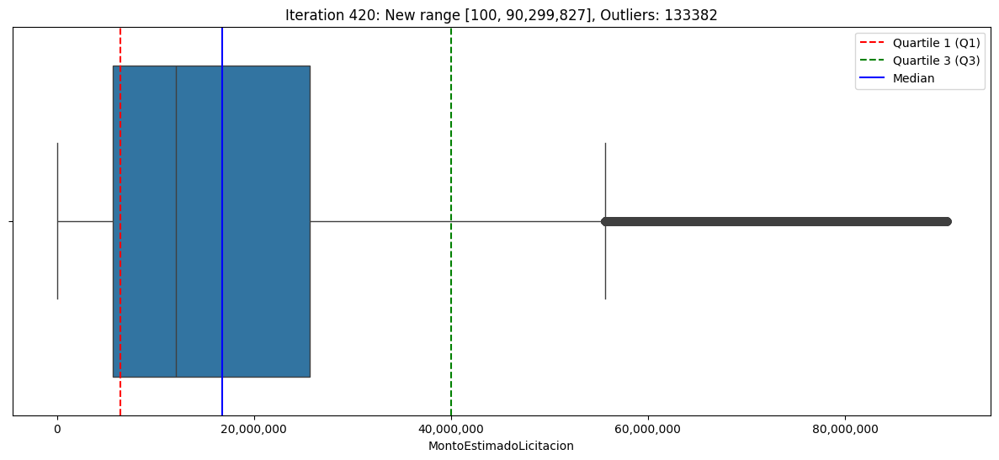

Iteration 420: New range [100, 90,299,827]


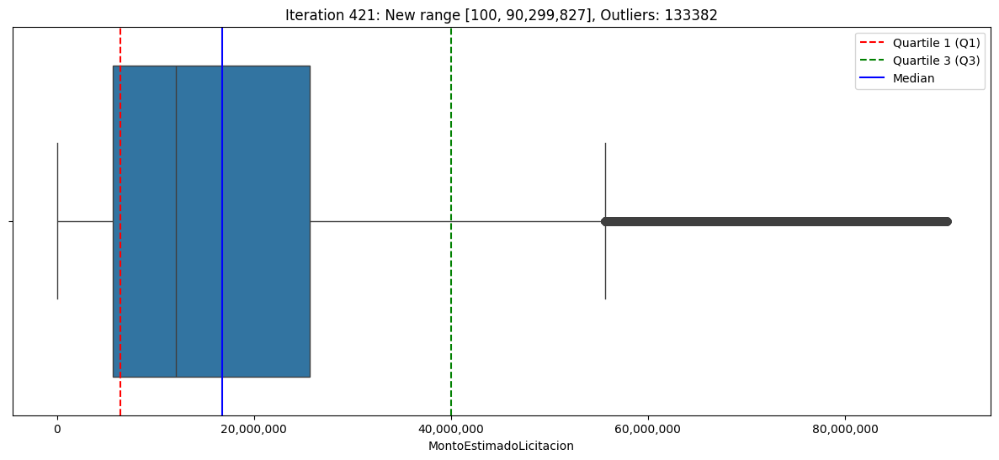

Iteration 421: New range [100, 90,299,827]


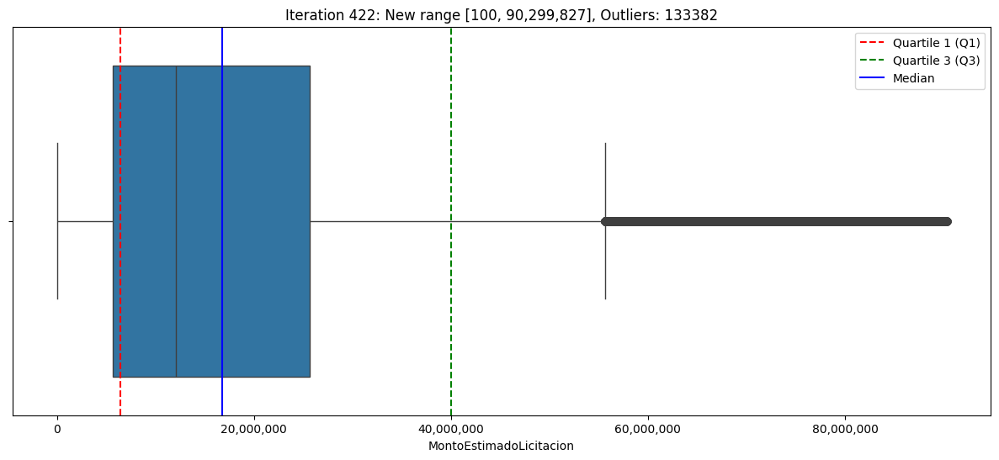

Iteration 422: New range [100, 90,299,827]


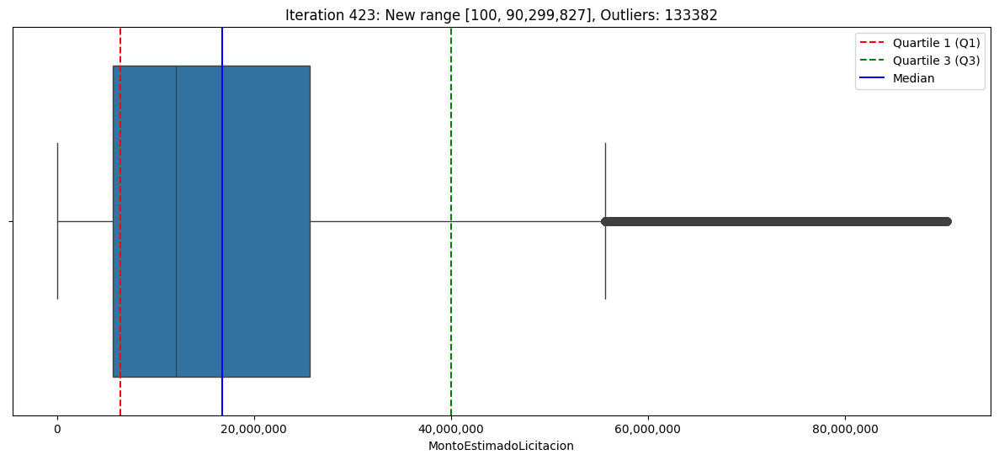

Iteration 423: New range [100, 90,299,827]


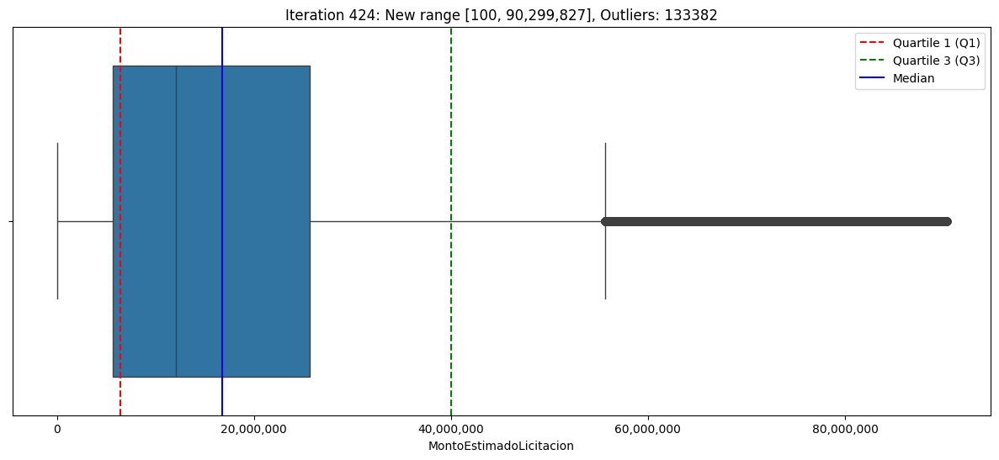

Iteration 424: New range [100, 90,299,827]


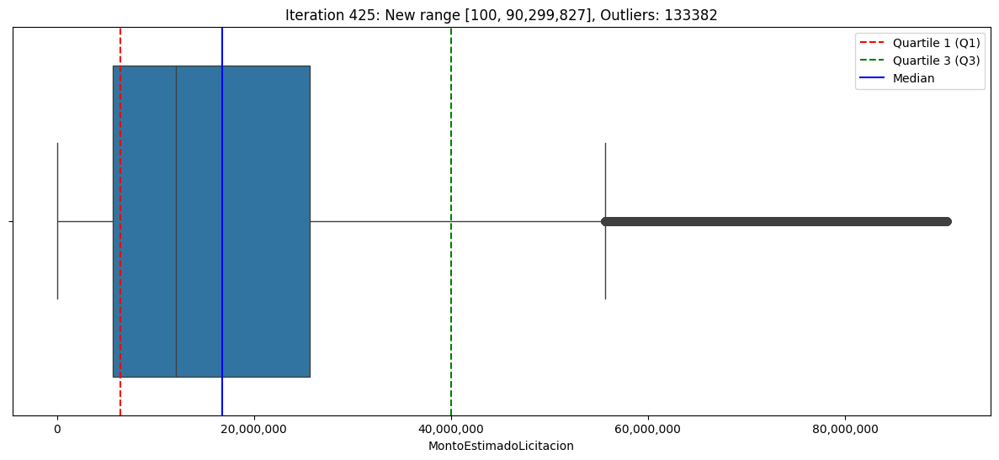

Iteration 425: New range [100, 90,299,827]


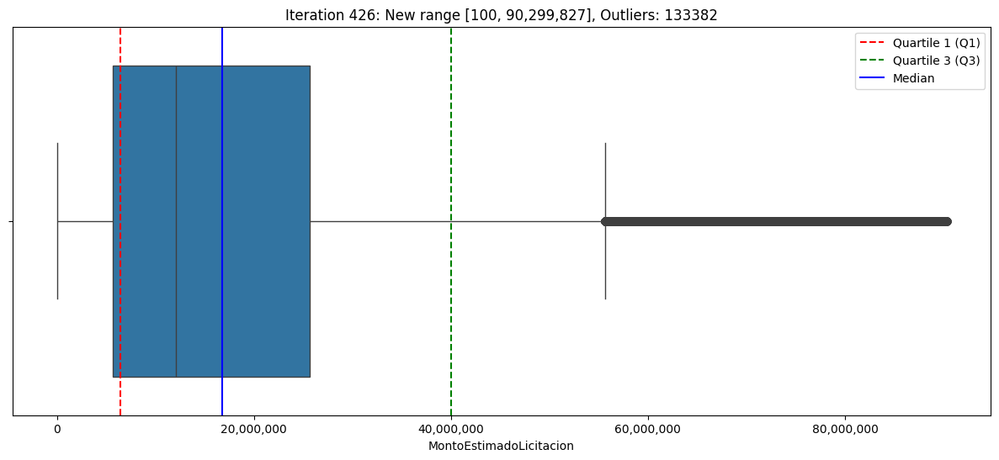

Iteration 426: New range [100, 90,299,827]


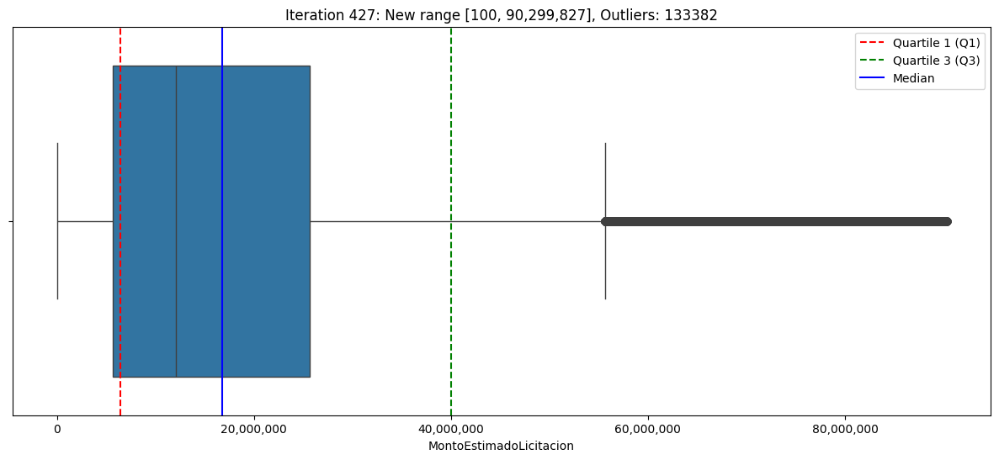

Iteration 427: New range [100, 90,299,827]


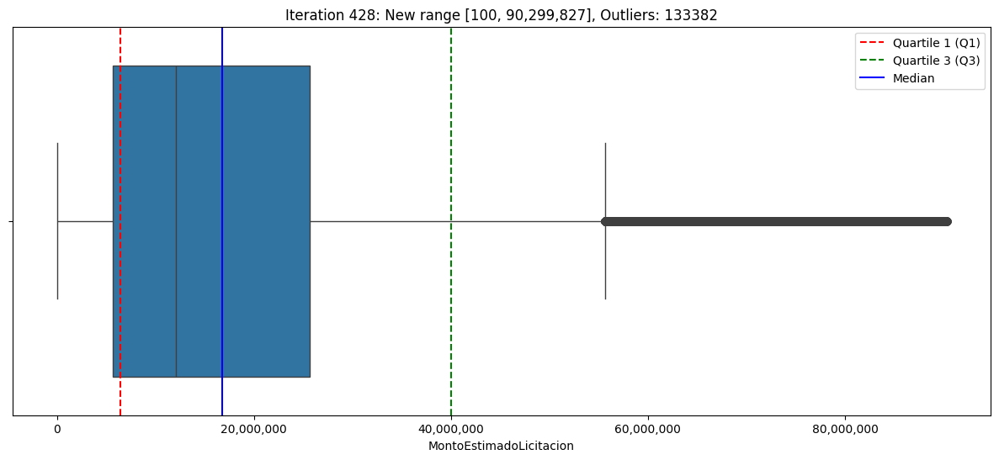

Iteration 428: New range [100, 90,299,827]


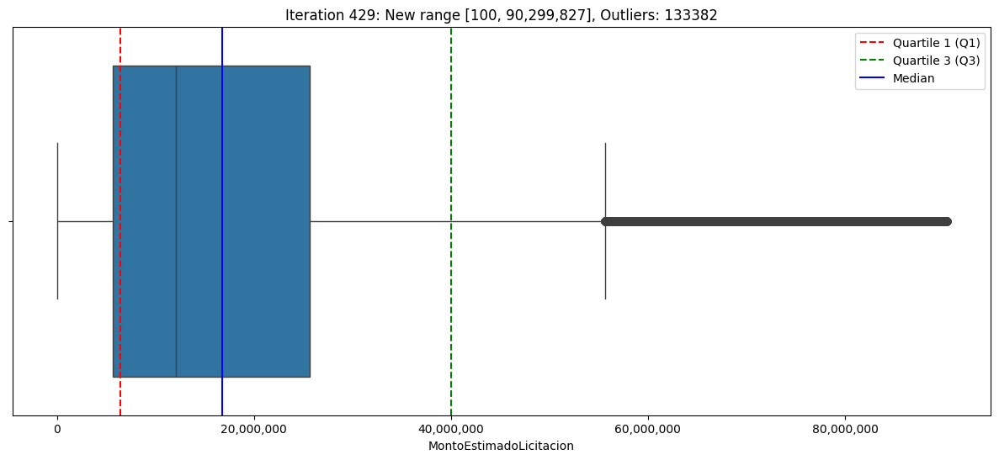

Iteration 429: New range [100, 90,299,827]


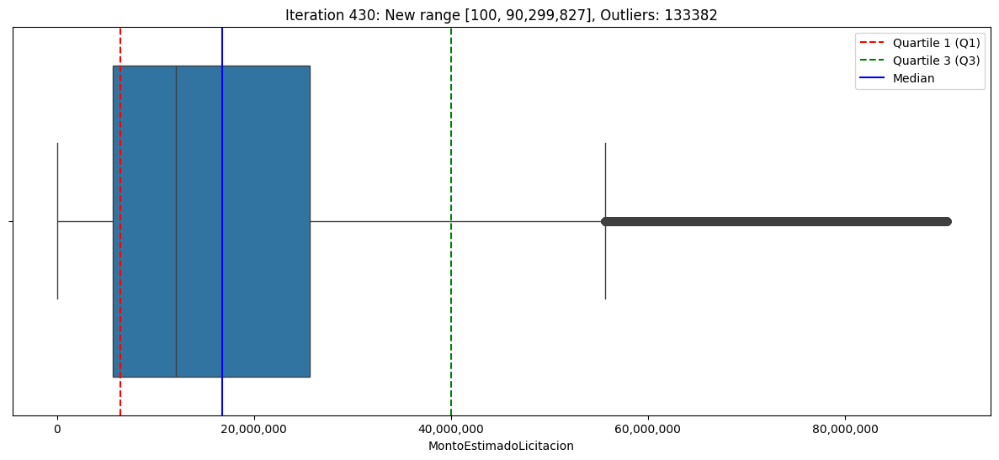

Iteration 430: New range [100, 90,299,827]


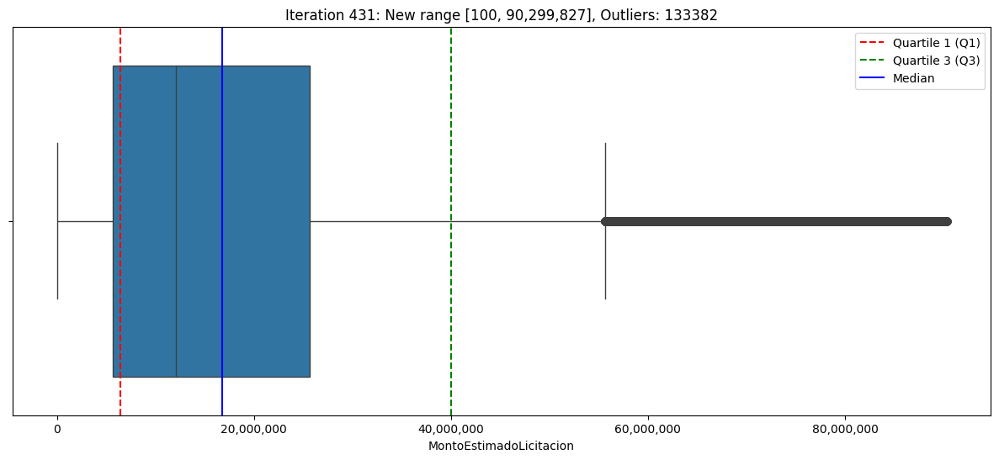

Iteration 431: New range [100, 90,299,827]


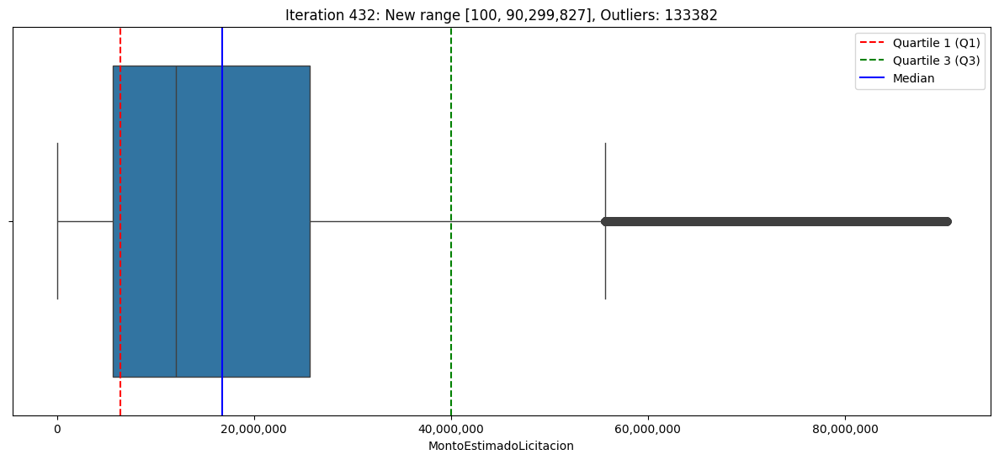

Iteration 432: New range [100, 90,299,827]


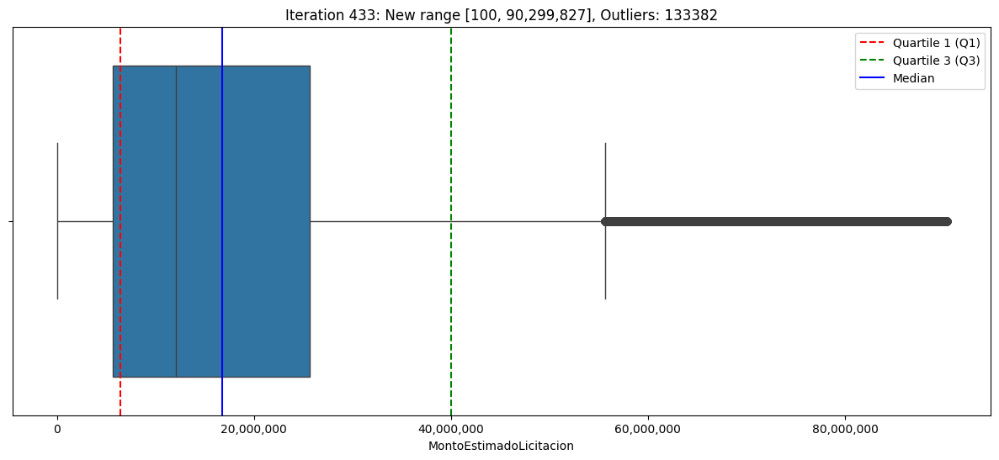

Iteration 433: New range [100, 90,299,827]


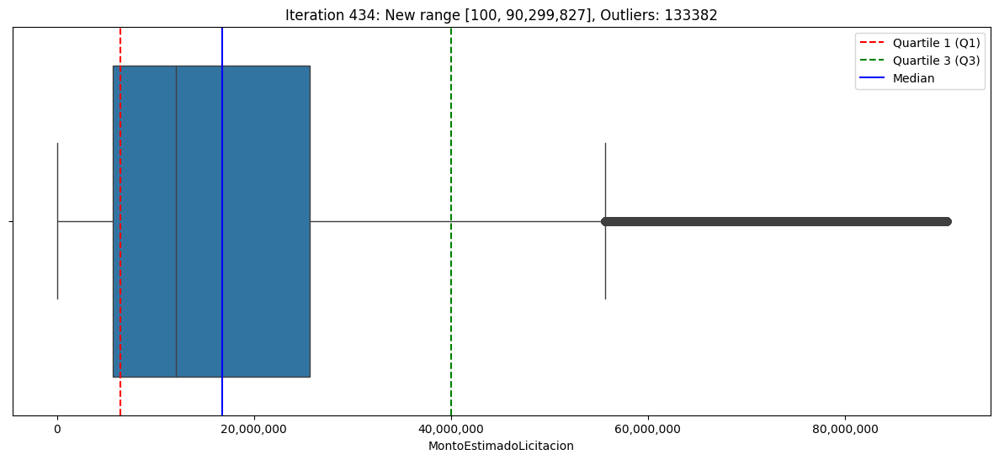

Iteration 434: New range [100, 90,299,827]


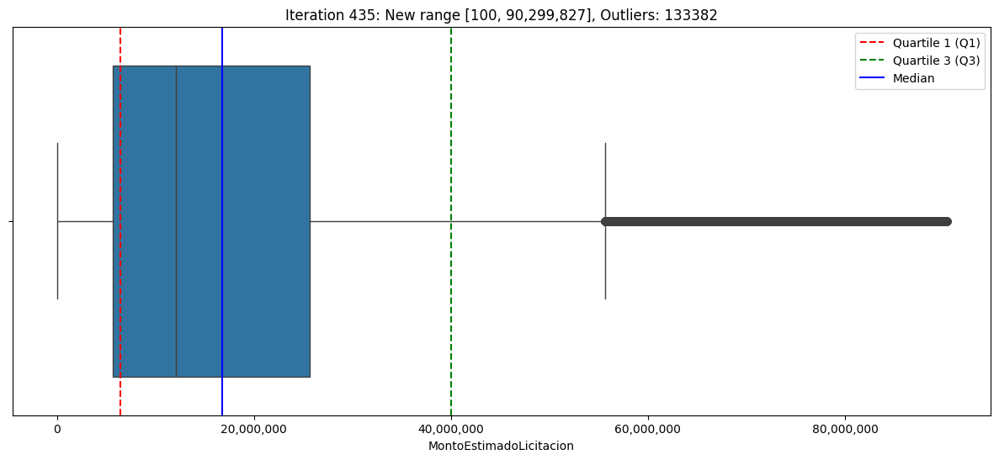

Iteration 435: New range [100, 90,299,827]


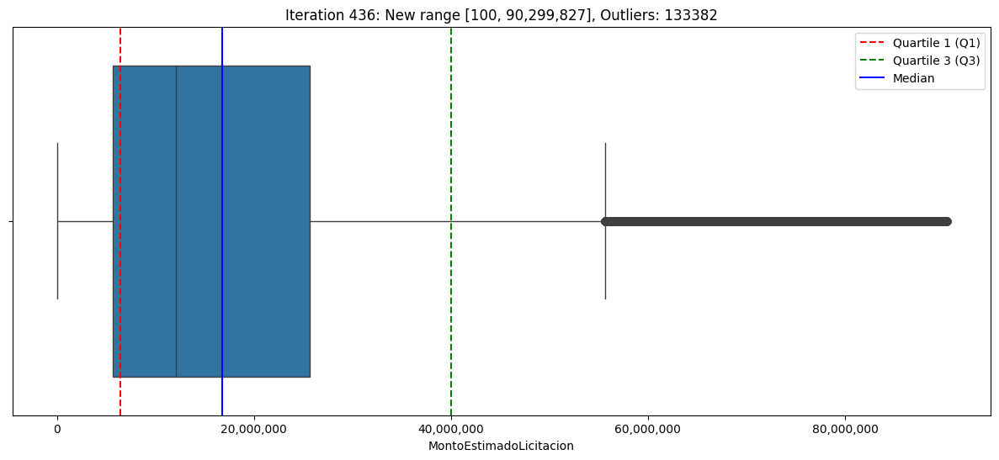

Iteration 436: New range [100, 90,299,827]


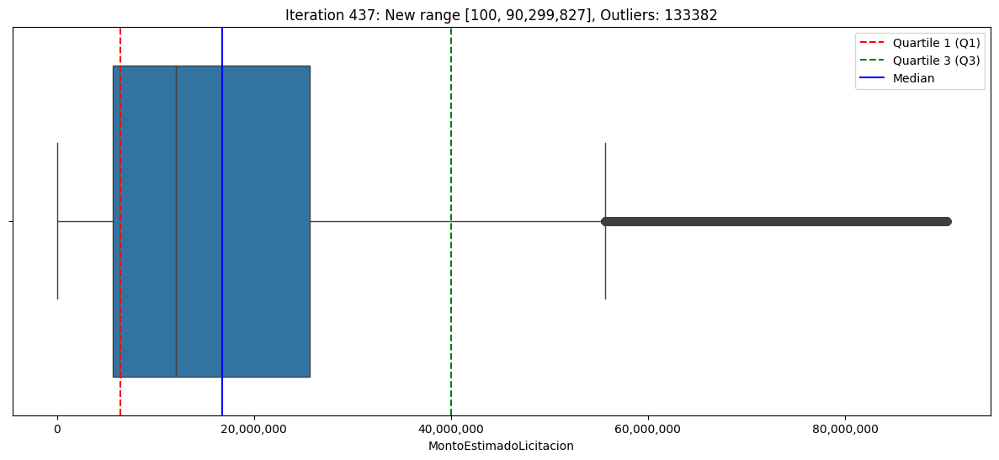

Iteration 437: New range [100, 90,299,827]


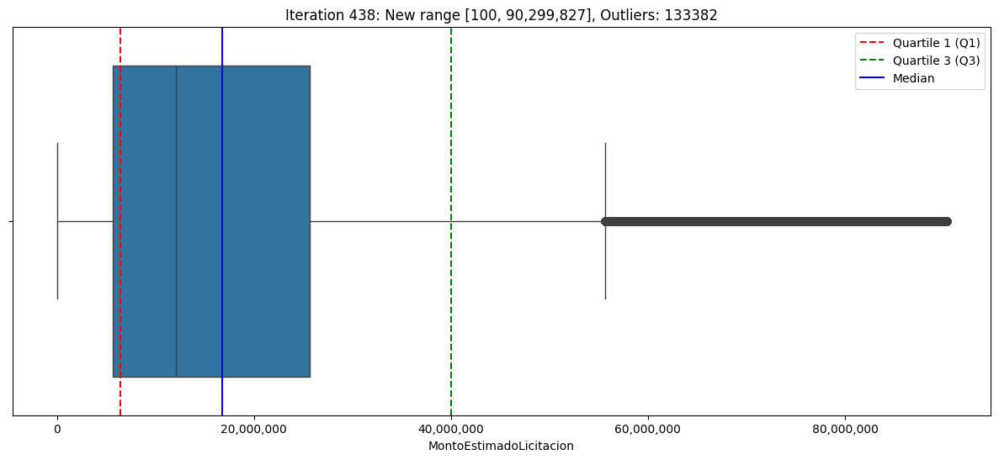

Iteration 438: New range [100, 90,299,827]


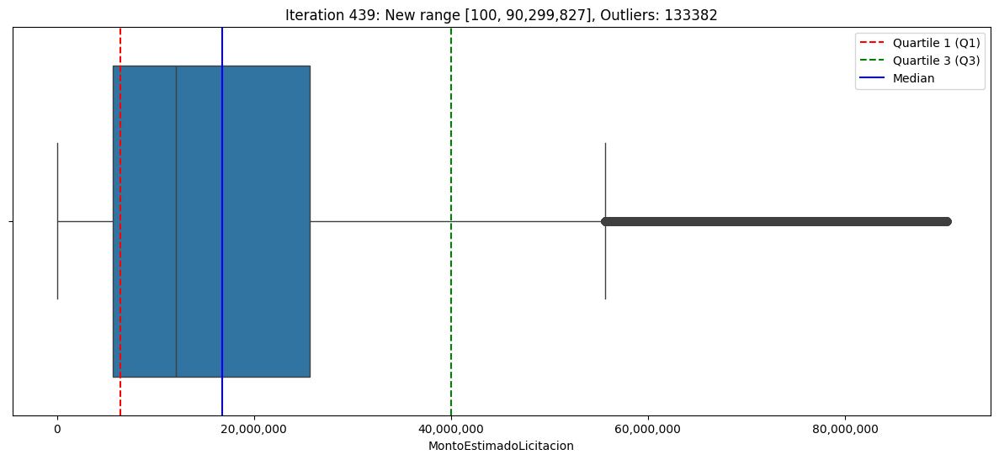

Iteration 439: New range [100, 90,299,827]


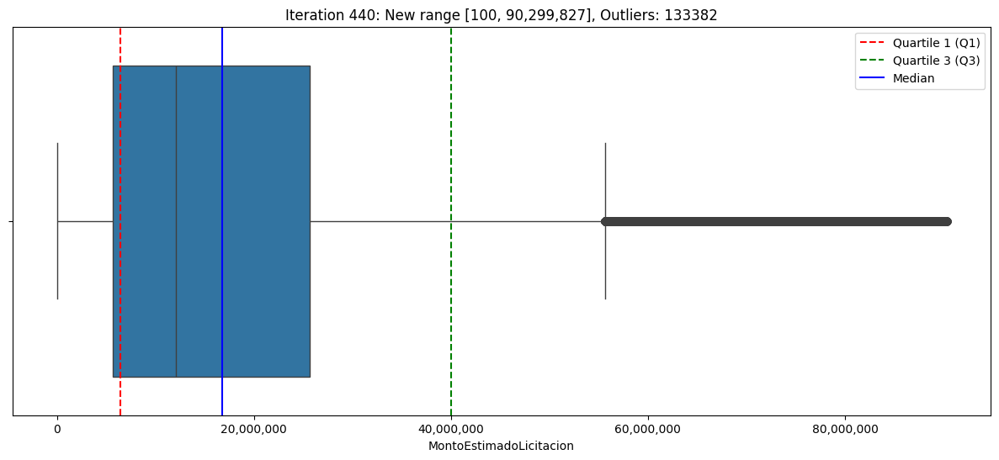

Iteration 440: New range [100, 90,299,827]


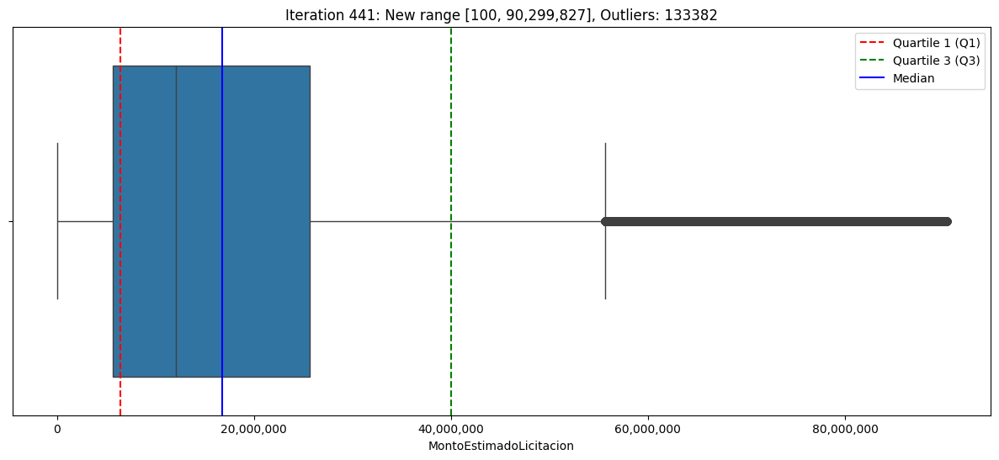

Iteration 441: New range [100, 90,299,827]


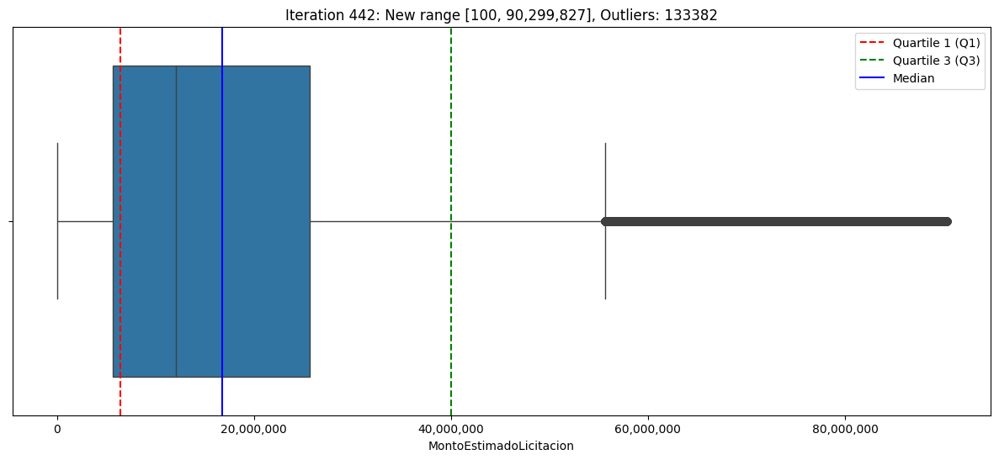

Iteration 442: New range [100, 90,299,827]


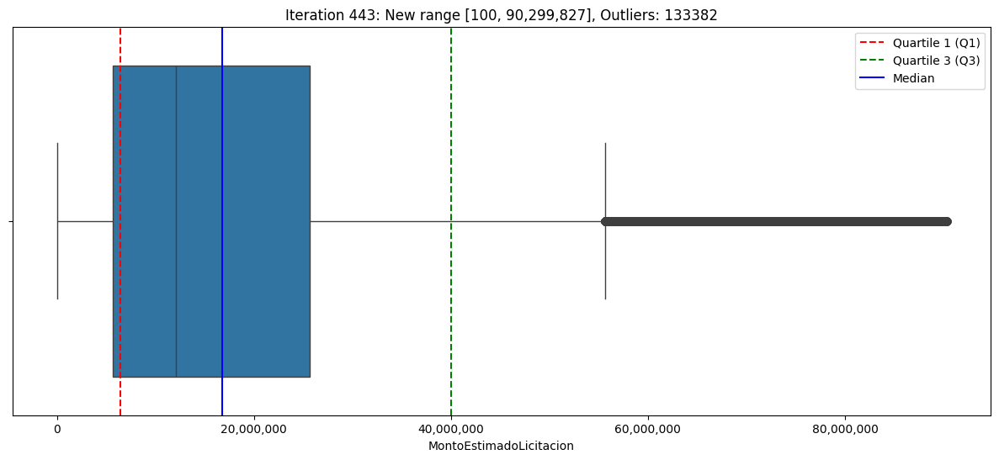

Iteration 443: New range [100, 90,299,827]


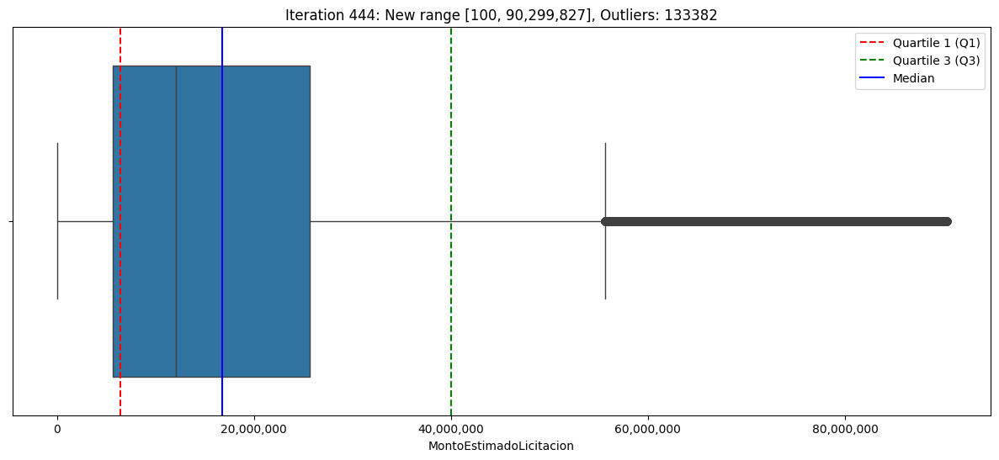

Iteration 444: New range [100, 90,299,827]


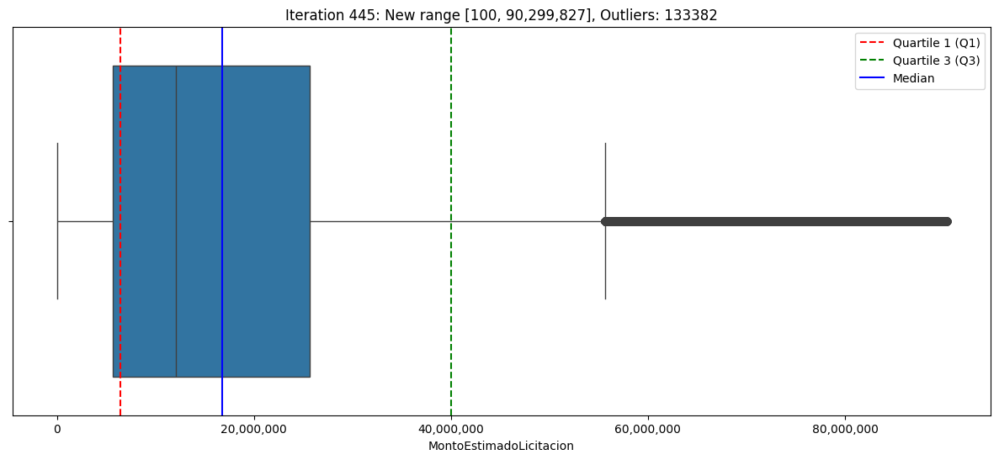

Iteration 445: New range [100, 90,299,827]


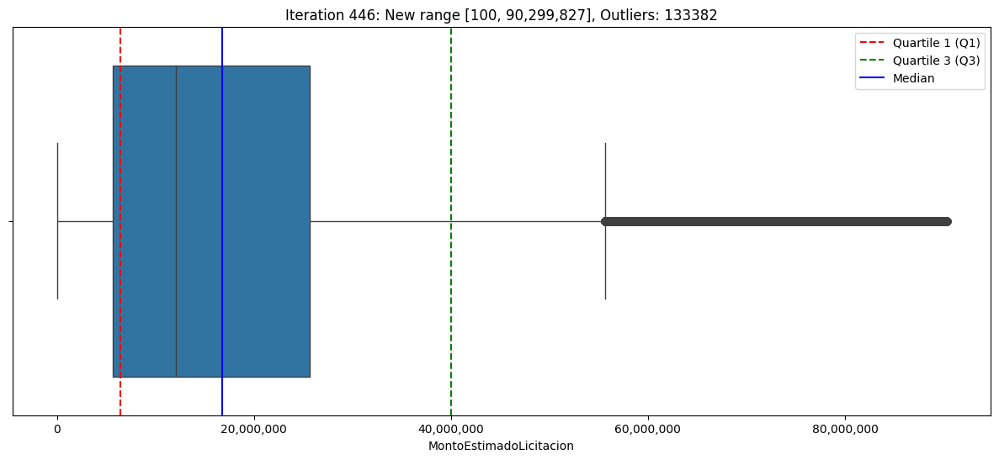

Iteration 446: New range [100, 90,299,827]


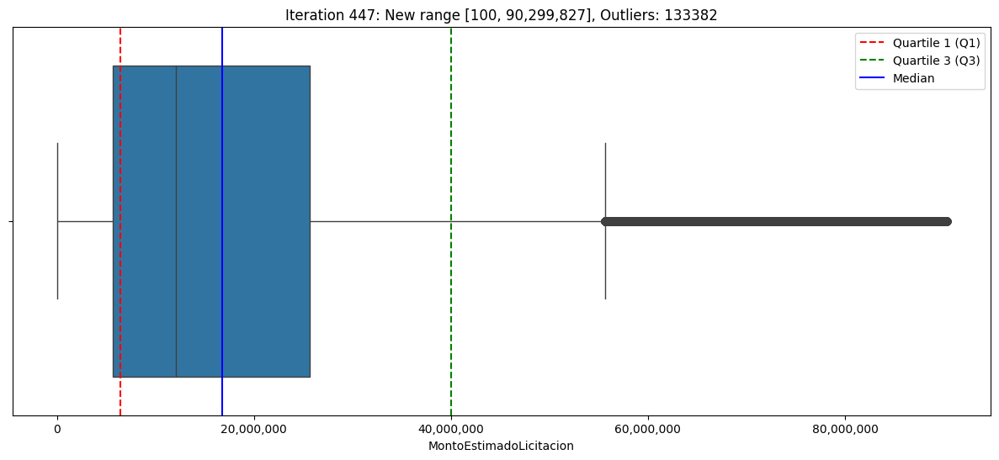

Iteration 447: New range [100, 90,299,827]


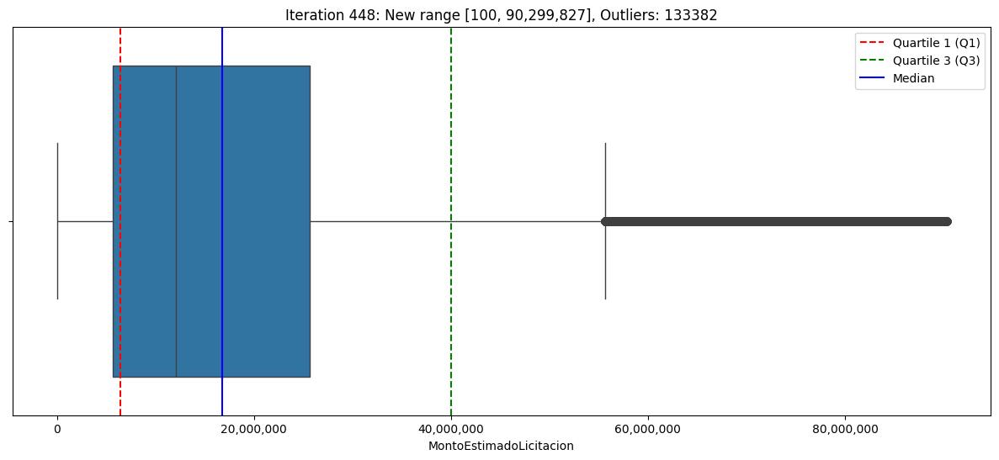

Iteration 448: New range [100, 90,299,827]


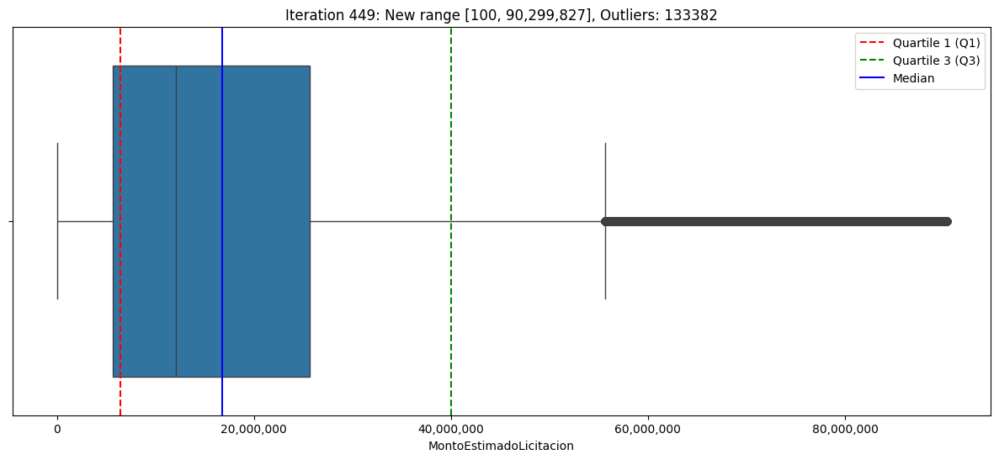

Iteration 449: New range [100, 90,299,827]


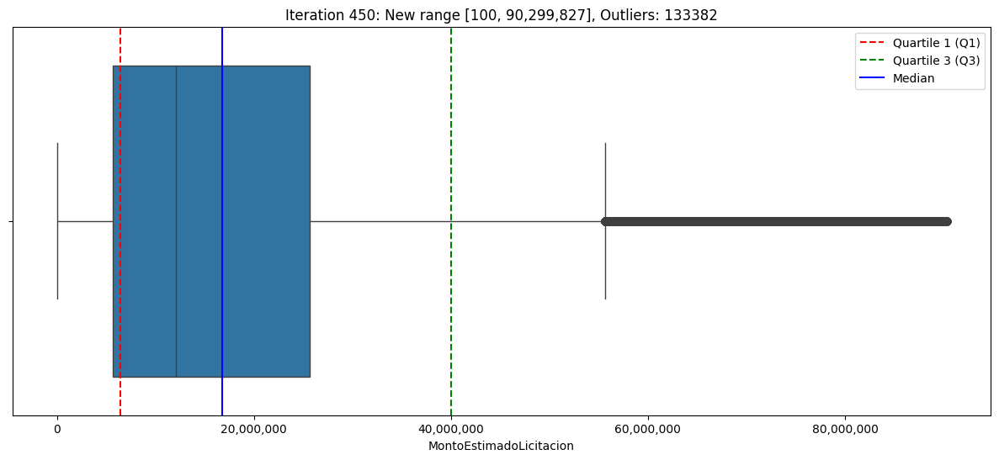

Iteration 450: New range [100, 90,299,827]


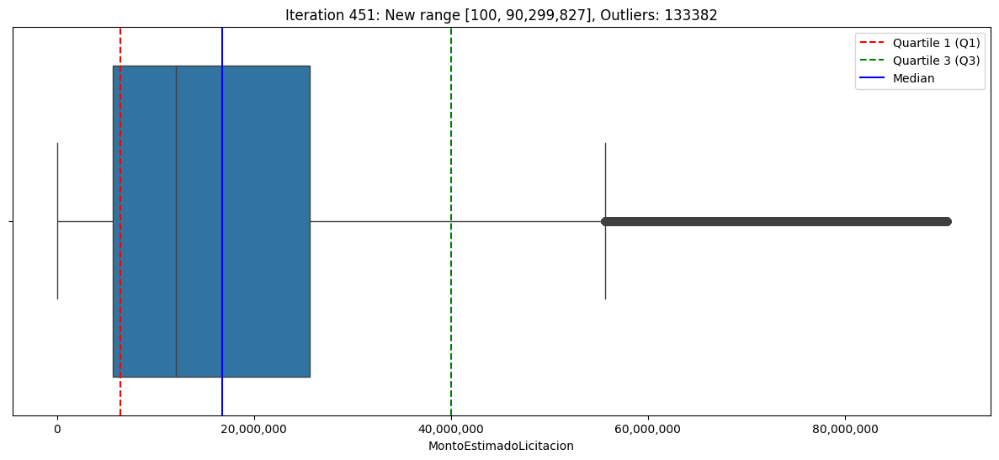

Iteration 451: New range [100, 90,299,827]


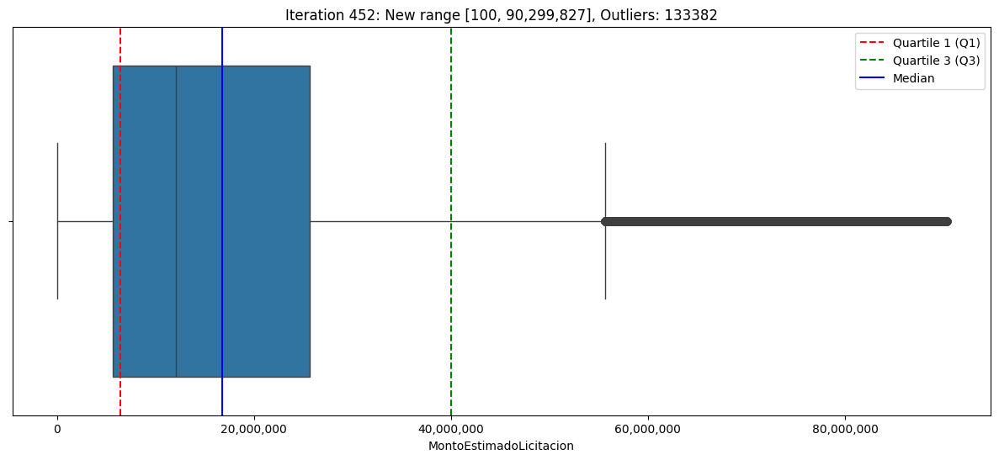

Iteration 452: New range [100, 90,299,827]


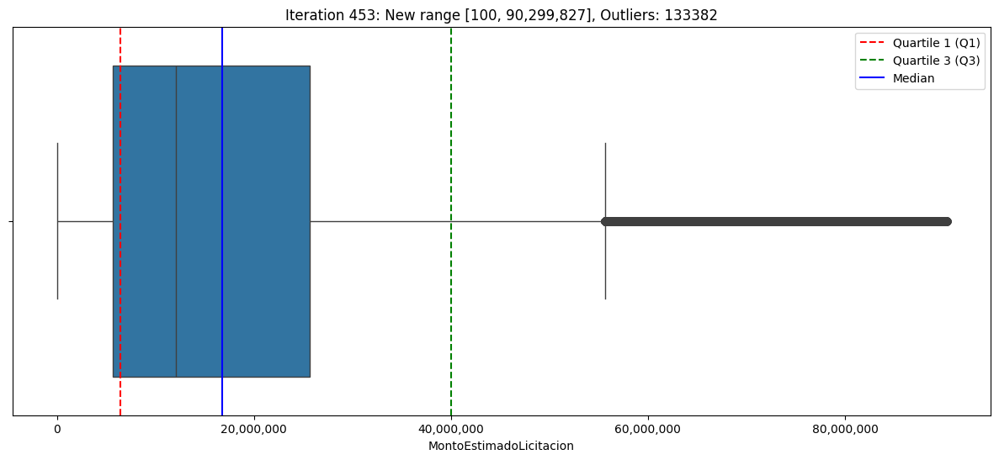

Iteration 453: New range [100, 90,299,827]


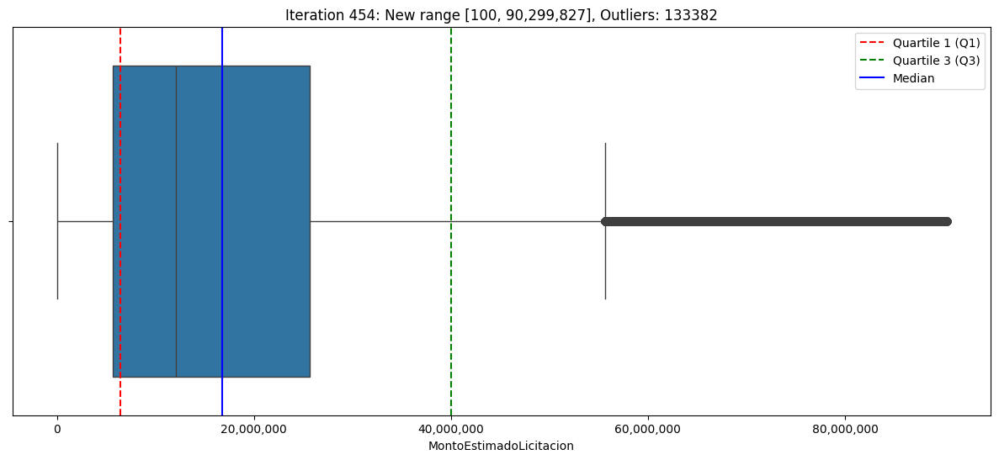

Iteration 454: New range [100, 90,299,827]


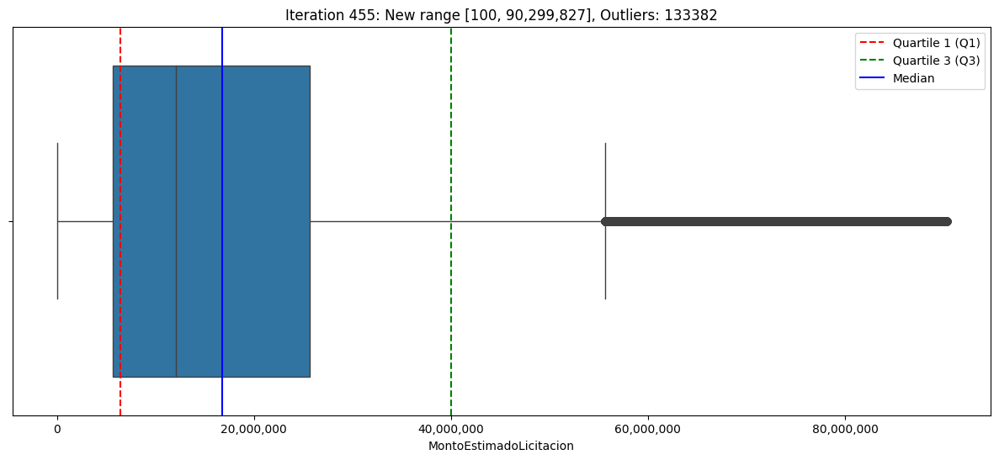

Iteration 455: New range [100, 90,299,827]


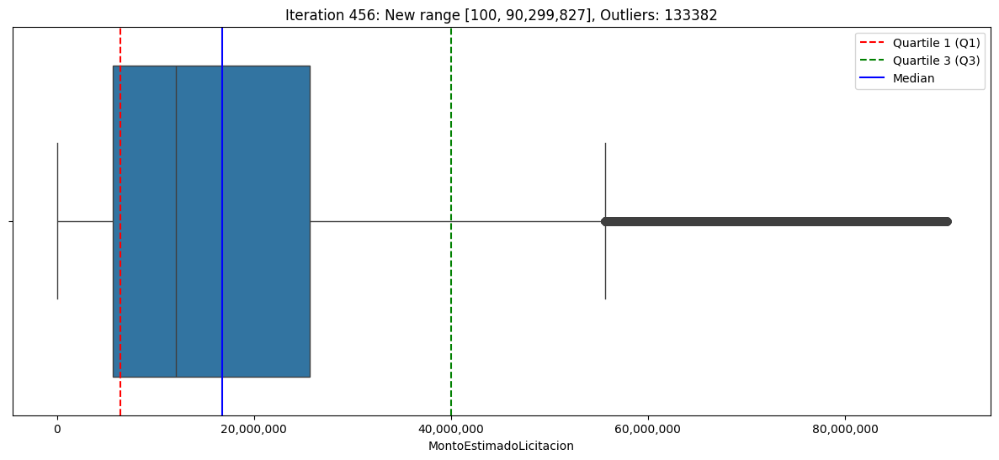

Iteration 456: New range [100, 90,299,827]


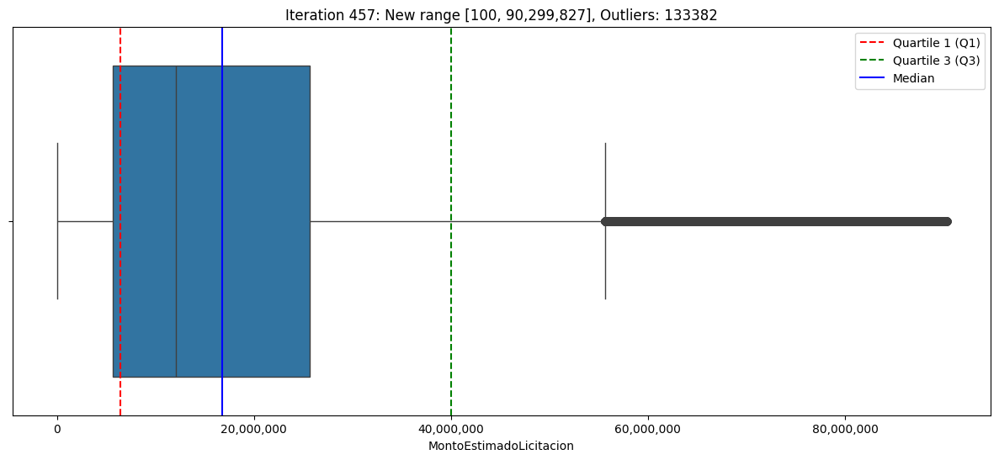

Iteration 457: New range [100, 90,299,827]


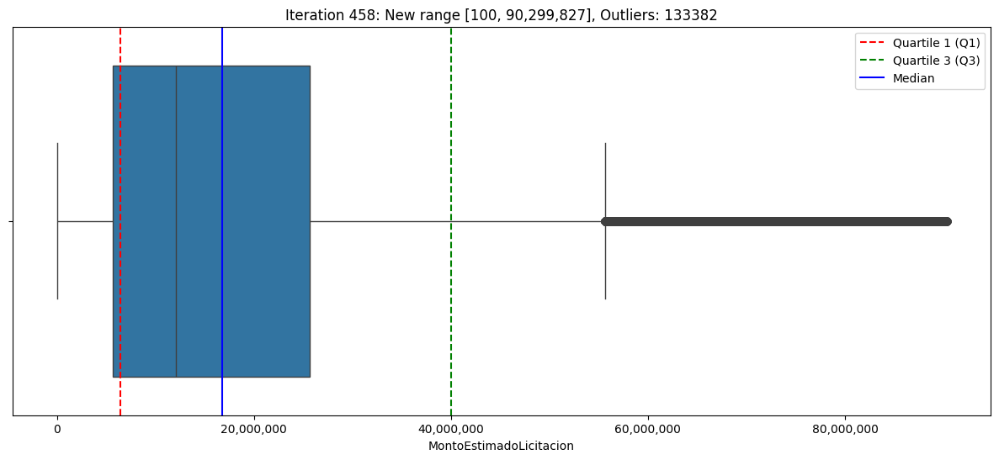

Iteration 458: New range [100, 90,299,827]


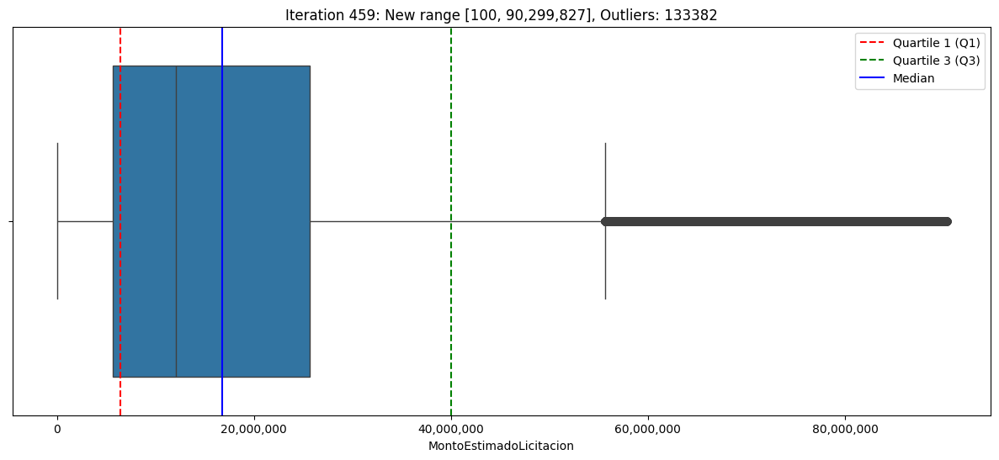

Iteration 459: New range [100, 90,299,827]


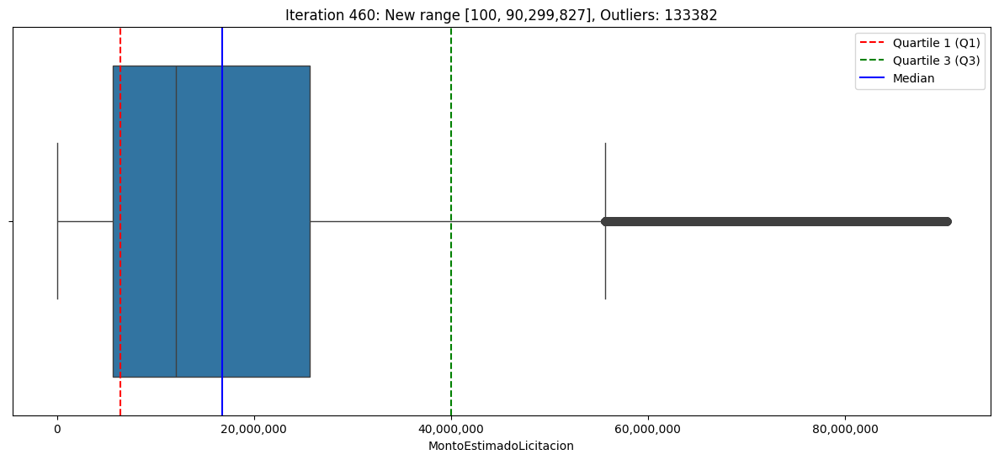

Iteration 460: New range [100, 90,299,827]


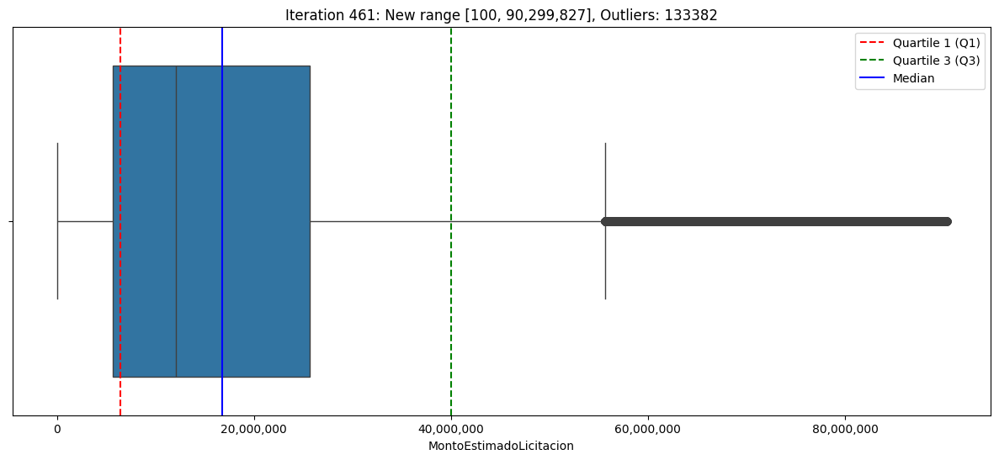

Iteration 461: New range [100, 90,299,827]


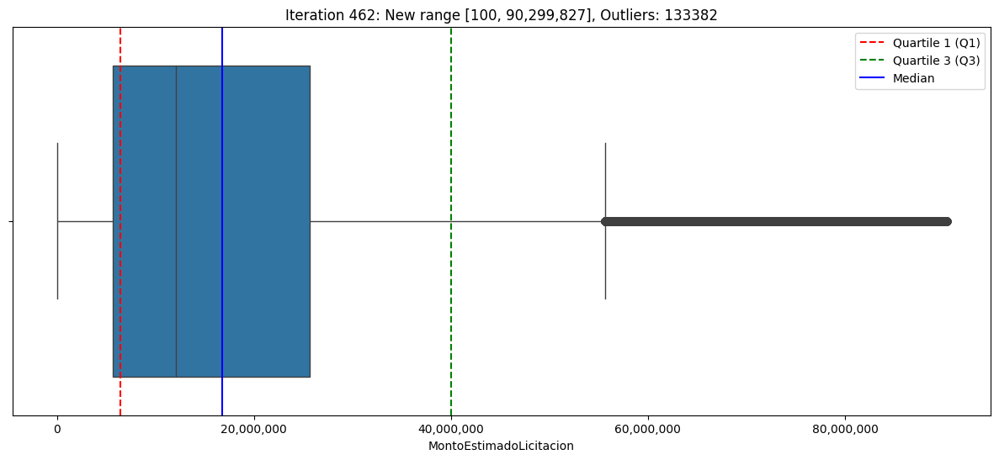

Iteration 462: New range [100, 90,299,827]


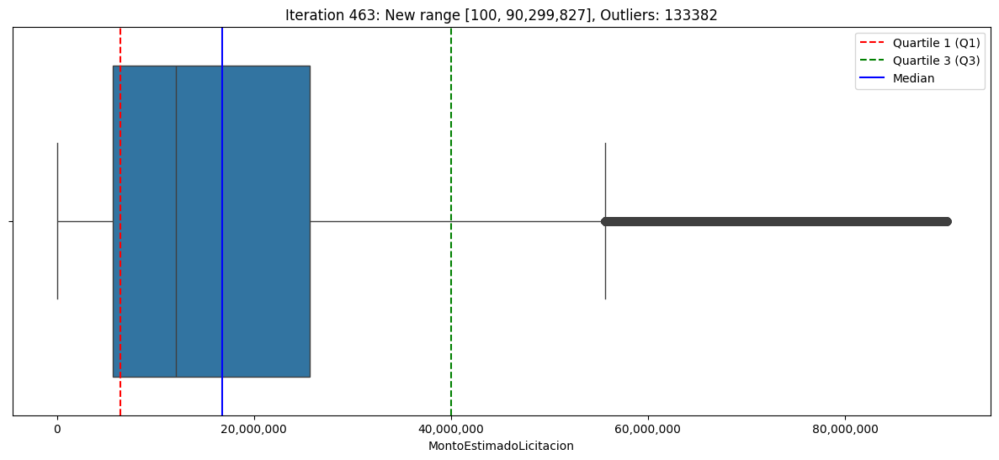

Iteration 463: New range [100, 90,299,827]


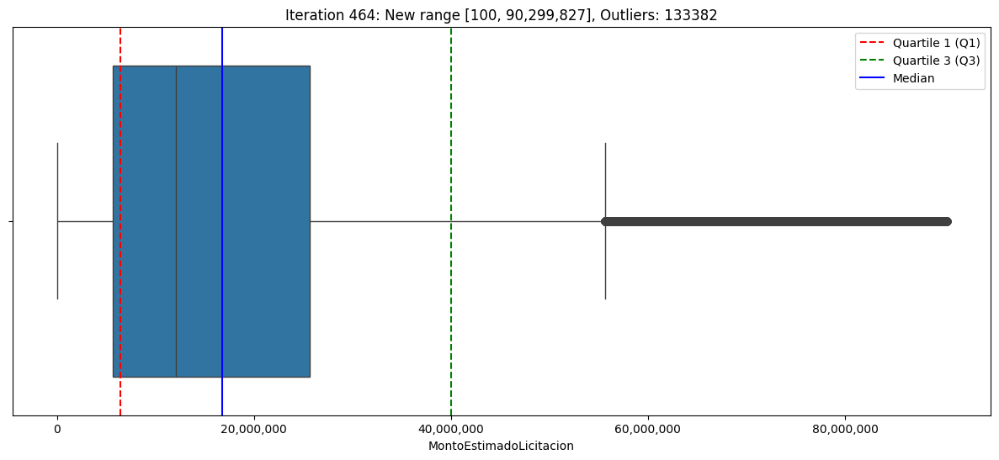

Iteration 464: New range [100, 90,299,827]


KeyboardInterrupt: 

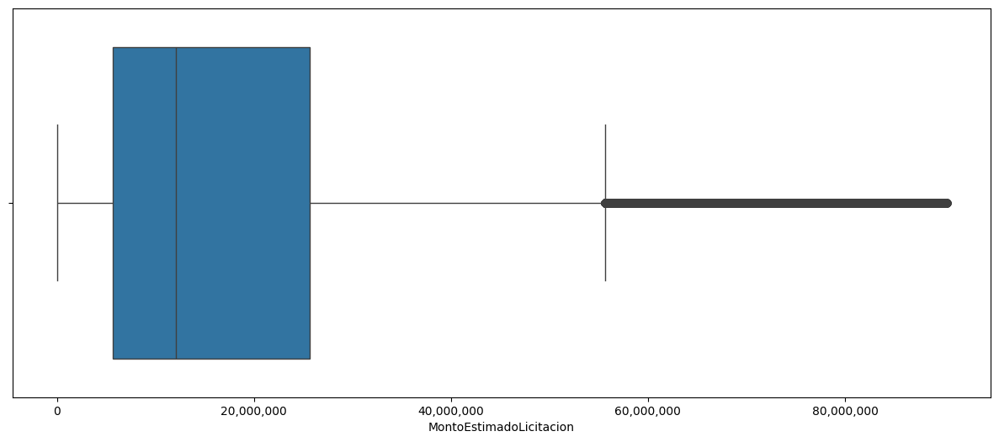

In [56]:
def remove_outliers_and_plot(df_final, column, iteration):
    # Plot the boxplot before removing outliers
    plt.figure(figsize=(15, 6))
    sns.boxplot(x=column, data=df)
    plt.ticklabel_format(style='plain', axis='x')
    plt.gca().xaxis.set_major_formatter(mtick.StrMethodFormatter('{x:,.0f}'))

    # Calculate the first and third quartile and the median after removing outliers
    Q1 = df_final[column].quantile(0.25)
    Q3 = df_final[column].quantile(0.75)
    median = df_final[column].median()

    # Calculate the interquartile range (IQR)
    IQR = Q3 - Q1

    # Define the lower and upper limit for outliers
    lower_limit = Q1 - 1.5 * IQR
    upper_limit = Q3 + 1.5 * IQR

    # Identify the outliers
    outliers = df_final[(df_final[column] < lower_limit) | (df_final[column] > upper_limit)]
    cleaned_df = df_final.drop(outliers.index)

    # Add vertical lines for the quartiles and the median
    plt.axvline(Q1, color='r', linestyle='--', label='Quartile 1 (Q1)')
    plt.axvline(Q3, color='g', linestyle='--', label='Quartile 3 (Q3)')
    plt.axvline(median, color='b', linestyle='-', label='Median')

    # Show the quartiles and the median in the legend
    plt.legend()

    # Show information about the iteration and the outliers
    plt.title(f"Iteration {iteration}: New range [{cleaned_df[column].min():,.0f}, {cleaned_df[column].max():,.0f}], Outliers: {len(outliers)}")
    plt.show()

    return cleaned_df, outliers

# Iterate until there are no more outliers
iteration = 1
while True:
    df, outliers = remove_outliers_and_plot(df_mayor_final, 'MontoEstimadoLicitacion', iteration)
    new_range_min = df['MontoEstimadoLicitacion'].min()
    new_range_max = df['MontoEstimadoLicitacion'].max()
    print(f"Iteration {iteration}: New range [{new_range_min:,.0f}, {new_range_max:,.0f}]")
    if outliers.empty:
        print("No outliers found in this iteration.")
        break
    iteration += 1

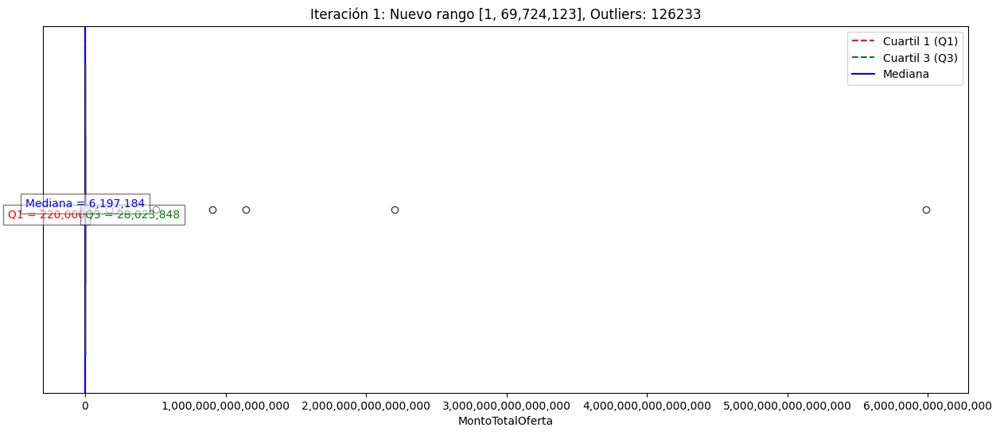

Iteración 1: Nuevo rango [1, 69,724,123]
Max outlier in iteration 1: 5,985,330,976,200,000


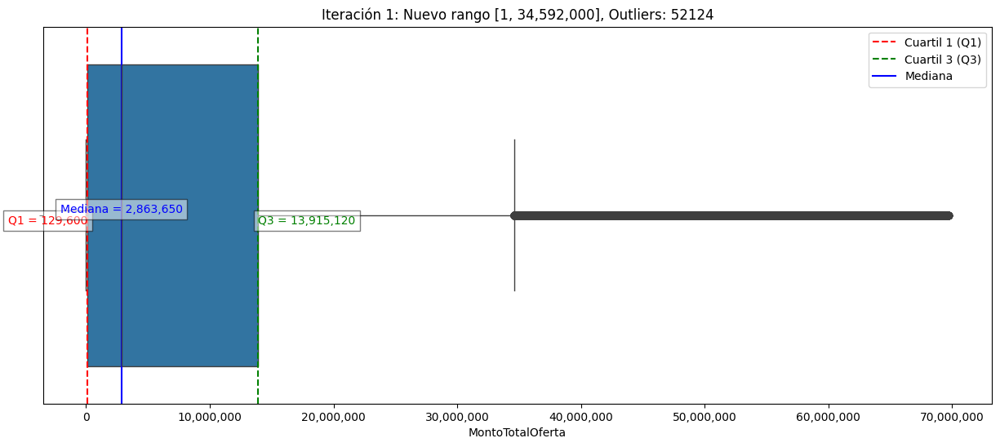

Iteración 1: Nuevo rango [1, 34,592,000]
Max outlier in iteration 1: 69,724,123


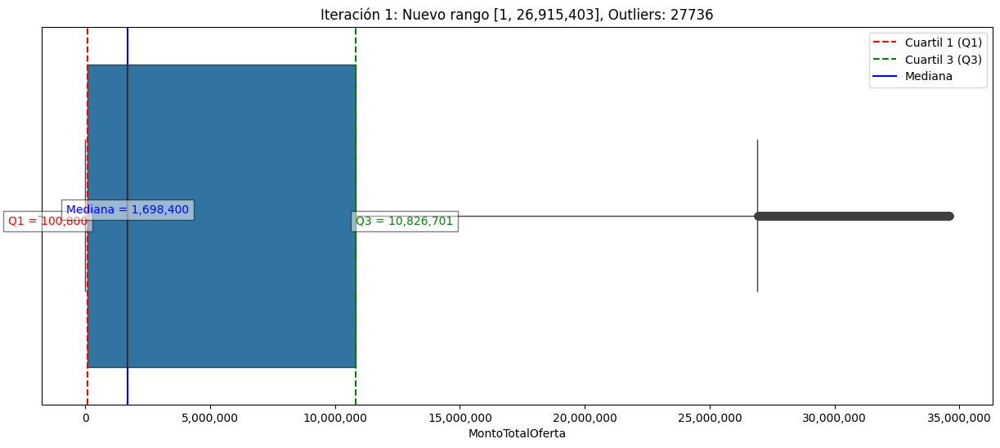

Iteración 1: Nuevo rango [1, 26,915,403]
Max outlier in iteration 1: 34,592,000


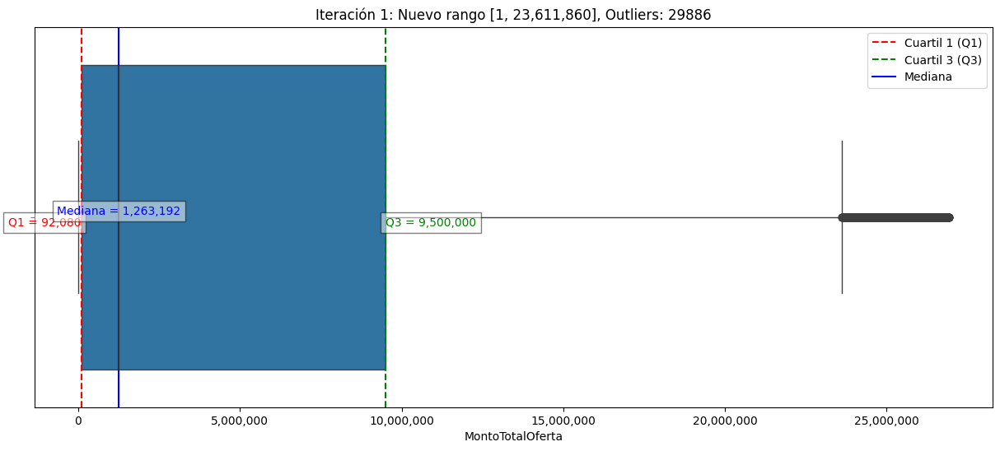

Iteración 1: Nuevo rango [1, 23,611,860]
Max outlier in iteration 1: 26,915,403


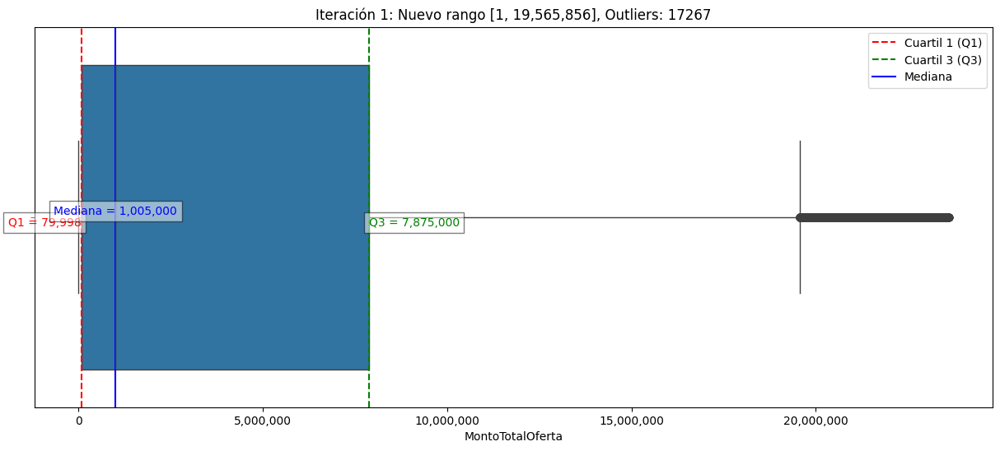

Iteración 1: Nuevo rango [1, 19,565,856]
Max outlier in iteration 1: 23,611,860


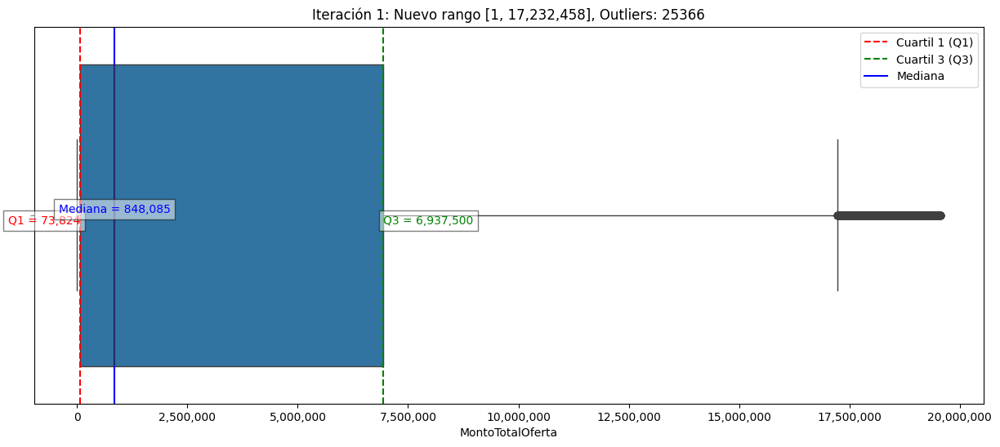

Iteración 1: Nuevo rango [1, 17,232,458]
Max outlier in iteration 1: 19,565,856


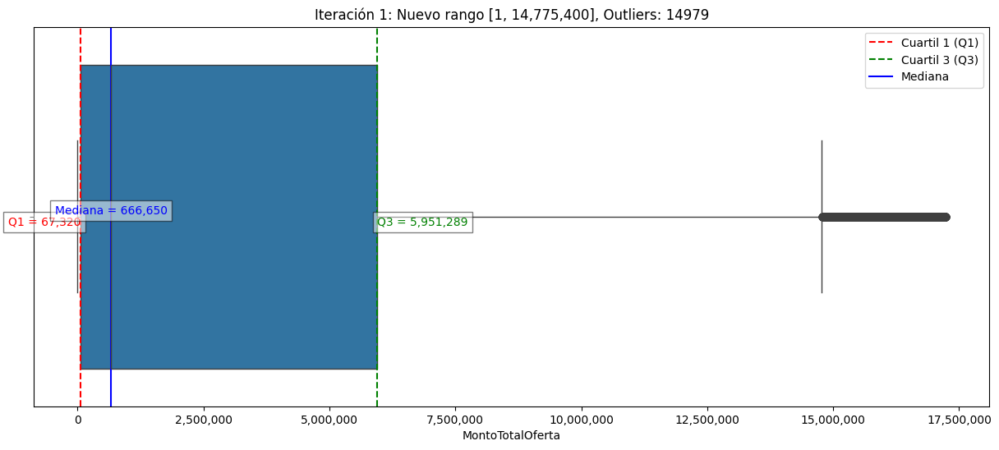

Iteración 1: Nuevo rango [1, 14,775,400]
Max outlier in iteration 1: 17,232,458


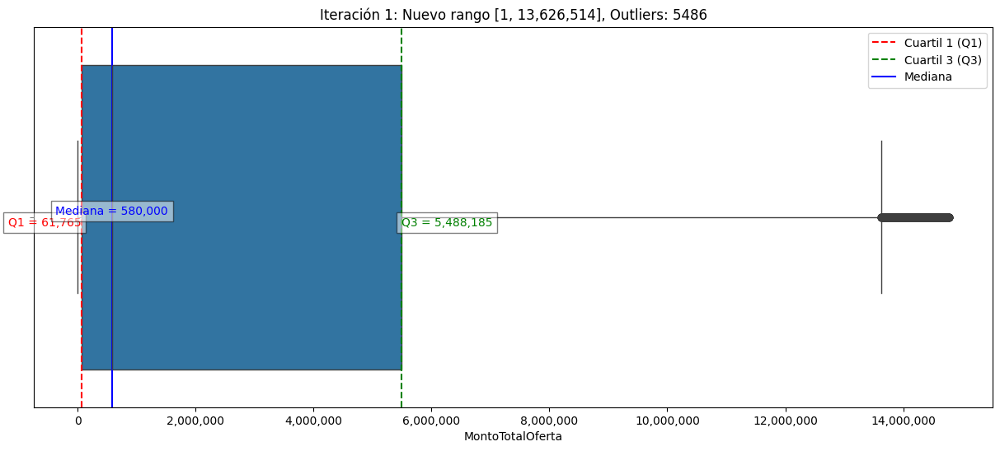

Iteración 1: Nuevo rango [1, 13,626,514]
Max outlier in iteration 1: 14,775,400


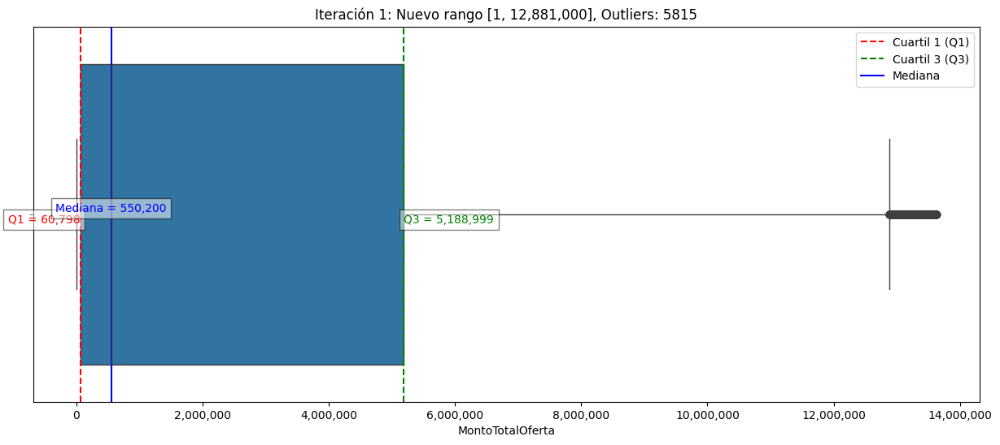

Iteración 1: Nuevo rango [1, 12,881,000]
Max outlier in iteration 1: 13,626,514


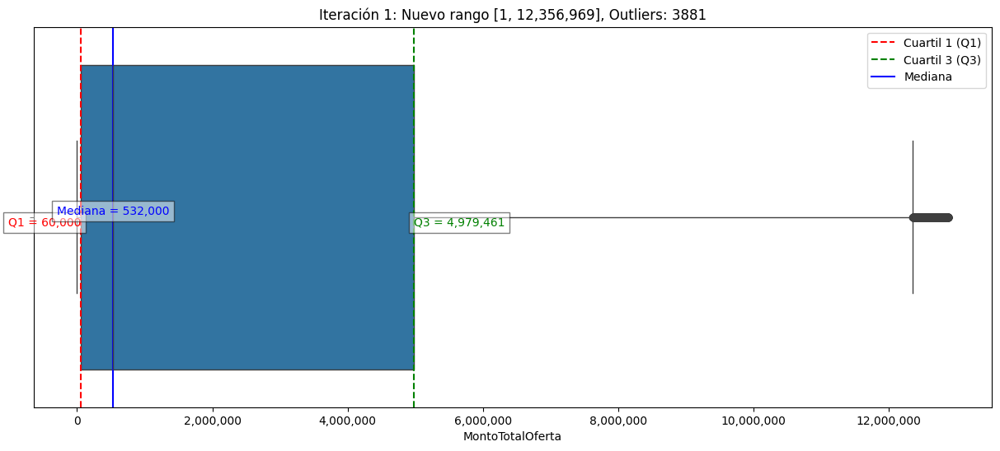

Iteración 1: Nuevo rango [1, 12,356,969]
Max outlier in iteration 1: 12,881,000


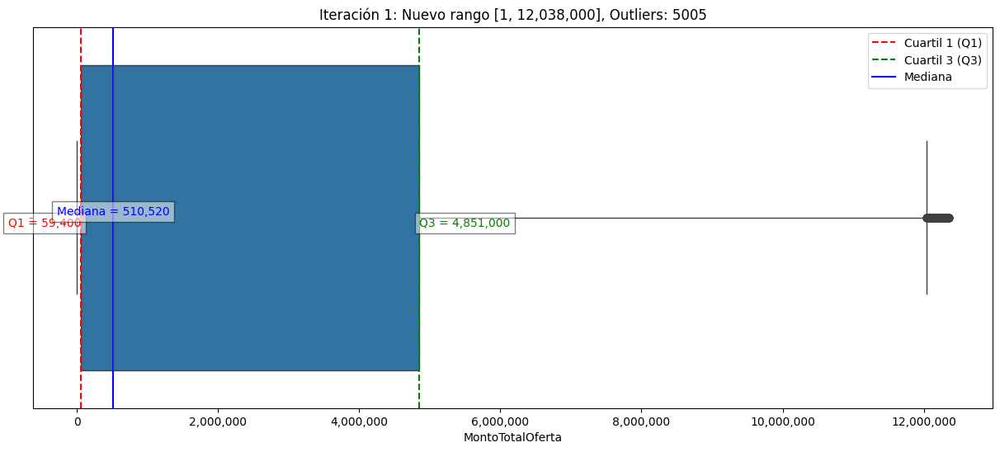

Iteración 1: Nuevo rango [1, 12,038,000]
Max outlier in iteration 1: 12,356,969


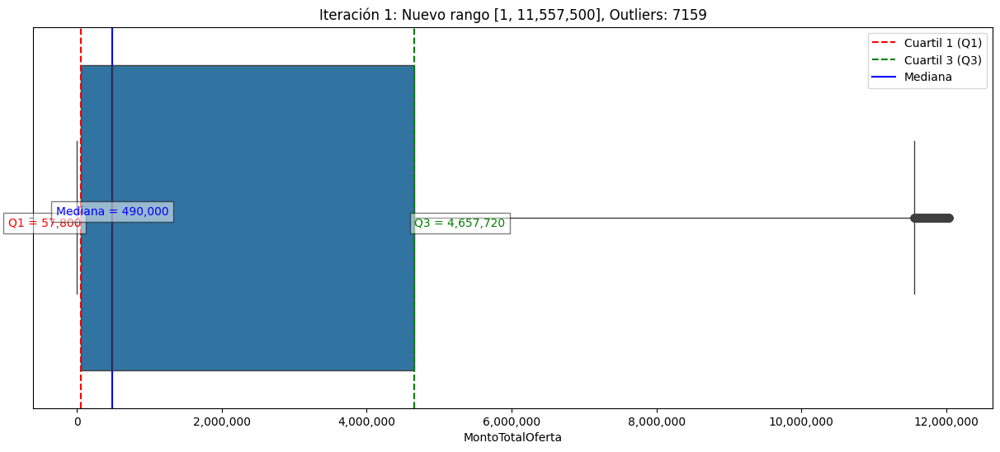

Iteración 1: Nuevo rango [1, 11,557,500]
Max outlier in iteration 1: 12,038,000


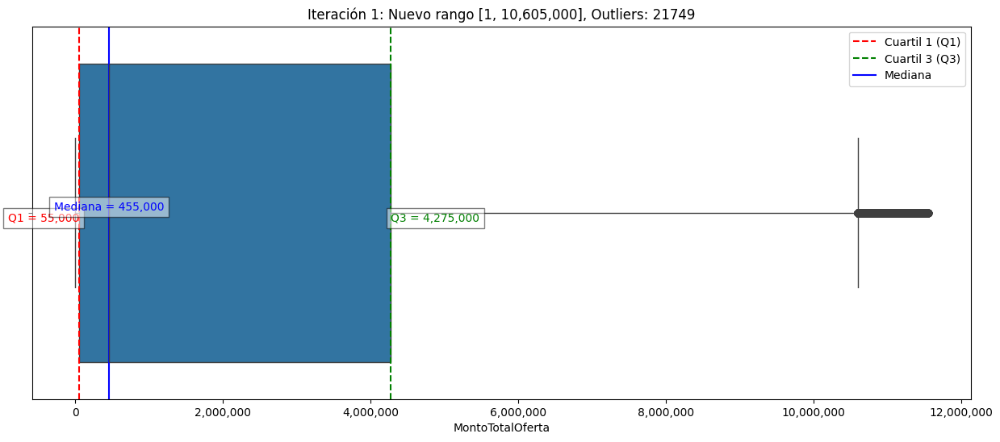

Iteración 1: Nuevo rango [1, 10,605,000]
Max outlier in iteration 1: 11,557,500


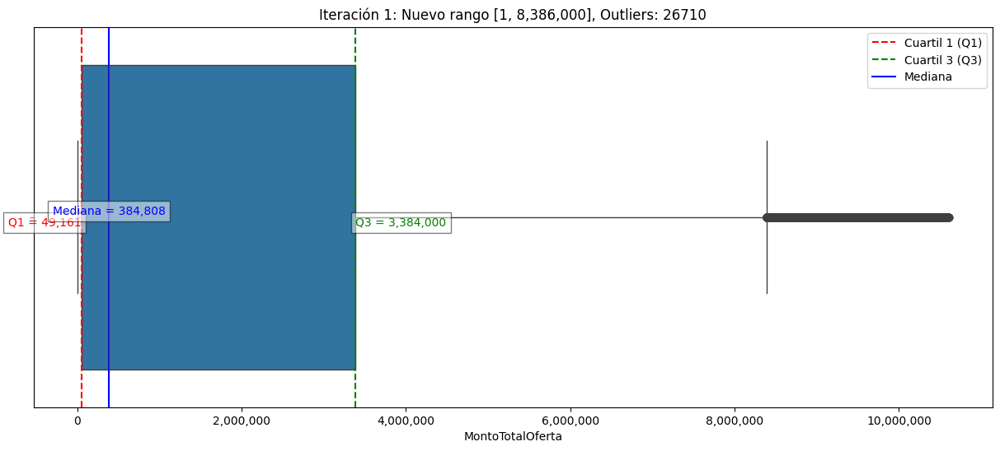

Iteración 1: Nuevo rango [1, 8,386,000]
Max outlier in iteration 1: 10,605,000


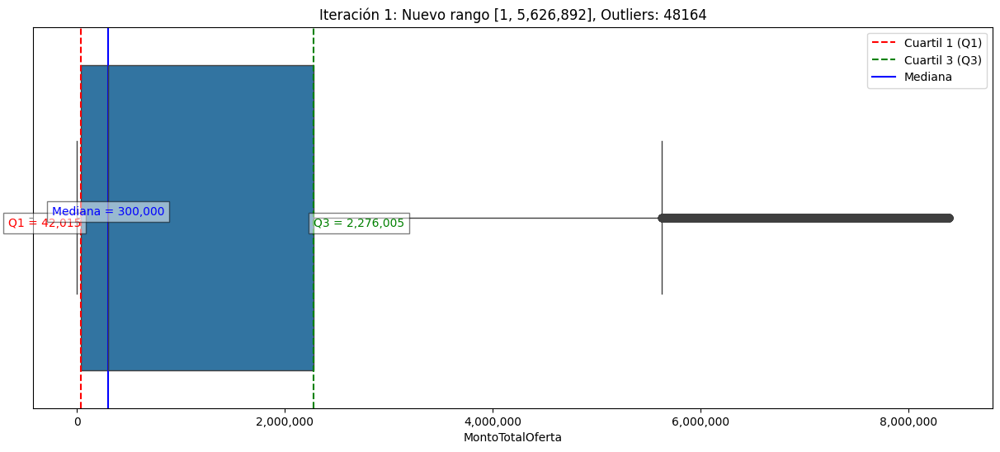

Iteración 1: Nuevo rango [1, 5,626,892]
Max outlier in iteration 1: 8,386,000


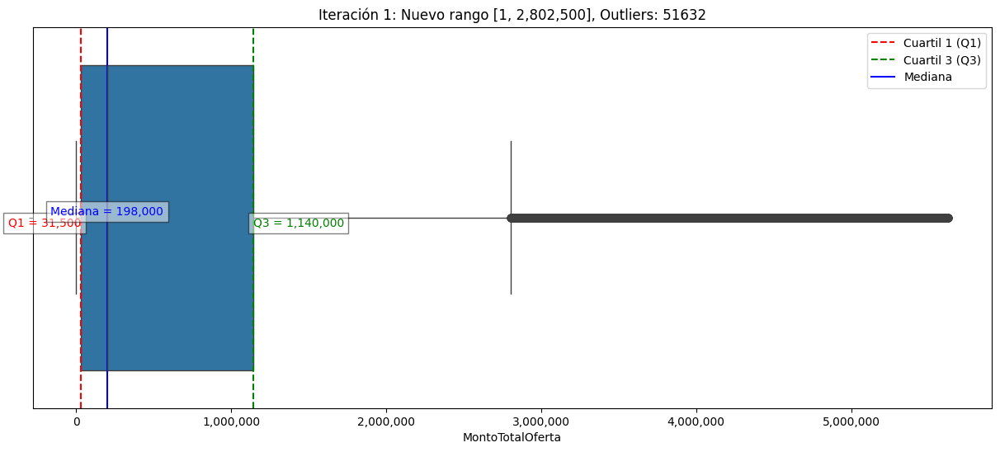

Iteración 1: Nuevo rango [1, 2,802,500]
Max outlier in iteration 1: 5,626,892


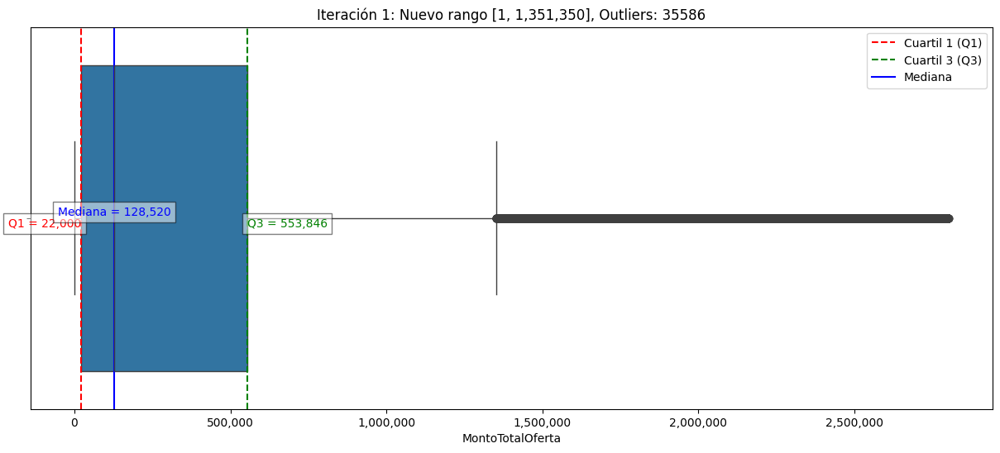

Iteración 1: Nuevo rango [1, 1,351,350]
Max outlier in iteration 1: 2,802,500


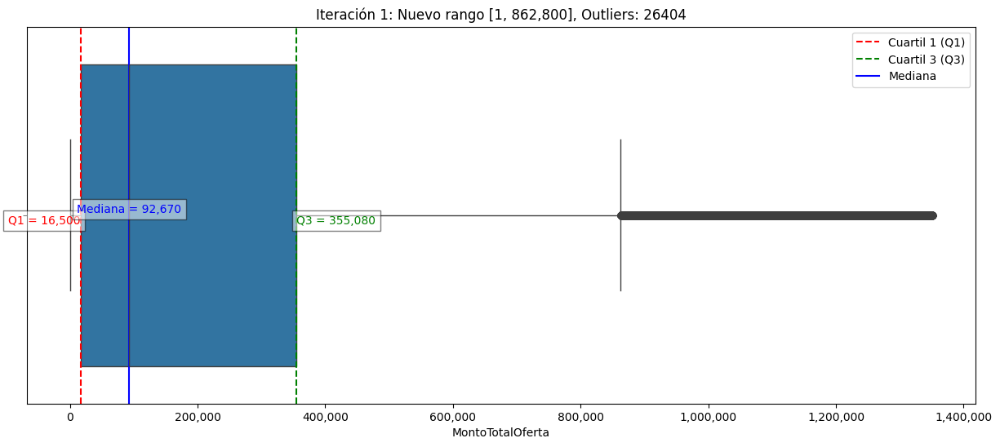

Iteración 1: Nuevo rango [1, 862,800]
Max outlier in iteration 1: 1,351,350


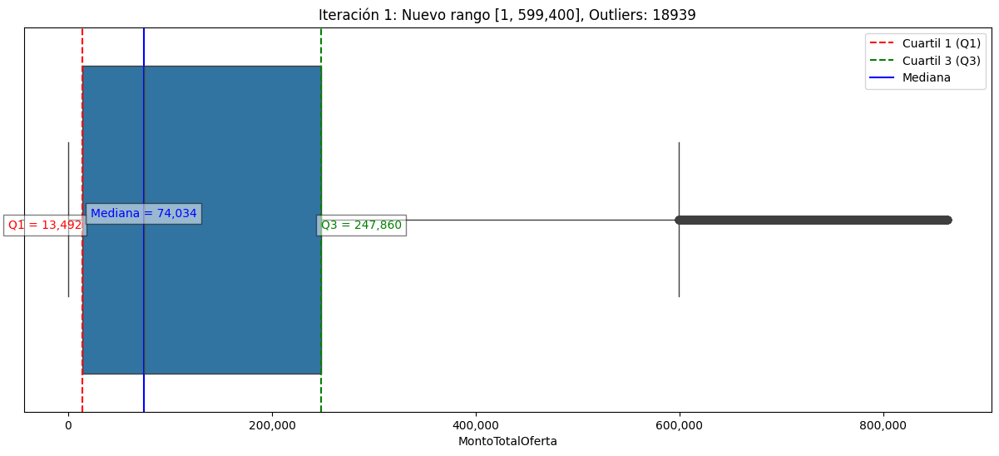

Iteración 1: Nuevo rango [1, 599,400]
Max outlier in iteration 1: 862,800


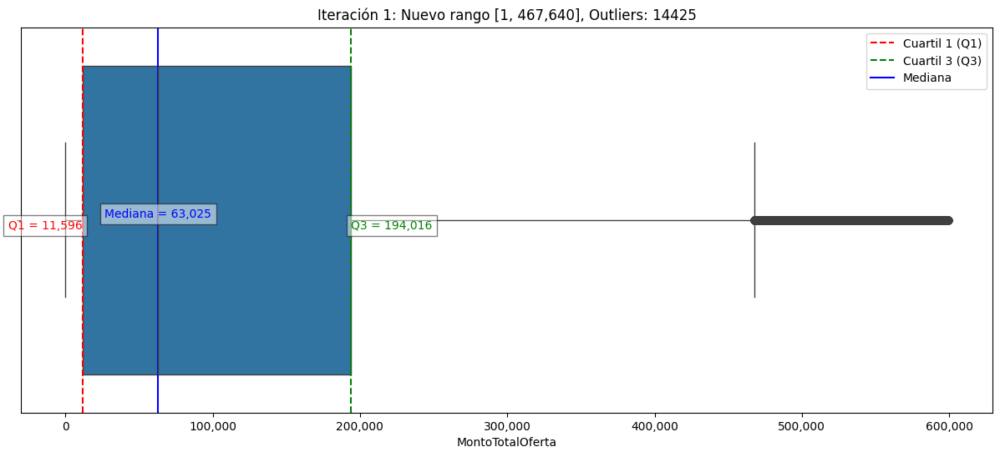

Iteración 1: Nuevo rango [1, 467,640]
Max outlier in iteration 1: 599,400


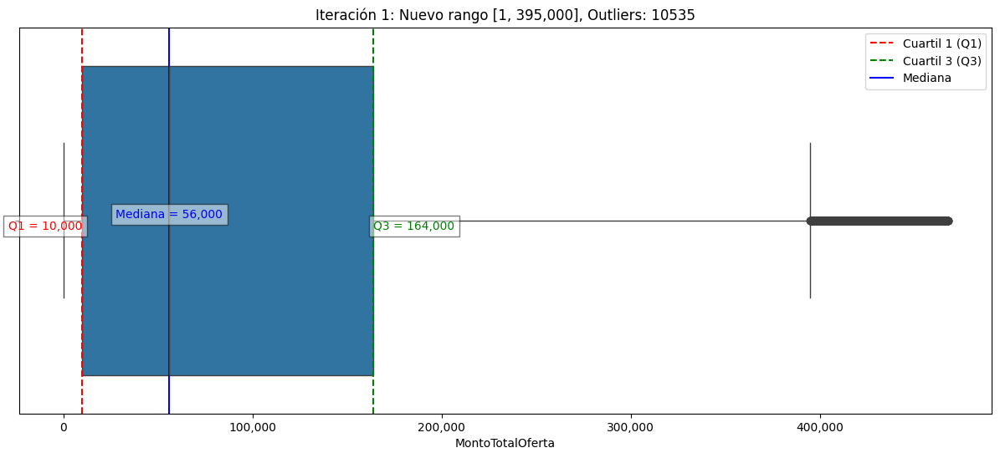

Iteración 1: Nuevo rango [1, 395,000]
Max outlier in iteration 1: 467,640


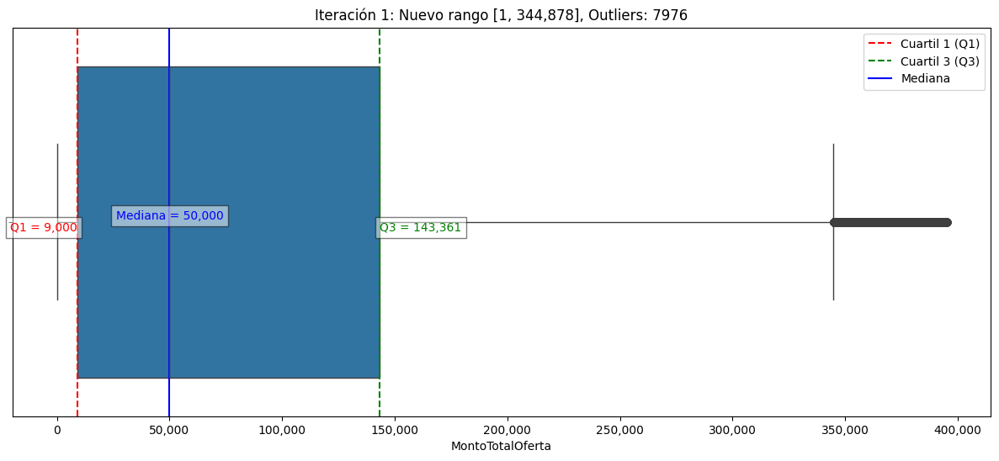

Iteración 1: Nuevo rango [1, 344,878]
Max outlier in iteration 1: 395,000


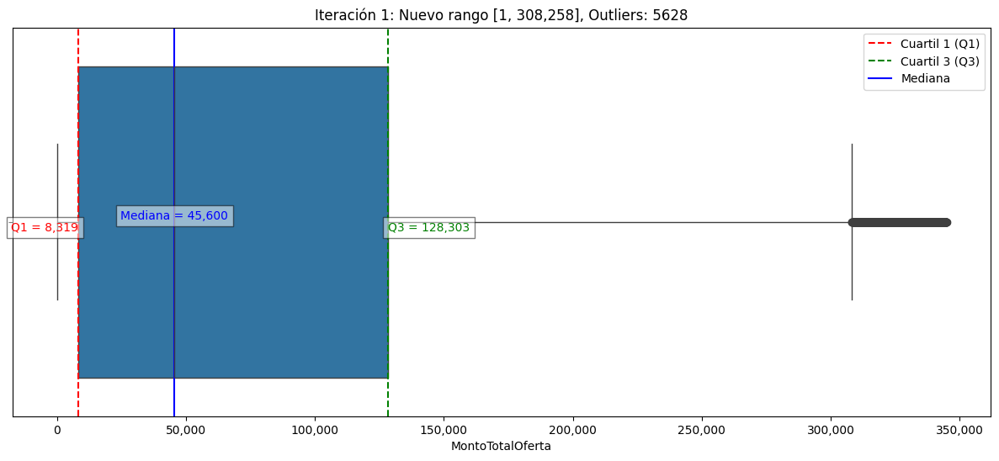

Iteración 1: Nuevo rango [1, 308,258]
Max outlier in iteration 1: 344,878


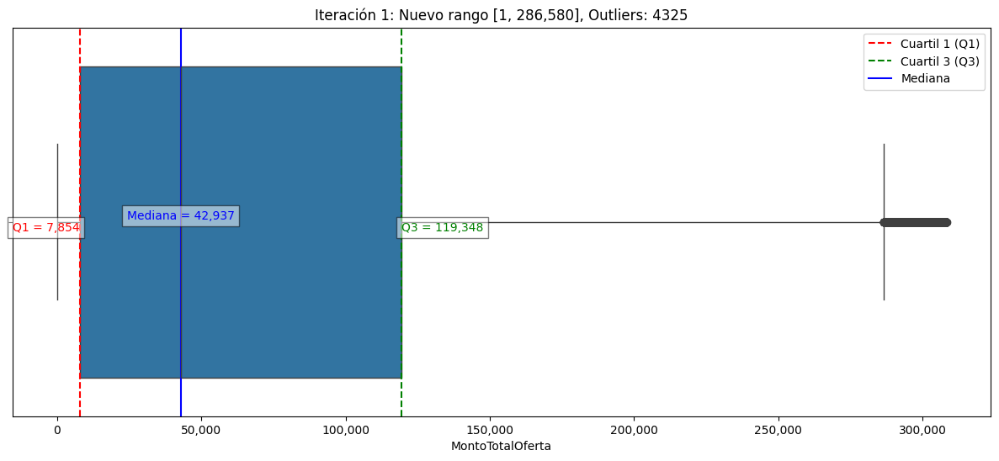

Iteración 1: Nuevo rango [1, 286,580]
Max outlier in iteration 1: 308,258


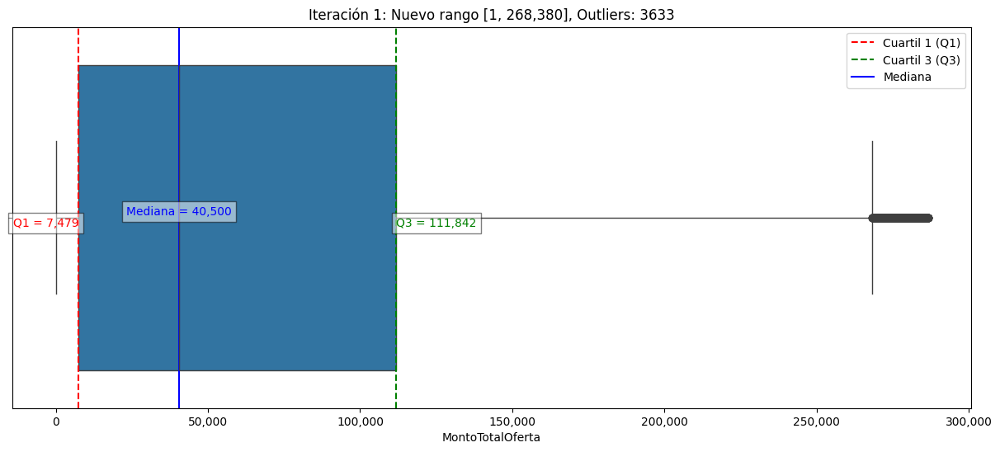

Iteración 1: Nuevo rango [1, 268,380]
Max outlier in iteration 1: 286,580


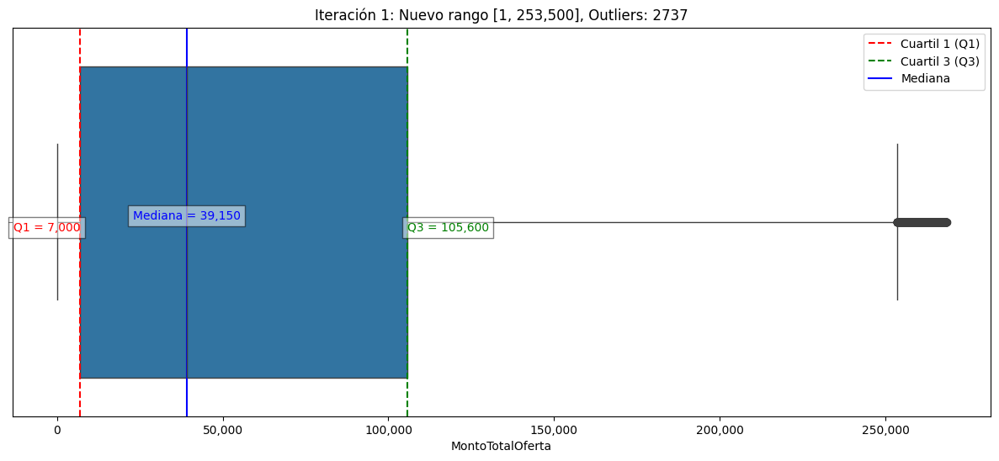

Iteración 1: Nuevo rango [1, 253,500]
Max outlier in iteration 1: 268,380


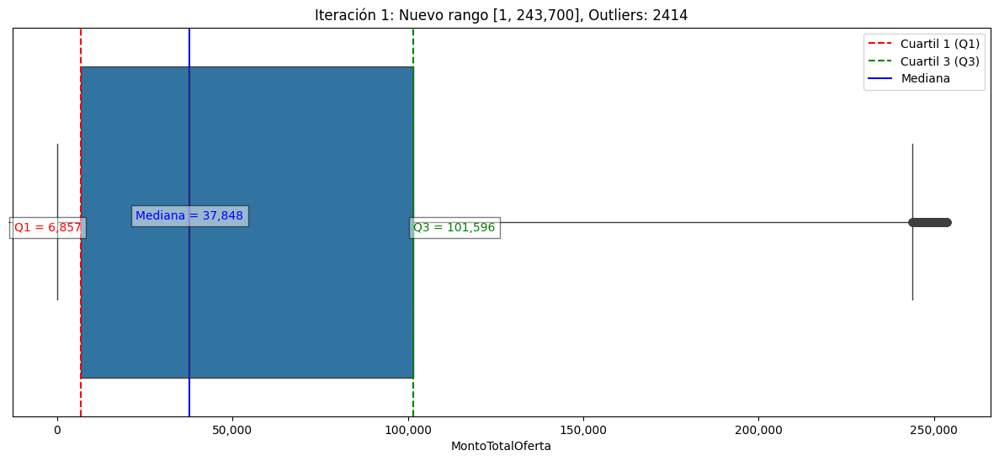

Iteración 1: Nuevo rango [1, 243,700]
Max outlier in iteration 1: 253,500


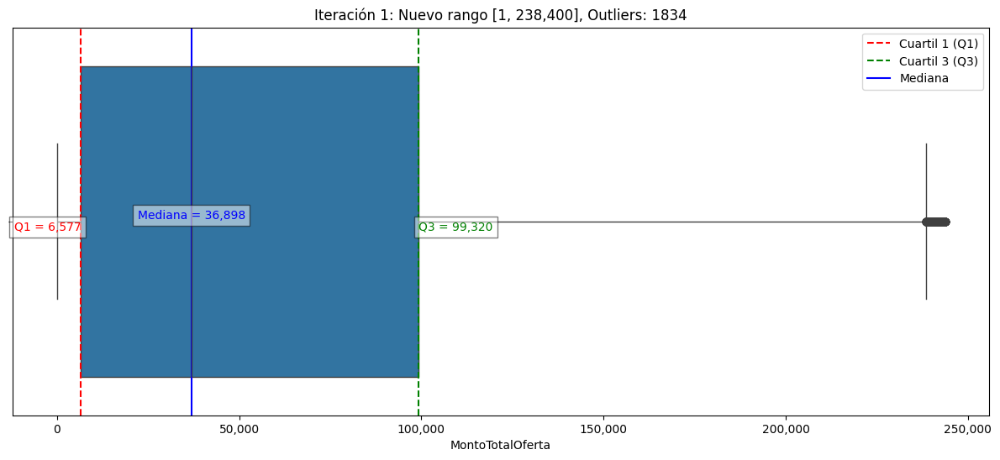

Iteración 1: Nuevo rango [1, 238,400]
Max outlier in iteration 1: 243,700


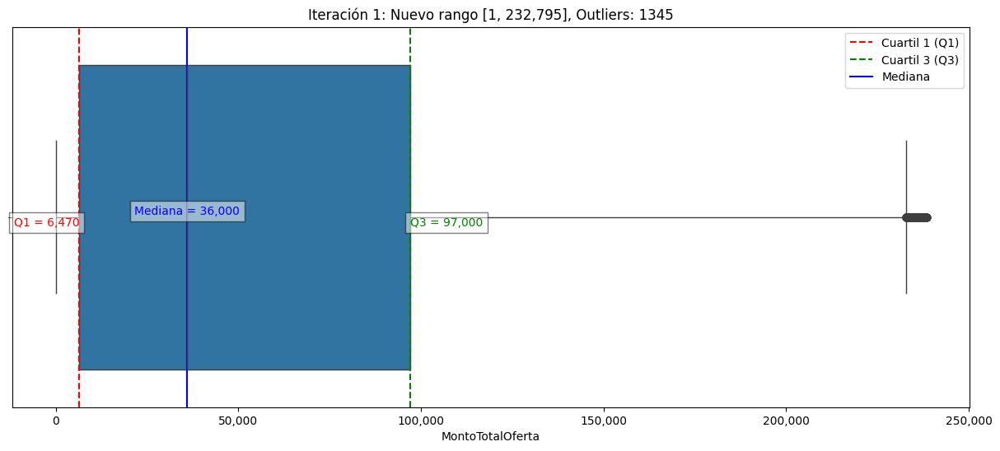

Iteración 1: Nuevo rango [1, 232,795]
Max outlier in iteration 1: 238,400


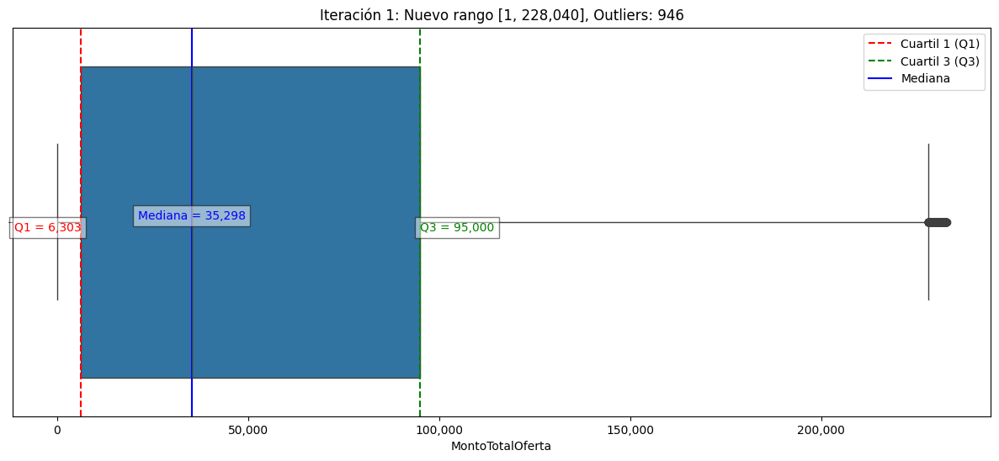

Iteración 1: Nuevo rango [1, 228,040]
Max outlier in iteration 1: 232,795


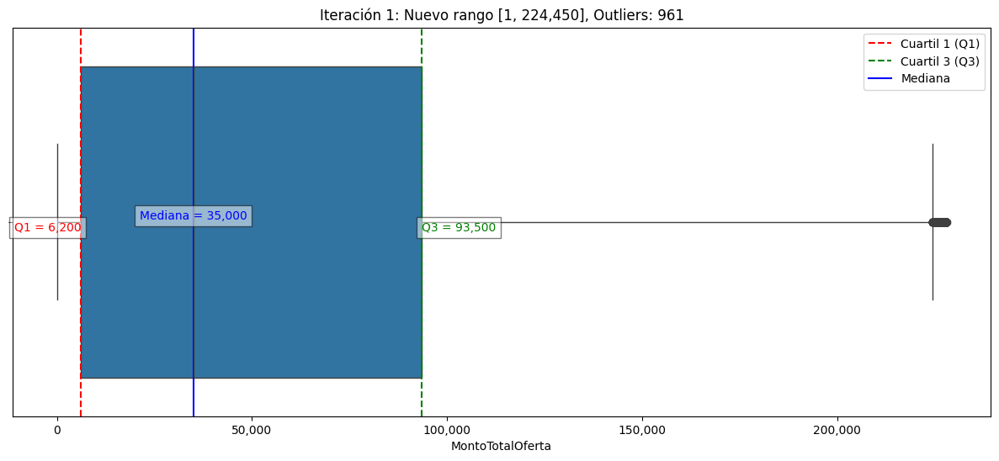

Iteración 1: Nuevo rango [1, 224,450]
Max outlier in iteration 1: 228,040


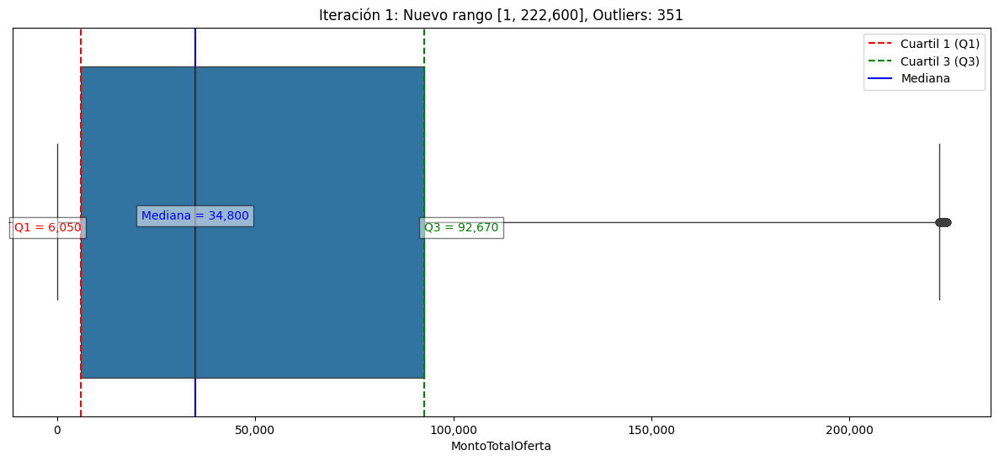

Iteración 1: Nuevo rango [1, 222,600]
Max outlier in iteration 1: 224,450


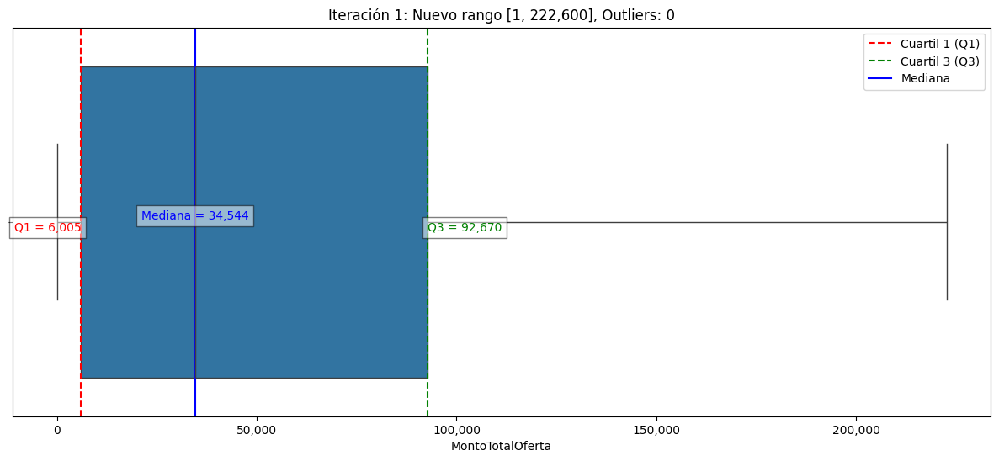

Iteración 1: Nuevo rango [1, 222,600]
Max outlier in iteration 1: nan
No se encontraron outliers en esta iteración.


In [57]:
# Cargar el DataFrame
#df_cuartiles = df_mayor_100
#df_v = df['MontoTotalOferta'] >= 100
# Iterar hasta que no haya más outliers
variable = "MontoTotalOferta"

df_a = df_sin_na[df_sin_na[variable] > 1]

iteracion = 1
while True:
    #df_cuartiles, outliers, df_actualizado = remover_outliers_y_graficar(df_cuartiles, 'MontoEstimadoLicitacion', iteracion)
    df_a, outliers, df_actualizado = remover_outliers_y_graficar(df_a, variable, iteracion)
    nuevo_rango_min = df_actualizado[variable].min()
    nuevo_rango_max = df_actualizado[variable].max()
    print(f"Iteración {iteracion}: Nuevo rango [{nuevo_rango_min:,.0f}, {nuevo_rango_max:,.0f}]")
    max_outlier = outliers[variable].max()
    print(f"Max outlier in iteration {iteracion}: {max_outlier:,.0f}")

    if outliers.empty:
        print("No se encontraron outliers en esta iteración.")
        break
    #iteracion += 1

In [58]:
describe_nulls_num(df_cuartiles)

,NroLicitacion,NombreLicitacion,TipoLicitacion,Descripcion,MonedaLicitacion,MontoEstimadoVisible,BaseEstimacionMontoLicitacion,FechaPublicacion,FechaInicioPreguntas,FechaFinalPreguntas,FechaPublicacionRespuestas,FechaActoAperturaTecnica,FechaActoAperturaEconomica,FechaCierre,FechaAdjudicacion,UnidadTiempoEvaluacion,EstadoLicitacion,ContemplaObrasPublicas,TipoAprobacionAdjudicacion,NumeroActaAprobacion,FechaActaAprobacion,TipoConvocatoria,NroEtapasLicitacion,SubContratacion,TomaRazonContraloria,PublicidadOfertasTecnicas,Contrato,UnidadTiempoDuracionContrato,TipoEjecucion,PlazoPagoContrato,TipoPago,ExtensionPlazo,UnidadCompra,UnidadCompraRUT,Institucion,RubroN1,RubroN2,RubroN3,ONUProducto,NombreItem,DescripcionItem,UnidadMedida,Proveedor,ProveedorRUT,ActividadProveedor,TamanoProveedor,NombreOferta,EstadoOferta,ResultadoOferta
count,818707,818707,818707,818707,818707,818707,818707,818707,818707,818707,818707,818707,818707,818707,818707,818707,818707,818707,818707,818707,818707,818707,818707,818707,818707,818707,818707,818707,818707,818707,818707,818707,818707,818707,818707,818707,818707,818707,818707,818707,818707,818707,818707,818707,818707,818707,818707,818707,818707
unique,32348,31050,10,31593,5,2,3,32221,26640,17998,16584,19826,19922,14247,32331,4,5,2,6,11636,1400,2,2,2,2,2,3,4,2,2,3,2,1461,504,253,55,331,1557,6588,6661,120947,89,22533,22537,13001,5,92766,2,2
top,4449-3-LE21,ADQUISICIÓN DE MATERIAL BIBLIOGRÁFICO PARA EL ...,Licitación Pública Entre 100 y 1000 UTM (LE),ADQUISICIÓN DE MATERIAL BIBLIOGRÁFICO PARA EL ...,CLP,NO,Presupuesto disponible,19-04-2021 8:59:25,19-04-2021 16:00:00,22-04-2021 16:00:00,24-04-2021 18:00:00,30-04-2021 7:00:00,30-04-2021 7:00:00,29-04-2021 15:30:00,11-06-2021 13:36:21,Horas,Adjudicada,NO,Resolucion,183,03-06-2021 0:00:00,Abierta,Una etapa,No,No,Si,Formaliza Orden Compra,Horas,Contrato de Ejecucion Inmediata,A 30 dias,Cheque,NO,SUBDIRECCIÓN DE BIBLIOTECAS PÚBLICAS,60.905.000-4,DIRECCION GENERAL DE GENDARMERIA DE CHIL,Productos impresos y publicaciones,Medios impresos,Publicaciones impresas,Libros de referencias para bibliotecas,Libros de referencias para bibliotecas,Adquisición de los Servicios de Desarrollo y M...,Unidad,EMPRESA EDITORA ZIG ZAG S A,90.684.000-6,VENTA AL POR MAYOR DE LIBROS,Micro,Oferta 1,Aceptada,Ganadora
freq,17931,17931,695544,17931,797669,461659,515347,17931,17935,17949,17931,17931,17931,17933,17931,724832,816529,817489,756344,18740,18034,817853,785606,461659,817044,811882,357887,552237,589797,814058,459707,662556,58341,100062,162366,134875,108003,108003,67629,67629,489,651883,15136,15136,25693,272644,5934,756757,427875
nulos,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
porcentaje de nulos,0.00%,0.00%,0.00%,0.00%,0.00%,0.00%,0.00%,0.00%,0.00%,0.00%,0.00%,0.00%,0.00%,0.00%,0.00%,0.00%,0.00%,0.00%,0.00%,0.00%,0.00%,0.00%,0.00%,0.00%,0.00%,0.00%,0.00%,0.00%,0.00%,0.00%,0.00%,0.00%,0.00%,0.00%,0.00%,0.00%,0.00%,0.00%,0.00%,0.00%,0.00%,0.00%,0.00%,0.00%,0.00%,0.00%,0.00%,0.00%,0.00%


In [59]:
describe_nulls(df_cuartiles)

,MontoEstimadoLicitacion,TiempoDuracionContrato,CantidadItem,CantidadOferta,MontoNetoOferta,MontoTotalOferta
count,818707.0,818707.0,818707.0,818707.0,818707.0,818707.0
mean,15484041.549697,114.080722,546.055839,439.374443,3605608.182286,6679233.57847
std,13290939.313641,69126.458091,29677.965045,27529.814824,8560128.954296,11452773.751164
min,100.0,0.0,0.1,0.0,0.0,0.0
25%,5488185.0,0.0,1.0,0.0,0.0,0.0
50%,11086490.0,0.0,2.0,1.0,27907.0,312000.0
75%,24268500.0,7.0,16.0,6.0,2273131.666667,9161501.0
max,52438300.0,44227650.0,5760000.0,5760000.0,100000000.0,100000000.0
nulos,0.0,0.0,0.0,0.0,0.0,0.0
porcentaje de nulos,0.00%,0.00%,0.00%,0.00%,0.00%,0.00%


In [60]:
montos_0 = df_cuartiles[df_cuartiles['MontoNetoOferta'] == 0]
describe_nulls(montos_0)

,MontoEstimadoLicitacion,TiempoDuracionContrato,CantidadItem,CantidadOferta,MontoNetoOferta,MontoTotalOferta
count,209344.0,209344.0,209344.0,209344.0,209344.0,209344.0
mean,15870557.405137,5.017493,417.211891,0.0,0.0,0.0
std,13576577.809315,11.375276,21928.136296,0.0,0.0,0.0
min,100.0,0.0,1.0,0.0,0.0,0.0
25%,5488185.0,0.0,1.0,0.0,0.0,0.0
50%,12066794.0,0.0,2.0,0.0,0.0,0.0
75%,24380180.0,8.0,24.0,0.0,0.0,0.0
max,52432790.0,532.0,5760000.0,0.0,0.0,0.0
nulos,0.0,0.0,0.0,0.0,0.0,0.0
porcentaje de nulos,0.00%,0.00%,0.00%,0.00%,0.00%,0.00%


In [61]:
# Obtener todas las columnas que comienzan con "fecha"
columnas_fecha = df_cuartiles.filter(regex='^Fecha').columns
# Convertir las columnas de fecha al formato correcto ("%d-%m-%Y %H:%M:%S")
df_cuartiles[columnas_fecha] = df_cuartiles[columnas_fecha].apply(pd.to_datetime, format="%d-%m-%Y %H:%M:%S")

# Filtrar las filas basadas en el rango de años deseado para todas las columnas de fecha
filtro_por_fechas = (
    (df_cuartiles[columnas_fecha] >= pd.Timestamp('2020-01-01')) &
    (df_cuartiles[columnas_fecha] <= pd.Timestamp('2024-12-31'))
)

# Aplicar la condición de filtrado a todas las columnas de fecha
df_filtrado = df_cuartiles[filtro_por_fechas.any(axis=1)]

# Ahora df_filtrado contiene solo las filas con fechas entre 2020 y 2024 en al menos una de las columnas de fechas que empiezan con "fecha"


In [62]:
df_cuartiles.value_counts("NroEtapasLicitacion")
#33.000 

NroEtapasLicitacion
Una etapa     785606
Dos etapas     33101
Name: count, dtype: int64

In [63]:
# Agrupar por "NroLicitacion" y contar los estados "ganador" y "perdedor"
conteo_resultados_por_id = df_cuartiles.groupby('NroLicitacion')['ResultadoOferta'].value_counts().unstack().fillna(0)

# Filtrar los "ids" donde todos los registros correspondientes sean "perdedor" y contarlos
cantidad_ids_todos_perdedores = len(conteo_resultados_por_id[(conteo_resultados_por_id['Perdedora'] == conteo_resultados_por_id.sum(axis=1))])

# Imprimir la cantidad de "ids" donde todos los registros correspondientes son perdedores
print("Cantidad de IDs donde todos los registros correspondientes son perdedores:", cantidad_ids_todos_perdedores)

Cantidad de IDs donde todos los registros correspondientes son perdedores: 1198


In [64]:

# Obtener un conteo de los ganadores por cada número de licitación
conteo_ganadores_por_licitacion = df_cuartiles[df_cuartiles['ResultadoOferta'] == 'Ganadora'].groupby('NroLicitacion').size()

# Contar cuántos números de licitación tienen más de un ganador
cantidad_licitaciones_con_mas_de_un_ganador = (conteo_ganadores_por_licitacion > 1).sum()

# Imprimir la cantidad de números de licitación que tienen más de un ganador
print("Cantidad de números de licitación con más de un ganador:", cantidad_licitaciones_con_mas_de_un_ganador)

# Filtrar los números de licitación que tienen más de un ganador
licitaciones_con_mas_de_un_ganador = conteo_ganadores_por_licitacion[conteo_ganadores_por_licitacion > 1]

# Obtener los índices de las filas que deben ser eliminadas (aquellas que corresponden a licitaciones con más de un ganador)
indices_a_eliminar = df_cuartiles[df_cuartiles['NroLicitacion'].isin(licitaciones_con_mas_de_un_ganador.index)].index

# Eliminar todas las filas que corresponden a los números de licitación con más de un ganador
df_cuartiles_sin_duplicados = df_cuartiles.drop(indices_a_eliminar)

# Imprimir la cantidad de filas eliminadas
print("Cantidad de filas eliminadas:", len(indices_a_eliminar))


Cantidad de números de licitación con más de un ganador: 7817
Cantidad de filas eliminadas: 734572


In [65]:
# Obtener un conteo de los ganadores por cada número de licitación
conteo_ganadores_por_licitacion = df_cuartiles[df_cuartiles['ResultadoOferta'] == 'Ganadora'].groupby('NroLicitacion').size()

# Ordenar los resultados por cantidad de ganadores de manera descendente
conteo_ganadores_por_licitacion_ordenado = conteo_ganadores_por_licitacion.sort_values(ascending=False)

# Imprimir el conteo de ganadores por cada número de licitación ordenado
print(conteo_ganadores_por_licitacion_ordenado)

NroLicitacion
4449-3-LE21        15937
4449-3-LE20         7464
5251-20-LE19        6709
4853-2-LP22         4904
4449-10-LE23        4238
                   ...  
1002584-5-LE21         1
1002584-5-LE22         1
1002584-6-LP21         1
1002584-8-LE21         1
1002584-14-LE23        1
Length: 31150, dtype: int64


In [66]:
# Filtrar los registros completos para la ID específica
registros_id_4449_3_LE21 = df_cuartiles[df_cuartiles['NroLicitacion'] == '4449-3-LE21']

# Imprimir los registros completos de la ID específica
print(registros_id_4449_3_LE21)


       NroLicitacion                                   NombreLicitacion  \
691068   4449-3-LE21  ADQUISICIÓN DE MATERIAL BIBLIOGRÁFICO PARA EL ...   
691069   4449-3-LE21  ADQUISICIÓN DE MATERIAL BIBLIOGRÁFICO PARA EL ...   
691070   4449-3-LE21  ADQUISICIÓN DE MATERIAL BIBLIOGRÁFICO PARA EL ...   
691071   4449-3-LE21  ADQUISICIÓN DE MATERIAL BIBLIOGRÁFICO PARA EL ...   
691072   4449-3-LE21  ADQUISICIÓN DE MATERIAL BIBLIOGRÁFICO PARA EL ...   
...              ...                                                ...   
710187   4449-3-LE21  ADQUISICIÓN DE MATERIAL BIBLIOGRÁFICO PARA EL ...   
710188   4449-3-LE21  ADQUISICIÓN DE MATERIAL BIBLIOGRÁFICO PARA EL ...   
710189   4449-3-LE21  ADQUISICIÓN DE MATERIAL BIBLIOGRÁFICO PARA EL ...   
710190   4449-3-LE21  ADQUISICIÓN DE MATERIAL BIBLIOGRÁFICO PARA EL ...   
710191   4449-3-LE21  ADQUISICIÓN DE MATERIAL BIBLIOGRÁFICO PARA EL ...   

                                      TipoLicitacion  \
691068  Licitación Pública Entre 100 y 1000

In [67]:
df_ceros = montos_0.head(10000)
df_ceros.value_counts("TipoEjecucion")

TipoEjecucion
Contrato de Ejecucion Inmediata       6706
Contrato de Ejecucion en el Tiempo    3294
Name: count, dtype: int64

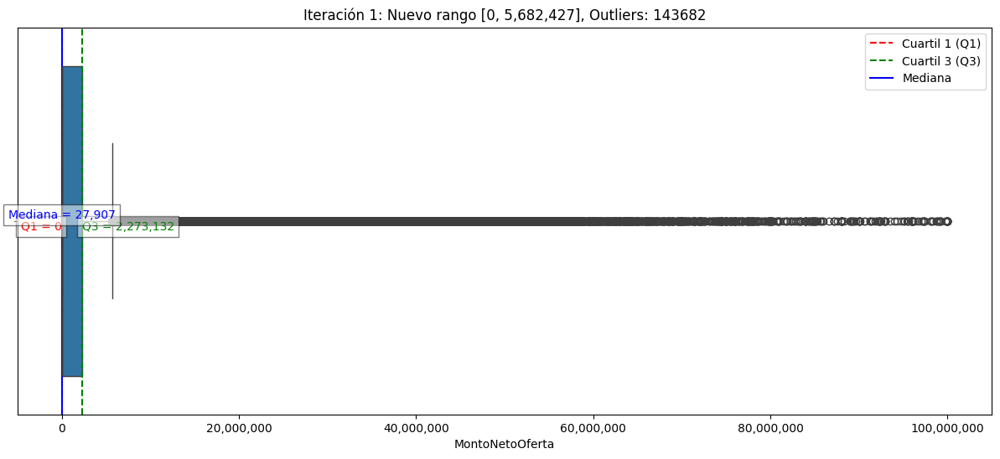

Iteración 1: Nuevo rango [0, 5,682,427]


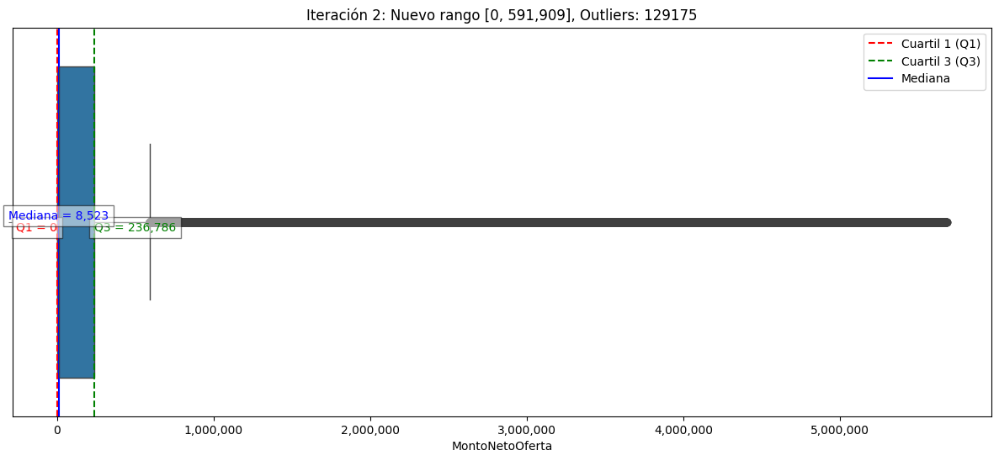

Iteración 2: Nuevo rango [0, 591,909]


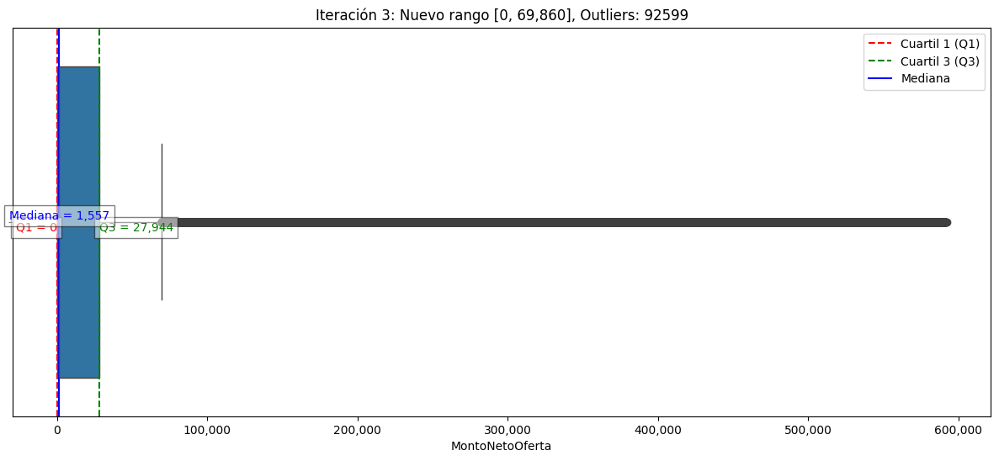

Iteración 3: Nuevo rango [0, 69,860]


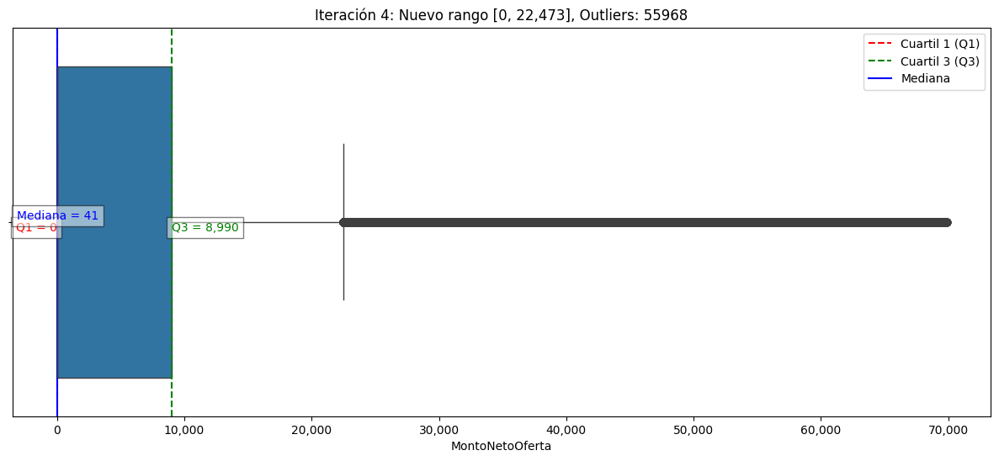

Iteración 4: Nuevo rango [0, 22,473]


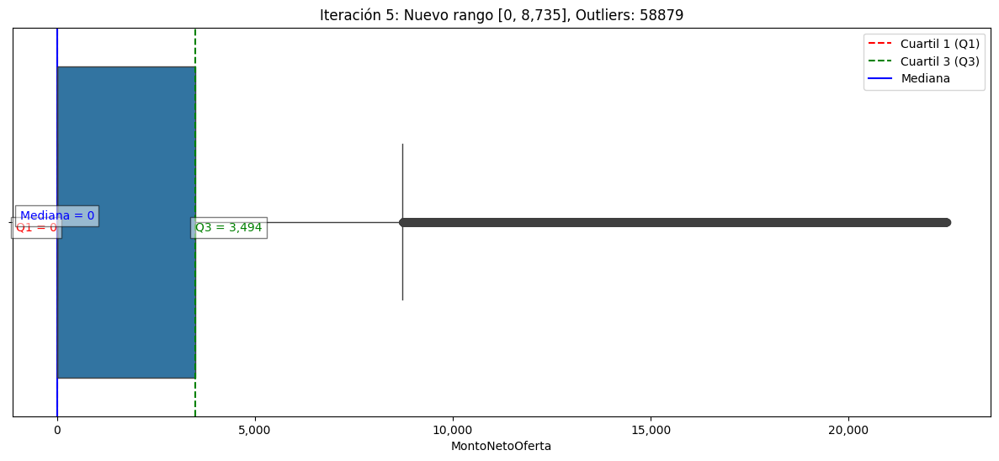

Iteración 5: Nuevo rango [0, 8,735]


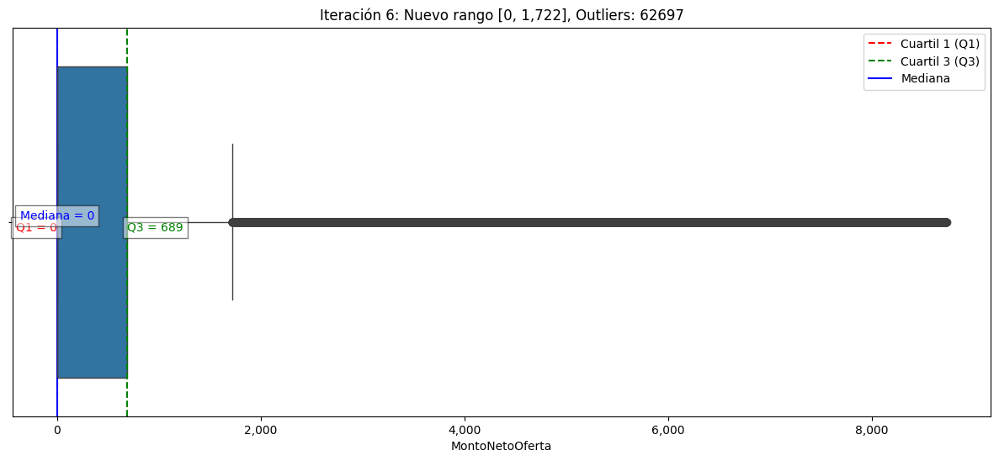

Iteración 6: Nuevo rango [0, 1,722]


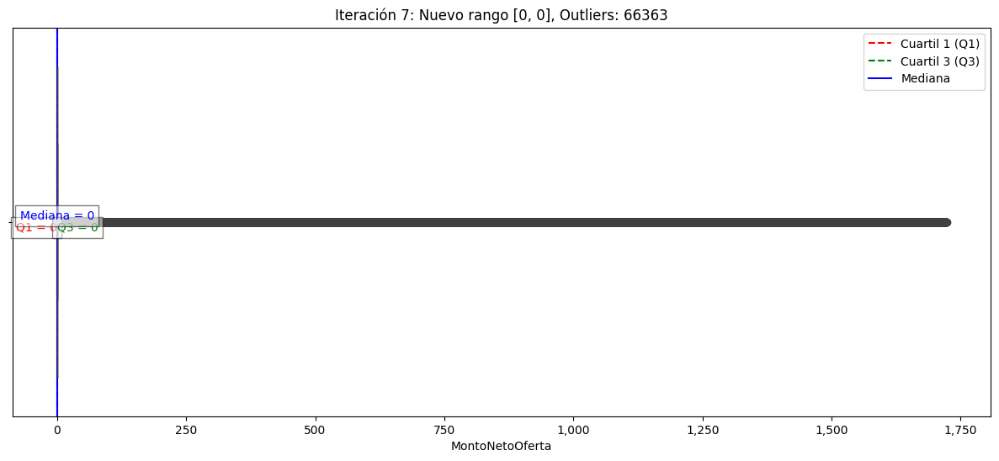

Iteración 7: Nuevo rango [0, 0]


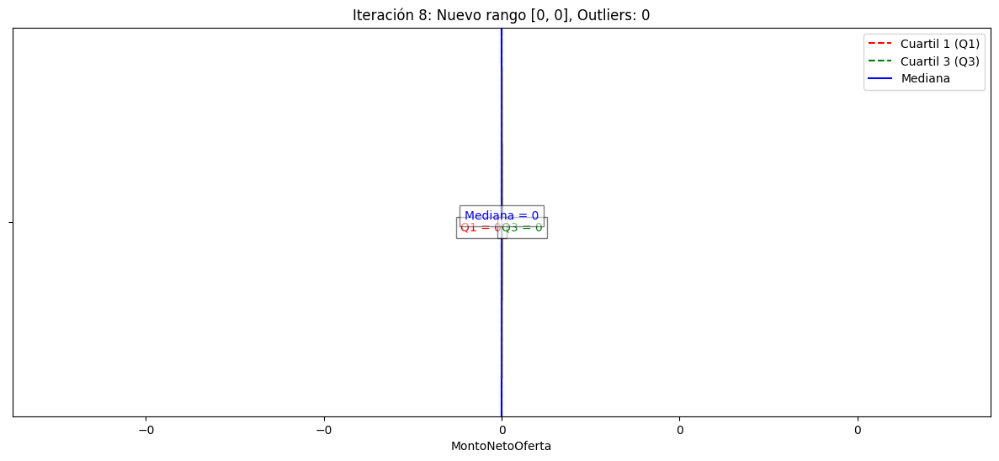

Iteración 8: Nuevo rango [0, 0]
No se encontraron outliers en esta iteración.


In [68]:
# Cargar el DataFrame
df_cuartiles_new = df_cuartiles

# Iterar hasta que no haya más outliers
iteracion = 1
while True:
    df_cuartiles_new, outliers, df_actualizado = remover_outliers_y_graficar(df_cuartiles_new, 'MontoNetoOferta', iteracion)
    nuevo_rango_min = df_actualizado['MontoNetoOferta'].min()
    nuevo_rango_max = df_actualizado['MontoNetoOferta'].max()
    print(f"Iteración {iteracion}: Nuevo rango [{nuevo_rango_min:,.0f}, {nuevo_rango_max:,.0f}]")
    if outliers.empty:
        print("No se encontraron outliers en esta iteración.")
        break
    iteracion += 1
##EL RESULTADO DE ESTO PARECE NO SER OPTIMO YA QUE SI SE REALIZA UNA LIMPIEZA QUEDAN TODOS EN 1, SE OMITE LOS OUTLIERS DE CANTIDAD DE ITEMS


In [69]:
#DataFrame en un archivo CSV
df_filtrado.to_csv('eda.csv', index=False)

In [70]:
df_cuartiles.shape

(818707, 57)

In [71]:
df_cuartiles.head(100)

,NroLicitacion,NombreLicitacion,TipoLicitacion,Descripcion,MonedaLicitacion,MontoEstimadoLicitacion,MontoEstimadoVisible,BaseEstimacionMontoLicitacion,FechaPublicacion,FechaInicioPreguntas,FechaFinalPreguntas,FechaPublicacionRespuestas,FechaActoAperturaTecnica,FechaActoAperturaEconomica,FechaCierre,FechaAdjudicacion,UnidadTiempoEvaluacion,EstadoLicitacion,ContemplaObrasPublicas,TipoAprobacionAdjudicacion,NumeroActaAprobacion,FechaActaAprobacion,TipoConvocatoria,NroEtapasLicitacion,SubContratacion,TomaRazonContraloria,PublicidadOfertasTecnicas,Contrato,TiempoDuracionContrato,UnidadTiempoDuracionContrato,TipoEjecucion,PlazoPagoContrato,TipoPago,ExtensionPlazo,UnidadCompra,UnidadCompraRUT,entCode,Institucion,RubroN1,RubroN2,RubroN3,CodigoProductoONU,ONUProducto,NombreItem,DescripcionItem,UnidadMedida,CantidadItem,Proveedor,ProveedorRUT,ActividadProveedor,TamanoProveedor,NombreOferta,EstadoOferta,CantidadOferta,MontoNetoOferta,ResultadoOferta,MontoTotalOferta
0,5067-14-LE18,Contratación suministro bidones agua purifica...,Licitación Pública Entre 100 y 1000 UTM (LE),Contratación de suministro de bidones de agua ...,CLP,1800,NO,Precio Referencial,2019-04-23 18:00:27,2019-04-23 18:35:00,2019-04-29 15:00:00,2019-05-02 15:00:00,2019-05-06 15:09:00,2019-05-06 15:09:00,2019-05-03 20:00:00,2019-07-17 17:41:12,Horas,Adjudicada,NO,Resolucion,4919,2019-07-17,Abierta,Una etapa,No,No,Si,Formaliza Orden Compra,12,Meses,Contrato de Ejecucion en el Tiempo,A 30 dias,"Transferencia Electronica, Cheque",NO,Universidad de Santiago de Chile,60.911.000-7,212299,UNIVERSIDAD DE SANTIAGO DE CHILE,"Alimentos, bebidas y tabaco",Bebidas,Bebidas no alcohólicas,50202301.0,Agua,Agua,Suministro de Bidones de Agua Purificada - Arr...,Unidad,1.0,MANANTIAL S A,96.711.590-8,VENTA Y COMERCIALIZACIÓN DE AGUA PURIFICADA,Mediana,Provisión de agua purificada y dispensadores,Aceptada,1.0,1990.0,Perdedora,1990.0
1,5067-14-LE18,Contratación suministro bidones agua purifica...,Licitación Pública Entre 100 y 1000 UTM (LE),Contratación de suministro de bidones de agua ...,CLP,1800,NO,Precio Referencial,2019-04-23 18:00:27,2019-04-23 18:35:00,2019-04-29 15:00:00,2019-05-02 15:00:00,2019-05-06 15:09:00,2019-05-06 15:09:00,2019-05-03 20:00:00,2019-07-17 17:41:12,Horas,Adjudicada,NO,Resolucion,4919,2019-07-17,Abierta,Una etapa,No,No,Si,Formaliza Orden Compra,12,Meses,Contrato de Ejecucion en el Tiempo,A 30 dias,"Transferencia Electronica, Cheque",NO,Universidad de Santiago de Chile,60.911.000-7,212299,UNIVERSIDAD DE SANTIAGO DE CHILE,"Alimentos, bebidas y tabaco",Bebidas,Bebidas no alcohólicas,50202301.0,Agua,Agua,Suministro de Bidones de Agua Purificada - Arr...,Unidad,1.0,ARCON SPA,76.645.833-5,Producción de aguas minerales y otras aguas em...,Pequeña,Propuesta agua purificada Positive Mood,Aceptada,1.0,1800.0,Ganadora,1800.0
6,5358-13-LR18,SERV. DE GUARDIAS DE SEGURIDAD Y DOMÓTICA UTA IQQ,Licitación Pública Mayor a 5000 (LR),La Universidad de Tarapacá requiere la contrat...,CLP,37600000,NO,Precio Referencial,2019-04-25 22:21:48,2019-04-26 16:00:00,2019-05-10 16:00:00,2019-05-13 23:59:00,2019-05-27 16:00:00,2019-05-27 16:00:00,2019-05-27 15:01:00,2019-09-24 12:42:05,Dias,Adjudicada,NO,Decreto,14-2019,2019-07-10,Abierta,Una etapa,No,Si,Si,No,24,Meses,Contrato de Ejecucion en el Tiempo,A 30 dias,"Transferencia Electronica, Cheque",NO,DIRECCION GENERAL DE SEDES,70.770.800-k,204439,UNIVERSIDAD DE TARAPACA,Servicios de construcción y mantenimiento,"Servicios de atención, mantenimiento y reparac...",Servicios eléctricos,72102204.0,Instalación de sistemas de seguridad,Instalación de sistemas de seguridad,Servicio de seguridad a través de domótica par...,Global,1.0,WASHINGTON FERNANDEZ AGUILA SEGURIDAD E.I.R.L,76.388.240-3,"OBRAS MENORES EN CONSTRUCCION (CONTRATISTAS, A...",Micro,Servicio de seguridad privada UTA Iquique 2019,Aceptada,1.0,37600000.0,Ganadora,37600000.0
7,5358-13-LR18,SERV. DE GUARDIAS DE SEGURIDAD Y DOMÓTICA UTA IQQ,Licitación Pública Mayor a 5000 (LR),La Universidad d

In [72]:
df_cuartiles.shape

(818707, 57)